In [1]:
# %%

# [1] Global Configuration and Environment Setup
import os
import random
import warnings

os.environ["SHAP_SILENCE_WARNINGS"] = "1"
os.environ["SHAP_DISABLE_PROGRESS"] = "1"
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

try:
    from sklearnex import patch_sklearn

    patch_sklearn()
    print("Using Intel-optimized scikit-learn")
except Exception:
    print("Intel-optimized scikit-learn not found. Using standard scikit-learn.")

try:
    from tqdm.notebook import tqdm

    print("Using notebook-optimized tqdm for progress bars.")
except ImportError:
    from tqdm import tqdm

    print("tqdm.notebook not found. Using standard console tqdm.")

# Pipeline Configuration
INPUT_DATA_FILE = (
    "combined first sample.xlsx"  # Path to combined CyTOF dataset (Lung + Melanoma)
)
BASE_SEED = 42  # Base random seed for reproducibility
STABILITY_THRESHOLDS = [
    40,
    50,
    60,
    70,
    80,
]  # Feature selection frequency thresholds (%)
OUTER_N_SPLITS = 4  # Number of folds in outer CV loop
OUTER_N_REPEATS = 10  # Number of repeats in outer CV loop
BOOTSTRAP_N = 10  # Number of bootstrap resamples per outer fold
STRATIFIED_BOOTSTRAP = True  # Whether to use stratified bootstrap sampling

# Inner CV Configuration (for feature selection methods)
INNER_CV_N_SPLITS = 4  # Number of folds in inner CV for LassoCV, RidgeCV, ElasticNetCV, RFECV
INNER_CV_N_REPEATS = 2  # Number of repeats in inner CV for feature selection
REPORT_DIR = "run_reports"  # Directory for storing analysis reports
FOLD_LOG_DIR = os.path.join(
    REPORT_DIR, "fold_logs"
)  # Subdirectory for fold-specific logs

print("\n--- Pipeline Configuration ---")
print(
    f"  - Outer Loop: {OUTER_N_REPEATS} repeats of {OUTER_N_SPLITS}-Fold Stratified CV (Total {OUTER_N_REPEATS * OUTER_N_SPLITS} evaluations)"
)
print(f"  - Inner Loop: Bootstrapping with {BOOTSTRAP_N} resamples per outer fold")
print(f"  - Stratified Bootstrap: {'Enabled' if STRATIFIED_BOOTSTRAP else 'Disabled'}")
print(f"  - Stability Thresholds: {STABILITY_THRESHOLDS}%")
print(f"  - Base Random Seed: {BASE_SEED}")

Using Intel-optimized scikit-learn
Using notebook-optimized tqdm for progress bars.

--- Pipeline Configuration ---
  - Outer Loop: 10 repeats of 4-Fold Stratified CV (Total 40 evaluations)
  - Inner Loop: Bootstrapping with 10 resamples per outer fold
  - Stratified Bootstrap: Enabled
  - Stability Thresholds: [40, 50, 60, 70, 80]%
  - Base Random Seed: 42


Extension for Scikit-learn* enabled (https://github.com/uxlfoundation/scikit-learn-intelex)


In [2]:
# %%

# [2] Data Loading, Preprocessing, and Quality Control
# Note: Basic imports moved to where they're first used

In [3]:
# %%

# [3] Core Utility Functions
import numpy as np
import pandas as pd
from scipy.stats import t


def set_seed(seed):
    """Set random seeds for reproducibility across Python, NumPy, and hash operations.

    This function ensures reproducible results by setting seeds for:
    - Python's built-in random module
    - NumPy's random number generator
    - Hash randomization (for consistent behavior)
    - Scikit-learn's random state (if available)

    Reproducibility is crucial for:
    - Scientific research and publication
    - Debugging and validation of results
    - Comparing different model configurations
    - Ensuring consistent cross-validation splits

    Args:
        seed (int): Random seed value for reproducibility.
                   Should be a positive integer for best results.

    Raises:
        ValueError: If seed is not a valid integer.

    Notes:
        - Sets both global and local random seeds
        - Affects all random operations in subsequent code
        - Should be called before any random operations
        - Hash randomization is disabled for consistent behavior
        - This function should be called at the beginning of each fold to ensure
          consistent randomization across different parts of the pipeline

    Example:
        >>> set_seed(42)
        >>> # All subsequent random operations will be reproducible
        >>> np.random.rand()  # Will always produce the same result
    """
    random.seed(seed)
    np.random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)


set_seed(BASE_SEED)

df = pd.read_excel(INPUT_DATA_FILE)
print(f"Initial data loaded: {len(df)} samples, {len(df.columns)} columns")

target_column = "Response"
excluded_columns = [
    "Therapy Subgroup",
    "Patient ID",
    "Sample ID",
    "Subject",
    "Analysis run",
    "Disease Group",
]
feature_columns = [
    col for col in df.columns if col not in excluded_columns and col != target_column
]
cancer_type_column = "Disease Group"

print("Data structure analysis:")
print(f"  - Total features available: {len(feature_columns)}")
print(f"  - Excluded columns: {len(excluded_columns)} ({', '.join(excluded_columns)})")
print(f"  - Target column: {target_column}")

# Filter for combined (lung + melanoma) patients (if Disease Group column exists)
if cancer_type_column in df.columns:
    combined_mask = df[cancer_type_column].str.contains("lung|melanoma", case=False, na=False)
    df_combined = df[combined_mask].copy()
    print(f"Combined (lung + melanoma) patients: {len(df_combined)} samples")
else:
    # If no Disease Group column, assume all samples are combined
    df_combined = df.copy()
    print("No 'Disease Group' column found. Assuming all samples are combined.")
    print(f"Total samples: {len(df_combined)}")

# Filter for patients with response data (R = Responder, NR = Non-Responder)
df_filtered = df_combined[df_combined[target_column].isin(["NR", "R"])].copy()
print(f"Patients with response data: {len(df_filtered)} samples")
print(
    f"  - Response distribution: {df_filtered[target_column].value_counts().to_dict()}"
)

# Convert features to numeric and handle missing values
# Using 'coerce' to convert non-numeric values to NaN for proper handling
X_raw = df_filtered[feature_columns].apply(pd.to_numeric, errors="coerce")
y_raw = df_filtered[target_column].map({"NR": 0, "R": 1})

# Handle cancer types - only if Disease Group column exists
if cancer_type_column in df_filtered.columns:
    cancer_types_raw = df_filtered[cancer_type_column].values
else:
    # For combined dataset, create a dummy cancer type column
    cancer_types_raw = np.full(len(df_filtered), "combined")

sample_ids_raw = df_filtered["Subject"]

# Check for missing values before removal
samples_with_missing = X_raw.isnull().any(axis=1)
missing_per_feature = X_raw.isnull().sum(axis=0)

print("Missing value analysis:")
print(f"  - Samples with missing values: {samples_with_missing.sum()}")
print(f"  - Features with missing values: {(missing_per_feature > 0).sum()}")
print(f"  - Samples removed due to missing values: {samples_with_missing.sum()}")

# Remove rows with missing values and align all data
clean_indices = X_raw.dropna().index
X = X_raw.loc[clean_indices].reset_index(drop=True)
y = y_raw.loc[clean_indices].reset_index(drop=True)
# Convert cancer_types_raw back to pandas Series for consistent indexing
# This ensures proper alignment between DataFrame indices and numpy array indexing
cancer_types_series = pd.Series(cancer_types_raw, index=X_raw.index)
cancer_types = cancer_types_series.loc[clean_indices].values
sample_ids = sample_ids_raw.loc[clean_indices].reset_index(drop=True)

print(
    f"\nData preprocessing completed. Final clean dataset: {len(y)} samples, {len(feature_columns)} features"
)
print(f"Class distribution: {y.value_counts().to_dict()}")
print(
    f"Class balance: {y.value_counts()[1] / len(y) * 100:.1f}% responders, {y.value_counts()[0] / len(y) * 100:.1f}% non-responders"
)


# Zero value analysis (note: zeros are valid values; reported for awareness)
print("\nZero value analysis:")
try:
    zero_counts = (X == 0).sum(axis=0)
    features_with_zeros = zero_counts[zero_counts > 0].sort_values(ascending=False)
    if features_with_zeros.empty:
        print("  - No zero values detected.")
    else:
        print("  - Features with zero values (count > 0):")
        print(features_with_zeros)
        print("\n  Detailed zero value locations (Sample ID, Feature):")
        for feature_name, count in features_with_zeros.items():
            ids_with_zero = sample_ids[X[feature_name] == 0].astype(str).tolist()
            print(f"    {feature_name}: {count} samples with zero values")
            # Limit long lists for readability
            preview = ids_with_zero[:20]
            suffix = "..." if len(ids_with_zero) > 20 else ""
            print(f"      Sample IDs: {preview}{suffix}")
except Exception as e:
    print(f"  - Zero value analysis skipped: {e}")

# [4] Machine Learning Pipeline Core
# Note: All imports moved to where they're first used


def calculate_confidence_interval(data, confidence=0.95):
    """Calculate confidence interval for a dataset using t-distribution.

    Computes the confidence interval for the mean of a dataset using the t-distribution,
    which is appropriate for small sample sizes and when the population standard
    deviation is unknown.

    Args:
        data (array-like): Input data for which to calculate confidence interval.
        confidence (float, optional): Confidence level (default: 0.95 for 95% CI).

    Returns:
        tuple: (lower_bound, upper_bound) confidence interval bounds.
               Returns (np.nan, np.nan) if insufficient data.

    Note:
        - Requires at least 2 data points for calculation
        - Automatically handles NaN values by excluding them
        - Uses t-distribution for proper small-sample statistics
        - For single data point, returns the value itself
    """
    data = np.array(data)
    data = data[~np.isnan(data)]

    if len(data) == 0:
        return np.nan, np.nan
    elif len(data) == 1:
        # For single value, return the value itself (no confidence interval)
        return data[0], data[0]
    elif len(data) < 2:
        return np.nan, np.nan

    mean_val, std_val = np.mean(data), np.std(data, ddof=1)
    sem_val = std_val / np.sqrt(len(data))
    df = len(data) - 1

    if df < 1:
        return np.nan, np.nan

    t_critical = t.ppf(1 - (1 - confidence) / 2, df)
    margin_of_error = t_critical * sem_val
    return mean_val - margin_of_error, mean_val + margin_of_error


def calculate_ci_margin_of_error(data, confidence=0.95):
    """Calculate the margin of error (half CI width) for error bars.

    Computes the margin of error for plotting error bars, which is half the width
    of the confidence interval.

    Args:
        data (array-like): Input data for which to calculate margin of error.
        confidence (float, optional): Confidence level (default: 0.95 for 95% CI).

    Returns:
        float: Margin of error (half the confidence interval width).
               Returns np.nan if confidence interval calculation fails.
               Returns 0.0 for single data point.
    """
    ci_lower, ci_upper = calculate_confidence_interval(data, confidence)
    if np.isnan(ci_lower) or np.isnan(ci_upper):
        return np.nan
    return (ci_upper - ci_lower) / 2


def compute_specificity(y_true, y_pred):
    """Calculate specificity (true negative rate) from confusion matrix.

    Args:
        y_true (array-like): True binary labels.
        y_pred (array-like): Predicted binary labels.

    Returns:
        float: Specificity score (TN / (TN + FP)).
    """
    cm = confusion_matrix(y_true, y_pred, labels=[0, 1])
    if cm.size != 4:
        return 0.0
    tn, fp, _, _ = cm.ravel()
    return tn / (tn + fp) if (tn + fp) > 0 else 0.0


def get_classifiers(seed):
    """Initialize and return a comprehensive dictionary of machine learning classifiers for biomarker discovery.

    This function creates a diverse ensemble of machine learning classifiers specifically configured
    for biomarker discovery and cancer treatment response prediction. Each classifier is optimized
    for the unique characteristics of CyTOF data and medical classification tasks.

    The ensemble includes:
    - Linear models for interpretable baseline performance
    - Ensemble methods for robust non-linear pattern detection
    - Support vector machines for high-dimensional data
    - Gradient boosting for state-of-the-art performance
    - Probabilistic models for uncertainty quantification

    All classifiers are configured with appropriate parameters for medical data analysis,
    including proper random state management for reproducibility and parallel processing
    for computational efficiency.

    Args:
        seed (int): Random seed for reproducible model training across all classifiers.
                   This ensures consistent results across different pipeline runs and
                   enables proper statistical comparison between models.

    Returns:
        dict: Dictionary mapping classifier names to initialized classifier objects.
              Structure: {
                  'LogisticRegression': LogisticRegression object,
                  'RandomForest': RandomForestClassifier object,
                  'SVM_RBF': SVC object,
                  'XGBoost': XGBClassifier object,
                  'NaiveBayes': GaussianNB object
              }

              **Classifier Details**:
              - **LogisticRegression**: Linear baseline with L2 regularization
                  - max_iter=1000 for convergence in complex datasets
                  - n_jobs=-1 for parallel processing
                  - Provides interpretable linear decision boundaries
              - **RandomForest**: Ensemble of decision trees with bootstrap aggregation
                  - n_jobs=-1 for parallel tree construction
                  - Handles non-linear relationships and feature interactions
                  - Robust to outliers and provides feature importance
              - **SVM_RBF**: Support Vector Machine with radial basis function kernel
                  - probability=True for prediction probability estimation
                  - Excellent for high-dimensional data and non-linear patterns
                  - Robust to overfitting in high-dimensional spaces
              - **XGBoost**: Gradient boosting with advanced regularization
                  - eval_metric='logloss' for binary classification optimization
                  - n_jobs=-1 for parallel processing
                  - State-of-the-art performance on many datasets
              - **NaiveBayes**: Gaussian Naive Bayes for probabilistic classification
                  - Fast training and prediction
                  - Good baseline for probabilistic classification
                  - Robust to irrelevant features

    Raises:
        ValueError: If seed is not a valid integer
        ImportError: If required machine learning libraries are not available

    Notes:
        - All classifiers use the same random seed for reproducibility
        - Parallel processing is enabled where supported (n_jobs=-1)
        - Classifiers are configured for binary classification tasks
        - Parameters are optimized for CyTOF data characteristics
        - Memory usage is optimized for large-scale computations

    Example:
        >>> classifiers = get_classifiers(seed=42)
        >>> print(classifiers.keys())
        dict_keys(['LogisticRegression', 'RandomForest', 'SVM_RBF', 'XGBoost', 'NaiveBayes'])
        >>>
        >>> # Train a classifier
        >>> rf = classifiers['RandomForest']
        >>> rf.fit(X_train, y_train)
        >>> predictions = rf.predict(X_test)
    """
    return {
        "LogisticRegression": LogisticRegression(
            random_state=seed, max_iter=1000, n_jobs=-1
        ),
        "RandomForest": RandomForestClassifier(random_state=seed, n_jobs=-1),
        "SVM_RBF": SVC(kernel="rbf", probability=True, random_state=seed),
        "XGBoost": XGBClassifier(random_state=seed, eval_metric="logloss", n_jobs=-1),
        "NaiveBayes": GaussianNB(),
    }


def scale_train_test(X_train, X_test, feature_cols):
    """Scale training and test data using StandardScaler to prevent data leakage.

    Args:
        X_train (pd.DataFrame): Training feature data
        X_test (pd.DataFrame): Test feature data
        feature_cols (list): List of feature column names

    Returns:
        tuple: (X_train_scaled, X_test_scaled) - Scaled DataFrames with z-score normalization
    """
    scaler = StandardScaler()
    X_train_scaled = pd.DataFrame(
        scaler.fit_transform(X_train), columns=feature_cols, index=X_train.index
    )
    X_test_scaled = pd.DataFrame(
        scaler.transform(X_test), columns=feature_cols, index=X_test.index
    )
    return X_train_scaled, X_test_scaled


def stratified_bootstrap_resample(
    X, y, n_samples=None, random_state=None, stratify=True
):
    """
    Stratified bootstrap that preserves class proportions and uses a local RNG.

    Args:
        X (pd.DataFrame or np.ndarray): Feature matrix
        y (pd.Series or np.ndarray): Target variable with class labels
        n_samples (int, optional): Number of samples to draw. If None, uses len(X)
        random_state (int, optional): Random seed for reproducibility
        stratify (bool): Whether to use stratified sampling (default: True)

    Returns:
        tuple: (X_bootstrap, y_bootstrap, bootstrap_indices)
            - X_bootstrap: Bootstrap sample of features
            - y_bootstrap: Bootstrap sample of targets
            - bootstrap_indices: Original indices of sampled data points (numpy array of length n_samples)
    """
    if n_samples is None:
        n_samples = len(X)

    # Use a local RNG so we don't modify global state
    rng = np.random.RandomState(random_state)

    if not stratify:
        bootstrap_indices = rng.randint(0, len(X), size=n_samples)
    else:
        # Compute desired counts per class using rounding but ensure total equals n_samples
        classes, counts = np.unique(y, return_counts=True)
        props = counts / counts.sum()
        # initial integer counts via floor
        raw_counts = np.floor(props * n_samples).astype(int)
        remainder = n_samples - raw_counts.sum()

        # distribute remainder (largest fractional parts first)
        fractional = props * n_samples - raw_counts
        if remainder > 0:
            add_idx = np.argsort(-fractional)[:remainder]
            for idx in add_idx:
                raw_counts[idx] += 1

        # now sample per class with replacement
        bootstrap_indices = []
        y_array = np.asarray(y)
        for cls, take in zip(classes, raw_counts):
            if take <= 0:
                continue
            class_idx = np.where(y_array == cls)[0]
            # sample with replacement from indices of that class
            sampled = rng.choice(class_idx, size=take, replace=True)
            bootstrap_indices.extend(sampled.tolist())

        # just in case (shouldn't be needed) — if too few/too many, adjust using per-class sampling
        if len(bootstrap_indices) < n_samples:
            extra = rng.choice(
                np.arange(len(X)),
                size=(n_samples - len(bootstrap_indices)),
                replace=True,
            )
            bootstrap_indices.extend(extra.tolist())
        elif len(bootstrap_indices) > n_samples:
            bootstrap_indices = bootstrap_indices[:n_samples]

        bootstrap_indices = np.array(bootstrap_indices)
        rng.shuffle(bootstrap_indices)

    # Extract samples
    if hasattr(X, "iloc"):
        X_bootstrap = X.iloc[bootstrap_indices].reset_index(drop=True)
        y_bootstrap = y.iloc[bootstrap_indices].reset_index(drop=True)
    else:
        X_bootstrap = X[bootstrap_indices]
        y_bootstrap = y[bootstrap_indices]

    return X_bootstrap, y_bootstrap, bootstrap_indices


def test_stratified_bootstrap():
    """
    Test function to verify stratified bootstrap maintains class proportions.
    Run this to validate the implementation works correctly.
    """
    print("Testing stratified bootstrap implementation...")

    # Create test data with imbalanced classes
    np.random.seed(BASE_SEED)
    n_samples = 1000
    n_features = 10

    # Create imbalanced dataset: 70% class 0, 30% class 1
    y_test = np.concatenate([np.zeros(700), np.ones(300)])
    X_test = np.random.randn(n_samples, n_features)

    print(f"Original class distribution: {np.unique(y_test, return_counts=True)}")

    # Test stratified bootstrap
    X_boot, y_boot, indices = stratified_bootstrap_resample(
        X_test, y_test, n_samples=1000, random_state=BASE_SEED, stratify=True
    )

    print(f"Bootstrap class distribution: {np.unique(y_boot, return_counts=True)}")

    # Check proportions are maintained
    orig_props = np.unique(y_test, return_counts=True)[1] / len(y_test)
    boot_props = np.unique(y_boot, return_counts=True)[1] / len(y_boot)

    print(f"Original proportions: {orig_props}")
    print(f"Bootstrap proportions: {boot_props}")
    print(f"Proportion difference: {np.abs(orig_props - boot_props)}")

    # Test should maintain proportions within 5% tolerance
    assert np.all(np.abs(orig_props - boot_props) < 0.05), (
        "Class proportions not maintained!"
    )
    print("✅ Stratified bootstrap test passed!")

    # Test non-stratified bootstrap for comparison
    X_boot_ns, y_boot_ns, indices_ns = stratified_bootstrap_resample(
        X_test, y_test, n_samples=1000, random_state=BASE_SEED, stratify=False
    )

    print(
        f"Non-stratified bootstrap class distribution: {np.unique(y_boot_ns, return_counts=True)}"
    )
    boot_ns_props = np.unique(y_boot_ns, return_counts=True)[1] / len(y_boot_ns)
    print(f"Non-stratified proportions: {boot_ns_props}")
    print(f"Non-stratified proportion difference: {np.abs(orig_props - boot_ns_props)}")
    print("✅ Non-stratified bootstrap test completed!")


# Test stratified bootstrap implementation
print("Testing stratified bootstrap implementation...")
test_stratified_bootstrap()
print("✅ Stratified bootstrap test completed successfully!\n")

Initial data loaded: 89 samples, 169 columns
Data structure analysis:
  - Total features available: 166
  - Excluded columns: 6 (Therapy Subgroup, Patient ID, Sample ID, Subject, Analysis run, Disease Group)
  - Target column: Response
Combined (lung + melanoma) patients: 89 samples
Patients with response data: 89 samples
  - Response distribution: {'NR': 49, 'R': 40}
Missing value analysis:
  - Samples with missing values: 0
  - Features with missing values: 0
  - Samples removed due to missing values: 0

Data preprocessing completed. Final clean dataset: 89 samples, 166 features
Class distribution: {0: 49, 1: 40}
Class balance: 44.9% responders, 55.1% non-responders

Zero value analysis:
  - No zero values detected.
Testing stratified bootstrap implementation...
Testing stratified bootstrap implementation...
Original class distribution: (array([0., 1.]), array([700, 300]))
Bootstrap class distribution: (array([0., 1.]), array([700, 300]))
Original proportions: [0.7 0.3]
Bootstrap pro

In [4]:
# %%

# [4] Data Processing and Validation Functions
# Note: Core utility functions (calculate_confidence_interval, calculate_ci_margin_of_error,
# compute_specificity) are defined in cell [3] above.

In [5]:
# %%

# [5] Feature Selection Methods
from collections import defaultdict
from datetime import datetime
from itertools import combinations

from mrmr import mrmr_classif
from scipy.stats import mannwhitneyu, shapiro, ttest_ind, wilcoxon
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFECV, SelectFromModel, mutual_info_classif
from sklearn.inspection import permutation_importance
from sklearn.linear_model import ElasticNetCV, LassoCV, LogisticRegression, RidgeCV
from sklearn.metrics import (
    accuracy_score,
    average_precision_score,
    brier_score_loss,
    confusion_matrix,
    f1_score,
    precision_recall_curve,
    precision_score,
    recall_score,
    roc_auc_score,
    roc_curve,
)
from sklearn.model_selection import RepeatedStratifiedKFold, StratifiedKFold
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from statsmodels.stats.multitest import multipletests
from tabulate import tabulate
from xgboost import XGBClassifier


def select_features_statistical(X, y, seed, outer_fold_num):
    """Select features using statistical tests with FDR correction.

    Args:
        X (pd.DataFrame): Feature matrix
        y (pd.Series): Binary target variable (0=non-responder, 1=responder)
        seed (int): Random seed for reproducibility
        outer_fold_num (int): Current outer fold number for logging

    Returns:
        tuple: (selected_features_dict, feature_metrics_dict)
    """
    p_values_list = []
    for feature in X.columns:
        group1, group2 = X.loc[y == 0, feature], X.loc[y == 1, feature]
        _, p1 = shapiro(group1)
        _, p2 = shapiro(group2)
        _, p_val = (
            ttest_ind(group1, group2)
            if p1 > 0.05 and p2 > 0.05
            else mannwhitneyu(group1, group2)
        )
        p_values_list.append((feature, p_val))
    p_values_df = pd.DataFrame(p_values_list, columns=["Feature", "P-Value"]).dropna()
    _, fdr, _, _ = multipletests(p_values_df["P-Value"], alpha=0.1, method="fdr_bh")
    p_values_df["FDR P-Value"] = fdr
    output = {
        f"FDR (p < {a})": p_values_df[p_values_df["FDR P-Value"] < a][
            "Feature"
        ].tolist()
        for a in [0.01, 0.05, 0.10]
    }
    detailed_data = {"statistical_tests": p_values_df}
    return output, detailed_data


def select_features_mi(X, y, seed, outer_fold_num):
    """Select features using mutual information with target variable.

    This function uses mutual information (MI) to measure the dependency between each feature
    and the target variable. Mutual information quantifies how much information about the target
    can be gained by knowing the feature value. Features are ranked by their MI scores and
    the top features are selected based on a percentile threshold.

    Mutual information is particularly useful for:
    - Capturing non-linear relationships between features and target
    - Identifying features with complex dependencies not captured by correlation
    - Working with both continuous and discrete features
    - Being invariant to monotonic transformations

    Args:
        X (pd.DataFrame): Feature matrix with samples as rows and features as columns.
                         Expected shape: (n_samples, n_features)
        y (pd.Series): Binary target variable (0=non-responder, 1=responder).
                      Expected length: n_samples, matching X.index
        seed (int): Random seed for reproducibility in MI calculations.
        outer_fold_num (int): Current outer fold number for logging and tracking.

    Returns:
        tuple: (selected_features_dict, feature_metrics_dict)
            - selected_features_dict (dict): Dictionary containing:
                - "MI_Top10%": List of top 10% features by mutual information score
            - feature_metrics_dict (dict): Dictionary containing:
                - "mutual_information": DataFrame with MI scores and feature rankings

    Raises:
        ValueError: If input data is empty or has mismatched dimensions
        RuntimeError: If MI calculation fails due to data issues

    Notes:
        - Uses scikit-learn's mutual_info_classif for MI calculation
        - Automatically handles both continuous and discrete features
        - Selects top 10% of features by default (90th percentile threshold)
        - MI scores range from 0 (no dependency) to positive values (strong dependency)
        - Handles constant features by assigning MI score of 0

    Example:
        >>> X = pd.DataFrame({'feature1': [1, 2, 3, 4], 'feature2': [5, 6, 7, 8]})
        >>> y = pd.Series([0, 0, 1, 1])
        >>> features, metrics = select_features_mi(X, y, seed=42, outer_fold_num=1)
        >>> print(f"Top 10% features: {features['MI_Top10%']}")
    """
    mi_scores = mutual_info_classif(X, y, random_state=seed)
    mi_df = pd.DataFrame({"Feature": X.columns, "MI_Score": mi_scores}).sort_values(
        "MI_Score", ascending=False
    )
    threshold = mi_df["MI_Score"].quantile(0.9)
    selected = mi_df[mi_df["MI_Score"] >= threshold]["Feature"].tolist()
    detailed_data = {"mutual_information": mi_df}
    return {"Mutual Information (Top 10%)": selected}, detailed_data


def select_features_regularized(X, y, seed, outer_fold_num):
    """Select features using regularized linear models (LASSO, Ridge, ElasticNet).

    Args:
        X (pd.DataFrame): Feature matrix.
        y (pd.Series): Binary target variable.
        seed (int): Random seed for reproducibility.
        outer_fold_num (int): Current outer fold number for logging.

    Returns:
        tuple: (selected_features_dict, feature_metrics_dict) where features are selected
               based on non-zero coefficients from regularized models.
    """
    feature_sets = {}
    detailed_data = {}
    fs_cv = RepeatedStratifiedKFold(n_splits=4, n_repeats=2, random_state=seed)

    models = {
        "LASSO": LassoCV(cv=fs_cv, random_state=seed, max_iter=2000, n_jobs=-1),
        "Ridge": RidgeCV(cv=fs_cv),
        "ElasticNet": ElasticNetCV(
            cv=fs_cv, random_state=seed, max_iter=2000, n_jobs=-1
        ),
    }

    for name, model in models.items():
        model.fit(X, y)
        coefs = model.coef_.ravel()
        detailed_data[f"{name}_coeffs"] = pd.DataFrame(
            {"Feature": X.columns, "Coefficient": coefs}
        )

        if name in ["LASSO", "ElasticNet"]:
            lenient_features = X.columns[coefs != 0].tolist()
            feature_sets[f"{name}_Lenient"] = lenient_features
        elif name == "Ridge":
            strict_threshold = np.mean(np.abs(coefs))
            strict_features = X.columns[np.abs(coefs) > strict_threshold].tolist()
            feature_sets[f"{name}_Strict"] = strict_features
        else:
            lenient_features = X.columns.tolist()
            feature_sets[f"{name}_Lenient"] = lenient_features

        if name != "Ridge":
            if lenient_features:
                selected_coefs = coefs[X.columns.isin(lenient_features)]
                strict_threshold = np.mean(np.abs(selected_coefs))
                strict_features = X.columns[np.abs(coefs) > strict_threshold].tolist()
                feature_sets[f"{name}_Strict"] = strict_features
            else:
                strict_features = []
                feature_sets[f"{name}_Strict"] = []

        if lenient_features and name != "Ridge":
            try:
                rfecv = RFECV(
                    estimator=RandomForestClassifier(random_state=seed, n_jobs=-1),
                    step=0.03,  # Remove 3% of features at each step
                    cv=RepeatedStratifiedKFold(n_splits=4, n_repeats=2, random_state=seed),
                    scoring="roc_auc",
                    n_jobs=-1,
                )
                rfecv.fit(X[lenient_features], y)
                rfe_features = [
                    f for f, s in zip(lenient_features, rfecv.support_) if s
                ]
                feature_sets[f"{name}_RFE"] = rfe_features
            except Exception:
                feature_sets[f"{name}_RFE"] = lenient_features
        else:
            if name != "Ridge":
                feature_sets[f"{name}_RFE"] = []

    return feature_sets, detailed_data


def select_features_importance_based(X, y, seed, outer_fold_num):
    feature_sets = {}
    detailed_data = {}

    rf_model = RandomForestClassifier(random_state=seed, n_jobs=-1)
    rf_model.fit(X, y)
    rf_importances = rf_model.feature_importances_
    rf_selector = SelectFromModel(rf_model, prefit=True, threshold="mean")
    rf_features = X.columns[rf_selector.get_support()].tolist()
    feature_sets["RF_Importance"] = rf_features
    detailed_data["randomforest_importance"] = pd.DataFrame(
        {"Feature": X.columns, "Importance": rf_importances}
    )

    xgb_model = XGBClassifier(random_state=seed, eval_metric="logloss", n_jobs=-1)
    xgb_model.fit(X, y)
    xgb_importances = xgb_model.feature_importances_
    xgb_selector = SelectFromModel(xgb_model, prefit=True, threshold="mean")
    xgb_features = X.columns[xgb_selector.get_support()].tolist()
    feature_sets["XGB_Importance"] = xgb_features
    detailed_data["xgboost_importance"] = pd.DataFrame(
        {"Feature": X.columns, "Importance": xgb_importances}
    )

    return feature_sets, detailed_data


def select_features_rfe(X, y, seed, outer_fold_num):
    inner_cv = RepeatedStratifiedKFold(n_splits=4, n_repeats=2, random_state=seed)
    estimator = RandomForestClassifier(random_state=seed, n_jobs=-1)
    rfecv = RFECV(
        estimator=estimator,
        step=0.03,
        cv=inner_cv,
        scoring="roc_auc",
        n_jobs=-1,  # Remove 3% of features at each step
    )
    rfecv.fit(X, y)
    selected_features = X.columns[rfecv.support_].tolist()

    detailed_data = {
        "rfecv_scores": pd.DataFrame(
            {
                "n_features": range(1, len(rfecv.cv_results_["mean_test_score"]) + 1),
                "auroc": rfecv.cv_results_["mean_test_score"],
            }
        )
    }
    return {"RFE (RandomForest)": selected_features}, detailed_data


def select_features_mrmr(X, y, seed, outer_fold_num):
    """Performs mRMR feature selection using top 10% of features."""
    ranked_features = mrmr_classif(X, y, K=X.shape[1])

    # Calculate top 10% of features
    total_features = len(ranked_features)
    top_10_percent = max(1, int(0.1 * total_features))  # Ensure at least 1 feature
    selected_features = ranked_features[:top_10_percent]

    # Store ranking information for plotting
    detailed_data = {
        "mrmr_ranking": {
            "ranked_features": ranked_features,
            "selected_count": len(selected_features),
            "total_features": total_features,
            "percentage": 10.0,
        }
    }

    print(
        f"mRMR: Selected {len(selected_features)} features (top 10% of {total_features} total features)"
    )

    return {"mRMR (Top 10%)": selected_features}, detailed_data


def select_features_permutation_importance(X, y, seed, outer_fold_num):
    """Select features using permutation importance with multiple classifiers.

    Permutation importance is a model-agnostic method that evaluates feature importance by
    measuring the performance drop when each feature is randomly permuted. This method works
    with any classifier and provides robust importance estimates by averaging across multiple
    permutations.

    Args:
        X (pd.DataFrame): Feature matrix.
        y (pd.Series): Binary target variable.
        seed (int): Random seed for reproducibility.
        outer_fold_num (int): Current outer fold number for logging.

    Returns:
        tuple: (selected_features_dict, feature_metrics_dict) where features are selected
               based on permutation importance scores from multiple classifiers.

    Note:
        Creates 10 feature sets total: 2 strategies × 5 classifiers
        - Top 10%: Selects top 10% of features by importance
        - Above Mean: Selects features above mean importance score
    """
    feature_sets = {}
    detailed_data = {}

    # Get classifiers for permutation importance
    classifiers = get_classifiers(seed)

    for clf_name, clf in classifiers.items():
        try:
            # Fit the classifier
            clf.fit(X, y)

            # Calculate permutation importance with more conservative settings
            perm_importance = permutation_importance(
                clf,
                X,
                y,
                n_repeats=5,  # Reduced from 10 to 5 for stability
                random_state=seed,
                n_jobs=1,  # Changed from -1 to 1 to avoid parallelization issues
                scoring="roc_auc",
            )

            # Create importance dataframe
            importance_df = pd.DataFrame(
                {
                    "Feature": X.columns,
                    "Importance_Mean": perm_importance.importances_mean,
                    "Importance_Std": perm_importance.importances_std,
                }
            ).sort_values("Importance_Mean", ascending=False)

            # Store detailed data
            detailed_data[f"{clf_name}_permutation_importance"] = importance_df

            # Select features using different thresholds
            # Top 10% of features
            top_10_pct = max(1, int(0.1 * len(X.columns)))
            top_10_features = importance_df.head(top_10_pct)["Feature"].tolist()
            feature_sets[f"{clf_name}_Permutation_Top10%"] = top_10_features

            # Features above mean importance
            mean_threshold = importance_df["Importance_Mean"].mean()
            above_mean_features = importance_df[
                importance_df["Importance_Mean"] > mean_threshold
            ]["Feature"].tolist()
            feature_sets[f"{clf_name}_Permutation_AboveMean"] = above_mean_features

        except Exception as e:
            print(
                f"  ✗ Permutation importance failed for {clf_name} (Outer Fold {outer_fold_num}): {str(e)}"
            )
            # Add empty feature sets if permutation importance fails
            feature_sets[f"{clf_name}_Permutation_Top10%"] = []
            feature_sets[f"{clf_name}_Permutation_AboveMean"] = []
            detailed_data[f"{clf_name}_permutation_importance"] = pd.DataFrame()

    # Count failed classifiers
    failed_classifiers = [
        k
        for k in feature_sets.keys()
        if k.endswith("_Permutation_Top10%") and len(feature_sets[k]) == 0
    ]

    if failed_classifiers:
        print(
            f"  Failed classifiers: {[k.replace('_Permutation_Top10%', '') for k in failed_classifiers]}"
        )

    return feature_sets, detailed_data


def select_features_all_features(X, y, seed, outer_fold_num):
    """Return all features as baseline comparison (no feature selection).

    Args:
        X (pd.DataFrame): Feature matrix.
        y (pd.Series): Binary target variable.
        seed (int): Random seed for reproducibility.
        outer_fold_num (int): Current outer fold number for logging.

    Returns:
        tuple: (selected_features_dict, feature_metrics_dict) where all features
               are included as baseline comparison.
    """
    return {"All Features (Baseline)": X.columns.tolist()}, {}


def run_feature_selection_sequential(
    X_train_scaled, y_train, bootstrap_seed, bootstrap_num, outer_fold_num
):
    all_feature_sets = {}
    detailed_fold_data = {}

    # Feature selection methods to run on each bootstrap sample
    # Each method selects features and contributes to stability assessment
    fs_tasks = [
        ("All Features (Baseline)", select_features_all_features),
        ("Statistical Tests", select_features_statistical),
        ("Mutual Information", select_features_mi),
        ("Importance-based", select_features_importance_based),
        ("Recursive Feature Elimination", select_features_rfe),
        ("Permutation Importance", select_features_permutation_importance),
        ("Regularized Regression", select_features_regularized),
        ("mRMR", select_features_mrmr),
    ]

    for method_name, func in fs_tasks:
        start_time = datetime.now()
        try:
            feature_sets_from_task, detailed_data = func(
                X_train_scaled, y_train, bootstrap_seed, outer_fold_num
            )
            all_feature_sets.update(feature_sets_from_task)
            detailed_fold_data.update(detailed_data)

            end_time = datetime.now()
            duration = (end_time - start_time).total_seconds()
            selections_summary = ", ".join(
                f"{k}: {len(v)}" for k, v in feature_sets_from_task.items()
            )
            print(
                f"Bootstrap {bootstrap_num}/{BOOTSTRAP_N} (Outer {outer_fold_num}) | "
                f"[{datetime.now().strftime('%H:%M:%S')}] | {method_name:<28} | "
                f"Duration: {duration:5.1f}s | Selections: {selections_summary}",
                flush=True,
            )

        except Exception as e:
            end_time = datetime.now()
            duration = (end_time - start_time).total_seconds()
            print(
                f"Bootstrap {bootstrap_num}/{BOOTSTRAP_N} (Outer {outer_fold_num}) | "
                f"[{datetime.now().strftime('%H:%M:%S')}] | {method_name:<28} | "
                f"Duration: {duration:5.1f}s | Error: {e}",
                flush=True,
            )

    return all_feature_sets, detailed_fold_data


def log_bootstrap_results(
    outer_fold_num, bootstrap_num, method_name, features, fold_seed
):
    inner_log_dir = os.path.join(FOLD_LOG_DIR, f"fold_{outer_fold_num:03d}_inner")
    os.makedirs(inner_log_dir, exist_ok=True)
    log_file = os.path.join(
        inner_log_dir,
        f"inner_{bootstrap_num:03d}_{method_name.replace(' ', '_').replace('(', '').replace(')', '')}.md",
    )

    with open(log_file, "w") as f:
        f.write(f"# Bootstrap {bootstrap_num} - {method_name}\n\n")
        f.write(f"- **Outer Fold**: {outer_fold_num}\n")
        f.write(f"- **Bootstrap**: {bootstrap_num}\n")
        f.write(f"- **Method**: {method_name}\n")
        f.write(f"- **Fold Seed**: {fold_seed}\n")
        f.write(f"- **Features Selected**: {len(features)}\n\n")

        if features:
            f.write("## Selected Features\n\n")
            f.write("| Feature |\n")
            f.write("|---------|\n")
            for feature in features:
                f.write(f"| {feature} |\n")
        else:
            f.write("No features were selected by this method.\n")


def log_outer_fold_results(
    outer_fold_num, fold_seed, train_size, test_size, stable_signatures, performance_df
):
    os.makedirs(FOLD_LOG_DIR, exist_ok=True)
    log_file = os.path.join(FOLD_LOG_DIR, f"fold_{outer_fold_num:03d}_summary.md")
    with open(log_file, "w") as f:
        f.write(f"# Outer Fold {outer_fold_num} Summary\n\n")
        f.write(f"- **Fold Seed**: {fold_seed}\n")
        f.write(f"- **Train Size**: {train_size}, **Test Size**: {test_size}\n")
        f.write(f"- **Generated**: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}\n\n")
        f.write("## 1. Stable Signatures Discovered\n\n")
        if not stable_signatures:
            f.write("No stable signatures were found in this fold.\n\n")
        else:
            # Group signatures by threshold for better organization
            signatures_by_threshold = defaultdict(list)
            for sig_name, features in stable_signatures.items():
                if "_t" in sig_name:
                    threshold = int(sig_name.rsplit("_t", 1)[1])
                    base_method = sig_name.rsplit("_t", 1)[0]
                    signatures_by_threshold[threshold].append(
                        (base_method, sig_name, features)
                    )
                else:
                    # Handle baseline signatures
                    signatures_by_threshold["baseline"].append(
                        (sig_name, sig_name, features)
                    )

            for threshold in sorted(signatures_by_threshold.keys()):
                if threshold == "baseline":
                    f.write("### Baseline Signatures\n\n")
                    for base_method, sig_name, features in signatures_by_threshold[
                        threshold
                    ]:
                        f.write(f"#### {sig_name}\n")
                        f.write(f"- **Feature Count**: {len(features)}\n")
                        f.write(
                            f"- **Features**: `{', '.join(features)}`\n\n"
                            if features
                            else "- **Features**: None\n\n"
                        )
                else:
                    f.write(f"### Threshold {threshold}%\n\n")
                    for base_method, sig_name, features in signatures_by_threshold[
                        threshold
                    ]:
                        f.write(f"#### {base_method} ({sig_name})\n")
                        f.write(f"- **Feature Count**: {len(features)}\n")
                        f.write(
                            f"- **Features**: `{', '.join(features)}`\n\n"
                            if features
                            else "- **Features**: None\n\n"
                        )
        f.write("## 2. Model Performance on Test Set\n\n")
        if performance_df.empty:
            f.write(
                "No models were evaluated (likely no stable signatures were found).\n"
            )
        else:
            # Add performance summary
            best_model = performance_df.loc[performance_df["roc_auc"].idxmax()]
            f.write(
                f"**Best Model**: {best_model['classifier']} + {best_model['signature_method']} (AUROC: {best_model['roc_auc']:.4f})\n\n"
            )

            # Group results by threshold for better organization
            performance_df_copy = performance_df.copy()
            performance_df_copy["threshold"] = (
                performance_df_copy["signature_method"]
                .str.extract(r"_t(\d+)")
                .astype(float)
            )
            performance_df_copy["base_method"] = performance_df_copy[
                "signature_method"
            ].str.replace(r"_t\d+", "", regex=True)

            # Baseline results
            baseline_results = performance_df_copy[
                performance_df_copy["signature_method"] == "All Features (Baseline)"
            ]
            if not baseline_results.empty:
                f.write("### Baseline Performance\n\n")
                f.write(
                    tabulate(
                        baseline_results.sort_values("roc_auc", ascending=False),
                        headers="keys",
                        tablefmt="pipe",
                        floatfmt=".4f",
                    )
                )
                f.write("\n\n")

            # Threshold-specific results
            thresholds_with_results = sorted(
                performance_df_copy["threshold"].dropna().unique()
            )
            for threshold in thresholds_with_results:
                threshold_results = performance_df_copy[
                    performance_df_copy["threshold"] == threshold
                ]
                if not threshold_results.empty:
                    f.write(f"### Threshold {threshold}% Performance\n\n")
                    f.write(
                        tabulate(
                            threshold_results.sort_values("roc_auc", ascending=False),
                            headers="keys",
                            tablefmt="pipe",
                            floatfmt=".4f",
                        )
                    )
                    f.write("\n\n")

            f.write("### All Model Results (Combined)\n\n")

            # Create a copy for display (excluding complex columns)
            display_df = performance_df.copy()
            complex_columns = [
                "signature_features",
                "y_true_fold",
                "y_pred_fold",
                "y_proba_fold",
                "cancer_types_fold",
                "sample_ids_fold",
            ]
            for col in complex_columns:
                if col in display_df.columns:
                    display_df = display_df.drop(columns=[col])

            f.write(
                tabulate(
                    display_df.sort_values("roc_auc", ascending=False),
                    headers="keys",
                    tablefmt="pipe",
                    floatfmt=".4f",
                )
            )

        f.write("\n\n## 3. Fold Summary\n\n")
        f.write(f"- **Total Stable Signatures Found**: {len(stable_signatures)}\n")

        # Add threshold-specific signature counts
        if stable_signatures:
            f.write("- **Signatures by Threshold**:\n")
            signatures_by_threshold = defaultdict(int)
            for sig_name in stable_signatures.keys():
                if "_t" in sig_name:
                    threshold = int(sig_name.rsplit("_t", 1)[1])
                    signatures_by_threshold[threshold] += 1
                else:
                    signatures_by_threshold["baseline"] += 1

            for threshold in sorted(signatures_by_threshold.keys()):
                if threshold == "baseline":
                    f.write(
                        f"  - Baseline: {signatures_by_threshold[threshold]} signatures\n"
                    )
                else:
                    f.write(
                        f"  - {threshold}%: {signatures_by_threshold[threshold]} signatures\n"
                    )

        f.write(
            f"- **Models Evaluated**: {len(performance_df) if not performance_df.empty else 0}\n"
        )
        if not performance_df.empty:
            f.write(f"- **Best AUROC**: {performance_df['roc_auc'].max():.4f}\n")
            f.write(f"- **Mean AUROC**: {performance_df['roc_auc'].mean():.4f}\n")
            f.write(f"- **AUROC Std**: {performance_df['roc_auc'].std():.4f}\n")

            # Add threshold-specific performance summary
            if "threshold" in performance_df_copy.columns:
                f.write("- **Best AUROC by Threshold**:\n")
                for threshold in sorted(
                    performance_df_copy["threshold"].dropna().unique()
                ):
                    threshold_results = performance_df_copy[
                        performance_df_copy["threshold"] == threshold
                    ]
                    best_threshold_auroc = threshold_results["roc_auc"].max()
                    f.write(f"  - {threshold}%: {best_threshold_auroc:.4f}\n")

In [6]:
# %%

# [6] Main Nested Cross-Validation Pipeline
def run_nested_cv(X, y):
    """Execute nested cross-validation pipeline with stratified bootstrap-based feature stability assessment.

    Pipeline:
    1. Outer Cross-Validation: 10 repeats × 4-fold stratified CV
    2. Bootstrap Feature Selection: 20 stratified resamples per outer fold
    3. Feature Selection Methods: 8 different algorithms per bootstrap sample
    4. Model Training: 5 classifiers on stable feature sets
    5. Performance Evaluation: Comprehensive metrics with confidence intervals

    The stratified bootstrap ensures that each bootstrap sample maintains the same class
    proportions as the original training data, providing more robust feature selection
    stability assessment especially for imbalanced datasets.

    Args:
        X (pd.DataFrame): Feature matrix
        y (pd.Series): Binary target variable (0/1)

    Returns:
        tuple: (results_df, signatures_per_fold, fold_data_history, method_frequency_tables)
    """
    # Initialize cross-validation strategy
    outer_cv = RepeatedStratifiedKFold(
        n_splits=OUTER_N_SPLITS, n_repeats=OUTER_N_REPEATS, random_state=BASE_SEED
    )

    # Initialize data structures for results collection
    all_outer_results = []
    discovered_signatures_history = {}
    all_fold_detailed_data = defaultdict(list)
    overall_feature_selection_counts_per_method = defaultdict(lambda: defaultdict(int))
    overall_total_inner_runs_per_method = defaultdict(int)

    # Calculate total number of outer fold evaluations for progress tracking
    total_outer_folds = outer_cv.get_n_splits()

    # Main outer cross-validation loop - each iteration represents one train/test split
    for outer_fold, (train_idx, test_idx) in enumerate(
        tqdm(outer_cv.split(X, y), total=total_outer_folds, desc="Outer CV Folds")
    ):
        # Initialize fold-specific parameters and tracking variables
        outer_fold_num = (
            outer_fold + 1
        )  # Convert 0-based index to 1-based for user-friendly reporting
        fold_seed = (
            BASE_SEED + outer_fold
        )  # Unique seed for each fold to ensure reproducibility
        set_seed(
            fold_seed
        )  # Set random seed for this fold to ensure consistent results
        fold_start_time = (
            datetime.now()
        )  # Track fold execution time for performance monitoring

        # Log fold start with detailed information for debugging and progress tracking
        print(
            f"\nOuter Fold {outer_fold_num}/{total_outer_folds} | [{fold_start_time.strftime('%H:%M:%S')}] | START | Train: {len(train_idx)}, Test: {len(test_idx)}",
            flush=True,
        )

        # Split data into training and testing sets using fold indices
        X_train, X_test = (
            X.iloc[train_idx],
            X.iloc[test_idx],
        )  # Feature matrices for train/test
        y_train, y_test = (
            y.iloc[train_idx],
            y.iloc[test_idx],
        )  # Target variables for train/test

        # Extract sample metadata for test set (needed for sample-level analysis)
        ids_test = sample_ids.iloc[test_idx]  # Sample IDs for traceability
        cancer_types_test = cancer_types[
            test_idx
        ]  # Cancer type annotations for stratified analysis

        # Scale features to prevent data leakage - scaler fit only on training data
        X_train_scaled, X_test_scaled = scale_train_test(X_train, X_test, X.columns)

        # Initialize bootstrap parameters and tracking structures
        total_inner_runs = BOOTSTRAP_N  # Number of bootstrap resamples for feature stability assessment
        print(
            f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> START | Bootstrapped feature stability ({total_inner_runs} resamples)...",
            flush=True,
        )

        # Initialize data structures for tracking feature selection across bootstrap samples
        feature_selection_counts = defaultdict(
            lambda: defaultdict(int)
        )  # Count how often each feature is selected

        # Stratified bootstrap resampling loop for feature stability assessment
        # Each bootstrap sample maintains class proportions while providing different perspectives on feature importance
        for b in range(BOOTSTRAP_N):
            # Generate unique seed for this bootstrap sample to ensure reproducibility
            bootstrap_seed = fold_seed + b

            # Create stratified bootstrap sample with replacement from training data
            # This simulates different data samples while maintaining class proportions
            X_in_train, y_in_train, boot_idx = stratified_bootstrap_resample(
                X_train_scaled,  # Feature matrix
                y_train,  # Target vector
                n_samples=len(X_train_scaled),  # Same size as original training set
                random_state=bootstrap_seed,  # Reproducible bootstrap sampling
                stratify=STRATIFIED_BOOTSTRAP,  # Use stratified sampling if enabled
            )

            # Diagnostic: Log class distribution in bootstrap sample (first few bootstraps only)
            if b < 3:  # Only log first 3 bootstrap samples to avoid spam
                unique, counts = np.unique(y_in_train, return_counts=True)
                total_samples = len(y_in_train)
                class_dist = dict(zip(unique, counts))

                # Format class distribution in a readable way
                class_0_count = class_dist.get(0, 0)
                class_1_count = class_dist.get(1, 0)
                class_0_pct = (class_0_count / total_samples) * 100
                class_1_pct = (class_1_count / total_samples) * 100

                print(f"  Bootstrap {b + 1}: {total_samples} samples total")
                print(
                    f"    - Class 0 (non-responders): {class_0_count} samples ({class_0_pct:.1f}%)"
                )
                print(
                    f"    - Class 1 (responders): {class_1_count} samples ({class_1_pct:.1f}%)"
                )

            # Run feature selection on this bootstrap sample using all 8 methods
            fs_sets, detailed_data = run_feature_selection_sequential(
                X_in_train, y_in_train, bootstrap_seed, b + 1, outer_fold_num
            )

            # Update feature selection counts for stability assessment
            # Track how many times each feature is selected across bootstrap samples
            for method_name, feature_list in fs_sets.items():
                for feature in feature_list:
                    feature_selection_counts[method_name][feature] += 1
                # Log bootstrap results for debugging and result verification
                log_bootstrap_results(
                    outer_fold_num, b + 1, method_name, feature_list, bootstrap_seed
                )

            # Store detailed feature selection data for further analysis
            for key, value in detailed_data.items():
                all_fold_detailed_data[key].append(value)

        stable_signatures = {}
        for threshold in STABILITY_THRESHOLDS:
            threshold_signatures = {
                m: [
                    f
                    for f, c in cnt.items()
                    if (c / total_inner_runs) * 100 >= threshold
                ]
                for m, cnt in feature_selection_counts.items()
                if any((c / total_inner_runs) * 100 >= threshold for c in cnt.values())
            }
            for method, features in threshold_signatures.items():
                if features:
                    stable_signatures[f"{method}_t{threshold}"] = features

        # Note: No fallback signatures are added; permutation-importance behaves like other methods
        discovered_signatures_history[outer_fold_num] = stable_signatures

        for method_name, feature_counts in feature_selection_counts.items():
            overall_total_inner_runs_per_method[method_name] += total_inner_runs
            for feature_name, count in feature_counts.items():
                if count > 0:
                    overall_feature_selection_counts_per_method[method_name][
                        feature_name
                    ] += count

        total_signatures = len(stable_signatures)
        print(
            f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> END   | Inner CV complete. Found {total_signatures} stable signature(s) across all thresholds.",
            flush=True,
        )

        if not stable_signatures:
            print(
                f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> WARN | No stable signatures found across any threshold ({min(STABILITY_THRESHOLDS)}%-{max(STABILITY_THRESHOLDS)}%)",
                flush=True,
            )

        classifiers, fold_results_current = get_classifiers(fold_seed), []

        print(
            f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> BASELINE| Testing baseline 'All Features' with {len(classifiers)} classifiers...",
            flush=True,
        )

        for clf_name, clf in classifiers.items():
            try:
                clf.fit(X_train_scaled, y_train)
                y_pred = clf.predict(X_test_scaled)
                y_proba = clf.predict_proba(X_test_scaled)[:, 1]

                # Calculate metrics
                try:
                    roc_auc = roc_auc_score(y_test, y_proba)
                except ValueError:
                    roc_auc = np.nan  # Not enough samples from both classes
                try:
                    auprc = average_precision_score(y_test, y_proba)
                except ValueError:
                    auprc = np.nan  # Not enough samples from both classes
                f1 = f1_score(y_test, y_pred, zero_division=0)
                accuracy = accuracy_score(y_test, y_pred)

                roc_str = f"{roc_auc:.4f}" if not np.isnan(roc_auc) else "N/A"
                auprc_str = f"{auprc:.4f}" if not np.isnan(auprc) else "N/A"
                print(
                    f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> BASELINE| {clf_name} + All Features: AUROC={roc_str}, AUPRC={auprc_str}, F1={f1:.4f}, Acc={accuracy:.4f}",
                    flush=True,
                )

                fold_results_current.append(
                    {
                        "outer_fold": outer_fold_num,
                        "signature_method": "All Features (Baseline)",
                        "classifier": clf_name,
                        "n_features": len(X_train_scaled.columns),
                        "roc_auc": roc_auc,
                        "auprc": auprc,
                        "f1_score": f1,
                        "accuracy": accuracy,
                        "precision": precision_score(y_test, y_pred, zero_division=0),
                        "recall": recall_score(y_test, y_pred, zero_division=0),
                        "specificity": compute_specificity(y_test, y_pred),
                        "signature_features": X_train_scaled.columns.tolist(),
                        "y_true_fold": y_test.values,
                        "y_pred_fold": y_pred,
                        "y_proba_fold": y_proba,
                        "cancer_types_fold": cancer_types_test,
                        "sample_ids_fold": ids_test.values,
                    }
                )
            except Exception as e:
                print(
                    f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> BASELINE| {clf_name} + All Features: Training failed - {e}",
                    flush=True,
                )

        if stable_signatures:
            print(
                f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> START | Training and testing {len(classifiers)} classifiers on {len(stable_signatures)} signatures...",
                flush=True,
            )

        for sig_name, features in stable_signatures.items():
            base_method = sig_name.rsplit("_t", 1)[0] if "_t" in sig_name else sig_name
            threshold = sig_name.rsplit("_t", 1)[1] if "_t" in sig_name else "unknown"

            if base_method.startswith("Ridge") and base_method not in ["Ridge_Strict"]:
                print(
                    f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> SKIP  | Signature '{sig_name}' not evaluated (Ridge only evaluates Ridge_Strict)",
                    flush=True,
                )
                continue
            if not features:
                print(
                    f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> SKIP  | Signature '{sig_name}' has no features, skipping",
                    flush=True,
                )
                continue

            print(
                f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> SIG   | Testing signature '{sig_name}' ({len(features)} features, threshold {threshold}%) with {len(classifiers)} classifiers",
                flush=True,
            )

            for clf_name, clf in classifiers.items():
                try:
                    # Train classifier with default parameters
                    clf.fit(X_train_scaled[features], y_train)
                    y_pred = clf.predict(X_test_scaled[features])
                    y_proba = clf.predict_proba(X_test_scaled[features])[:, 1]

                    # Calculate metrics
                    try:
                        roc_auc = roc_auc_score(y_test, y_proba)
                    except ValueError:
                        roc_auc = np.nan  # Not enough samples from both classes
                    try:
                        auprc = average_precision_score(y_test, y_proba)
                    except ValueError:
                        auprc = np.nan  # Not enough samples from both classes
                    f1 = f1_score(y_test, y_pred, zero_division=0)
                    accuracy = accuracy_score(y_test, y_pred)
                    precision = precision_score(y_test, y_pred, zero_division=0)
                    recall = recall_score(y_test, y_pred, zero_division=0)
                    specificity = compute_specificity(y_test, y_pred)
                    brier_score = brier_score_loss(y_test, y_proba)

                    roc_str = f"{roc_auc:.4f}" if not np.isnan(roc_auc) else "N/A"
                    auprc_str = f"{auprc:.4f}" if not np.isnan(auprc) else "N/A"
                    print(
                        f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> RESULT| {clf_name} + {sig_name}: AUROC={roc_str}, AUPRC={auprc_str}, F1={f1:.4f}, Acc={accuracy:.4f}, Prec={precision:.4f}, Rec={recall:.4f}, Spec={specificity:.4f}",
                        flush=True,
                    )

                    # Store results

                    fold_results_current.append(
                        {
                            "outer_fold": outer_fold_num,
                            "signature_method": sig_name,
                            "classifier": clf_name,
                            "n_features": len(features),
                            "roc_auc": roc_auc,
                            "auprc": auprc,
                            "f1_score": f1,
                            "accuracy": accuracy,
                            "precision": precision,
                            "recall": recall,
                            "specificity": specificity,
                            "brier_score": brier_score,
                            "signature_features": features,
                            "y_true_fold": y_test.values,
                            "y_pred_fold": y_pred,
                            "y_proba_fold": y_proba,
                            "cancer_types_fold": cancer_types_test,
                            "sample_ids_fold": ids_test.values,
                        }
                    )
                except Exception as e:
                    print(
                        f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> ERROR | {clf_name} + {sig_name}: Training failed - {e}",
                        flush=True,
                    )
        all_outer_results.extend(fold_results_current)

        if fold_results_current:
            fold_df = pd.DataFrame(fold_results_current)
            best_model_this_fold = fold_df.loc[fold_df["roc_auc"].idxmax()]
            print(
                f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> END   | Evaluated {len(fold_results_current)} models. Best this fold: {best_model_this_fold['classifier']} + {best_model_this_fold['signature_method']} (AUROC={best_model_this_fold['roc_auc']:.4f})",
                flush=True,
            )
        else:
            print(
                f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{datetime.now().strftime('%H:%M:%S')}] |  -> END   | No models evaluated (no stable signatures found)",
                flush=True,
            )

        log_outer_fold_results(
            outer_fold_num,
            fold_seed,
            len(X_train),
            len(X_test),
            stable_signatures,
            pd.DataFrame(fold_results_current),
        )
        fold_end_time = datetime.now()
        fold_duration = (fold_end_time - fold_start_time).total_seconds()
        print(
            f"Outer Fold {outer_fold_num}/{total_outer_folds} | [{fold_end_time.strftime('%H:%M:%S')}] | END   | Fold completed in {fold_duration:.1f}s.",
            flush=True,
        )

    method_frequency_tables = {}
    for (
        method_name,
        feature_counts,
    ) in overall_feature_selection_counts_per_method.items():
        denom = max(1, overall_total_inner_runs_per_method.get(method_name, 0))
        rows = [
            {"Feature": feature_name, "Selection Frequency (%)": (count / denom) * 100}
            for feature_name, count in feature_counts.items()
            if count > 0
        ]
        method_frequency_tables[method_name] = (
            pd.DataFrame(rows).sort_values("Selection Frequency (%)", ascending=False)
            if rows
            else pd.DataFrame(columns=["Feature", "Selection Frequency (%)"])
        )

    return (
        pd.DataFrame(all_outer_results),
        discovered_signatures_history,
        all_fold_detailed_data,
        method_frequency_tables,
    )


def _parse_shap_values(shap_values_raw, classifier_name):
    if isinstance(shap_values_raw, list) and len(shap_values_raw) == 2:
        return shap_values_raw[1]
    elif isinstance(shap_values_raw, np.ndarray) and shap_values_raw.ndim == 3:
        return shap_values_raw[:, :, 1]
    elif isinstance(shap_values_raw, np.ndarray) and shap_values_raw.ndim == 2:
        return shap_values_raw
    else:
        raise TypeError(
            f"Unexpected SHAP values format for {classifier_name}: {type(shap_values_raw)}"
        )

In [7]:
# %%

# [7] Core Visualization and Analysis Functions
# This cell contains fundamental plotting and analysis functions used throughout the pipeline
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.subplots as sp
import seaborn as sns
import shap
from matplotlib.colors import ListedColormap
from scipy.cluster.hierarchy import leaves_list, linkage
from scipy.spatial.distance import squareform

# Thesis Styling Configuration
THESIS_COLORS = {
    # Primary response colors
    "responder": "#2E8B57",  # Sea Green
    "non_responder": "#DC143C",  # Crimson
    "responder_light": "#90EE90",  # Light Green
    "non_responder_light": "#FFB6C1",  # Light Pink
    # Feature selection method colors
    "statistical": "#1f77b4",  # Blue
    "mutual_info": "#ff7f0e",  # Orange
    "tree_based": "#2ca02c",  # Green
    "xgboost": "#d62728",  # Red
    "rfe": "#9467bd",  # Purple
    "regularized": "#8c564b",  # Brown
    "mrmr": "#e377c2",  # Pink
    "permutation": "#7f7f7f",  # Gray
    "all_features": "#17becf",  # Cyan
    # Classifier colors
    "logistic": "#1f77b4",  # Blue
    "random_forest": "#ff7f0e",  # Orange
    "svm": "#2ca02c",  # Green
    "xgboost_clf": "#d62728",  # Red
    "naive_bayes": "#9467bd",  # Purple
    # Threshold colors
    "threshold_40": "#1f77b4",  # Blue
    "threshold_50": "#ff7f0e",  # Orange
    "threshold_60": "#2ca02c",  # Green
    "threshold_70": "#d62728",  # Red
    "threshold_80": "#9467bd",  # Purple
    # Neutral colors
    "neutral_dark": "#2C3E50",  # Dark Blue Gray
    "neutral_medium": "#7F8C8D",  # Medium Gray
    "neutral_light": "#BDC3C7",  # Light Gray
    "white": "#FFFFFF",
    "black": "#000000",
}

# Standard plot dimensions for different plot types
THESIS_DIMENSIONS = {
    "small": {"width": 800, "height": 600},
    "medium": {"width": 1200, "height": 800},
    "large": {"width": 1600, "height": 1000},
    "extra_large": {"width": 2000, "height": 1200},
    "heatmap_standard": {"width": 1400, "height": 1000},
    "heatmap_large": {"width": 1800, "height": 1200},
    "radar_chart": {"width": 1200, "height": 1200},
    "boxplot_grid": {"width": 1600, "height": 800},
    "subplot_4col": {"width": 1600, "height": 400},
    "subplot_3col": {"width": 1200, "height": 400},
}

# Font configuration for publication quality
THESIS_FONTS = {
    "family": "Arial, sans-serif",
    "size_title": 18,
    "size_axis": 14,
    "size_legend": 12,
    "size_tick": 12,
    "size_annotation": 10,
}

# Margin configuration for legends on the right
THESIS_MARGINS = {
    "standard": {"l": 80, "r": 200, "t": 80, "b": 80},
    "large_legend": {"l": 80, "r": 250, "t": 80, "b": 80},
    "heatmap": {"l": 100, "r": 200, "t": 100, "b": 100},
    "subplot": {"l": 60, "r": 200, "t": 80, "b": 60},
}

In [8]:
# %%

# [8] Plot Styling and Theme Functions
# This cell contains functions for applying consistent styling and themes to all plots
def apply_thesis_style(fig, plot_type="standard", legend_position="right"):
    """Apply consistent thesis styling to Plotly figures."""
    # Set template and basic layout
    fig.update_layout(
        template="plotly_white",
        font=dict(family=THESIS_FONTS["family"], size=THESIS_FONTS["size_axis"]),
        title=dict(
            font=dict(size=THESIS_FONTS["size_title"]),
            x=0.5,  # Center titles
        ),
        margin=THESIS_MARGINS.get(plot_type, THESIS_MARGINS["standard"]),
    )

    # Set legend position
    if legend_position == "right":
        fig.update_layout(
            legend=dict(
                x=1.02,
                xanchor="left",
                y=1,
                yanchor="top",
                font=dict(size=THESIS_FONTS["size_legend"]),
            )
        )
    elif legend_position == "bottom":
        fig.update_layout(
            legend=dict(
                x=0.5,
                xanchor="center",
                y=-0.15,
                yanchor="top",
                orientation="h",
                font=dict(size=THESIS_FONTS["size_legend"]),
            )
        )
    elif legend_position == "top":
        fig.update_layout(
            legend=dict(
                x=0.5,
                xanchor="center",
                y=1.15,
                yanchor="bottom",
                orientation="h",
                font=dict(size=THESIS_FONTS["size_legend"]),
            )
        )
    elif legend_position == "none":
        fig.update_layout(showlegend=False)

    # Set axis styling
    fig.update_xaxes(
        tickfont=dict(size=THESIS_FONTS["size_tick"]),
        title=dict(font=dict(size=THESIS_FONTS["size_axis"])),
    )
    fig.update_yaxes(
        tickfont=dict(size=THESIS_FONTS["size_tick"]),
        title=dict(font=dict(size=THESIS_FONTS["size_axis"])),
    )

    # Set plot dimensions based on type
    if plot_type in THESIS_DIMENSIONS:
        dims = THESIS_DIMENSIONS[plot_type]
        fig.update_layout(width=dims["width"], height=dims["height"])

    return fig


def get_response_colors():
    """Get standardized colors for response groups."""
    return {
        "Responder (R)": THESIS_COLORS["responder"],
        "Non-Responder (NR)": THESIS_COLORS["non_responder"],
        "R": THESIS_COLORS["responder"],
        "NR": THESIS_COLORS["non_responder"],
        "Responders": THESIS_COLORS["responder"],
        "Non-Responders": THESIS_COLORS["non_responder"],
    }


def create_thesis_heatmap(
    z,
    x,
    y,
    title=None,
    xaxis_title=None,
    yaxis_title=None,
    colorscale="RdBu",
    zmin=None,
    zmax=None,
    show_text=True,
    text_format=".2f",
    hovertemplate=None,
):
    """Create a publication-ready heatmap with consistent styling."""
    fig = go.Figure(
        data=go.Heatmap(
            z=z,
            x=x,
            y=y,
            colorscale=colorscale,
            zmin=zmin,
            zmax=zmax,
            text=np.round(z, 2) if show_text else None,
            texttemplate=f"%{{text:{text_format}}}" if show_text else None,
            hovertemplate=hovertemplate
            or "%{y} vs %{x}<br>Value: %{z:.3f}<extra></extra>",
        )
    )

    fig.update_layout(
        title=title,
        xaxis_title=xaxis_title,
        yaxis_title=yaxis_title,
        xaxis_tickangle=-45,
        font=dict(family="Arial, sans-serif", size=12),
        title_font=dict(family="Arial, sans-serif", size=16),
    )

    return apply_thesis_style(fig, plot_type="heatmap_standard")


def configure_matplotlib_style():
    """Configure matplotlib for publication-quality figures."""
    plt.style.use("default")

    # Set font properties
    plt.rcParams.update(
        {
            "font.family": "sans-serif",
            "font.sans-serif": ["Arial", "DejaVu Sans"],
            "font.size": 12,
            "axes.titlesize": 16,
            "axes.labelsize": 14,
            "xtick.labelsize": 12,
            "ytick.labelsize": 12,
            "legend.fontsize": 12,
            "figure.titlesize": 18,
        }
    )

    # Set color cycle
    plt.rcParams["axes.prop_cycle"] = plt.cycler(
        color=list(THESIS_COLORS.values())[:10]
    )


def apply_seaborn_style():
    """Configure seaborn for consistent styling."""
    sns.set_style("whitegrid")
    sns.set_palette(list(THESIS_COLORS.values())[:8])
    configure_matplotlib_style()


# Configure matplotlib and seaborn styling for consistent appearance
configure_matplotlib_style()
apply_seaborn_style()


def cv_title_suffix():
    total_outer_folds = OUTER_N_SPLITS * OUTER_N_REPEATS
    return f" (Nested CV: {total_outer_folds} outer folds)"


def apply_journal_style(fig):
    """Applies consistent journal-style formatting to Plotly figures, keeping legend on the right."""
    # Use the centralized thesis styling function
    return apply_thesis_style(fig, plot_type="standard", legend_position="right")


def plot_generic_heatmap(
    z,
    x,
    y,
    title=None,
    xaxis_title=None,
    yaxis_title=None,
    colorscale="Viridis",
    width=1400,  # Increased from 1200
    height=1000,  # Increased from 800
    xaxis_tickangle=-45,
    zmin=None,
    zmax=None,
):
    if z is None or len(z) == 0:
        print(f"Skipping plot '{title}': No data to display.")
        return

    # Use centralized heatmap creation function
    fig = create_thesis_heatmap(
        z=z,
        x=x,
        y=y,
        title=title + cv_title_suffix() if title else None,
        xaxis_title=xaxis_title,
        yaxis_title=yaxis_title,
        colorscale=colorscale,
        zmin=zmin,
        zmax=zmax,
        show_text=True,
        text_format=".2f",
    )

    fig.update_layout(
        xaxis_tickangle=xaxis_tickangle,
        width=width,
        height=height,
        font=dict(family="Arial, sans-serif", size=12),
        title=dict(font=dict(family="Arial, sans-serif", size=16), x=0.5),
        xaxis=dict(
            tickfont=dict(size=10, family="Arial, sans-serif"),
            title=dict(font=dict(size=14, family="Arial, sans-serif")),
        ),
        yaxis=dict(
            tickfont=dict(size=10, family="Arial, sans-serif"),
            title=dict(font=dict(size=14, family="Arial, sans-serif")),
        ),
    )

    fig.show()


def plot_generic_bar(
    x,
    y,
    error_y=None,
    title=None,
    xaxis_title=None,
    yaxis_title=None,
    color=None,
    colors=None,
    width=1800,
    height=800,
    xaxis_tickangle=-60,
    max_bars=30,
    show_stability_legend=False,
):
    if x is None or y is None or len(x) == 0 or len(y) == 0:
        print(f"Skipping plot '{title}': No data to display.")
        return

    def _to_list(values):
        if values is None:
            return None
        try:
            if hasattr(values, "to_numpy"):
                values = values.to_numpy()
        except Exception:
            pass
        if isinstance(values, np.ndarray):
            return values.tolist()
        if isinstance(values, (list, tuple)):
            return list(values)
        # Don't convert single strings to character lists (e.g., color strings)
        if isinstance(values, str):
            return values
        try:
            return list(values)
        except Exception:
            return values

    x = _to_list(x)
    y = _to_list(y)
    error_y = _to_list(error_y) if error_y is not None else None
    color = _to_list(color) if color is not None else None

    if len(x) > 0 and len(x) > max_bars:
        data_df = pd.DataFrame({"x": x, "y": y})
        if error_y is not None:
            data_df["error_y"] = error_y
        if color is not None:
            data_df["color"] = color

        data_df = data_df.sort_values("y", ascending=False)
        data_df = data_df.head(max_bars)

        x = data_df["x"].values
        y = data_df["y"].values
        if error_y is not None:
            error_y = data_df["error_y"].values
        if color is not None:
            color = data_df["color"].values
        if title:
            title += f" (Top {max_bars} Features)"

    fig = go.Figure()

    if show_stability_legend and color is not None:
        stable_mask = [c == THESIS_COLORS["responder"] or c == "green" for c in color]
        non_stable_mask = [
            c == THESIS_COLORS["non_responder"] or c == "red" for c in color
        ]

        if any(stable_mask):
            fig.add_trace(
                go.Bar(
                    x=[x[i] for i in range(len(x)) if stable_mask[i]],
                    y=[y[i] for i in range(len(x)) if stable_mask[i]],
                    error_y=dict(
                        type="data",
                        array=[error_y[i] for i in range(len(x)) if stable_mask[i]],
                        visible=True,
                    )
                    if error_y is not None
                    else None,
                    marker_color=THESIS_COLORS["responder"],
                    name=f"Stable (≥{min(STABILITY_THRESHOLDS)}%)",
                    showlegend=True,
                )
            )

        if any(non_stable_mask):
            fig.add_trace(
                go.Bar(
                    x=[x[i] for i in range(len(x)) if non_stable_mask[i]],
                    y=[y[i] for i in range(len(x)) if non_stable_mask[i]],
                    error_y=dict(
                        type="data",
                        array=[error_y[i] for i in range(len(x)) if non_stable_mask[i]],
                        visible=True,
                    )
                    if error_y is not None
                    else None,
                    marker_color=THESIS_COLORS["non_responder"],
                    name=f"Non-stable (<{min(STABILITY_THRESHOLDS)}%)",
                    showlegend=True,
                )
            )
    else:
        fig.add_trace(
            go.Bar(
                x=x,
                y=y,
                error_y=dict(type="data", array=error_y, visible=True)
                if error_y is not None
                else None,
                marker_color=color,
                showlegend=False,
            )
        )

    fig.update_layout(
        title={"text": title + cv_title_suffix(), "x": 0.5},
        xaxis_title=xaxis_title,
        yaxis_title=yaxis_title,
        width=width,
        height=height,
        xaxis_tickangle=xaxis_tickangle,
    )

    # Use centralized styling
    fig = apply_thesis_style(fig, plot_type="large")
    fig.show()


def _get_cancer_breakdown(mask, cancer_types):
    """Helper to count cancer type samples for a given prediction mask."""
    if cancer_types is None or len(cancer_types) == 0:
        return {}
    
    # Ensure cancer_types is an array for boolean indexing
    cancer_types_array = np.array(cancer_types)
    # Get the cancer types corresponding to the mask
    relevant_cancer_types = cancer_types_array[mask]
    
    # Count occurrences for different cancer types
    cancer_counts = {}
    
    # Check for melanoma
    melanoma_count = np.sum(
        np.char.find(np.char.lower(relevant_cancer_types.astype(str)), "melanoma") >= 0
    )
    if melanoma_count > 0:
        cancer_counts["Melanoma"] = melanoma_count
    
    # Check for lung cancer
    lung_count = np.sum(
        np.char.find(np.char.lower(relevant_cancer_types.astype(str)), "lung") >= 0
    )
    if lung_count > 0:
        cancer_counts["Lung"] = lung_count
    
    # Check for other cancer types (general pattern)
    unique_types = np.unique(relevant_cancer_types)
    for cancer_type in unique_types:
        if pd.notna(cancer_type) and cancer_type not in ["", "nan"]:
            type_str = str(cancer_type).lower()
            if "melanoma" not in type_str and "lung" not in type_str:
                # This is a different cancer type
                count = np.sum(relevant_cancer_types == cancer_type)
                if count > 0:
                    cancer_counts[cancer_type] = count
    
    return cancer_counts


def create_confusion_matrix_with_cancer_breakdown(
    y_true, y_pred, cancer_types, title, method_name
):
    """Generates a confusion matrix heatmap with additional annotations."""
    if y_true is None or y_pred is None:
        print(f"Skipping confusion matrix for '{title}': No data to display.")
        return None

    cm = confusion_matrix(y_true, y_pred)
    tn, fp, fn, tp = cm.ravel() if cm.size == 4 else (0, 0, 0, 0)
    total = tn + fp + fn + tp

    # Calculate percentages
    tn_pct = (tn / total * 100) if total > 0 else 0
    fp_pct = (fp / total * 100) if total > 0 else 0
    fn_pct = (fn / total * 100) if total > 0 else 0
    tp_pct = (tp / total * 100) if total > 0 else 0

    # Get cancer breakdowns for each quadrant
    tn_breakdown = _get_cancer_breakdown(
        (y_true == 0) & (y_pred == 0), cancer_types
    )
    fp_breakdown = _get_cancer_breakdown(
        (y_true == 0) & (y_pred == 1), cancer_types
    )
    fn_breakdown = _get_cancer_breakdown(
        (y_true == 1) & (y_pred == 0), cancer_types
    )
    tp_breakdown = _get_cancer_breakdown(
        (y_true == 1) & (y_pred == 1), cancer_types
    )

    # Helper function to format cancer breakdown text
    def format_cancer_breakdown(breakdown_dict):
        if not breakdown_dict:
            return ""
        breakdown_lines = [f"{cancer_type}: {count}" for cancer_type, count in breakdown_dict.items()]
        return "<br>" + "<br>".join(breakdown_lines)

    # Create detailed annotations
    annotations = [
        [
            f"<b>TN: {tn}</b><br>({tn_pct:.1f}%){format_cancer_breakdown(tn_breakdown)}",
            f"<b>FP: {fp}</b><br>({fp_pct:.1f}%){format_cancer_breakdown(fp_breakdown)}",
        ],
        [
            f"<b>FN: {fn}</b><br>({fn_pct:.1f}%){format_cancer_breakdown(fn_breakdown)}",
            f"<b>TP: {tp}</b><br>({tp_pct:.1f}%){format_cancer_breakdown(tp_breakdown)}",
        ],
    ]

    fig_cm = go.Figure(
        data=go.Heatmap(
            z=cm.tolist(),
            x=["Predicted NR", "Predicted R"],
            y=["Actual NR", "Actual R"],
            colorscale="Blues",
            showscale=False,
        )
    )

    for i in range(2):
        for j in range(2):
            fig_cm.add_annotation(
                x=j,
                y=i,
                text=annotations[i][j],
                showarrow=False,
                font=dict(color="black", size=14),
            )

    fig_cm.update_layout(
        title=f"Confusion Matrix - {title} ({method_name})" + cv_title_suffix(),
        width=1000,
        height=1000,
    )
    apply_journal_style(fig_cm)
    return fig_cm


def plot_performance_vs_feature_count(agg_df):
    """Visualizes the trade-off between model performance and feature count."""
    if agg_df.empty:
        print("Skipping 'Performance vs. Feature Count' plot: No data to display.")
        return

    # Create scatter plot without confidence intervals
    fig = go.Figure(
        data=[
            go.Scatter(
                x=agg_df["n_features_mean"],
                y=agg_df["roc_auc_mean"],
                mode="markers",
                marker=dict(
                    size=8,
                    opacity=0.7,
                    line=dict(width=1, color="white"),
                    colorscale="Viridis",
                    color=agg_df["roc_auc_mean"],
                    showscale=True,
                    colorbar=dict(title="AUROC"),
                ),
                text=agg_df["signature_method"] + " + " + agg_df["classifier"],
                hovertemplate="<b>%{text}</b><br>"
                + "Features: %{x:.1f}<br>"
                + "AUROC: %{y:.4f}<br>"
                + "<extra></extra>",
            )
        ]
    )

    # Update layout with wider dimensions
    fig.update_layout(
        title="Performance vs. Number of Features",
        xaxis_title="Mean Number of Features Selected",
        yaxis_title="Mean Unbiased AUROC",
        width=1400,  # Made wider for better visibility
        height=1000,  # Made taller (was default ~600-700)
        showlegend=False,
        template="plotly_white",
    )

    apply_journal_style(fig)
    fig.show()


def plot_feature_count_variation_boxplot_by_threshold(results_df):
    """
    Creates separate box plots for each stability threshold showing the variation
    in number of features selected across outer folds.
    """
    if results_df.empty:
        print("Skipping 'Feature Count Variation' boxplots: No detailed results data.")
        return

    print("\n📊 Generating Feature Count Variation Boxplots by Stability Threshold...")

    # Get unique stability thresholds from signature method names
    stability_thresholds = set()
    for sig_method in results_df["signature_method"].unique():
        # Extract threshold from method names like "MethodName_t50" or "MethodName_AboveMean_t60"
        if "_t" in sig_method:
            threshold_part = sig_method.split("_t")[-1]
            if threshold_part.isdigit():
                stability_thresholds.add(int(threshold_part))

    stability_thresholds = sorted(stability_thresholds)

    if not stability_thresholds:
        print("⚠️ No stability thresholds found in signature method names.")
        return

    print(f"Found stability thresholds: {stability_thresholds}")

    for threshold in stability_thresholds:
        print(f"\n📦 Generating boxplot for {threshold}% stability threshold...")

        # Filter data for this threshold
        threshold_data = results_df[
            results_df["signature_method"].str.contains(f"_t{threshold}$", regex=True)
        ].copy()

        if threshold_data.empty:
            print(f"  ⚠️ No data found for {threshold}% threshold")
            continue

        # Clean up method names for better readability
        threshold_data["clean_method"] = threshold_data["signature_method"].str.replace(
            f"_t{threshold}$", "", regex=True
        )

        # Create boxplot for this threshold
        fig = go.Figure()

        for method in sorted(threshold_data["clean_method"].unique()):
            method_results = threshold_data[threshold_data["clean_method"] == method]
            if not method_results.empty:
                fig.add_trace(
                    go.Box(
                        y=method_results["n_features"],
                        name=method,
                        boxpoints="all",
                        jitter=0.3,
                        marker=dict(opacity=0.7),
                    )
                )

        # Update layout
        fig.update_layout(
            title=f"Feature Count Variation Across Outer Folds - {threshold}% Stability Threshold",
            yaxis_title="Number of Features in Signature",
            xaxis_title="Feature Selection Method",
            height=1000,
            width=1600,
            showlegend=True,
            template="plotly_white",
        )

        apply_journal_style(fig)
        fig.show()

        # Print summary statistics for this threshold
        print(f"  📈 {threshold}% threshold summary:")
        print(f"    - Methods: {len(threshold_data['clean_method'].unique())}")
        print(f"    - Total fold results: {len(threshold_data)}")
        print(f"    - Mean features: {threshold_data['n_features'].mean():.1f}")
        print(f"    - Median features: {threshold_data['n_features'].median():.1f}")
        print(
            f"    - Feature range: {threshold_data['n_features'].min()} - {threshold_data['n_features'].max()}"
        )


def plot_feature_count_variation_boxplot(agg_df, results_df):
    """Creates a box plot showing the variation in number of features selected."""
    if agg_df.empty or results_df.empty:
        print(
            "Skipping 'Feature Count Variation' boxplot: No aggregated or detailed results data."
        )
        return

    # Use the new threshold-specific function
    plot_feature_count_variation_boxplot_by_threshold(results_df)


def plot_performance_distribution_violin_plots(results_df, top_n=10):
    """Create violin plots showing full performance distribution across CV folds."""
    if results_df.empty:
        print("Skipping performance distribution violin plots: No fold-level data.")
        return

    # Get top combinations
    top_combos = (
        results_df.groupby(["signature_method", "classifier"])["roc_auc"]
        .mean()
        .nlargest(top_n)
        .index.tolist()
    )

    if not top_combos:
        return

    # Create combination labels
    combo_labels = [f"{sig} + {clf}" for sig, clf in top_combos]

    fig = go.Figure()

    for i, (sig, clf) in enumerate(top_combos):
        combo_data = results_df[
            (results_df["signature_method"] == sig) & (results_df["classifier"] == clf)
        ]

        if not combo_data.empty:
            fig.add_trace(
                go.Violin(
                    y=combo_data["roc_auc"],
                    name=combo_labels[i],
                    box_visible=True,
                    meanline_visible=True,
                    points="all",
                    jitter=0.3,
                    pointpos=-1.8,
                )
            )

    fig.update_layout(
        title=f"Performance Distribution Across CV Folds (Top {top_n}) - Violin Plots",
        yaxis_title="AUROC Score",
        xaxis_title="Model Combination",
        showlegend=False,
        xaxis_tickangle=-45,
        height=800,
        width=1400,
    )
    apply_journal_style(fig)
    fig.show()


def plot_feature_interaction_heatmap_top3(agg_df, results_df, X, y, top_n=5):
    """Create SHAP interaction heatmaps for top 3 performing models."""
    print(f"Starting feature interaction heatmap generation...")
    print(f"agg_df shape: {agg_df.shape}, results_df shape: {results_df.shape}")
    print(f"X shape: {X.shape}, y shape: {y.shape}")

    if agg_df.empty or results_df.empty:
        print("Skipping feature interaction heatmap: No data available.")
        return

    # Debug: Print available columns
    print(f"agg_df columns: {list(agg_df.columns)}")
    print(f"results_df columns: {list(results_df.columns)}")

    # Check for AUROC column with different possible names
    auroc_col = None
    possible_auroc_cols = [
        "roc_auc_mean",
        "auroc_mean",
        "roc_auc",
        "auroc",
        "ROC_AUC",
        "AUROC",
    ]
    for col in possible_auroc_cols:
        if col in agg_df.columns:
            auroc_col = col
            break

    if auroc_col is None:
        print(
            f"Warning: No AUROC column found. Available columns: {list(agg_df.columns)}"
        )
        print("Using first numeric column for sorting...")
        # Find first numeric column
        numeric_cols = agg_df.select_dtypes(include=[np.number]).columns
        if len(numeric_cols) > 0:
            auroc_col = numeric_cols[0]
            print(f"Using column '{auroc_col}' for sorting")
        else:
            print("No numeric columns found for sorting")
            return

    # Get top 3 models
    top_models = agg_df.head(3)
    print(f"Top 3 models: {len(top_models)} models found")
    for i, (_, model) in enumerate(top_models.iterrows()):
        auroc_value = model.get(auroc_col, "N/A")
        if isinstance(auroc_value, (int, float)):
            auroc_str = f"{auroc_value:.4f}"
        else:
            auroc_str = str(auroc_value)
        print(
            f"  Model {i + 1}: {model['classifier']} + {model['signature_method']} ({auroc_col}: {auroc_str})"
        )

    for model_idx, (_, top_model) in enumerate(top_models.iterrows()):
        model_name = f"{top_model['classifier']} + {top_model['signature_method']}"

        # Get features for this model
        model_results = results_df[
            (results_df["classifier"] == top_model["classifier"])
            & (results_df["signature_method"] == top_model["signature_method"])
        ]

        if model_results.empty:
            print(f"No detailed results found for model {model_idx + 1}: {model_name}")
            continue

        # Get feature names from the first result
        feature_names = model_results.iloc[0]["signature_features"]
        print(f"Model {model_idx + 1}: Found {len(feature_names)} features")

        if len(feature_names) < 2:
            print(
                f"Need at least 2 features for interaction analysis in model {model_idx + 1}"
            )
            continue

        # Check if features exist in X
        missing_features = [f for f in feature_names if f not in X.columns]
        if missing_features:
            print(f"Model {model_idx + 1}: Missing features in X: {missing_features}")
            available_features = [f for f in feature_names if f in X.columns]
            if len(available_features) < 2:
                print(
                    f"Model {model_idx + 1}: Not enough available features ({len(available_features)})"
                )
                continue
            feature_names = available_features
            print(
                f"Model {model_idx + 1}: Using {len(feature_names)} available features"
            )

        # Limit to top features for visualization
        if len(feature_names) > top_n:
            feature_names = feature_names[:top_n]

        print(f"Model {model_idx + 1}: Final feature list: {feature_names}")

        try:
            # Train a quick model for SHAP analysis
            from sklearn.ensemble import RandomForestClassifier
            from sklearn.model_selection import train_test_split

            X_subset = X[feature_names]
            print(f"Model {model_idx + 1}: X_subset shape: {X_subset.shape}")

            X_train, X_test, y_train, y_test = train_test_split(
                X_subset, y, test_size=0.3, random_state=BASE_SEED, stratify=y
            )

            # Train model
            model = RandomForestClassifier(n_estimators=100, random_state=BASE_SEED)
            model.fit(X_train, y_train)
            print(f"Model {model_idx + 1}: Model trained successfully")

            # Calculate SHAP interaction values
            import shap

            try:
                explainer = shap.TreeExplainer(model)
                print(f"Model {model_idx + 1}: SHAP explainer created")

                # Use smaller subset for SHAP to avoid memory issues
                shap_sample = X_test.iloc[: min(50, len(X_test))]
                print(
                    f"Model {model_idx + 1}: Computing SHAP values for {shap_sample.shape[0]} samples"
                )

                shap_interaction_values = explainer.shap_interaction_values(shap_sample)
                print(
                    f"Model {model_idx + 1}: SHAP interaction values shape: {shap_interaction_values.shape}"
                )

                # Calculate mean absolute interaction values
                mean_interactions = np.abs(shap_interaction_values).mean(axis=0)
                print(
                    f"Model {model_idx + 1}: Mean interactions shape: {mean_interactions.shape}"
                )
                print(
                    f"Model {model_idx + 1}: Mean interactions range: {mean_interactions.min():.4f} to {mean_interactions.max():.4f}"
                )

            except Exception as shap_error:
                print(f"Model {model_idx + 1}: SHAP error: {shap_error}")
                print("Falling back to correlation-based interaction matrix")
                # Fallback: use correlation matrix as interaction proxy
                corr_matrix = X_subset.corr().abs()
                mean_interactions = corr_matrix.values
                print(
                    f"Model {model_idx + 1}: Using correlation matrix, shape: {mean_interactions.shape}"
                )

            # Check if we have valid data for the heatmap
            if mean_interactions is None or mean_interactions.size == 0:
                print(f"Model {model_idx + 1}: No interaction data available")
                continue

            # Ensure we have the right number of features
            if mean_interactions.shape[0] != len(
                feature_names
            ) or mean_interactions.shape[1] != len(feature_names):
                print(
                    f"Model {model_idx + 1}: Shape mismatch - interactions: {mean_interactions.shape}, features: {len(feature_names)}"
                )
                continue

            print(
                f"Model {model_idx + 1}: Creating heatmap with {len(feature_names)} features"
            )

            # Create heatmap
            fig = go.Figure(
                data=go.Heatmap(
                    z=mean_interactions,
                    x=feature_names,
                    y=feature_names,
                    colorscale="RdBu",
                    zmid=0,
                    text=np.round(mean_interactions, 3),
                    texttemplate="%{text}",
                    textfont={"size": 10},
                    hoverongaps=False,
                )
            )

            fig.update_layout(
                title=f"Feature Interaction Heatmap - Model #{model_idx + 1}<br>{model_name}",
                xaxis_title="Features",
                yaxis_title="Features",
                width=800,
                height=800,
            )
            apply_journal_style(fig)
            fig.show()
            print(f"Model {model_idx + 1}: Heatmap displayed successfully")

        except Exception as e:
            print(f"Model {model_idx + 1}: Could not generate interaction heatmap: {e}")
            print(f"Model {model_idx + 1}: Error type: {type(e).__name__}")
            import traceback

            print(f"Model {model_idx + 1}: Traceback: {traceback.format_exc()}")
            continue


def plot_feature_redundancy_network_top3(
    agg_df, results_df, X, y, top_n=10, correlation_threshold=0.7
):
    """Create correlation network plots for top 3 performing models."""
    if agg_df.empty or results_df.empty:
        print("Skipping feature redundancy network: No data available.")
        return

    # Get top 3 models
    top_models = agg_df.head(3)

    for model_idx, (_, top_model) in enumerate(top_models.iterrows()):
        model_name = f"{top_model['classifier']} + {top_model['signature_method']}"

        # Get features for this model
        model_results = results_df[
            (results_df["classifier"] == top_model["classifier"])
            & (results_df["signature_method"] == top_model["signature_method"])
        ]

        if model_results.empty:
            print(f"No detailed results found for model {model_idx + 1}: {model_name}")
            continue

        # Get feature names
        feature_names = model_results.iloc[0]["signature_features"]
        if len(feature_names) < 2:
            print(
                f"Need at least 2 features for network analysis in model {model_idx + 1}"
            )
            continue

        # Limit to top features
        if len(feature_names) > top_n:
            feature_names = feature_names[:top_n]

        # Calculate correlation matrix
        X_subset = X[feature_names]
        corr_matrix = X_subset.corr().abs()

        # Calculate feature importance (using variance as proxy)
        feature_importance = X_subset.var().values

        # Create network data
        nodes = []
        edges = []

        # Add nodes
        for i, feature in enumerate(feature_names):
            nodes.append(
                {
                    "id": feature,
                    "label": feature,
                    "size": feature_importance[i] * 20,  # Scale for visibility
                    "importance": feature_importance[i],
                }
            )

        # Add edges for high correlations
        for i in range(len(feature_names)):
            for j in range(i + 1, len(feature_names)):
                corr_val = corr_matrix.iloc[i, j]
                if corr_val > correlation_threshold:
                    edges.append(
                        {
                            "source": feature_names[i],
                            "target": feature_names[j],
                            "weight": corr_val,
                            "width": corr_val * 5,  # Scale for visibility
                        }
                    )

        if not edges:
            print(
                f"No features with correlation > {correlation_threshold} found in model {model_idx + 1}"
            )
            continue

        # Create network plot using plotly
        import networkx as nx

        G = nx.Graph()

        # Add nodes
        for node in nodes:
            G.add_node(node["id"], size=node["size"], importance=node["importance"])

        # Add edges
        for edge in edges:
            G.add_edge(edge["source"], edge["target"], weight=edge["weight"])

        # Get layout
        pos = nx.spring_layout(G, k=3, iterations=50)

        # Extract coordinates
        edge_x = []
        edge_y = []
        for edge in G.edges():
            x0, y0 = pos[edge[0]]
            x1, y1 = pos[edge[1]]
            edge_x.extend([x0, x1, None])
            edge_y.extend([y0, y1, None])

        # Create edge trace
        edge_trace = go.Scatter(
            x=edge_x,
            y=edge_y,
            line=dict(width=2, color="#888"),
            hoverinfo="none",
            mode="lines",
        )

        # Create node trace
        node_x = []
        node_y = []
        node_text = []
        node_size = []
        node_color = []

        for node in G.nodes():
            x, y = pos[node]
            node_x.append(x)
            node_y.append(y)
            node_text.append(f"{node}<br>Importance: {G.nodes[node]['importance']:.3f}")
            node_size.append(G.nodes[node]["size"])
            node_color.append(G.nodes[node]["importance"])

        node_trace = go.Scatter(
            x=node_x,
            y=node_y,
            mode="markers+text",
            hoverinfo="text",
            text=[node for node in G.nodes()],
            textposition="middle center",
            hovertext=node_text,
            marker=dict(
                size=node_size,
                color=node_color,
                colorscale="Viridis",
                showscale=True,
                colorbar=dict(title="Feature Importance"),
                line=dict(width=2, color="black"),
            ),
        )

    # Create figure
    fig = go.Figure(
        data=[edge_trace, node_trace],
        layout=go.Layout(
            title=dict(
                text=f"Feature Redundancy Network - Model #{model_idx + 1}<br>{model_name}<br>Correlation Threshold: {correlation_threshold}",
                font=dict(size=16),
            ),
            showlegend=False,
            hovermode="closest",
            margin=dict(b=20, l=5, r=5, t=40),
            annotations=[
                dict(
                    text="Node size = Feature importance, Edge thickness = Correlation strength",
                    showarrow=False,
                    xref="paper",
                    yref="paper",
                    x=0.005,
                    y=-0.002,
                    xanchor="left",
                    yanchor="bottom",
                    font=dict(color="black", size=12),
                )
            ],
            xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
            yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
            width=1000,
            height=800,
        ),
    )

    apply_journal_style(fig)
    fig.show()


def _plot_aggregated_feature_importance(
    fold_data_history,
    stability_df,
    data_key,
    value_col,
    title,
    yaxis_title,
    sort_ascending=False,
    use_abs=False,
):
    """Helper to aggregate and plot feature importance/coefficients from fold history."""
    if data_key not in fold_data_history or not fold_data_history[data_key]:
        print(f"Skipping plot '{title}': No data found for key '{data_key}'.")
        return

    try:
        # Calculate mean and CI margin for each feature
        feature_data = pd.concat(fold_data_history[data_key])
        agg_data = []

        for feature in feature_data["Feature"].unique():
            feature_values = feature_data[feature_data["Feature"] == feature][value_col]
            mean_val = feature_values.mean()
            ci_margin = calculate_ci_margin_of_error(feature_values)
            agg_data.append(
                {
                    "Feature": feature,
                    "mean": mean_val,
                    "std": feature_values.std(),  # Keep std for backward compatibility
                    "ci_margin": ci_margin,
                }
            )

        agg_data = pd.DataFrame(agg_data)

        if use_abs:
            sort_key = agg_data["mean"].abs()
            agg_data = agg_data[sort_key > 1e-6]
        else:
            sort_key = agg_data["mean"]

        agg_data = agg_data.sort_values(
            "mean", key=lambda s: np.abs(s) if use_abs else s, ascending=sort_ascending
        ).head(30)

        if agg_data.empty:
            print(f"Skipping plot '{title}': No aggregated data to display.")
            return

        # Use colors based on the data type
        if "randomforest" in data_key.lower():
            bar_color = "#1f77b4"  # Blue for Random Forest
        elif "xgboost" in data_key.lower():
            bar_color = "#ff7f0e"  # Orange for XGBoost
        else:
            bar_color = "#2ca02c"  # Green for other methods

        # Use a single color scheme instead of stable vs non-stable
        plot_generic_bar(
            x=agg_data["Feature"],
            y=agg_data["mean"],
            error_y=agg_data["ci_margin"],
            title=title,
            xaxis_title="Features",
            yaxis_title=yaxis_title,
            color=bar_color,  # Use specific color based on method
            show_stability_legend=False,  # Remove stability legend
            height=1000,
        )
    except Exception as e:
        print(f"Error processing {data_key} data for plot '{title}': {e}")

In [9]:
# %%

# [9] Advanced Results Analysis and Reporting Functions
# This cell contains comprehensive analysis functions for results interpretation and reporting
def create_top_signatures_correlation_heatmaps(agg_df, results_df, X, y, top_n=10):
    """
    Create correlation heatmaps for features in the top signature/model combinations.

    Args:
        agg_df (pd.DataFrame): Aggregated results dataframe
        results_df (pd.DataFrame): Detailed results dataframe with signature features
        X (pd.DataFrame): Original feature matrix
        y (pd.Series): Target variable
        top_n (int): Number of top combinations to analyze

    Returns:
        dict: Dictionary containing correlation matrices and plots for each combination
    """
    print(
        f"\n🔥 Creating Correlation Heatmaps for Top {top_n} Signature/Model Combinations..."
    )

    # Get top combinations
    top_combinations = agg_df.head(top_n)
    correlation_results = {}

    for idx, (_, row) in enumerate(top_combinations.iterrows(), 1):
        sig_method = row["signature_method"]
        classifier = row["classifier"]
        roc_auc = row["roc_auc_mean"]

        print(
            f"\n📊 Processing #{idx}: {sig_method} + {classifier} (AUROC: {roc_auc:.4f})"
        )

        # Get the most common features for this signature method
        method_results = results_df[results_df["signature_method"] == sig_method]

        if method_results.empty:
            print(f"   ⚠️ No results found for {sig_method}")
            continue

        # Extract features
        all_features = []
        for features_list in method_results["signature_features"]:
            if isinstance(features_list, list):
                all_features.extend(features_list)

        if not all_features:
            print(f"   ⚠️ No features found for {sig_method}")
            continue

        # Find the most common signature
        feature_counts = pd.Series(all_features).value_counts()
        threshold = (
            len(method_results) * 0.5
        )  # Features appearing in at least 50% of folds
        common_features = feature_counts[feature_counts >= threshold].index.tolist()

        if not common_features:
            print(f"   ⚠️ No stable features found for {sig_method}")
            continue

        print(f"   ✅ Found {len(common_features)} stable features")

        # Check if features exist in X
        available_features = [f for f in common_features if f in X.columns]
        missing_features = [f for f in common_features if f not in X.columns]

        if missing_features:
            print(
                f"   ⚠️ {len(missing_features)} features not found in data: {missing_features[:3]}..."
            )

        if not available_features:
            print(f"   ❌ No available features found for {sig_method}")
            continue

        # Create correlation matrix
        try:
            feature_data = X[available_features]

            # Calculate correlation matrix
            corr_matrix = feature_data.corr()

            # Create the heatmap
            fig = create_thesis_heatmap(
                z=corr_matrix.values,
                x=corr_matrix.columns,
                y=corr_matrix.index,
                title=f"Feature Correlation Heatmap<br><sub>#{idx}: {sig_method} + {classifier}<br>AUROC: {roc_auc:.4f} | {len(available_features)} features</sub>",
                xaxis_title="Features",
                yaxis_title="Features",
                colorscale="RdBu",
                zmin=-1,
                zmax=1,
                show_text=True,
                text_format=".2f",
                hovertemplate="<b>%{x}</b> vs <b>%{y}</b><br>Correlation: %{z:.3f}<extra></extra>",
            )

            # Apply consistent thesis styling first
            fig = apply_thesis_style(fig, plot_type="heatmap", legend_position="right")

            # Update layout for better readability with consistent formatting
            fig.update_layout(
                width=1600,  # Increased from 1400 for consistency
                height=1200,  # Keep increased height
                font=dict(family="Arial, sans-serif", size=12),
                title=dict(font=dict(family="Arial, sans-serif", size=18), x=0.5),
                xaxis=dict(
                    tickangle=-45,
                    tickfont=dict(size=10, family="Arial, sans-serif"),
                    title=dict(font=dict(size=14, family="Arial, sans-serif")),
                ),
                yaxis=dict(
                    tickfont=dict(size=10, family="Arial, sans-serif"),
                    title=dict(font=dict(size=14, family="Arial, sans-serif")),
                ),
                margin=dict(l=100, r=100, t=100, b=100),
            )

            # Store results
            correlation_results[f"{idx}_{sig_method}_{classifier}"] = {
                "correlation_matrix": corr_matrix,
                "features": available_features,
                "n_features": len(available_features),
                "roc_auc": roc_auc,
                "figure": fig,
                "missing_features": missing_features,
            }

            print(f"   ✅ Correlation heatmap created successfully")

        except Exception as e:
            print(f"   ❌ Error creating correlation matrix: {e}")
            continue

    # Print summary
    print(f"\n📋 Correlation Analysis Summary:")
    print(f"   - Successfully processed: {len(correlation_results)} combinations")
    print(f"   - Failed to process: {top_n - len(correlation_results)} combinations")

    # Display all heatmaps
    for key, result in correlation_results.items():
        print(f"\n🔥 Displaying correlation heatmap for: {key}")
        result["figure"].show()

    return correlation_results


def detect_and_handle_duplicate_signatures(agg_df, results_df):
    """
    Detect and handle duplicate signatures where different methods generate the same feature sets.

    This function identifies when different feature selection methods (e.g., different stability
    thresholds) produce identical feature signatures and removes duplicates, keeping only the
    best-performing combination from each duplicate group.

    Args:
        agg_df (pd.DataFrame): Aggregated results dataframe with performance metrics
        results_df (pd.DataFrame): Detailed results dataframe containing signature_features column

    Returns:
        pd.DataFrame: Filtered dataframe with duplicate signatures removed

    Logic:
        - Same signature + same classifier = duplicate (keep best performing by AUROC)
        - Same signature + different classifier = unique (keep all)
        - Different signature = always unique (keep all)

    Example:
        If LogisticRegression_Permutation_Top10%_t40, _t50, _t60, _t70, _t80 all produce
        the same 26 features with XGBoost classifier, only the best performing one is kept.

    Notes:
        - Uses sorted feature lists as fingerprints for comparison
        - Provides detailed console output of duplicates found and removed
        - Maintains data integrity by only removing true duplicates
    """
    print("🔍 Analyzing signatures for duplicates...")

    # Create signature fingerprints (sorted feature lists) for each method+classifier combination
    # This allows us to identify when different methods produce identical feature sets
    signature_fingerprints = {}
    method_classifier_to_fingerprint = {}

    for _, row in agg_df.iterrows():
        sig_method = row["signature_method"]
        classifier = row["classifier"]
        combo_key = f"{sig_method}_{classifier}"

        # Get the actual features for this signature method + classifier combination
        # We look in results_df to find the actual signature features
        combo_results = results_df[
            (results_df["signature_method"] == sig_method)
            & (results_df["classifier"] == classifier)
        ]

        if not combo_results.empty:
            # Get features from the first fold (they should be the same across folds for stable signatures)
            features = combo_results.iloc[0].get("signature_features", [])
            if isinstance(features, list) and features:
                # Create fingerprint: sorted list of features as tuple for hashability
                # Sorting ensures that ['A', 'B', 'C'] and ['C', 'B', 'A'] are treated as identical
                fingerprint = tuple(sorted(features))
                signature_fingerprints[combo_key] = fingerprint
                method_classifier_to_fingerprint[combo_key] = {
                    "signature_method": sig_method,
                    "classifier": classifier,
                    "fingerprint": fingerprint,
                    "features": features,
                    "n_features": len(features),
                }

    print(f"   📊 Analyzed {len(signature_fingerprints)} signature combinations")

    # Group combinations by fingerprint (same features)
    # This groups together all method/classifier combinations that selected identical features
    fingerprint_groups = {}
    for combo_key, fingerprint in signature_fingerprints.items():
        if fingerprint not in fingerprint_groups:
            fingerprint_groups[fingerprint] = []
        fingerprint_groups[fingerprint].append(
            method_classifier_to_fingerprint[combo_key]
        )

    # Find duplicate groups (more than one combination with same fingerprint)
    # These are the groups where different methods produced identical feature sets
    duplicate_groups = {
        fp: group for fp, group in fingerprint_groups.items() if len(group) > 1
    }

    print(f"   🔍 Found {len(duplicate_groups)} duplicate signature groups")

    # Process each duplicate group
    methods_to_remove = set()
    duplicate_reports = []

    for fingerprint, group in duplicate_groups.items():
        # Sort by performance (AUROC) to keep the best performing one
        # This ensures we keep the highest-performing method when multiple methods
        # produce identical feature signatures
        group_with_performance = []
        for combo in group:
            # Find the corresponding row in agg_df to get performance metrics
            matching_rows = agg_df[
                (agg_df["signature_method"] == combo["signature_method"])
                & (agg_df["classifier"] == combo["classifier"])
            ]
            if not matching_rows.empty:
                row = matching_rows.iloc[0]
                group_with_performance.append(
                    {
                        **combo,
                        "roc_auc_mean": row["roc_auc_mean"],
                        "index": matching_rows.index[0],
                    }
                )

        # Sort by AUROC (descending) to keep the best performing method
        group_with_performance.sort(key=lambda x: x["roc_auc_mean"], reverse=True)

        # Keep the best performing one, mark others for removal
        best_combo = group_with_performance[0]
        duplicates_to_remove = group_with_performance[1:]

        print(
            f"\n   📋 Duplicate Signature Group (Features: {best_combo['n_features']}):"
        )
        print(
            f"      🏆 KEEPING: {best_combo['signature_method']} + {best_combo['classifier']} (AUROC: {best_combo['roc_auc_mean']:.4f})"
        )

        for dup_combo in duplicates_to_remove:
            methods_to_remove.add(dup_combo["index"])
            print(
                f"      ❌ REMOVING: {dup_combo['signature_method']} + {dup_combo['classifier']} (AUROC: {dup_combo['roc_auc_mean']:.4f})"
            )

        # Create report entry
        duplicate_reports.append(
            {
                "fingerprint": fingerprint,
                "n_features": best_combo["n_features"],
                "features": best_combo["features"][:5],  # Show first 5 features
                "kept_method": f"{best_combo['signature_method']} + {best_combo['classifier']}",
                "kept_auroc": best_combo["roc_auc_mean"],
                "removed_methods": [
                    f"{dup['signature_method']} + {dup['classifier']}"
                    for dup in duplicates_to_remove
                ],
                "removed_aurocs": [dup["roc_auc_mean"] for dup in duplicates_to_remove],
            }
        )

    # Print detailed report
    if duplicate_reports:
        print("\n📋 DETAILED DUPLICATE SIGNATURE REPORT:")
        print("=" * 80)

        for i, report in enumerate(duplicate_reports, 1):
            print(f"\n{i}. Signature with {report['n_features']} features:")
            print(
                f"   Features: {', '.join(report['features'])}{'...' if len(report['features']) == 5 else ''}"
            )
            print(
                f"   🏆 Kept: {report['kept_method']} (AUROC: {report['kept_auroc']:.4f})"
            )
            print(f"   ❌ Removed: {len(report['removed_methods'])} duplicates")
            for j, (method, auroc) in enumerate(
                zip(report["removed_methods"], report["removed_aurocs"])
            ):
                print(f"      - {method} (AUROC: {auroc:.4f})")

    # Filter out duplicates
    original_count = len(agg_df)
    filtered_df = agg_df.drop(index=list(methods_to_remove)).reset_index(drop=True)
    filtered_count = len(filtered_df)

    print("\n📊 DUPLICATE FILTERING SUMMARY:")
    print(f"   Original combinations: {original_count}")
    print(f"   Duplicate combinations removed: {len(methods_to_remove)}")
    print(f"   Remaining unique combinations: {filtered_count}")
    print(f"   Reduction: {len(methods_to_remove) / original_count * 100:.1f}%")

    return filtered_df


def create_stability_threshold_feature_distributions(stability_df, X, y, top_n=10):
    """
    Create feature distribution plots (boxplots) for stable features at each stability threshold.

    This function generates separate boxplot visualizations showing how stable features
    (those meeting specific selection frequency thresholds) are distributed between
    response groups (Responder vs Non-Responder) across different stability levels.

    Args:
        stability_df (pd.DataFrame): Stability dataframe with feature selection frequencies
                                    Must contain 'Feature' and 'Selection Frequency (%)' columns
        X (pd.DataFrame): Original feature matrix with samples as rows, features as columns
        y (pd.Series): Target variable with response group labels (0/1 or R/NR)
        top_n (int): Maximum number of top features to display per threshold (default: 10)

    Returns:
        dict: Dictionary containing distribution plot results for each threshold
              Keys: 'threshold_X' where X is the threshold percentage
              Values: dict with 'threshold', 'features', 'n_features', 'figure', 'missing_features'

    Process:
        1. Iterates through stability thresholds (80%, 70%, 60%, 50%, 40%)
        2. Identifies features meeting each threshold's selection frequency criteria
        3. Limits to top N features by selection frequency for readability
        4. Creates boxplots showing feature distributions by response group
        5. Applies thesis styling and displays plots

    Example:
        >>> results = create_stability_threshold_feature_distributions(stability_df, X, y, top_n=10)
        >>> # Generates 5 separate plots, one for each stability threshold

    Notes:
        - Features are limited to top N by selection frequency within each threshold
        - Missing features are tracked and reported
        - Plots use thesis styling for publication quality
        - Each plot shows feature distributions for Responder vs Non-Responder groups
    """
    print("\n📊 Creating Feature Distribution Plots by Stability Threshold...")

    if stability_df.empty:
        print("   ⚠️ No stability data available for threshold analysis")
        return {}

    distribution_results = {}

    # Get unique stability thresholds from the data
    available_thresholds = sorted(
        STABILITY_THRESHOLDS, reverse=True
    )  # Start with highest threshold

    for threshold in available_thresholds:
        print(f"\n📊 Processing threshold: {threshold}%")

        # Get stable features for this threshold
        stable_features = stability_df[
            stability_df["Selection Frequency (%)"] >= threshold
        ]["Feature"].tolist()

        if not stable_features:
            print(f"   ⚠️ No stable features found for {threshold}% threshold")
            continue

        print(f"   ✅ Found {len(stable_features)} stable features")

        # Check if features exist in X
        available_features = [f for f in stable_features if f in X.columns]
        missing_features = [f for f in stable_features if f not in X.columns]

        if missing_features:
            print(f"   ⚠️ {len(missing_features)} features not found in data")

        if not available_features:
            print(f"   ❌ No available features found for {threshold}% threshold")
            continue

        # Limit to top N features for readability
        if len(available_features) > top_n:
            # Select top N features by selection frequency
            threshold_df = stability_df[
                stability_df["Selection Frequency (%)"] >= threshold
            ]
            top_features_df = threshold_df.nlargest(top_n, "Selection Frequency (%)")
            available_features = top_features_df["Feature"].tolist()
            print(f"   📝 Limited to top {top_n} features by selection frequency")

        try:
            # Create feature distribution plot using existing function
            print(
                f"   🎨 Creating distribution plot for {len(available_features)} features"
            )

            # Create a temporary stability_df-like structure for the plotting function
            temp_stability_df = pd.DataFrame(
                {
                    "Feature": available_features,
                    "Selection Frequency (%)": [threshold]
                    * len(available_features),  # Use threshold value
                }
            )

            # Create the distribution plot
            fig = _plot_biomarker_distribution(
                X,
                y,
                temp_stability_df,
                plot_type="boxplot",
                top_n=len(available_features),
                custom_title=f"Stable Features by Response Group (≥{threshold}% Threshold)<br><sub>{len(available_features)} features | Stability threshold: {threshold}%</sub>",
            )

            if fig is not None:
                # Apply thesis styling
                fig = apply_thesis_style(
                    fig, plot_type="subplot", legend_position="right"
                )

                # Update layout for better readability
                fig.update_layout(
                    width=1400,
                    height=800,
                    font=dict(size=10),
                    title=dict(font=dict(size=16)),
                    margin=dict(
                        l=60, r=60, t=120, b=60
                    ),  # Add margins to prevent overlap
                )

                # Store results
                distribution_results[f"threshold_{threshold}"] = {
                    "threshold": threshold,
                    "features": available_features,
                    "n_features": len(available_features),
                    "figure": fig,
                    "missing_features": missing_features,
                }

                print(f"   ✅ Distribution plot created successfully")

                # Display the plot
                print(
                    f"\n📊 Displaying distribution plot for: {threshold}% stability threshold"
                )
                fig.show()
            else:
                print(f"   ⚠️ Failed to create distribution plot")

        except Exception as e:
            print(f"   ❌ Error creating distribution plot: {e}")
            continue

    # Print summary
    print("\n📋 Threshold Distribution Analysis Summary:")
    print(f"   - Successfully processed: {len(distribution_results)} thresholds")
    print(
        f"   - Failed to process: {len(available_thresholds) - len(distribution_results)} thresholds"
    )

    # Print feature counts by threshold
    if distribution_results:
        print("\n📊 Feature Counts by Stability Threshold:")
        for key, result in distribution_results.items():
            threshold = result["threshold"]
            n_features = result["n_features"]
            print(f"   - {threshold}% threshold: {n_features} features")

    return distribution_results


def create_top_signatures_feature_distributions(agg_df, results_df, X, y, top_n=10):
    """
    Create feature distribution plots (boxplots) for the top signature/model combinations.

    Args:
        agg_df (pd.DataFrame): Aggregated results dataframe
        results_df (pd.DataFrame): Detailed results dataframe with signature features
        X (pd.DataFrame): Original feature matrix
        y (pd.Series): Target variable
        top_n (int): Number of top combinations to analyze

    Returns:
        dict: Dictionary containing distribution plots for each combination
    """
    print(
        f"\n📊 Creating Feature Distribution Plots for Top {top_n} Signature/Model Combinations..."
    )

    # Get top combinations
    top_combinations = agg_df.head(top_n)
    distribution_results = {}

    for idx, (_, row) in enumerate(top_combinations.iterrows(), 1):
        sig_method = row["signature_method"]
        classifier = row["classifier"]
        roc_auc = row["roc_auc_mean"]

        print(
            f"\n📊 Processing #{idx}: {sig_method} + {classifier} (AUROC: {roc_auc:.4f})"
        )

        # Get the most common features for this signature method
        method_results = results_df[results_df["signature_method"] == sig_method]

        if method_results.empty:
            print(f"   ⚠️ No results found for {sig_method}")
            continue

        # Extract features
        all_features = []
        for features_list in method_results["signature_features"]:
            if isinstance(features_list, list):
                all_features.extend(features_list)

        if not all_features:
            print(f"   ⚠️ No features found for {sig_method}")
            continue

        # Find the most common signature
        feature_counts = pd.Series(all_features).value_counts()
        threshold = (
            len(method_results) * 0.5
        )  # Features appearing in at least 50% of folds
        common_features = feature_counts[feature_counts >= threshold].index.tolist()

        if not common_features:
            print(f"   ⚠️ No stable features found for {sig_method}")
            continue

        print(f"   ✅ Found {len(common_features)} stable features")

        # Check if features exist in X
        available_features = [f for f in common_features if f in X.columns]
        missing_features = [f for f in common_features if f not in X.columns]

        if missing_features:
            print(
                f"   ⚠️ {len(missing_features)} features not found in data: {missing_features[:3]}..."
            )

        if not available_features:
            print(f"   ❌ No available features found for {sig_method}")
            continue

        # Use all available features for the model
        print(f"   📝 Using all {len(available_features)} features for visualization")

        try:
            # Create feature distribution plot using existing function
            print(
                f"   🎨 Creating distribution plot for {len(available_features)} features"
            )

            # Create a temporary stability_df-like structure for the plotting function
            temp_stability_df = pd.DataFrame(
                {
                    "Feature": available_features,
                    "Selection Frequency (%)": [100.0]
                    * len(available_features),  # Mark as 100% stable
                }
            )

            # Create the distribution plot
            fig = _plot_biomarker_distribution(
                X,
                y,
                temp_stability_df,
                plot_type="boxplot",
                top_n=len(available_features),
                custom_title=f"Feature Distributions by Response Group<br><sub>#{idx}: {sig_method} + {classifier}<br>AUROC: {roc_auc:.4f} | {len(available_features)} features</sub>",
            )

            if fig is not None:
                # Apply thesis styling
                fig = apply_thesis_style(
                    fig, plot_type="subplot", legend_position="right"
                )

                # Update layout for better readability
                fig.update_layout(
                    width=1400,
                    height=800,
                    font=dict(size=10),
                    title=dict(font=dict(size=16)),
                    margin=dict(
                        l=60, r=60, t=120, b=60
                    ),  # Add margins to prevent overlap
                )

                # Store results
                distribution_results[f"{idx}_{sig_method}_{classifier}"] = {
                    "features": available_features,
                    "n_features": len(available_features),
                    "roc_auc": roc_auc,
                    "figure": fig,
                    "missing_features": missing_features,
                }

                print(f"   ✅ Distribution plot created successfully")

                # Display the plot
                print(
                    f"\n📊 Displaying distribution plot for: #{idx} {sig_method} + {classifier}"
                )
                fig.show()
            else:
                print(f"   ⚠️ Failed to create distribution plot")

        except Exception as e:
            print(f"   ❌ Error creating distribution plot: {e}")
            continue

    # Print summary
    print(f"\n📋 Distribution Analysis Summary:")
    print(f"   - Successfully processed: {len(distribution_results)} combinations")
    print(f"   - Failed to process: {top_n - len(distribution_results)} combinations")

    return distribution_results


def generate_final_summary_report(
    agg_df, stability_df, signatures_per_fold, method_frequency_tables=None
):
    """Generates a final multi-file summary report of the pipeline results."""
    run_dir = os.path.join(
        REPORT_DIR, f"run_{datetime.now().strftime('%Y%m%d_%H%M%S')}"
    )
    os.makedirs(run_dir, exist_ok=True)

    # Sort all results by AUROC in descending order
    agg_df_sorted = agg_df.sort_values("roc_auc_mean", ascending=False)

    with open(os.path.join(run_dir, "00_main_summary.md"), "w") as f:
        f.write("# Biomarker Discovery: Main Summary Report\n\n---\n")
        total_outer_folds = OUTER_N_REPEATS * OUTER_N_SPLITS
        f.write(
            f"- **Methodology**: Nested Cross-Validation ({total_outer_folds} outer folds) with stratified bootstrapped inner stability ({BOOTSTRAP_N} resamples)\n"
        )
        f.write(
            "- **Key Finding**: Performance metrics reported here are unbiased estimates of generalization performance.\n"
        )
        if not agg_df_sorted.empty:
            f.write(
                f"- **Best Unbiased ROC-AUC**: {agg_df_sorted['roc_auc_mean'].iloc[0]:.4f}\n\n"
            )

        # Top performing combinations (sorted by AUROC)
        f.write(
            "## Top 10 Performing Model Combinations (Mean Unbiased Nested CV Performance)\n\n"
        )
        display_cols = [
            "signature_method",
            "classifier",
            "roc_auc_mean",
            "roc_auc_std",
            "roc_auc_ci",
            "auprc_mean",
            "auprc_std",
            "auprc_ci",
            # Core classification metrics (mean and std)
            "accuracy_mean",
            "accuracy_std",
            "precision_mean",
            "precision_std",
            "recall_mean",
            "recall_std",
            "specificity_mean",
            "specificity_std",
            # Keep F1 as an additional reference
            "f1_score_mean",
            "f1_score_std",
            "f1_score_ci",
        ]
        if not agg_df_sorted.empty:
            f.write(
                tabulate(
                    agg_df_sorted.head(10)[display_cols],
                    headers="keys",
                    tablefmt="pipe",
                )
                + "\n\n"
            )
        else:
            f.write("No model performance data to report.\n\n")

        # Feature selection method signatures summary
        f.write("## Feature Selection Method Signatures Summary\n\n")
        f.write("### Understanding Method Names and Thresholds\n\n")
        f.write(
            "**Method Naming Convention**:\n\n"
            "- **Base Method**: The underlying feature selection algorithm (e.g., `SVM_RBF_Permutation_Top10%`)\n"
            "- **Threshold Suffix**: Stability filtering applied (e.g., `_t40`, `_t50`, `_t60`, `_t70`, `_t80`)\n\n"
            "**How Thresholds Work**:\n\n"
            "1. **Feature Selection**: The base method selects features from each bootstrap sample\n"
            "2. **Frequency Counting**: Features are counted across all bootstrap samples\n"
            "3. **Threshold Filtering**: Only features meeting the stability threshold are kept:\n"
            "   - `_t40`: Keep features selected in ≥40% of bootstrap samples\n"
            "   - `_t50`: Keep features selected in ≥50% of bootstrap samples\n"
            "   - `_t60`: Keep features selected in ≥60% of bootstrap samples\n"
            "   - `_t70`: Keep features selected in ≥70% of bootstrap samples\n"
            "   - `_t80`: Keep features selected in ≥80% of bootstrap samples\n\n"
            "**Why Different Thresholds Produce Different Results**:\n\n"
            "The same base method (e.g., `SVM_RBF_Permutation_Top10%`) can produce different final feature sets "
            "because bootstrap resampling creates variability in feature selection. Higher thresholds (e.g., `_t80`) "
            "result in fewer but more stable features, while lower thresholds (e.g., `_t40`) include more features "
            "but with lower stability.\n\n"
            "---\n\n"
        )
        f.write("### Signature Discovery Across All Folds\n\n")

        # Count signatures per method across all folds
        method_signature_counts = defaultdict(int)
        method_feature_counts = defaultdict(lambda: defaultdict(int))
        threshold_signature_counts = defaultdict(lambda: defaultdict(int))
        threshold_feature_counts = defaultdict(
            lambda: defaultdict(lambda: defaultdict(int))
        )

        for fold_num, signatures in signatures_per_fold.items():
            for method, features in signatures.items():
                method_signature_counts[method] += 1
                for feature in features:
                    method_feature_counts[method][feature] += 1

                # Extract threshold information
                if "_t" in method:
                    base_method = method.rsplit("_t", 1)[0]
                    threshold = int(method.rsplit("_t", 1)[1])
                    threshold_signature_counts[threshold][base_method] += 1
                    for feature in features:
                        threshold_feature_counts[threshold][base_method][feature] += 1

        # Summary table for all signatures
        f.write(
            "| Method | Signatures Found | Total Features | Avg Features/Signature |\n"
        )
        f.write(
            "|--------|------------------|----------------|------------------------|\n"
        )

        for method in sorted(method_signature_counts.keys()):
            signature_count = method_signature_counts[method]
            total_features = len(method_feature_counts[method])
            avg_features = (
                total_features / signature_count if signature_count > 0 else 0
            )
            f.write(
                f"| {method} | {signature_count} | {total_features} | {avg_features:.1f} |\n"
            )

        # New section: Threshold-specific signature breakdown
        f.write("\n### Threshold-Specific Signature Breakdown\n\n")
        f.write(
            "This section shows which signatures were discovered at each stability threshold. "
            "**Key Point**: The same base method (e.g., `SVM_RBF_Permutation_Top10%`) appears at multiple thresholds "
            "because each threshold represents a different stability filter applied to the same underlying feature selection process.\n\n"
            "**Example**: If `SVM_RBF_Permutation_Top10%` appears at both 40% and 50% thresholds, it means:\n"
            "- At 40% threshold: Features selected in ≥40% of bootstrap samples are kept\n"
            "- At 50% threshold: Features selected in ≥50% of bootstrap samples are kept\n"
            "- The 50% threshold will have fewer features than the 40% threshold\n\n"
        )

        for threshold in sorted(STABILITY_THRESHOLDS):
            f.write(f"#### Threshold {threshold}%\n\n")
            if threshold in threshold_signature_counts:
                methods_at_threshold = threshold_signature_counts[threshold]
                if methods_at_threshold:
                    f.write(
                        "| Base Method | Signatures Found | Total Features | Avg Features/Signature |\n"
                    )
                    f.write(
                        "|-------------|------------------|----------------|------------------------|\n"
                    )

                    for base_method in sorted(methods_at_threshold.keys()):
                        signature_count = methods_at_threshold[base_method]
                        method_features = threshold_feature_counts[threshold][
                            base_method
                        ]
                        total_features = len(method_features)
                        avg_features = (
                            total_features / signature_count
                            if signature_count > 0
                            else 0
                        )
                        f.write(
                            f"| {base_method} | {signature_count} | {total_features} | {avg_features:.1f} |\n"
                        )

                    f.write(
                        f"\n**Total signatures at {threshold}% threshold**: {sum(methods_at_threshold.values())}\n\n"
                    )
                else:
                    f.write(f"No signatures found at {threshold}% threshold.\n\n")
            else:
                f.write(f"No signatures found at {threshold}% threshold.\n\n")

        f.write(
            "\n### Feature Selection Frequency by Method (Stable signatures only)\n\n"
        )

        for method in sorted(method_signature_counts.keys()):
            if method_signature_counts[method] > 0:
                f.write(f"#### {method}\n\n")
                method_features = method_feature_counts[method]
                total_signatures = method_signature_counts[method]

                # Calculate frequency for this method
                method_freq_df = pd.DataFrame(
                    [
                        {
                            "Feature": feature,
                            "Selection Frequency (%)": (count / total_signatures) * 100,
                        }
                        for feature, count in method_features.items()
                    ]
                ).sort_values("Selection Frequency (%)", ascending=False)

                f.write("| Feature | Selection Frequency (%) |\n")
                f.write("|---------|-------------------------|\n")
                for _, row in method_freq_df.iterrows():  # All features per method
                    f.write(
                        f"| {row['Feature']} | {row['Selection Frequency (%)']:.1f}% |\n"
                    )
                f.write(
                    f"\n**Total features selected by {method}**: {len(method_freq_df)}\n\n"
                )

        # Overall stable features by threshold
        f.write("## Overall Stable Features by Threshold\n\n")
        if not stability_df.empty:
            for threshold in sorted(STABILITY_THRESHOLDS):
                stable_list = stability_df[
                    stability_df["Selection Frequency (%)"] >= threshold
                ]["Feature"].tolist()
                f.write(f"### Threshold {threshold}%\n\n")
                if stable_list:
                    f.write("`" + "`, `".join(stable_list) + "`\n\n")
                else:
                    f.write(
                        f"No features met the {threshold}% global stability threshold.\n\n"
                    )
        else:
            f.write("No stability data available.\n\n")

        # New section: Full per-method feature frequency across all bootstraps (features selected >=1 time)
        if method_frequency_tables:
            f.write("\n## Full Per-Method Feature Frequencies (All Bootstraps)\n\n")
            f.write(
                "**IMPORTANT**: These tables show the raw feature selection frequencies for each method across all bootstrap runs. "
                "The stability threshold suffixes (_t40, _t50, etc.) indicate different filtering criteria applied to these same underlying frequencies:\n\n"
            )
            f.write(
                "- **Base Method** (e.g., `SVM_RBF_Permutation_Top10%`): Raw feature selection frequencies from bootstrap resampling\n"
            )
            f.write(
                "- **Threshold Variants** (e.g., `_t40`, `_t50`): Features filtered by stability threshold (≥40%, ≥50% selection frequency)\n\n"
            )
            f.write(
                "**Example**: `SVM_RBF_Permutation_Top10%_t40` keeps features selected in ≥40% of bootstrap samples, "
                "while `SVM_RBF_Permutation_Top10%_t50` keeps only features selected in ≥50% of bootstrap samples. "
                "This is why the same base method can produce different final feature sets.\n\n"
            )
            f.write("---\n\n")

            for method_name in sorted(method_frequency_tables.keys()):
                df_method = method_frequency_tables[method_name]
                f.write(f"### {method_name}\n\n")
                if df_method is not None and not df_method.empty:
                    # Add explanation for threshold variants
                    if "_t" in method_name:
                        threshold = int(method_name.rsplit("_t", 1)[1])
                        base_method = method_name.rsplit("_t", 1)[0]
                        f.write(
                            f"**Stability Threshold**: ≥{threshold}% selection frequency (filtered from `{base_method}`)\n\n"
                        )
                    else:
                        f.write(
                            "**Base Method**: Raw feature selection frequencies across all bootstrap samples\n\n"
                        )

                    f.write("| Feature | Selection Frequency (%) |\n")
                    f.write("|---------|-------------------------|\n")
                    for _, row in df_method.iterrows():
                        f.write(
                            f"| {row['Feature']} | {row['Selection Frequency (%)']:.1f}% |\n"
                        )
                    f.write("\n")
                else:
                    f.write("No features were ever selected by this method.\n\n")

    print(f"Final summary report generated in directory: {run_dir}")


def plot_sample_level_heatmap(
    model_results_row, title="Sample-Level Prediction Heatmap"
):
    """Creates a heatmap showing prediction correctness for each sample across all outer folds."""
    if model_results_row is None or "sample_results_all" not in model_results_row:
        print(f"No sample-level data for '{title}' to plot.")
        return

    sample_results_df = pd.DataFrame(model_results_row["sample_results_all"])
    if sample_results_df.empty:
        print(f"No sample-level data for '{title}' to plot.")
        return

    # Deduplicate potential repeated (fold, sample_id) pairs and aggregate safely
    try:
        sample_results_df = sample_results_df.drop_duplicates(
            subset=["fold", "sample_id"], keep="last"
        )
        heatmap_data = (
            sample_results_df.pivot_table(
                index="fold", columns="sample_id", values="correct", aggfunc="max"
            )
            .sort_index(axis=1)
            .sort_index(axis=0)
        )
    except ValueError:
        # Fallback: group then unstack
        grouped = (
            sample_results_df.groupby(["fold", "sample_id"], as_index=False)["correct"]
            .max()
            .set_index(["fold", "sample_id"])
        )
        heatmap_data = (
            grouped.unstack("sample_id")["correct"]
            .sort_index(axis=1)
            .sort_index(axis=0)
        )

    # Print always and sometimes misclassified samples for transparency
    try:
        per_sample_stats = (
            sample_results_df.groupby("sample_id")["correct"].agg(
                accuracy="mean", n_predictions="count"
            )
        ).reset_index()
        always_misclassified = per_sample_stats[per_sample_stats["accuracy"] == 0.0]
        sometimes_misclassified = per_sample_stats[
            (per_sample_stats["accuracy"] > 0.0) & (per_sample_stats["accuracy"] < 1.0)
        ]

        print(f"Always misclassified: {len(always_misclassified)}")
        if not always_misclassified.empty:
            print(
                "  " + ", ".join(always_misclassified["sample_id"].astype(str).tolist())
            )
        else:
            print("  None")

        sometimes_sorted = sometimes_misclassified.sort_values(
            ["accuracy", "n_predictions"], ascending=[True, False]
        )
        print(f"Sometimes misclassified: {len(sometimes_sorted)}")
        if not sometimes_sorted.empty:
            print("  " + ", ".join(sometimes_sorted["sample_id"].astype(str).tolist()))
        else:
            print("  None")
    except Exception:
        # Non-fatal; proceed with plotting even if summary printing fails
        pass

    # Rebuild true labels alignment
    true_labels = (
        pd.Series(y.values, index=sample_ids.values).loc[heatmap_data.columns].values
    )

    # Calculate optimal width based on number of samples to reduce white space
    n_samples = len(heatmap_data.columns)
    optimal_width = max(
        12, min(20, n_samples * 0.15)
    )  # Scale width with sample count, cap at 20

    fig, axes = plt.subplots(
        2,
        1,
        figsize=(optimal_width, 10),
        gridspec_kw={"height_ratios": [0.1, 1]},
        sharex=True,
    )
    plt.style.use("default")
    sns.heatmap(
        [true_labels], cmap=ListedColormap(["purple", "orange"]), cbar=False, ax=axes[0]
    )
    axes[0].set_yticks([])
    axes[0].set_ylabel("True Label")
    sns.heatmap(
        heatmap_data, cmap=ListedColormap(["red", "lightgreen"]), cbar=False, ax=axes[1]
    )
    axes[1].set_xlabel("Sample ID")
    axes[1].set_ylabel("Outer Fold")
    legend_patches = [
        mpatches.Patch(color=THESIS_COLORS["responder_light"], label="Correct"),
        mpatches.Patch(color=THESIS_COLORS["non_responder"], label="Incorrect"),
        mpatches.Patch(color=THESIS_COLORS["mutual_info"], label="Positive (R)"),
        mpatches.Patch(color=THESIS_COLORS["naive_bayes"], label="Negative (NR)"),
    ]

    # Position legend closer to the plot to reduce white space
    fig.legend(
        handles=legend_patches,
        title="Legend",
        bbox_to_anchor=(0.98, 0.9),  # Moved from 1.02 to 0.98 to be closer
        loc="upper left",
    )
    fig.suptitle(title, fontsize=20, y=0.98)

    # Adjust layout to reduce white space
    plt.tight_layout(rect=[0, 0, 0.92, 0.95])  # Reduced right margin from 0.9 to 0.92
    plt.show()


def _plot_biomarker_distribution(
    X, y, stability_df, plot_type, top_n=None, feature_list=None, custom_title=None
):
    """
    Shows feature distribution by response group using subplots (box or violin).
    This provides a visual sanity check for selected biomarkers.
    """
    # Normalize plot_type aliases for robustness
    if isinstance(plot_type, str):
        pt = plot_type.strip().lower()
        if pt in {"boxplot", "box_plot"}:
            plot_type = "box"
        elif pt in {"violinplot", "violin_plot"}:
            plot_type = "violin"

    if feature_list:
        features_to_plot = feature_list
    elif stability_df is not None and not stability_df.empty:
        features_to_plot = stability_df[
            stability_df["Selection Frequency (%)"] >= min(STABILITY_THRESHOLDS)
        ]["Feature"].tolist()
    else:
        print(f"No data provided for biomarker {plot_type} plots.")
        return None

    if not features_to_plot:
        print(f"No features found to plot for biomarker {plot_type} plots.")
        return None

    if top_n is not None:
        features_to_plot = features_to_plot[:top_n]

    n_features = len(features_to_plot)
    if n_features == 0:
        print(f"No features to plot after filtering.")
        return None

    try:
        print(f"Creating biomarker {plot_type} plots for {n_features} features...")
        plot_data = X[features_to_plot].copy()
        plot_data["Response"] = y.map({0: "NR", 1: "R"})

        # Handle large numbers of features by limiting display
        max_display_features = 50  # Limit to prevent overwhelming plots
        if n_features > max_display_features:
            print(
                f"⚠️ Too many features ({n_features}). Limiting display to top {max_display_features} features."
            )
            features_to_plot = features_to_plot[:max_display_features]
            n_features = max_display_features

        # Store original feature names for data access
        original_features = features_to_plot.copy()

        # Truncate long feature names to prevent label overlap
        max_feature_name_length = 20
        truncated_features = []
        for feature in features_to_plot:
            if len(feature) > max_feature_name_length:
                truncated_name = feature[: max_feature_name_length - 3] + "..."
                truncated_features.append(truncated_name)
            else:
                truncated_features.append(feature)
        display_features = truncated_features

        # Use maximum 5 columns for better readability
        cols = min(5, n_features)
        rows = (n_features + cols - 1) // cols

        # Use larger subplot size (400x400) for better readability
        subplot_size = 400
        subplot_spacing = 40  # Increased spacing to reduce overlap

        # Calculate total figure dimensions with better spacing
        total_width = (
            cols * subplot_size + (cols - 1) * subplot_spacing + 400
        )  # +400 for margins and labels
        total_height = (
            rows * subplot_size + (rows - 1) * subplot_spacing + 500
        )  # +500 for title, margins, and labels

        # Calculate better spacing ratios to reduce overlap
        vertical_spacing_ratio = max(
            0.08, subplot_spacing / total_height
        )  # Minimum 8% spacing to reduce overlap
        horizontal_spacing_ratio = max(
            0.05, subplot_spacing / total_width
        )  # Minimum 5% spacing

        fig = sp.make_subplots(
            rows=rows,
            cols=cols,
            subplot_titles=display_features,
            vertical_spacing=vertical_spacing_ratio,
            horizontal_spacing=horizontal_spacing_ratio,
        )

        for i, feature in enumerate(original_features):
            row, col = (i // cols) + 1, (i % cols) + 1
            show_legend_flag = i == 0

            # Use consistent response colors
            response_colors = get_response_colors()

            if plot_type == "box":
                plot_obj_nr = go.Box(
                    y=plot_data[plot_data["Response"] == "NR"][feature],
                    name="NR",
                    marker_color=response_colors.get(
                        "Non-Responder (NR)", THESIS_COLORS["non_responder"]
                    ),
                    showlegend=show_legend_flag,
                )
                plot_obj_r = go.Box(
                    y=plot_data[plot_data["Response"] == "R"][feature],
                    name="R",
                    marker_color=response_colors.get(
                        "Responder (R)", THESIS_COLORS["responder"]
                    ),
                    showlegend=show_legend_flag,
                )
            elif plot_type == "violin":
                plot_obj_nr = go.Violin(
                    y=plot_data[plot_data["Response"] == "NR"][feature],
                    name="NR",
                    marker_color=response_colors.get(
                        "Non-Responder (NR)", THESIS_COLORS["non_responder"]
                    ),
                    showlegend=show_legend_flag,
                    box_visible=True,
                    meanline_visible=True,
                    line_color="darkred",
                )
                plot_obj_r = go.Violin(
                    y=plot_data[plot_data["Response"] == "R"][feature],
                    name="R",
                    marker_color=response_colors.get(
                        "Responder (R)", THESIS_COLORS["responder"]
                    ),
                    showlegend=show_legend_flag,
                    box_visible=True,
                    meanline_visible=True,
                    line_color="darkgreen",
                )
            else:
                raise ValueError("plot_type must be 'box' or 'violin'")

            fig.add_trace(plot_obj_nr, row=row, col=col)
            fig.add_trace(plot_obj_r, row=row, col=col)

        default_title = f"Distribution of Stable Features by Response Group (Stable ≥{min(STABILITY_THRESHOLDS)}%)"
        if plot_type == "violin":
            default_title += " - Violin"

        title = custom_title if custom_title else default_title

        # Update subplot titles with smaller font and better positioning
        title_font_size = 10 if n_features > 25 else 12
        axis_font_size = 8 if n_features > 25 else 10

        # Apply consistent thesis styling first
        fig = apply_thesis_style(fig, plot_type="standard", legend_position="right")

        # Override with specific layout settings for feature distributions
        fig.update_layout(
            title=dict(text=title, font=dict(size=16), x=0.5, y=0.98),
            height=total_height,
            width=total_width,
            boxmode="group",
            violinmode="group",
            showlegend=True,
            margin=dict(l=150, r=150, t=200, b=150),
            font=dict(family="Arial, sans-serif", size=12),
        )

        # Update subplot titles with consistent formatting
        fig.update_annotations(
            font_size=title_font_size, font_family="Arial, sans-serif"
        )

        # Update axis labels with consistent formatting
        fig.update_xaxes(tickfont=dict(size=axis_font_size, family="Arial, sans-serif"))
        fig.update_yaxes(tickfont=dict(size=axis_font_size, family="Arial, sans-serif"))

        # Update axis titles with consistent formatting
        fig.update_xaxes(title=dict(font=dict(size=12, family="Arial, sans-serif")))
        fig.update_yaxes(title=dict(font=dict(size=12, family="Arial, sans-serif")))

        # Update subplot titles to be smaller and positioned better
        for i in range(len(display_features)):
            fig.update_annotations(
                selector=dict(text=display_features[i]),
                font_size=title_font_size,
                font_family="Arial, sans-serif",
            )
        fig.show()
        return fig

    except Exception as e:
        print(f"Error creating biomarker {plot_type} plots: {e}")
        return None


def plot_biomarker_boxplots(
    X, y, stability_df=None, top_n=None, feature_list=None, custom_title=None
):
    """Wrapper to create box plots of feature distributions."""
    _plot_biomarker_distribution(
        X, y, stability_df, "box", top_n, feature_list, custom_title
    )


def plot_biomarker_violinplots(
    X, y, stability_df=None, top_n=None, feature_list=None, custom_title=None
):
    """Wrapper to create violin plots of feature distributions."""
    _plot_biomarker_distribution(
        X, y, stability_df, "violin", top_n, feature_list, custom_title
    )


def plot_stable_features_correlation(X, stability_df, max_features=40):
    """Clustered correlation heatmap of stable features (≥ STABILITY_THRESHOLD)."""
    if stability_df is None or stability_df.empty:
        print("Skipping correlation heatmap: No stability data provided.")
        return
    stable_feats = stability_df[
        stability_df["Selection Frequency (%)"] >= min(STABILITY_THRESHOLDS)
    ]["Feature"].tolist()
    if not stable_feats:
        print(
            f"Skipping correlation heatmap: No features meet the ≥{min(STABILITY_THRESHOLDS)}% stability threshold."
        )
        return
    features_to_plot = stable_feats[:max_features]
    if len(features_to_plot) < 2:
        print("Skipping correlation heatmap: Not enough stable features to correlate.")
        return
    corr = X[features_to_plot].corr()
    try:
        dists = squareform(1 - abs(corr.values))
        linkage_matrix = linkage(dists, "average")
        order = leaves_list(linkage_matrix)
        corr = corr.iloc[order, order]
    except Exception as e:
        print(f"Could not perform hierarchical clustering for heatmap: {e}")
        # Continue without clustering if it fails
        pass

    plot_generic_heatmap(
        z=corr.values,
        x=corr.columns,
        y=corr.index,
        title=f"Correlation Heatmap of Top {len(features_to_plot)} Stable Features",
        colorscale="RdBu",
        zmin=-1,
        zmax=1,
    )


def get_best_row(agg_df):
    """Get the best performing row from aggregated results."""
    if agg_df.empty:
        return None
    return agg_df.iloc[0]


def plot_learning_curve_for_best(agg_df, stability_df, X, y):
    """Plots learning curve (train vs validation AUROC) for best model using top-K features by stability."""
    best_row = get_best_row(agg_df)
    if best_row is None:
        print("Skipping learning curve: No best model available.")
        return

    print(
        f"Creating learning curve for best model: {best_row['classifier']} + {best_row['signature_method']}"
    )

    # Get top features by stability
    if stability_df is not None and not stability_df.empty:
        top_features = stability_df.head(20)["Feature"].tolist()
    else:
        print("Skipping learning curve: No stability data available.")
        return

    if not top_features:
        print("Skipping learning curve: No top features found.")
        return

    # Prepare data
    X_subset = X[top_features]
    y_subset = y

    # Create learning curve data
    train_sizes = np.linspace(0.1, 1.0, 10)
    train_scores = []
    val_scores = []

    for train_size in train_sizes:
        n_samples = int(train_size * len(X_subset))
        indices = np.random.choice(len(X_subset), n_samples, replace=False)
        X_train = X_subset.iloc[indices]
        y_train = y_subset.iloc[indices]

        # Simple train/validation split
        split_idx = int(0.8 * len(X_train))
        X_train_split = X_train[:split_idx]
        y_train_split = y_train[:split_idx]
        X_val_split = X_train[split_idx:]
        y_val_split = y_train[split_idx:]

        if len(X_val_split) == 0 or len(np.unique(y_val_split)) < 2:
            continue

        # Scale data
        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train_split)
        X_val_scaled = scaler.transform(X_val_split)

        # Train model
        clf = get_classifiers(BASE_SEED)[best_row["classifier"]]
        clf.fit(X_train_scaled, y_train_split)

        # Get scores
        train_pred = clf.predict_proba(X_train_scaled)[:, 1]
        val_pred = clf.predict_proba(X_val_scaled)[:, 1]

        try:
            train_score = roc_auc_score(y_train_split, train_pred)
        except ValueError:
            train_score = np.nan  # Not enough samples from both classes
        try:
            val_score = roc_auc_score(y_val_split, val_pred)
        except ValueError:
            val_score = np.nan  # Not enough samples from both classes

        train_scores.append(train_score)
        val_scores.append(val_score)

    # Create plot
    fig = go.Figure()
    fig.add_trace(
        go.Scatter(
            x=train_sizes[: len(train_scores)],
            y=train_scores,
            mode="lines+markers",
            name="Training Score",
            line=dict(color="green"),
        )
    )
    fig.add_trace(
        go.Scatter(
            x=train_sizes[: len(val_scores)],
            y=val_scores,
            mode="lines+markers",
            name="Validation Score",
            line=dict(color="red"),
        )
    )

    fig.update_layout(
        title=f"Learning Curve - {best_row['classifier']} + {best_row['signature_method']}",
        xaxis_title="Training Set Size",
        yaxis_title="AUROC Score",
        template="plotly_white",
    )
    apply_journal_style(fig)
    fig.show()


def plot_confusion_matrix(cm, labels, title=None):
    """Creates a confusion matrix heatmap."""
    if cm is None:
        print(f"Skipping plot '{title}': No confusion matrix data provided.")
        return

    fig = go.Figure(
        data=go.Heatmap(
            z=cm,
            x=labels,
            y=labels,
            colorscale="Blues",
            text=cm,
            texttemplate="%{text}",
            showscale=False,
        )
    )

    fig.update_layout(
        title=title or "Confusion Matrix",
        xaxis_title="Predicted",
        yaxis_title="Actual",
        template="plotly_white",
        width=1000,
        height=1000,
    )
    apply_journal_style(fig)
    fig.show()


def plot_signature_performance_radar(df, top_n=10):
    """
    Creates a radar chart comparing performance metrics of top signatures.

    Generates an interactive radar chart showing AUROC, AUPRC, F1-Score, Accuracy,
    Precision, and Recall for the top performing model combinations. The chart uses
    enhanced sizing (1200x1200px) for improved readability and better visualization
    of performance trade-offs across different metrics.

    Args:
        df: DataFrame containing aggregated results with performance metrics
        top_n: Number of top performing combinations to display (default: 10)

    Returns:
        None: Displays the radar chart interactively
    """
    if df.empty:
        print("Skipping performance radar chart: No data to display.")
        return

    top_df = df.head(top_n)

    metrics = [
        "roc_auc_mean",
        "auprc_mean",
        "f1_score_mean",
        "accuracy_mean",
        "precision_mean",
        "recall_mean",
    ]
    metric_labels = ["AUROC", "AUPRC", "F1-Score", "Accuracy", "Precision", "Recall"]

    fig = go.Figure()

    for i, row in top_df.iterrows():
        values = [row[metric] for metric in metrics]
        values += [values[0]]  # Close the radar chart

        fig.add_trace(
            go.Scatterpolar(
                r=values,
                theta=metric_labels + [metric_labels[0]],
                fill="toself",
                name=f"{row['classifier']} + {row['signature_method']}",
            )
        )

    fig.update_layout(
        polar=dict(radialaxis=dict(visible=True, range=[0, 1])),
        showlegend=True,
        title="Performance Radar Chart - Top Signatures",
        width=1200,  # Enhanced size for better readability of multiple model comparisons
        height=1200,  # Enhanced size for better readability of multiple model comparisons
    )
    apply_journal_style(fig)
    fig.show()


def plot_top_n_model_performance_comparison(df, top_n=10):
    """Creates a grouped bar chart comparing key metrics for the top N models."""
    if df.empty:
        print(f"Skipping top {top_n} model comparison bar chart: No data to display.")
        return

    top_df = df.head(top_n)

    model_labels = [
        f"{row['classifier']}<br>+ {row['signature_method']}"
        for _, row in top_df.iterrows()
    ]

    metrics_to_plot = {
        "AUROC": "roc_auc",
        "AUPRC": "auprc",
        "F1-Score": "f1_score",
        "Specificity": "specificity",
        "Recall": "recall",
        "Precision": "precision",
    }

    fig = go.Figure()

    for label, metric_base in metrics_to_plot.items():
        fig.add_trace(
            go.Bar(
                name=label,
                x=model_labels,
                y=top_df[f"{metric_base}_mean"],
                error_y=dict(type="data", array=top_df[f"{metric_base}_ci_margin"]),
            )
        )

    fig.update_layout(
        title=f"Validated Performance for Top {top_n} Combinations (with 95% CI)"
        + cv_title_suffix(),
        xaxis_title="Combination",
        yaxis_title="Metric Value",
        barmode="group",
        xaxis_tickangle=-45,
        height=800,
        width=1800,
    )
    apply_journal_style(fig)
    fig.show()


def plot_signature_cv_stability(df, top_n=10):
    """
    Plots cross-validation stability metrics for signatures using all performance metrics.

    This function creates a grouped bar chart showing the standard deviation (stability)
    of all key performance metrics across CV folds for the top performing signature/model
    combinations. Lower standard deviation indicates more stable performance.

    Args:
        df (pd.DataFrame): Aggregated results dataframe with performance metrics
                          Must contain columns with '_std' suffixes for each metric
        top_n (int): Number of top performing combinations to display (default: 10)

    Metrics Displayed:
        - AUROC Std: Area Under ROC Curve standard deviation
        - Precision Std: Positive Predictive Value standard deviation
        - Recall Std: Sensitivity/True Positive Rate standard deviation
        - Specificity Std: True Negative Rate standard deviation
        - Accuracy Std: Overall Correctness standard deviation

    Returns:
        None: Displays interactive plotly bar chart

    Notes:
        - Uses the same 5 metrics as the model performance comparison heatmap
        - Lower bars indicate more stable performance across CV folds
        - Includes error handling for missing metrics
        - Applies thesis styling for publication quality
        - Legend positioned on the right for clarity
    """
    if df.empty:
        print("Skipping CV stability plot: No data to display.")
        return

    top_df = df.head(top_n)

    # Use the same metrics as the model performance comparison heatmap
    stability_metrics = [
        "roc_auc_std",
        "precision_std",
        "recall_std",
        "specificity_std",
        "accuracy_std",
    ]
    metric_labels = [
        "AUROC Std",
        "Precision Std",
        "Recall Std",
        "Specificity Std",
        "Accuracy Std",
    ]

    fig = go.Figure()

    for i, (metric, label) in enumerate(zip(stability_metrics, metric_labels)):
        # Check if metric exists in dataframe
        if metric not in top_df.columns:
            print(f"Warning: Metric '{metric}' not found in data, skipping...")
            continue

        fig.add_trace(
            go.Bar(
                name=label,
                x=[
                    f"{row['classifier']}\n+ {row['signature_method']}"
                    for _, row in top_df.iterrows()
                ],
                y=top_df[metric],
                marker_color=THESIS_COLORS["color_palette"][
                    i % len(THESIS_COLORS["color_palette"])
                ],
                hovertemplate=f"<b>%{{x}}</b><br>{label}: %{{y:.4f}}<extra></extra>",
                visible=True,
            )
        )

    fig.update_layout(
        title="Cross-Validation Stability Analysis<br><sup>Standard deviation across CV folds (lower is more stable)</sup>",
        xaxis_title="Model + Signature Method",
        yaxis_title="Standard Deviation",
        barmode="group",
        xaxis_tickangle=-45,
        height=1000,
        width=1800,  # Increased width to accommodate more metrics
        legend=dict(orientation="v", yanchor="top", y=1, xanchor="left", x=1.02),
    )
    apply_journal_style(fig)
    fig.show()


def plot_model_comparison_statistical_heatmap(df_results, top_n=10):
    """Creates a statistical comparison heatmap of models."""
    if df_results.empty:
        print("Skipping model comparison heatmap: No data to display.")
        return

    top_df = df_results.head(top_n)

    # Create model labels
    model_labels = [
        f"{row['classifier']} + {row['signature_method']}"
        for _, row in top_df.iterrows()
    ]

    # Select metrics for comparison (updated as requested)
    metrics = [
        "roc_auc_mean",
        "precision_mean",
        "recall_mean",
        "specificity_mean",
        "accuracy_mean",
    ]
    metric_labels = ["AUROC", "Precision", "Recall", "Specificity", "Accuracy"]

    # Create heatmap data
    heatmap_data = []
    for metric in metrics:
        heatmap_data.append(top_df[metric].values)

    plot_generic_heatmap(
        z=heatmap_data,
        x=model_labels,
        y=metric_labels,
        title="Model Performance Comparison Heatmap",
        colorscale="Viridis",
    )


def plot_roc_curves(agg_df, top_n=10):
    """Plots overlaid ROC curves for top models."""
    if agg_df.empty:
        print("Skipping ROC plot: No aggregated data.")
        return

    top_models = agg_df.head(top_n)
    fig = go.Figure()

    for _, row in top_models.iterrows():
        y_true = row["y_true_concat"]
        y_proba = row["y_proba_concat"]
        try:
            fpr, tpr, _ = roc_curve(y_true, y_proba)
        except ValueError:
            print(
                f"Skipping ROC curve for {row['classifier']} + {row['signature_method']}: insufficient class samples"
            )
            continue
        # Compute AUROC directly from concatenated predictions used for this curve
        # auc_score_direct = roc_auc_score(y_true, y_proba)  # Unused but kept for reference
        fig.add_trace(
            go.Scatter(
                x=fpr,
                y=tpr,
                name=f"{row['classifier']} + {row['signature_method']} (mean AUROC={row['roc_auc_mean']:.3f})",
                mode="lines",
            )
        )

    fig.add_shape(
        type="line",
        line=dict(dash="dash"),
        x0=0,
        x1=1,
        y0=0,
        y1=1,
    )
    fig.update_xaxes(title_text="False Positive Rate")
    fig.update_yaxes(title_text="True Positive Rate")
    fig.update_layout(
        title_text=f"ROC Curves for Top {top_n} Models" + cv_title_suffix(),
        width=1400,
        height=900,
    )
    apply_journal_style(fig)
    fig.show()


def plot_pr_curves(agg_df, top_n=10):
    """Plots overlaid Precision-Recall curves for top models."""
    if agg_df.empty:
        print("Skipping PR plot: No aggregated data.")
        return

    top_models = agg_df.head(top_n)
    fig = go.Figure()

    for _, row in top_models.iterrows():
        y_true = row["y_true_concat"]
        y_proba = row["y_proba_concat"]
        precision, recall, _ = precision_recall_curve(y_true, y_proba)
        # Compute AUPRC directly from concatenated predictions used for this curve
        # auprc_direct = average_precision_score(y_true, y_proba)  # Unused but kept for reference
        fig.add_trace(
            go.Scatter(
                x=recall,
                y=precision,
                name=f"{row['classifier']} + {row['signature_method']} (mean AUPRC={row['auprc_mean']:.3f})",
                mode="lines",
            )
        )

    fig.update_xaxes(title_text="Recall")
    fig.update_yaxes(title_text="Precision")
    fig.update_layout(
        title_text=f"Precision-Recall Curves for Top {top_n} Models"
        + cv_title_suffix(),
        width=1400,
        height=800,
    )
    apply_journal_style(fig)
    fig.show()


def plot_statistical_significance_heatmap(results_df, top_n=10):
    """
    Performs pairwise Wilcoxon tests between top models and visualizes p-values.
    """
    if results_df.empty:
        print("Skipping statistical heatmap: No fold-level results data.")
        return

    top_combos = (
        results_df.groupby(["signature_method", "classifier"])["roc_auc"]
        .mean()
        .nlargest(top_n)
        .index.tolist()
    )

    labels = [f"{c} + {s}" for s, c in top_combos]
    p_value_matrix = pd.DataFrame(
        np.ones((len(top_combos), len(top_combos))), index=labels, columns=labels
    )

    for (s1, c1), (s2, c2) in combinations(top_combos, 2):
        scores1_df = results_df[
            (results_df["signature_method"] == s1) & (results_df["classifier"] == c1)
        ][["outer_fold", "roc_auc"]]
        scores2_df = results_df[
            (results_df["signature_method"] == s2) & (results_df["classifier"] == c2)
        ][["outer_fold", "roc_auc"]]

        # Merge on 'outer_fold' to ensure a correct paired test
        merged_scores = pd.merge(
            scores1_df, scores2_df, on="outer_fold", suffixes=("_1", "_2")
        )

        # Check for sufficient data and non-identical scores
        if len(merged_scores) > 1 and not np.allclose(
            merged_scores["roc_auc_1"], merged_scores["roc_auc_2"]
        ):
            try:
                _, p_value = wilcoxon(
                    merged_scores["roc_auc_1"],
                    merged_scores["roc_auc_2"],
                    alternative="two-sided",
                )
                label1, label2 = f"{c1} + {s1}", f"{c2} + {s2}"
                p_value_matrix.loc[label1, label2] = p_value
                p_value_matrix.loc[label2, label1] = p_value
            except ValueError:
                # This can occur if all differences are zero.
                pass

    fig = go.Figure(
        data=go.Heatmap(
            z=p_value_matrix.values,
            x=p_value_matrix.columns,
            y=p_value_matrix.index,
            colorscale="Reds_r",
            text=p_value_matrix.round(3).astype(str),
            texttemplate="%{text}",
            zmin=0,
            zmax=0.1,
            colorbar=dict(title="p-value"),
        )
    )

    fig.update_layout(
        title=f"Statistical Comparison of Top {top_n} Models (Wilcoxon p-values)",
        xaxis_title="Model",
        yaxis_title="Model",
        xaxis_tickangle=-45,
        height=1000,
        width=1200,
    )
    apply_journal_style(fig)
    fig.show()


def plot_threshold_performance_comparison(agg_df):
    """
    Creates comparison plots showing how different stability thresholds affect performance.

    This function explores the trade-off between feature stability and predictive performance by identifying
    optimal thresholds where performance peaks. The analysis reveals:
    1. Optimal stability thresholds for each feature selection method
    2. Performance vs stability trade-offs across different threshold levels

    Key Insights:
    - Low thresholds (40-50%): May include unstable features, but capture more signal
    - Medium thresholds (60-70%): Often optimal balance - good stability with optimal performance
    - High thresholds (80%+): Very stable features but may lose important biomarkers

    The function generates:
    1. Performance vs Threshold curves showing optimal thresholds for each method
    2. Feature count vs Threshold curves showing the stability-performance trade-off

    Parameters:
    -----------
    agg_df : pd.DataFrame
        Aggregated results dataframe containing performance metrics across different
        stability thresholds and feature selection methods

    Returns:
    --------
    None
        Generates interactive plots showing threshold performance analysis
    """
    if agg_df.empty:
        print("Skipping threshold comparison: No aggregated data.")
        return

    # Filter out baseline and extract threshold information
    fs_results = agg_df[agg_df["signature_method"] != "All Features (Baseline)"]
    if fs_results.empty:
        print("Skipping threshold comparison: No feature selection results found.")
        return

    # Extract threshold information from signature method names
    fs_results = fs_results.copy()
    fs_results["threshold"] = (
        fs_results["signature_method"].str.extract(r"_t(\d+)").astype(float)
    )
    fs_results["base_method"] = fs_results["signature_method"].str.replace(
        r"_t\d+", "", regex=True
    )

    # Remove rows where threshold extraction failed
    fs_results = fs_results.dropna(subset=["threshold"])

    if fs_results.empty:
        print("No valid threshold information found for comparison plot.")
        return

    # Ensure CI margin column exists by deriving from 'roc_auc_ci' when available
    if "roc_auc_ci_margin" not in fs_results.columns:
        if "roc_auc_ci" in fs_results.columns:

            def _parse_ci_margin(ci_str):
                try:
                    # Expected format: "lower-upper"
                    if isinstance(ci_str, str) and "-" in ci_str:
                        parts = ci_str.split("-")
                        lower = float(parts[0])
                        upper = float(parts[1])
                        return (upper - lower) / 2.0
                except Exception:
                    pass
                return np.nan

            fs_results["roc_auc_ci_margin"] = fs_results["roc_auc_ci"].apply(
                _parse_ci_margin
            )
        else:
            # Fallback: no CI info available; use NaN to avoid KeyError
            fs_results["roc_auc_ci_margin"] = np.nan

    # Create enhanced threshold comparison plot
    fig = go.Figure()

    # Get unique base methods for threshold analysis
    base_methods = fs_results["base_method"].unique()

    # Enhanced color scheme for threshold visualization
    threshold_colors = {
        40: "#FF6B6B",  # Red - Low stability, potentially noisy
        50: "#FFA07A",  # Light Salmon - Moderate stability
        60: "#45B7D1",  # Blue - Sweet spot candidate
        70: "#96CEB4",  # Green - High stability, sweet spot
        80: "#FFEAA7",  # Yellow - Very high stability, may be over-constrained
    }

    # Store optimal threshold analysis results
    optimal_threshold_results = {}

    for base_method in base_methods:
        method_data = fs_results[fs_results["base_method"] == base_method]

        # Calculate comprehensive performance metrics across classifiers for each threshold
        threshold_performance = (
            method_data.groupby("threshold")
            .agg(
                {
                    "roc_auc_mean": "mean",
                    "roc_auc_std": lambda x: np.sqrt(
                        np.mean(x**2)
                    ),  # Combine std errors across classifiers
                    "roc_auc_ci_margin": "mean",  # Average CI margins
                    "n_features_mean": "mean",
                    "precision_mean": "mean",  # Additional metrics for comprehensive analysis
                    "recall_mean": "mean",
                    "specificity_mean": "mean",
                    "accuracy_mean": "mean",
                }
            )
            .reset_index()
        )

        if len(threshold_performance) > 1:  # Only plot if we have multiple thresholds
            # Find optimal threshold
            best_threshold_idx = threshold_performance["roc_auc_mean"].idxmax()
            best_threshold = threshold_performance.loc[best_threshold_idx, "threshold"]
            best_performance = threshold_performance.loc[
                best_threshold_idx, "roc_auc_mean"
            ]

            # Store optimal threshold results for summary analysis
            optimal_threshold_results[base_method] = {
                "optimal_threshold": best_threshold,
                "optimal_performance": best_performance,
                "performance_gain": best_performance
                - threshold_performance["roc_auc_mean"].min(),
                "thresholds_tested": len(threshold_performance),
                "feature_range": (
                    threshold_performance["n_features_mean"].min(),
                    threshold_performance["n_features_mean"].max(),
                ),
            }

            # Enhanced visualization with optimal threshold highlighting
            colors = [
                threshold_colors.get(int(t), "#888888")
                for t in threshold_performance["threshold"]
            ]

            # Highlight the optimal threshold
            marker_sizes = [
                15 if t == best_threshold else 10
                for t in threshold_performance["threshold"]
            ]

            # Add performance curve with optimal threshold annotation
            fig.add_trace(
                go.Scatter(
                    x=threshold_performance["threshold"],
                    y=threshold_performance["roc_auc_mean"],
                    error_y=dict(
                        type="data",
                        array=threshold_performance["roc_auc_ci_margin"],
                        color="rgba(0,0,0,0.3)",
                    ),
                    mode="lines+markers",
                    name=f"{base_method} (Optimal: {best_threshold:.0f}%)",
                    marker=dict(
                        color=colors,
                        size=marker_sizes,
                        line=dict(width=2, color="black"),
                        symbol=[
                            "star" if t == best_threshold else "circle"
                            for t in threshold_performance["threshold"]
                        ],
                    ),
                    line=dict(width=3),
                    text=[
                        f"Features: {int(n)}<br>Precision: {p:.3f}<br>Recall: {r:.3f}"
                        for n, p, r in zip(
                            threshold_performance["n_features_mean"],
                            threshold_performance["precision_mean"],
                            threshold_performance["recall_mean"],
                        )
                    ],
                    textposition="top center",
                    hovertemplate=f"<b>{base_method}</b><br>"
                    + "Threshold: %{x}%<br>"
                    + "AUROC: %{y:.3f}<br>"
                    + "%{text}<br>"
                    + "<extra></extra>",
                )
            )

    # Enhanced plot layout with optimal threshold analysis annotations
    fig.update_layout(
        title={
            "text": "Performance vs Stability Threshold by Feature Selection Method<br><sub>Star markers indicate optimal thresholds for each method</sub>",
            "x": 0.5,
            "xanchor": "center",
            "font": {"size": 16},
        },
        xaxis_title="Stability Threshold (%)",
        yaxis_title="Mean AUROC",
        template="plotly_white",
        height=800,
        width=1400,
        showlegend=True,
        legend=dict(
            orientation="v",
            yanchor="top",
            y=1,
            xanchor="left",
            x=1.02,
            font=dict(size=10),
        ),
        # Add annotations explaining the threshold interpretation
        annotations=[
            dict(
                x=0.02,
                y=0.98,
                xref="paper",
                yref="paper",
                text="<b>Threshold Interpretation:</b><br>• 40-50%: Low stability, may include noise<br>• 60-70%: Often optimal balance<br>• 80%+: High stability, may be over-constrained",
                showarrow=False,
                font=dict(size=10),
                bgcolor="rgba(255,255,255,0.8)",
                bordercolor="gray",
                borderwidth=1,
            )
        ],
    )
    apply_journal_style(fig)
    fig.show()

    # Create enhanced feature count vs threshold plot
    fig2 = go.Figure()

    for base_method in base_methods:
        method_data = fs_results[fs_results["base_method"] == base_method]
        threshold_features = (
            method_data.groupby("threshold")["n_features_mean"].mean().reset_index()
        )

        if len(threshold_features) > 1:
            # Get the optimal threshold for this method
            optimal_threshold = optimal_threshold_results.get(base_method, {}).get(
                "optimal_threshold", None
            )

            # Enhanced visualization with optimal threshold highlighting
            marker_sizes = [
                15 if t == optimal_threshold else 10
                for t in threshold_features["threshold"]
            ]

            fig2.add_trace(
                go.Scatter(
                    x=threshold_features["threshold"],
                    y=threshold_features["n_features_mean"],
                    mode="lines+markers",
                    name=f"{base_method} (Optimal: {optimal_threshold:.0f}%)"
                    if optimal_threshold
                    else base_method,
                    marker=dict(
                        size=marker_sizes,
                        symbol=[
                            "star" if t == optimal_threshold else "circle"
                            for t in threshold_features["threshold"]
                        ],
                        line=dict(width=2, color="black"),
                    ),
                    line=dict(width=3),
                    hovertemplate=f"<b>{base_method}</b><br>"
                    + "Threshold: %{x}%<br>"
                    + "Mean Features: %{y:.1f}<br>"
                    + (
                        "<b>Optimal Threshold!</b>"
                        if optimal_threshold
                        and any(
                            t == optimal_threshold
                            for t in threshold_features["threshold"]
                        )
                        else ""
                    )
                    + "<extra></extra>",
                )
            )

    fig2.update_layout(
        title={
            "text": "Feature Count vs Stability Threshold<br><sub>Star markers show optimal thresholds where feature count balances with performance</sub>",
            "x": 0.5,
            "xanchor": "center",
            "font": {"size": 16},
        },
        xaxis_title="Stability Threshold (%)",
        yaxis_title="Mean Number of Features",
        template="plotly_white",
        height=700,
        width=1400,
        showlegend=True,
        legend=dict(
            orientation="v",
            yanchor="top",
            y=1,
            xanchor="left",
            x=1.02,
            font=dict(size=10),
        ),
        # Add annotation explaining the feature count vs performance trade-off
        annotations=[
            dict(
                x=0.02,
                y=0.98,
                xref="paper",
                yref="paper",
                text="<b>Feature Count vs Performance Trade-off:</b><br>• More features: Higher noise, lower stability<br>• Fewer features: Better stability, risk of signal loss<br>• Optimal threshold: Best balance for biomarker discovery",
                showarrow=False,
                font=dict(size=10),
                bgcolor="rgba(255,255,255,0.8)",
                bordercolor="gray",
                borderwidth=1,
            )
        ],
    )
    apply_journal_style(fig2)
    fig2.show()


def plot_rfecv_curves(fold_data_history):
    """Plots RFECV curves showing performance vs number of features with individual fold lines and CI."""
    if "rfecv_scores" not in fold_data_history or not fold_data_history["rfecv_scores"]:
        print("Skipping RFECV curves: No RFECV data found.")
        return

    fig = go.Figure()

    # Collect all RFECV data across folds
    all_rfecv_data = []
    for fold_data in fold_data_history["rfecv_scores"]:
        all_rfecv_data.append(fold_data)

    if not all_rfecv_data:
        print("Skipping RFECV curves: No RFECV data available.")
        return

    # Combine all fold data
    combined_data = pd.concat(all_rfecv_data, ignore_index=True)

    # Calculate mean and CI for each number of features
    n_features_values = sorted(combined_data["n_features"].unique())
    mean_aurocs = []
    ci_margins = []

    for n_features in n_features_values:
        feature_data = combined_data[combined_data["n_features"] == n_features]["auroc"]
        mean_aurocs.append(feature_data.mean())
        ci_margins.append(calculate_ci_margin_of_error(feature_data))

    # Add confidence interval shading
    fig.add_trace(
        go.Scatter(
            x=n_features_values + n_features_values[::-1],
            y=[m + c for m, c in zip(mean_aurocs, ci_margins)]
            + [m - c for m, c in zip(mean_aurocs[::-1], ci_margins[::-1])],
            fill="toself",
            fillcolor="rgba(0, 150, 0, 0.2)",
            line=dict(color="rgba(255,255,255,0)"),
            name="95% CI",
            showlegend=True,
        )
    )

    # Add mean line
    fig.add_trace(
        go.Scatter(
            x=n_features_values,
            y=mean_aurocs,
            mode="lines+markers",
            name="Mean AUROC",
            line=dict(color="green", width=3),
            marker=dict(size=8),
        )
    )

    fig.update_layout(
        title="RFECV Performance vs Number of Features" + cv_title_suffix(),
        xaxis_title="Number of Features",
        yaxis_title="AUROC Score",
        template="plotly_white",
        height=800,  # Increased height (was 600)
        width=1400,  # Increased width (was 1000)
    )
    apply_journal_style(fig)
    fig.show()


def plot_mrmr_curves(fold_data_history):
    """Plots mRMR feature rankings and selection frequency."""
    if "mrmr_ranking" not in fold_data_history or not fold_data_history["mrmr_ranking"]:
        print("Skipping mRMR curves: No mRMR ranking data found.")
        return

    fig = go.Figure()

    # Collect all mRMR ranking data across folds
    all_rankings = []
    selection_counts = {}

    for fold_data in fold_data_history["mrmr_ranking"]:
        if isinstance(fold_data, dict):
            ranked_features = fold_data.get("ranked_features", [])
            selected_count = fold_data.get("selected_count", 0)
            total_features = fold_data.get("total_features", 0)

            if ranked_features and total_features > 0:
                all_rankings.extend(ranked_features)

                # Track how often each feature is selected (in top 10%)
                for i, feature in enumerate(ranked_features[:selected_count]):
                    if feature not in selection_counts:
                        selection_counts[feature] = 0
                    selection_counts[feature] += 1

    if not all_rankings or not selection_counts:
        print("Skipping mRMR curves: No valid ranking data available.")
        return

    # Calculate feature selection frequency
    total_folds = len(fold_data_history["mrmr_ranking"])
    feature_frequencies = {}

    for feature, count in selection_counts.items():
        frequency = (count / total_folds) * 100
        feature_frequencies[feature] = frequency

    # Sort features by frequency (descending)
    sorted_features = sorted(
        feature_frequencies.items(), key=lambda x: x[1], reverse=True
    )

    if not sorted_features:
        print("Skipping mRMR curves: No features found in rankings.")
        return

    # Take top 30 features for plotting
    top_features = sorted_features[:30]
    feature_names = [item[0] for item in top_features]
    frequencies = [item[1] for item in top_features]

    # Create bar chart
    fig.add_trace(
        go.Bar(
            x=feature_names,
            y=frequencies,
            name="Selection Frequency (%)",
            marker=dict(
                color=frequencies,
                colorscale="Viridis",
                showscale=True,
                colorbar=dict(title="Selection Frequency (%)"),
            ),
            text=[f"{freq:.1f}%" for freq in frequencies],
            textposition="outside",
        )
    )

    # Add horizontal line at 10% threshold (if features were selected at 10% threshold)
    if total_folds > 0:
        expected_frequency = 100.0  # Since we always select top 10%, all selected features should have 100% frequency
        fig.add_hline(
            y=expected_frequency,
            line_dash="dash",
            line_color="red",
            annotation_text="Expected (100% - always in top 10%)",
            annotation_position="top right",
        )

    fig.update_layout(
        title="mRMR Feature Selection Frequency (Top 10% Selection)"
        + cv_title_suffix(),
        xaxis_title="Features",
        yaxis_title="Selection Frequency (%)",
        template="plotly_white",
        height=1000,
        width=1600,  # Increased width (was 1400)
        xaxis=dict(tickangle=-45),
    )

    # Apply journal style and position legend on the right [[memory:9695572]]
    apply_journal_style(fig)
    fig.update_layout(legend=dict(x=1.02, y=1))
    fig.show()


def plot_permutation_importance_curves(fold_data_history):
    """Plots permutation importance scores for top 30 features with CI error bars."""
    # Look for all permutation importance keys (e.g., "RandomForest_permutation_importance")
    perm_importance_keys = [
        key
        for key in fold_data_history.keys()
        if key.endswith("_permutation_importance")
    ]

    if not perm_importance_keys:
        print("Skipping permutation importance curves: No data found.")
        return

    try:
        # Collect all permutation importance data across folds
        all_perm_data = []
        for key in perm_importance_keys:
            for fold_data in fold_data_history[key]:
                if isinstance(fold_data, pd.DataFrame) and not fold_data.empty:
                    importance_df_copy = fold_data.copy()
                    # Extract classifier name from the key
                    classifier_name = key.replace("_permutation_importance", "")
                    importance_df_copy["classifier"] = classifier_name
                    all_perm_data.append(importance_df_copy)
                elif isinstance(fold_data, dict):
                    for classifier_name, importance_df in fold_data.items():
                        if not importance_df.empty:
                            importance_df_copy = importance_df.copy()
                            importance_df_copy["classifier"] = classifier_name.replace(
                                "_permutation_importance", ""
                            )
                            all_perm_data.append(importance_df_copy)

        if not all_perm_data:
            print("Skipping permutation importance curves: No valid data available.")
            return

        # Combine all data
        combined_data = pd.concat(all_perm_data, ignore_index=True)

        # Get unique classifiers
        classifiers = (
            combined_data["classifier"].unique()
            if "classifier" in combined_data.columns
            else ["Unknown"]
        )

        # Create subplots for each classifier
        from plotly.subplots import make_subplots

        n_classifiers = len(classifiers)
        fig = make_subplots(
            rows=n_classifiers,
            cols=1,
            subplot_titles=[f"{clf} Permutation Importance" for clf in classifiers],
            vertical_spacing=0.15,  # Increased spacing to prevent overlap
        )

        # Define colors for different classifiers (same as feature importance)
        classifier_colors = {
            "RandomForest": "#1f77b4",  # Blue
            "XGBoost": "#ff7f0e",  # Orange
            "LogisticRegression": "#2ca02c",  # Green
            "SVM_RBF": "#d62728",  # Red
            "NaiveBayes": "#9467bd",  # Purple
        }

        # Fallback colors for unknown classifiers
        fallback_colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]

        for i, classifier in enumerate(classifiers):
            # Filter data for this classifier
            if "classifier" in combined_data.columns:
                clf_data = combined_data[combined_data["classifier"] == classifier]
            else:
                clf_data = combined_data

            # Calculate mean and CI for each feature
            feature_stats = (
                clf_data.groupby("Feature")
                .agg(
                    {
                        "Importance_Mean": ["mean", "std", "count"],
                        "Importance_Std": "mean",
                    }
                )
                .round(6)
            )

            # Flatten column names
            feature_stats.columns = [
                "mean_importance",
                "std_importance",
                "count",
                "mean_std",
            ]

            # Calculate CI margin using proper 95% confidence intervals (t-distribution)
            from scipy.stats import t

            confidence = 0.95
            alpha = 1 - confidence
            feature_stats["ci_margin"] = feature_stats.apply(
                lambda row: t.ppf(1 - alpha / 2, int(row["count"]) - 1)
                * row["std_importance"]
                / np.sqrt(int(row["count"])),
                axis=1,
            )

            # Sort by mean importance and take top 30
            feature_stats = feature_stats.sort_values(
                "mean_importance", ascending=False
            ).head(30)

            if feature_stats.empty:
                continue

            # Handle LogisticRegression scaling issue - use absolute values and better scaling
            if classifier == "LogisticRegression":
                # For LogisticRegression, the values are often very small, so we'll scale them
                # and use a different approach to make them visible
                y_values = np.abs(
                    feature_stats["mean_importance"]
                )  # Use absolute values
                error_values = feature_stats["ci_margin"]

                # If values are too small, scale them up for visualization
                max_val = y_values.max()
                if max_val < 1e-6:  # Very small values
                    scale_factor = 1e6
                    y_values = y_values * scale_factor
                    error_values = error_values * scale_factor
                    y_title = f"Permutation Importance (×10⁻⁶)"
                else:
                    y_title = "Permutation Importance"
            else:
                y_values = feature_stats["mean_importance"]
                error_values = feature_stats["ci_margin"]
                y_title = "Permutation Importance"

            # Create bar chart with error bars
            fig.add_trace(
                go.Bar(
                    x=feature_stats.index,
                    y=y_values,
                    error_y=dict(
                        type="data",
                        array=error_values,
                        visible=True,
                        thickness=2,
                        width=8,
                    ),
                    name=f"{classifier}",
                    marker_color=classifier_colors.get(
                        classifier, fallback_colors[i % len(fallback_colors)]
                    ),
                    showlegend=True,
                    hovertemplate=f"<b>%{{x}}</b><br>{classifier}<br>Mean Importance: %{{y:.6f}}<br>CI Margin: %{{customdata[0]:.6f}}<extra></extra>",
                    customdata=error_values.values,
                ),
                row=i + 1,
                col=1,
            )

        fig.update_layout(
            title="Permutation Importance Scores by Classifier<br><sup>Top 30 features with 95% confidence intervals</sup>",
            height=600 * n_classifiers,  # Increased height per subplot (was 400)
            width=1600,  # Increased width for better readability
            template="plotly_white",
            showlegend=True,
            legend=dict(yanchor="top", y=0.99, xanchor="left", x=1.02),
            margin=dict(l=100, r=100, t=100, b=150),  # Increased margins
        )

        # Update x-axis and y-axis labels for each subplot with better spacing
        for i in range(n_classifiers):
            classifier = classifiers[i]

            # Update axes with better spacing and formatting
            fig.update_xaxes(
                tickangle=-45,  # Changed to negative angle for better readability
                tickfont=dict(size=9),
                row=i + 1,
                col=1,
                title_text="Features"
                if i == n_classifiers - 1
                else "",  # Only show x-axis title on bottom plot
                title=dict(font=dict(size=12)),
            )

            # Set appropriate y-axis title for each classifier
            if classifier == "LogisticRegression":
                y_title = "Permutation Importance (×10⁻⁶)"  # Always use scaled title for LogisticRegression
            else:
                y_title = "Permutation Importance"

            fig.update_yaxes(
                title_text=y_title, row=i + 1, col=1, title=dict(font=dict(size=12))
            )

        apply_journal_style(fig)
        fig.show()

    except Exception as e:
        print(f"Error plotting permutation importance curves: {e}")


def plot_permutation_importance_individual(fold_data_history, classifier_name):
    """Plots permutation importance scores for a specific classifier with CI error bars."""
    try:
        # Look for permutation importance key for this classifier
        perm_importance_key = f"{classifier_name}_permutation_importance"

        if (
            perm_importance_key not in fold_data_history
            or not fold_data_history[perm_importance_key]
        ):
            print(
                f"Skipping {classifier_name} permutation importance plot: No data found."
            )
            return

        # Collect all permutation importance data across folds for this classifier
        all_perm_data = []
        for fold_data in fold_data_history[perm_importance_key]:
            if isinstance(fold_data, pd.DataFrame) and not fold_data.empty:
                importance_df_copy = fold_data.copy()
                importance_df_copy["classifier"] = classifier_name
                all_perm_data.append(importance_df_copy)
            elif isinstance(fold_data, dict):
                for clf_name, importance_df in fold_data.items():
                    if not importance_df.empty:
                        importance_df_copy = importance_df.copy()
                        importance_df_copy["classifier"] = classifier_name
                        all_perm_data.append(importance_df_copy)

        if not all_perm_data:
            print(
                f"Skipping {classifier_name} permutation importance plot: No valid data available."
            )
            return

        # Combine all data
        combined_data = pd.concat(all_perm_data, ignore_index=True)

        # Calculate mean and CI for each feature
        feature_stats = (
            combined_data.groupby("Feature")
            .agg(
                {
                    "Importance_Mean": ["mean", "std", "count"],
                    "Importance_Std": "mean",
                }
            )
            .round(6)
        )

        # Flatten column names
        feature_stats.columns = [
            "mean_importance",
            "std_importance",
            "count",
            "mean_std",
        ]

        # Calculate CI margin using proper 95% confidence intervals (t-distribution)
        from scipy.stats import t

        confidence = 0.95
        alpha = 1 - confidence
        feature_stats["ci_margin"] = feature_stats.apply(
            lambda row: t.ppf(1 - alpha / 2, int(row["count"]) - 1)
            * row["std_importance"]
            / np.sqrt(int(row["count"])),
            axis=1,
        )

        # Sort by mean importance and take top 30
        feature_stats = feature_stats.sort_values(
            "mean_importance", ascending=False
        ).head(30)

        if feature_stats.empty:
            print(
                f"Skipping {classifier_name} permutation importance plot: No features with importance found."
            )
            return

        # Handle LogisticRegression scaling issue - use absolute values and better scaling
        if classifier_name == "LogisticRegression":
            # For LogisticRegression, the values are often very small, so we'll scale them
            # and use a different approach to make them visible
            y_values = np.abs(feature_stats["mean_importance"])  # Use absolute values
            error_values = feature_stats["ci_margin"]

            # If values are too small, scale them up for visualization
            max_val = y_values.max()
            if max_val < 1e-6:  # Very small values
                scale_factor = 1e6
                y_values = y_values * scale_factor
                error_values = error_values * scale_factor
                y_title = f"Permutation Importance (×10⁻⁶)"
            else:
                y_title = "Permutation Importance"
        else:
            y_values = feature_stats["mean_importance"]
            error_values = feature_stats["ci_margin"]
            y_title = "Permutation Importance"

        # Define colors for different classifiers (same as feature importance)
        classifier_colors = {
            "RandomForest": "#1f77b4",  # Blue
            "XGBoost": "#ff7f0e",  # Orange
            "LogisticRegression": "#2ca02c",  # Green
            "SVM_RBF": "#d62728",  # Red
            "NaiveBayes": "#9467bd",  # Purple
        }

        # Create the plot
        fig = go.Figure()
        fig.add_trace(
            go.Bar(
                x=feature_stats.index,
                y=y_values,
                error_y=dict(
                    type="data",
                    array=error_values,
                    visible=True,
                    thickness=2,
                    width=8,
                ),
                name=classifier_name,
                marker_color=classifier_colors.get(
                    classifier_name, "#888888"
                ),  # Use classifier-specific color
                showlegend=False,
                hovertemplate=f"<b>%{{x}}</b><br>{classifier_name}<br>Mean Importance: %{{y:.6f}}<br>CI Margin: %{{customdata[0]:.6f}}<extra></extra>",
                customdata=error_values.values,
            )
        )

        fig.update_layout(
            title=f"{classifier_name} Permutation Importance<br><sup>Top 30 features with 95% confidence intervals</sup>",
            height=1200,  # Increased height (was 800)
            width=2000,
            template="plotly_white",
            showlegend=False,
            margin=dict(l=120, r=120, t=120, b=200),
        )

        # Update x-axis and y-axis labels with better spacing
        fig.update_xaxes(
            tickangle=-60,
            tickfont=dict(size=8),
            title_text="Features",
            title=dict(font=dict(size=12)),
            tickmode="linear",
            dtick=1,
        )

        fig.update_yaxes(
            title_text=y_title,
            title=dict(font=dict(size=12)),
        )

        apply_journal_style(fig)
        fig.show()

    except Exception as e:
        print(f"Error plotting {classifier_name} permutation importance: {e}")


def plot_all_permutation_importance_individual(fold_data_history):
    """Plots individual permutation importance plots for each classifier found in the data."""
    # Look for all permutation importance keys
    perm_importance_keys = [
        key
        for key in fold_data_history.keys()
        if key.endswith("_permutation_importance")
    ]

    if not perm_importance_keys:
        print("Skipping individual permutation importance plots: No data found.")
        return

    # Extract classifier names and create individual plots
    for key in perm_importance_keys:
        classifier_name = key.replace("_permutation_importance", "")
        plot_permutation_importance_individual(fold_data_history, classifier_name)


def plot_mutual_information_curves(fold_data_history):
    """Plots mutual information scores for top 30 features with CI error bars."""
    data_key = "mutual_information"
    if data_key not in fold_data_history or not fold_data_history[data_key]:
        print("Skipping mutual information curves: No data found.")
        return

    try:
        # Collect all mutual information data across folds
        all_mi_data = []
        for fold_data in fold_data_history[data_key]:
            if isinstance(fold_data, pd.DataFrame) and not fold_data.empty:
                all_mi_data.append(fold_data)

        if not all_mi_data:
            print("Skipping mutual information curves: No valid data available.")
            return

        # Combine all data
        combined_data = pd.concat(all_mi_data, ignore_index=True)

        # Calculate mean and CI for each feature
        feature_stats = (
            combined_data.groupby("Feature")
            .agg({"MI_Score": ["mean", "std", "count"]})
            .round(6)
        )

        # Flatten column names
        feature_stats.columns = ["mean_mi", "std_mi", "count"]

        # Calculate CI margin using proper 95% confidence intervals (t-distribution)
        from scipy.stats import t

        confidence = 0.95
        alpha = 1 - confidence
        feature_stats["ci_margin"] = feature_stats.apply(
            lambda row: t.ppf(1 - alpha / 2, int(row["count"]) - 1)
            * row["std_mi"]
            / np.sqrt(int(row["count"])),
            axis=1,
        )

        # Sort by mean MI and take top 30
        feature_stats = feature_stats.sort_values("mean_mi", ascending=False).head(30)

        if feature_stats.empty:
            print("Skipping mutual information curves: No features to plot.")
            return

        fig = go.Figure()

        # Create bar chart with error bars
        fig.add_trace(
            go.Bar(
                x=feature_stats.index,
                y=feature_stats["mean_mi"],
                error_y=dict(
                    type="data",
                    array=feature_stats["ci_margin"],
                    visible=True,
                    thickness=2,
                    width=8,
                ),
                name="Mutual Information",
                marker_color=THESIS_COLORS["tree_based"],
                hovertemplate="<b>%{x}</b><br>Mean MI: %{y:.6f}<br>CI Margin: %{customdata[0]:.6f}<extra></extra>",
                customdata=feature_stats["ci_margin"].values,
            )
        )

        fig.update_layout(
            title="Mutual Information Scores<br><sup>Top 30 features with 95% confidence intervals</sup>",
            xaxis_title="Features",
            yaxis_title="Mutual Information Score",
            width=1600,  # Increased from 1400
            height=800,  # Increased from 600
            template="plotly_white",
            xaxis=dict(tickangle=45, tickfont=dict(size=10)),
            legend=dict(yanchor="top", y=0.99, xanchor="left", x=1.02),
        )

        apply_journal_style(fig)
        fig.show()

    except Exception as e:
        print(f"Error plotting mutual information curves: {e}")


def plot_statistical_tests_curves(fold_data_history):
    """Plots statistical test scores (FDR) for top 30 features with CI error bars."""
    data_key = "statistical_tests"
    if data_key not in fold_data_history or not fold_data_history[data_key]:
        print("Skipping statistical tests curves: No data found.")
        return

    try:
        # Collect all statistical test data across folds
        all_stat_data = []
        for fold_data in fold_data_history[data_key]:
            if isinstance(fold_data, pd.DataFrame) and not fold_data.empty:
                all_stat_data.append(fold_data)

        if not all_stat_data:
            print("Skipping statistical tests curves: No valid data available.")
            return

        # Combine all data
        combined_data = pd.concat(all_stat_data, ignore_index=True)

        # Debug: Check available columns
        print(
            f"Available columns in statistical tests data: {list(combined_data.columns)}"
        )

        # Check which FDR column exists
        fdr_column = None
        raw_p_column = None

        if "FDR P-Value" in combined_data.columns:
            fdr_column = "FDR P-Value"
        elif "FDR" in combined_data.columns:
            fdr_column = "FDR"
        else:
            print(
                "No FDR column found. Available columns:", list(combined_data.columns)
            )
            return

        # Check for raw p-value column
        if "P-Value" in combined_data.columns:
            raw_p_column = "P-Value"
        elif "p_value" in combined_data.columns:
            raw_p_column = "p_value"
        elif "pvalue" in combined_data.columns:
            raw_p_column = "pvalue"
        else:
            print("Warning: No raw p-value column found. Will only show FDR values.")

        # Calculate mean and CI for each feature
        agg_dict = {fdr_column: ["mean", "std", "count"]}
        if raw_p_column:
            agg_dict[raw_p_column] = ["mean", "std", "count"]

        feature_stats = combined_data.groupby("Feature").agg(agg_dict).round(6)

        # Flatten column names
        if raw_p_column:
            feature_stats.columns = [
                "mean_fdr",
                "std_fdr",
                "count",
                "mean_raw_p",
                "std_raw_p",
                "count_p",
            ]
        else:
            feature_stats.columns = ["mean_fdr", "std_fdr", "count"]

        # Calculate CI margin using proper 95% confidence intervals (t-distribution)
        from scipy.stats import t

        confidence = 0.95
        alpha = 1 - confidence
        feature_stats["ci_margin"] = feature_stats.apply(
            lambda row: t.ppf(1 - alpha / 2, int(row["count"]) - 1)
            * row["std_fdr"]
            / np.sqrt(int(row["count"])),
            axis=1,
        )

        # Calculate CI margin for raw p-values if available
        if raw_p_column:
            feature_stats["ci_margin_p"] = feature_stats.apply(
                lambda row: t.ppf(1 - alpha / 2, int(row["count_p"]) - 1)
                * row["std_raw_p"]
                / np.sqrt(int(row["count_p"])),
                axis=1,
            )

        # Sort by mean FDR (ascending - lower is better) and take top 30
        feature_stats = feature_stats.sort_values("mean_fdr", ascending=True).head(30)

        if feature_stats.empty:
            print("Skipping statistical tests curves: No features to plot.")
            return

        fig = go.Figure()

        # Create bar chart with error bars for FDR
        fig.add_trace(
            go.Bar(
                x=feature_stats.index,
                y=feature_stats["mean_fdr"],
                error_y=dict(
                    type="data",
                    array=feature_stats["ci_margin"],
                    visible=True,
                    thickness=2,
                    width=8,
                ),
                name="FDR (False Discovery Rate)",
                marker_color=THESIS_COLORS["xgboost"],
                hovertemplate="<b>%{x}</b><br>Mean FDR: %{y:.6f}<br>CI Margin: %{customdata[0]:.6f}<extra></extra>",
                customdata=feature_stats["ci_margin"].values,
            )
        )

        # Add raw p-values if available
        if raw_p_column:
            fig.add_trace(
                go.Bar(
                    x=feature_stats.index,
                    y=feature_stats["mean_raw_p"],
                    error_y=dict(
                        type="data",
                        array=feature_stats["ci_margin_p"],
                        visible=True,
                        thickness=2,
                        width=8,
                    ),
                    name="Raw P-Value",
                    marker_color=THESIS_COLORS["responder"],
                    hovertemplate="<b>%{x}</b><br>Mean Raw P-Value: %{y:.6f}<br>CI Margin: %{customdata[0]:.6f}<extra></extra>",
                    customdata=feature_stats["ci_margin_p"].values,
                )
            )

        # Update title and y-axis based on available data
        if raw_p_column:
            title_text = "Statistical Test Results (FDR & Raw P-Values)<br><sup>Top 30 features with 95% confidence intervals (lower is better)</sup>"
            yaxis_title = "P-Value / FDR"
        else:
            title_text = "Statistical Test Results (FDR)<br><sup>Top 30 features with 95% confidence intervals (lower is better)</sup>"
            yaxis_title = "False Discovery Rate (FDR)"

        fig.update_layout(
            title=title_text,
            xaxis_title="Features",
            yaxis_title=yaxis_title,
            width=1600,  # Increased from 1400
            height=800,  # Increased from 600
            template="plotly_white",
            xaxis=dict(tickangle=45, tickfont=dict(size=10)),
            legend=dict(yanchor="top", y=0.99, xanchor="left", x=1.02),
        )

        apply_journal_style(fig)
        fig.show()

    except Exception as e:
        print(f"Error plotting statistical tests curves: {e}")


def plot_lasso_coefficients_individual(fold_data_history):
    """Plots Lasso regression coefficients for top 30 features with CI error bars."""
    try:
        method = "LASSO_coeffs"
        method_name = "Lasso"
        color = "#1f77b4"  # Blue color from the combined plot

        if method not in fold_data_history or not fold_data_history[method]:
            print(f"Skipping {method_name} coefficients plot: No data found.")
            return

        # Collect all coefficient data across folds
        all_coeff_data = []
        for fold_data in fold_data_history[method]:
            if isinstance(fold_data, pd.DataFrame) and not fold_data.empty:
                all_coeff_data.append(fold_data)

        if not all_coeff_data:
            print(f"Skipping {method_name} coefficients plot: No valid data found.")
            return

        # Combine all data
        combined_data = pd.concat(all_coeff_data, ignore_index=True)

        # Calculate mean and CI for each feature
        feature_stats = (
            combined_data.groupby("Feature")
            .agg({"Coefficient": ["mean", "std", "count"]})
            .round(6)
        )

        # Flatten column names
        feature_stats.columns = ["mean_coeff", "std_coeff", "count"]

        # Calculate CI margin using proper 95% confidence intervals (t-distribution)
        from scipy.stats import t

        confidence = 0.95
        alpha = 1 - confidence
        feature_stats["ci_margin"] = feature_stats.apply(
            lambda row: t.ppf(1 - alpha / 2, int(row["count"]) - 1)
            * row["std_coeff"]
            / np.sqrt(int(row["count"])),
            axis=1,
        )

        # Sort by absolute coefficient and take top 30
        feature_stats["abs_coeff"] = np.abs(feature_stats["mean_coeff"])
        feature_stats = feature_stats.sort_values("abs_coeff", ascending=False).head(30)

        if feature_stats.empty:
            print(
                f"Skipping {method_name} coefficients plot: No features with coefficients found."
            )
            return

        # Create the plot
        fig = go.Figure()
        fig.add_trace(
            go.Bar(
                x=feature_stats.index,
                y=feature_stats["mean_coeff"],
                error_y=dict(
                    type="data",
                    array=feature_stats["ci_margin"],
                    visible=True,
                    thickness=2,
                    width=8,
                ),
                name=method_name,
                marker_color=color,
                showlegend=False,
                hovertemplate=f"<b>%{{x}}</b><br>{method_name}<br>Mean Coeff: %{{y:.6f}}<br>CI Margin: %{{customdata[0]:.6f}}<extra></extra>",
                customdata=feature_stats["ci_margin"].values,
            )
        )

        fig.update_layout(
            title=f"{method_name} Feature Coefficients<br><sup>Top 30 features with 95% confidence intervals</sup>",
            height=1200,  # Increased height (was 800)
            width=2000,
            template="plotly_white",
            showlegend=False,
            margin=dict(l=120, r=120, t=120, b=200),
        )

        # Update x-axis and y-axis labels with better spacing
        fig.update_xaxes(
            tickangle=-60,
            tickfont=dict(size=8),
            title_text="Features",
            title=dict(font=dict(size=12)),
            tickmode="linear",
            dtick=1,
        )

        fig.update_yaxes(
            title_text="Coefficient Value",
            title=dict(font=dict(size=12)),
        )

        apply_journal_style(fig)
        fig.show()

    except Exception as e:
        print(f"Error plotting {method_name} coefficients: {e}")


def plot_ridge_coefficients_individual(fold_data_history):
    """Plots Ridge regression coefficients for top 30 features with CI error bars."""
    try:
        method = "Ridge_coeffs"
        method_name = "Ridge"
        color = "#ff7f0e"  # Orange color from the combined plot

        if method not in fold_data_history or not fold_data_history[method]:
            print(f"Skipping {method_name} coefficients plot: No data found.")
            return

        # Collect all coefficient data across folds
        all_coeff_data = []
        for fold_data in fold_data_history[method]:
            if isinstance(fold_data, pd.DataFrame) and not fold_data.empty:
                all_coeff_data.append(fold_data)

        if not all_coeff_data:
            print(f"Skipping {method_name} coefficients plot: No valid data found.")
            return

        # Combine all data
        combined_data = pd.concat(all_coeff_data, ignore_index=True)

        # Calculate mean and CI for each feature
        feature_stats = (
            combined_data.groupby("Feature")
            .agg({"Coefficient": ["mean", "std", "count"]})
            .round(6)
        )

        # Flatten column names
        feature_stats.columns = ["mean_coeff", "std_coeff", "count"]

        # Calculate CI margin using proper 95% confidence intervals (t-distribution)
        from scipy.stats import t

        confidence = 0.95
        alpha = 1 - confidence
        feature_stats["ci_margin"] = feature_stats.apply(
            lambda row: t.ppf(1 - alpha / 2, int(row["count"]) - 1)
            * row["std_coeff"]
            / np.sqrt(int(row["count"])),
            axis=1,
        )

        # Sort by absolute coefficient and take top 30
        feature_stats["abs_coeff"] = np.abs(feature_stats["mean_coeff"])
        feature_stats = feature_stats.sort_values("abs_coeff", ascending=False).head(30)

        if feature_stats.empty:
            print(
                f"Skipping {method_name} coefficients plot: No features with coefficients found."
            )
            return

        # Create the plot
        fig = go.Figure()
        fig.add_trace(
            go.Bar(
                x=feature_stats.index,
                y=feature_stats["mean_coeff"],
                error_y=dict(
                    type="data",
                    array=feature_stats["ci_margin"],
                    visible=True,
                    thickness=2,
                    width=8,
                ),
                name=method_name,
                marker_color=color,
                showlegend=False,
                hovertemplate=f"<b>%{{x}}</b><br>{method_name}<br>Mean Coeff: %{{y:.6f}}<br>CI Margin: %{{customdata[0]:.6f}}<extra></extra>",
                customdata=feature_stats["ci_margin"].values,
            )
        )

        fig.update_layout(
            title=f"{method_name} Feature Coefficients<br><sup>Top 30 features with 95% confidence intervals</sup>",
            height=1200,  # Increased height (was 800)
            width=2000,
            template="plotly_white",
            showlegend=False,
            margin=dict(l=120, r=120, t=120, b=200),
        )

        # Update x-axis and y-axis labels with better spacing
        fig.update_xaxes(
            tickangle=-60,
            tickfont=dict(size=8),
            title_text="Features",
            title=dict(font=dict(size=12)),
            tickmode="linear",
            dtick=1,
        )

        fig.update_yaxes(
            title_text="Coefficient Value",
            title=dict(font=dict(size=12)),
        )

        apply_journal_style(fig)
        fig.show()

    except Exception as e:
        print(f"Error plotting {method_name} coefficients: {e}")


def plot_elasticnet_coefficients_individual(fold_data_history):
    """Plots ElasticNet regression coefficients for top 30 features with CI error bars."""
    try:
        method = "ElasticNet_coeffs"
        method_name = "ElasticNet"
        color = "#2ca02c"  # Green color from the combined plot

        if method not in fold_data_history or not fold_data_history[method]:
            print(f"Skipping {method_name} coefficients plot: No data found.")
            return

        # Collect all coefficient data across folds
        all_coeff_data = []
        for fold_data in fold_data_history[method]:
            if isinstance(fold_data, pd.DataFrame) and not fold_data.empty:
                all_coeff_data.append(fold_data)

        if not all_coeff_data:
            print(f"Skipping {method_name} coefficients plot: No valid data found.")
            return

        # Combine all data
        combined_data = pd.concat(all_coeff_data, ignore_index=True)

        # Calculate mean and CI for each feature
        feature_stats = (
            combined_data.groupby("Feature")
            .agg({"Coefficient": ["mean", "std", "count"]})
            .round(6)
        )

        # Flatten column names
        feature_stats.columns = ["mean_coeff", "std_coeff", "count"]

        # Calculate CI margin using proper 95% confidence intervals (t-distribution)
        from scipy.stats import t

        confidence = 0.95
        alpha = 1 - confidence
        feature_stats["ci_margin"] = feature_stats.apply(
            lambda row: t.ppf(1 - alpha / 2, int(row["count"]) - 1)
            * row["std_coeff"]
            / np.sqrt(int(row["count"])),
            axis=1,
        )

        # Sort by absolute coefficient and take top 30
        feature_stats["abs_coeff"] = np.abs(feature_stats["mean_coeff"])
        feature_stats = feature_stats.sort_values("abs_coeff", ascending=False).head(30)

        if feature_stats.empty:
            print(
                f"Skipping {method_name} coefficients plot: No features with coefficients found."
            )
            return

        # Create the plot
        fig = go.Figure()
        fig.add_trace(
            go.Bar(
                x=feature_stats.index,
                y=feature_stats["mean_coeff"],
                error_y=dict(
                    type="data",
                    array=feature_stats["ci_margin"],
                    visible=True,
                    thickness=2,
                    width=8,
                ),
                name=method_name,
                marker_color=color,
                showlegend=False,
                hovertemplate=f"<b>%{{x}}</b><br>{method_name}<br>Mean Coeff: %{{y:.6f}}<br>CI Margin: %{{customdata[0]:.6f}}<extra></extra>",
                customdata=feature_stats["ci_margin"].values,
            )
        )

        fig.update_layout(
            title=f"{method_name} Feature Coefficients<br><sup>Top 30 features with 95% confidence intervals</sup>",
            height=1200,  # Increased height (was 800)
            width=2000,
            template="plotly_white",
            showlegend=False,
            margin=dict(l=120, r=120, t=120, b=200),
        )

        # Update x-axis and y-axis labels with better spacing
        fig.update_xaxes(
            tickangle=-60,
            tickfont=dict(size=8),
            title_text="Features",
            title=dict(font=dict(size=12)),
            tickmode="linear",
            dtick=1,
        )

        fig.update_yaxes(
            title_text="Coefficient Value",
            title=dict(font=dict(size=12)),
        )

        apply_journal_style(fig)
        fig.show()

    except Exception as e:
        print(f"Error plotting {method_name} coefficients: {e}")


def plot_baseline_vs_feature_selection_comparison(agg_df):
    """
    Creates comparison plots between baseline 'All Features' and feature selection methods.
    """
    if agg_df.empty:
        print("Skipping baseline comparison: No aggregated data.")
        return

    # Separate baseline and feature selection results
    baseline_results = agg_df[agg_df["signature_method"] == "All Features (Baseline)"]
    fs_results = agg_df[agg_df["signature_method"] != "All Features (Baseline)"]

    if baseline_results.empty:
        print("Skipping baseline comparison: No baseline results found.")
        return

    if fs_results.empty:
        print("Skipping baseline comparison: No feature selection results found.")
        return

    # Create comparison plot
    fig = go.Figure()

    # Add baseline results
    baseline_aurocs = baseline_results["roc_auc_mean"].values
    baseline_classifiers = baseline_results["classifier"].values

    fig.add_trace(
        go.Bar(
            name="All Features (Baseline)",
            x=baseline_classifiers,
            y=baseline_aurocs,
            marker_color="lightgreen",
            error_y=dict(
                type="data", array=baseline_results["roc_auc_ci_margin"].values
            ),
        )
    )

    # Add feature selection results (grouped by classifier)
    for classifier in fs_results["classifier"].unique():
        classifier_fs_results = fs_results[fs_results["classifier"] == classifier]

        # Get best FS method for this classifier
        best_fs_idx = classifier_fs_results["roc_auc_mean"].idxmax()
        best_fs_result = classifier_fs_results.loc[best_fs_idx]

        fig.add_trace(
            go.Bar(
                name=f"{classifier} (Best FS)",
                x=[classifier],
                y=[best_fs_result["roc_auc_mean"]],
                marker_color="green",
                error_y=dict(type="data", array=[best_fs_result["roc_auc_ci_margin"]]),
                text=[f"{best_fs_result['signature_method']}"],
                textposition="inside",
            )
        )

    fig.update_layout(
        title="Baseline vs Feature Selection Performance Comparison",
        xaxis_title="Classifier",
        yaxis_title="Mean AUROC",
        barmode="group",
        height=600,
        width=1000,
    )
    apply_journal_style(fig)
    fig.show()

    # Print summary statistics
    print("\n" + "=" * 60)
    print("BASELINE vs FEATURE SELECTION COMPARISON")
    print("=" * 60)

    baseline_best = baseline_results.loc[baseline_results["roc_auc_mean"].idxmax()]
    fs_best = fs_results.loc[fs_results["roc_auc_mean"].idxmax()]

    print("Best Baseline Model:")
    print(f"  - {baseline_best['classifier']} + All Features")
    print(
        f"  - AUROC: {baseline_best['roc_auc_mean']:.4f} ± {baseline_best['roc_auc_std']:.4f}"
    )
    print(f"  - Features: {baseline_best['n_features_mean']:.0f}")

    print("\nBest Feature Selection Model:")
    print(f"  - {fs_best['classifier']} + {fs_best['signature_method']}")
    print(f"  - AUROC: {fs_best['roc_auc_mean']:.4f} ± {fs_best['roc_auc_std']:.4f}")
    print(f"  - Features: {fs_best['n_features_mean']:.1f}")

    improvement = fs_best["roc_auc_mean"] - baseline_best["roc_auc_mean"]
    print("\nPerformance Improvement:")
    print(f"  - AUROC difference: {improvement:+.4f}")
    print(
        f"  - Relative improvement: {(improvement / baseline_best['roc_auc_mean'] * 100):+.2f}%"
    )

    # Count how many FS methods beat baseline for each classifier
    print("\nFeature Selection Methods vs Baseline by Classifier:")
    for classifier in agg_df["classifier"].unique():
        classifier_baseline = baseline_results[
            baseline_results["classifier"] == classifier
        ]
        classifier_fs = fs_results[fs_results["classifier"] == classifier]

        if classifier_baseline.empty or classifier_fs.empty:
            continue

        baseline_auroc = classifier_baseline.iloc[0]["roc_auc_mean"]
        fs_better_count = (classifier_fs["roc_auc_mean"] > baseline_auroc).sum()
        total_fs_count = len(classifier_fs)

        print(
            f"  - {classifier}: {fs_better_count}/{total_fs_count} FS methods beat baseline"
        )

    print("=" * 60)


def plot_top10_metrics_bar_chart(agg_df, top_n=10):
    """
    Creates a comprehensive bar chart with error bars for the top N model/signature combinations.
    Shows AUROC, Accuracy, Precision, Specificity, and Recall with confidence intervals.

    Args:
        agg_df (pd.DataFrame): Aggregated results dataframe
        top_n (int): Number of top models to display
    """
    if agg_df.empty:
        print("⚠️ No data available for metrics bar chart")
        return

    # Get top N models by AUROC
    top_models = agg_df.head(top_n).copy()

    # Create model labels
    top_models["model_label"] = (
        top_models["signature_method"] + " + " + top_models["classifier"]
    )

    # Prepare metrics data
    metrics = [
        "roc_auc_mean",
        "accuracy_mean",
        "precision_mean",
        "specificity_mean",
        "recall_mean",
    ]
    metric_labels = ["AUROC", "Accuracy", "Precision", "Specificity", "Recall"]
    metric_ci_margins = [
        "roc_auc_ci_margin",
        "accuracy_ci_margin",
        "precision_ci_margin",
        "specificity_ci_margin",
        "recall_ci_margin",
    ]

    # Create subplot with 5 metrics
    import plotly.graph_objects as go
    from plotly.subplots import make_subplots

    fig = make_subplots(
        rows=1,
        cols=5,
        subplot_titles=metric_labels,
        shared_yaxis=False,
        horizontal_spacing=0.02,
    )

    # Color palette for models
    colors = plt.cm.Set3(np.linspace(0, 1, len(top_models)))

    for i, (metric, ci_margin_col) in enumerate(zip(metrics, metric_ci_margins)):
        # Get data for this metric
        y_values = top_models[metric].values
        error_values = top_models[ci_margin_col].values

        # Create bar chart for this metric
        fig.add_trace(
            go.Bar(
                x=top_models["model_label"],
                y=y_values,
                error_y=dict(type="data", array=error_values, visible=True),
                name=metric_labels[i],
                marker_color=[
                    f"rgba({int(c[0] * 255)}, {int(c[1] * 255)}, {int(c[2] * 255)}, 0.8)"
                    for c in colors
                ],
                showlegend=False,
                text=[
                    f"{val:.3f}±{err:.3f}" for val, err in zip(y_values, error_values)
                ],
                textposition="outside",
                textfont=dict(size=10),
            ),
            row=1,
            col=i + 1,
        )

        # Update y-axis range for better visualization
        y_min = max(0, np.min(y_values - error_values) - 0.05)
        y_max = min(1, np.max(y_values + error_values) + 0.05)
        fig.update_yaxes(range=[y_min, y_max], row=1, col=i + 1)

    # Update layout
    fig.update_layout(
        title={
            "text": f"Performance Metrics Comparison: Top {top_n} Model/Signature Combinations",
            "x": 0.5,
            "xanchor": "center",
            "font": {"size": 20},
        },
        height=600,
        width=2000,
        template="plotly_white",
        font=dict(size=12),
        margin=dict(l=80, r=80, t=100, b=200),
    )

    # Rotate x-axis labels for better readability
    fig.update_xaxes(tickangle=-45, tickfont=dict(size=10))

    # Apply journal style
    fig = apply_journal_style(fig)

    fig.show()
    return fig


def plot_top10_metrics_heatmap(agg_df, top_n=10):
    """
    Creates a comprehensive heatmap for the top N model/signature combinations.
    Shows AUROC, Accuracy, Precision, Specificity, and Recall in a single heatmap.

    Args:
        agg_df (pd.DataFrame): Aggregated results dataframe
        top_n (int): Number of top models to display
    """
    if agg_df.empty:
        print("⚠️ No data available for metrics heatmap")
        return

    # Get top N models by AUROC
    top_models = agg_df.head(top_n).copy()

    # Create model labels
    top_models["model_label"] = (
        top_models["signature_method"] + " + " + top_models["classifier"]
    )

    # Prepare metrics data
    metrics = [
        "roc_auc_mean",
        "accuracy_mean",
        "precision_mean",
        "specificity_mean",
        "recall_mean",
    ]
    metric_labels = ["AUROC", "Accuracy", "Precision", "Specificity", "Recall"]

    # Create heatmap matrix
    heatmap_data = top_models[metrics].values
    model_labels = top_models["model_label"].values

    # Create the heatmap
    fig = go.Figure(
        data=go.Heatmap(
            z=heatmap_data,
            x=metric_labels,
            y=model_labels,
            colorscale="RdYlBu_r",  # Red-Yellow-Blue reversed for better contrast
            zmin=0,
            zmax=1,
            text=np.round(heatmap_data, 3),
            texttemplate="%{text}",
            textfont=dict(size=11),
            hoverongaps=False,
            hovertemplate="<b>%{y}</b><br>%{x}: %{z:.3f}<extra></extra>",
        )
    )

    # Update layout
    fig.update_layout(
        title={
            "text": f"Performance Metrics Heatmap: Top {top_n} Model/Signature Combinations",
            "x": 0.5,
            "xanchor": "center",
            "font": {"size": 20},
        },
        height=max(
            400, len(top_models) * 40
        ),  # Dynamic height based on number of models
        width=800,
        template="plotly_white",
        font=dict(size=12),
        margin=dict(l=200, r=80, t=100, b=80),
    )

    # Update axes
    fig.update_xaxes(
        tickangle=0, tickfont=dict(size=12), title=dict(font=dict(size=14))
    )
    fig.update_yaxes(tickfont=dict(size=10), title=dict(font=dict(size=14)))

    # Add colorbar with better formatting
    fig.update_layout(
        colorbar=dict(
            title=dict(text="Performance Score", font=dict(size=14)),
            tickfont=dict(size=12),
            len=0.8,
        )
    )

    # Apply journal style
    fig = apply_journal_style(fig)

    fig.show()
    return fig


def plot_top10_models_by_classifier(agg_df, top_n=10):
    """
    Creates bar charts showing the top N models for each classifier separately.

    Args:
        agg_df (pd.DataFrame): Aggregated results dataframe
        top_n (int): Number of top models to display per classifier (default: 10)
    """
    if agg_df.empty:
        print("⚠️ No data available for classifier-specific analysis")
        return

    # Get unique classifiers
    classifiers = agg_df["classifier"].unique()

    print(f"\n📊 Creating top {top_n} models analysis by classifier...")
    print(f"Found classifiers: {list(classifiers)}")

    # Create subplots for each classifier
    import plotly.graph_objects as go
    from plotly.subplots import make_subplots

    n_classifiers = len(classifiers)
    fig = make_subplots(
        rows=n_classifiers,
        cols=1,
        subplot_titles=[f"Top {top_n} Models: {clf}" for clf in classifiers],
        shared_xaxis=False,
        vertical_spacing=0.08,
    )

    # Color palette for metrics
    metric_colors = {
        "roc_auc_mean": "#1f77b4",
        "accuracy_mean": "#ff7f0e",
        "precision_mean": "#2ca02c",
        "specificity_mean": "#d62728",
        "recall_mean": "#9467bd",
    }

    metric_labels = {
        "roc_auc_mean": "AUROC",
        "accuracy_mean": "Accuracy",
        "precision_mean": "Precision",
        "specificity_mean": "Specificity",
        "recall_mean": "Recall",
    }

    for i, classifier in enumerate(classifiers):
        # Get top N models for this classifier
        classifier_df = agg_df[agg_df["classifier"] == classifier].head(top_n)

        if classifier_df.empty:
            continue

        # Create model labels
        classifier_df = classifier_df.copy()
        classifier_df["model_label"] = classifier_df["signature_method"]

        # Add bars for each metric
        for metric, color in metric_colors.items():
            if metric in classifier_df.columns:
                fig.add_trace(
                    go.Bar(
                        x=classifier_df["model_label"],
                        y=classifier_df[metric],
                        error_y=dict(
                            type="data",
                            array=classifier_df[metric.replace("_mean", "_std")],
                            visible=True,
                        ),
                        name=metric_labels[metric],
                        marker_color=color,
                        showlegend=(i == 0),  # Only show legend for first subplot
                        text=[
                            f"{val:.3f}±{err:.3f}"
                            for val, err in zip(
                                classifier_df[metric],
                                classifier_df[metric.replace("_mean", "_std")],
                            )
                        ],
                        textposition="outside",
                        textfont=dict(size=8),
                    ),
                    row=i + 1,
                    col=1,
                )

    # Update layout
    fig.update_layout(
        title={
            "text": f"Top {top_n} Models by Classifier - Performance Metrics Comparison",
            "x": 0.5,
            "xanchor": "center",
            "font": {"size": 20},
        },
        height=300 * n_classifiers,
        width=1600,
        template="plotly_white",
        font=dict(size=12),
        margin=dict(l=80, r=80, t=120, b=100),
        legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1),
    )

    # Update x-axes for all subplots
    for i in range(1, n_classifiers + 1):
        fig.update_xaxes(tickangle=-45, tickfont=dict(size=10), row=i, col=1)
        fig.update_yaxes(range=[0, 1], row=i, col=1)

    # Apply journal style
    fig = apply_journal_style(fig)

    fig.show()
    return fig


def plot_comprehensive_top10_analysis(agg_df, top_n=10):
    """
    Creates both bar chart and heatmap visualizations for the top N models.

    Args:
        agg_df (pd.DataFrame): Aggregated results dataframe
        top_n (int): Number of top models to display
    """
    if agg_df.empty:
        print("⚠️ No data available for comprehensive analysis")
        return

    print(f"\n📊 Creating comprehensive analysis for top {top_n} models...")

    # Create bar chart
    print("  → Creating metrics bar chart with error bars...")
    bar_fig = plot_top10_metrics_bar_chart(agg_df, top_n)

    # Create heatmap
    print("  → Creating metrics heatmap...")
    heatmap_fig = plot_top10_metrics_heatmap(agg_df, top_n)

    # Print summary statistics
    top_models = agg_df.head(top_n)
    print(f"\n📈 Top {top_n} Models Summary:")
    print("=" * 80)

    for i, (_, model) in enumerate(top_models.iterrows()):
        print(f"\n{i + 1}. {model['signature_method']} + {model['classifier']}")
        print(f"   AUROC: {model['roc_auc_mean']:.3f} ± {model['roc_auc_std']:.3f}")
        print(
            f"   Accuracy: {model['accuracy_mean']:.3f} ± {model['accuracy_std']:.3f}"
        )
        print(
            f"   Precision: {model['precision_mean']:.3f} ± {model['precision_std']:.3f}"
        )
        print(
            f"   Specificity: {model['specificity_mean']:.3f} ± {model['specificity_std']:.3f}"
        )
        print(f"   Recall: {model['recall_mean']:.3f} ± {model['recall_std']:.3f}")
        print(
            f"   Features: {model['n_features_mean']:.1f} ± {model['n_features_std']:.1f}"
        )

    return bar_fig, heatmap_fig

In [10]:
# %%

# [10] Main Pipeline Execution
# This cell runs the complete nested cross-validation pipeline with bootstrap resampling
print("\n🚀 Starting Nested Cross-Validation Pipeline...")
print("📋 Pipeline Configuration:")
print(
    f"  - Outer CV: {OUTER_N_REPEATS} repeats × {OUTER_N_SPLITS} folds = {OUTER_N_REPEATS * OUTER_N_SPLITS} total outer folds"
)
print(f"  - Inner Loop: Bootstrapping with {BOOTSTRAP_N} resamples per outer fold")
print(
    f"  - Total inner runs: {OUTER_N_REPEATS * OUTER_N_SPLITS * BOOTSTRAP_N:,}"
)  # Total bootstrap samples
print(
    f"  - Stability thresholds: {STABILITY_THRESHOLDS}%"
)  # Feature selection frequency thresholds
print(
    "  - Feature selection methods: 8 (Statistical, MI, Tree-based, XGBoost, RFE, Regularized, mRMR, Permutation Importance)"
)
print(
    "  - Classifiers: 5 (LogisticRegression, RandomForest, SVM_RBF, XGBoost, NaiveBayes)"
)

# Dataset Information Summary
print("\n📊 Dataset Information:")
print(f"  - Input file: {INPUT_DATA_FILE}")
print(f"  - Total samples: {len(y)}")
print(f"  - Total features: {len(feature_columns)}")
print(f"  - Target variable: {target_column}")
print(f"  - Class distribution: {y.value_counts().to_dict()}")
print(
    f"  - Class balance: {y.value_counts()[1] / len(y) * 100:.1f}% responders, {y.value_counts()[0] / len(y) * 100:.1f}% non-responders"
)
print(
    f"  - Missing values: {X.isnull().sum().sum()} (all samples with missing values removed)"
)
print(
    f"  - Data type: CyTOF (Cytometry by Time-of-Flight) pre-therapy melanoma data"
)
print(
    f"  - Feature types: {len(feature_columns)} protein markers/immune cell populations"
)

# Execute the main nested cross-validation pipeline
print(
    "\n⚡ Executing nested cross-validation with bootstrap-based feature stability assessment..."
)
(
    results_df,
    signatures_per_fold,
    fold_data_history,
    method_frequency_tables,
) = run_nested_cv(X, y)
print("\n✅ Nested Cross-Validation complete.")


🚀 Starting Nested Cross-Validation Pipeline...
📋 Pipeline Configuration:
  - Outer CV: 10 repeats × 4 folds = 40 total outer folds
  - Inner Loop: Bootstrapping with 10 resamples per outer fold
  - Total inner runs: 400
  - Stability thresholds: [40, 50, 60, 70, 80]%
  - Feature selection methods: 8 (Statistical, MI, Tree-based, XGBoost, RFE, Regularized, mRMR, Permutation Importance)
  - Classifiers: 5 (LogisticRegression, RandomForest, SVM_RBF, XGBoost, NaiveBayes)

📊 Dataset Information:
  - Input file: combined first sample.xlsx
  - Total samples: 89
  - Total features: 166
  - Target variable: Response
  - Class distribution: {0: 49, 1: 40}
  - Class balance: 44.9% responders, 55.1% non-responders
  - Missing values: 0 (all samples with missing values removed)
  - Data type: CyTOF (Cytometry by Time-of-Flight) pre-therapy melanoma data
  - Feature types: 166 protein markers/immune cell populations

⚡ Executing nested cross-validation with bootstrap-based feature stability assessm

Outer CV Folds:   0%|          | 0/40 [00:00<?, ?it/s]


Outer Fold 1/40 | [00:57:10] | START | Train: 66, Test: 23
Outer Fold 1/40 | [00:57:10] |  -> START | Bootstrapped feature stability (10 resamples)...
  Bootstrap 1: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 1/10 (Outer 1) | [00:57:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 1/10 (Outer 1) | [00:57:10] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 3, FDR (p < 0.1): 13
Bootstrap 1/10 (Outer 1) | [00:57:11] | Mutual Information           | Duration:   0.5s | Selections: Mutual Information (Top 10%): 17
Bootstrap 1/10 (Outer 1) | [00:57:17] | Importance-based             | Duration:   6.2s | Selections: RF_Importance: 59, XGB_Importance: 29
Bootstrap 1/10 (Outer 1) | [00:57:28] | Recursive Feature Elimination | Duration:  11.4s | Selections: RFE (RandomForest): 22
Bootstrap 1/10 (Outer 1) | [

100%|██████████| 166/166 [00:17<00:00,  9.67it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 1) | [00:58:21] | mRMR                         | Duration:  18.5s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 2/10 (Outer 1) | [00:58:21] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 1) | [00:58:21] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 2/10 (Outer 1) | [00:58:21] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 1) | [00:58:30] | Importance-based             | Duration:   9.2s | Selections: RF_Importance: 66, XGB_Importance: 26
Bootstrap 2/10 (Outer 1) | [00:58:38] | Recursive Feature Elimination | Duration:   7.4s | Selections: RFE (RandomForest): 146
Bootstrap 2/10 (Outer 1) | [00:59:19] | Permutation Importance       | Duration:  40.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 72, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 35
Bootstrap 2/10 (Outer 1) | [00:59:36] | Regularized Regression       | Duration:  17.2s | Selections: LASSO_Lenient: 37, LASSO

100%|██████████| 166/166 [00:15<00:00, 10.63it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 1) | [00:59:53] | mRMR                         | Duration:  17.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 3/10 (Outer 1) | [00:59:53] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166


Bootstrap 3/10 (Outer 1) | [00:59:54] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0
Bootstrap 3/10 (Outer 1) | [00:59:54] | Mutual Information           | Duration:   0.5s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 1) | [01:00:05] | Importance-based             | Duration:  10.6s | Selections: RF_Importance: 67, XGB_Importance: 29
Bootstrap 3/10 (Outer 1) | [01:00:15] | Recursive Feature Elimination | Duration:  10.8s | Selections: RFE (RandomForest): 162
Bootstrap 3/10 (Outer 1) | [01:00:43] | Permutation Importance       | Duration:  27.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 10, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveB

100%|██████████| 166/166 [00:13<00:00, 12.58it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 1) | [01:01:06] | mRMR                         | Duration:  14.6s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 1) | [01:01:06] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 1) | [01:01:06] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 1


Bootstrap 4/10 (Outer 1) | [01:01:07] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 1) | [01:01:14] | Importance-based             | Duration:   7.6s | Selections: RF_Importance: 61, XGB_Importance: 26
Bootstrap 4/10 (Outer 1) | [01:01:21] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 118
Bootstrap 4/10 (Outer 1) | [01:01:55] | Permutation Importance       | Duration:  34.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 40, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 78
Bootstrap 4/10 (Outer 1) | [01:02:06] | Regularized Regression       | Duration:  11.0s | Selections: LASSO_Lenient: 29, LASSO_

100%|██████████| 166/166 [00:13<00:00, 12.44it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 1) | [01:02:21] | mRMR                         | Duration:  14.5s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 1) | [01:02:21] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 1) | [01:02:21] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 9, FDR (p < 0.1): 17


Bootstrap 5/10 (Outer 1) | [01:02:21] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 1) | [01:02:36] | Importance-based             | Duration:  14.5s | Selections: RF_Importance: 64, XGB_Importance: 33
Bootstrap 5/10 (Outer 1) | [01:02:42] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 130
Bootstrap 5/10 (Outer 1) | [01:03:14] | Permutation Importance       | Duration:  31.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 24, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 72, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 95
Bootstrap 5/10 (Outer 1) | [01:03:21] | Regularized Regression       | Duration:   7.3s | Selections: LASSO_Lenient: 22, LASSO

100%|██████████| 166/166 [00:13<00:00, 12.27it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 1) | [01:03:36] | mRMR                         | Duration:  14.9s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 1) | [01:03:36] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 1) | [01:03:36] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 9


Bootstrap 6/10 (Outer 1) | [01:03:37] | Mutual Information           | Duration:   0.5s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 1) | [01:03:48] | Importance-based             | Duration:  11.1s | Selections: RF_Importance: 61, XGB_Importance: 31
Bootstrap 6/10 (Outer 1) | [01:03:55] | Recursive Feature Elimination | Duration:   6.8s | Selections: RFE (RandomForest): 98
Bootstrap 6/10 (Outer 1) | [01:04:32] | Permutation Importance       | Duration:  37.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 28, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 7, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 54
Bootstrap 6/10 (Outer 1) | [01:04:39] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 19, LASSO_

100%|██████████| 166/166 [00:16<00:00, 10.02it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 1) | [01:04:57] | mRMR                         | Duration:  17.8s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 1) | [01:04:57] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 1) | [01:04:57] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 24, FDR (p < 0.05): 41, FDR (p < 0.1): 48


Bootstrap 7/10 (Outer 1) | [01:04:57] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 1) | [01:05:07] | Importance-based             | Duration:   9.6s | Selections: RF_Importance: 55, XGB_Importance: 22
Bootstrap 7/10 (Outer 1) | [01:05:14] | Recursive Feature Elimination | Duration:   7.2s | Selections: RFE (RandomForest): 54
Bootstrap 7/10 (Outer 1) | [01:05:49] | Permutation Importance       | Duration:  35.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 159, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 60
Bootstrap 7/10 (Outer 1) | [01:05:56] | Regularized Regression       | Duration:   6.6s | Selections: LASSO_Lenient: 14, LASSO

100%|██████████| 166/166 [00:16<00:00,  9.97it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 1) | [01:06:14] | mRMR                         | Duration:  18.1s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 1) | [01:06:14] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 1) | [01:06:14] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 8/10 (Outer 1) | [01:06:14] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 1) | [01:06:26] | Importance-based             | Duration:  12.0s | Selections: RF_Importance: 47, XGB_Importance: 24
Bootstrap 8/10 (Outer 1) | [01:06:33] | Recursive Feature Elimination | Duration:   7.2s | Selections: RFE (RandomForest): 98
Bootstrap 8/10 (Outer 1) | [01:07:19] | Permutation Importance       | Duration:  45.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 1, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 49, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 27
Bootstrap 8/10 (Outer 1) | [01:07:26] | Regularized Regression       | Duration:   7.8s | Selections: LASSO_Lenient: 19, LASSO_S

100%|██████████| 166/166 [00:16<00:00, 10.24it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 1) | [01:07:44] | mRMR                         | Duration:  17.7s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 1) | [01:07:44] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166


Bootstrap 9/10 (Outer 1) | [01:07:44] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 26, FDR (p < 0.1): 34
Bootstrap 9/10 (Outer 1) | [01:07:45] | Mutual Information           | Duration:   0.5s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 1) | [01:08:01] | Importance-based             | Duration:  15.9s | Selections: RF_Importance: 49, XGB_Importance: 23
Bootstrap 9/10 (Outer 1) | [01:08:07] | Recursive Feature Elimination | Duration:   6.6s | Selections: RFE (RandomForest): 154
Bootstrap 9/10 (Outer 1) | [01:08:57] | Permutation Importance       | Duration:  49.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 161, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, Naiv

100%|██████████| 166/166 [00:14<00:00, 11.77it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 1) | [01:09:23] | mRMR                         | Duration:  15.5s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 1) | [01:09:23] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166


Bootstrap 10/10 (Outer 1) | [01:09:23] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 19, FDR (p < 0.05): 37, FDR (p < 0.1): 47
Bootstrap 10/10 (Outer 1) | [01:09:23] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 1) | [01:09:34] | Importance-based             | Duration:  10.2s | Selections: RF_Importance: 47, XGB_Importance: 30
Bootstrap 10/10 (Outer 1) | [01:09:45] | Recursive Feature Elimination | Duration:  11.4s | Selections: RFE (RandomForest): 66
Bootstrap 10/10 (Outer 1) | [01:10:25] | Permutation Importance       | Duration:  40.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 45, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16,

100%|██████████| 166/166 [00:17<00:00,  9.53it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 1) | [01:10:52] | mRMR                         | Duration:  18.7s | Selections: mRMR (Top 10%): 16
Outer Fold 1/40 | [01:10:52] |  -> END   | Inner CV complete. Found 103 stable signature(s) across all thresholds.
Outer Fold 1/40 | [01:10:52] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 1/40 | [01:10:54] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.7308, AUPRC=0.6835, F1=0.6364, Acc=0.6522
Outer Fold 1/40 | [01:10:54] |  -> BASELINE| RandomForest + All Features: AUROC=0.7462, AUPRC=0.6806, F1=0.6667, Acc=0.7391
Outer Fold 1/40 | [01:10:54] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.7538, AUPRC=0.7213, F1=0.6250, Acc=0.7391
Outer Fold 1/40 | [01:11:05] |  -> BASELINE| XGBoost + All Features: AUROC=0.8231, AUPRC=0.7901, F1=0.6667, Acc=0.7391
Outer Fold 1/40 | [01:11:05] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.7385, AUPRC=0.6177, F1=0.6364, Acc=0.6522
Outer Fold 1/40 | [01:11:05] |  -> START | Training and testing 5 classifiers on 103 signatures...
Outer Fold 1/40 | [01:11:05] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 1/40 | [01:11:06] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.7308, AUPRC=0.6835, F1=0.6364, Acc=0.6522, Pre

100%|██████████| 166/166 [00:11<00:00, 14.39it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 2) | [01:21:51] | mRMR                         | Duration:  12.0s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 2) | [01:21:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 2) | [01:21:51] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 10, FDR (p < 0.1): 23


Bootstrap 2/10 (Outer 2) | [01:21:52] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 2) | [01:21:55] | Importance-based             | Duration:   3.7s | Selections: RF_Importance: 59, XGB_Importance: 26
Bootstrap 2/10 (Outer 2) | [01:22:02] | Recursive Feature Elimination | Duration:   6.9s | Selections: RFE (RandomForest): 34
Bootstrap 2/10 (Outer 2) | [01:22:27] | Permutation Importance       | Duration:  25.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 18, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 78, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 2/10 (Outer 2) | [01:22:34] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 25, LASSO_

100%|██████████| 166/166 [00:14<00:00, 11.37it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 2) | [01:22:50] | mRMR                         | Duration:  15.7s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 2) | [01:22:50] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 2) | [01:22:50] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 14, FDR (p < 0.05): 23, FDR (p < 0.1): 45


Bootstrap 3/10 (Outer 2) | [01:22:50] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 2) | [01:22:54] | Importance-based             | Duration:   3.6s | Selections: RF_Importance: 54, XGB_Importance: 26
Bootstrap 3/10 (Outer 2) | [01:23:01] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 54
Bootstrap 3/10 (Outer 2) | [01:23:26] | Permutation Importance       | Duration:  25.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 1, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 54
Bootstrap 3/10 (Outer 2) | [01:23:33] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 22, LASSO_St

100%|██████████| 166/166 [00:11<00:00, 14.14it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 2) | [01:23:45] | mRMR                         | Duration:  12.8s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 2) | [01:23:45] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 2) | [01:23:46] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 7, FDR (p < 0.1): 12


Bootstrap 4/10 (Outer 2) | [01:23:46] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 2) | [01:23:50] | Importance-based             | Duration:   3.8s | Selections: RF_Importance: 52, XGB_Importance: 28
Bootstrap 4/10 (Outer 2) | [01:23:55] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 162
Bootstrap 4/10 (Outer 2) | [01:24:20] | Permutation Importance       | Duration:  25.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 27, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 92
Bootstrap 4/10 (Outer 2) | [01:24:26] | Regularized Regression       | Duration:   5.9s | Selections: LASSO_Lenient: 15, LASSO_

100%|██████████| 166/166 [00:13<00:00, 12.08it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 2) | [01:24:41] | mRMR                         | Duration:  14.9s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 2) | [01:24:41] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 2) | [01:24:41] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 27, FDR (p < 0.1): 39


Bootstrap 5/10 (Outer 2) | [01:24:41] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 2) | [01:24:45] | Importance-based             | Duration:   3.7s | Selections: RF_Importance: 57, XGB_Importance: 29
Bootstrap 5/10 (Outer 2) | [01:24:51] | Recursive Feature Elimination | Duration:   5.7s | Selections: RFE (RandomForest): 134
Bootstrap 5/10 (Outer 2) | [01:25:18] | Permutation Importance       | Duration:  27.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 71, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 63
Bootstrap 5/10 (Outer 2) | [01:25:22] | Regularized Regression       | Duration:   3.8s | Selections: LASSO_Lenient: 7, LASSO_

100%|██████████| 166/166 [00:10<00:00, 16.21it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 2) | [01:25:33] | mRMR                         | Duration:  11.2s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 2) | [01:25:33] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 2) | [01:25:34] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 4


Bootstrap 6/10 (Outer 2) | [01:25:34] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 2) | [01:25:37] | Importance-based             | Duration:   3.2s | Selections: RF_Importance: 50, XGB_Importance: 24
Bootstrap 6/10 (Outer 2) | [01:25:45] | Recursive Feature Elimination | Duration:   8.3s | Selections: RFE (RandomForest): 106
Bootstrap 6/10 (Outer 2) | [01:26:06] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 16, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 60
Bootstrap 6/10 (Outer 2) | [01:26:11] | Regularized Regression       | Duration:   4.6s | Selections: LASSO_Lenient: 14, LASSO_

100%|██████████| 166/166 [00:12<00:00, 13.08it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 2) | [01:26:24] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 2) | [01:26:24] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 2) | [01:26:24] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 28, FDR (p < 0.1): 38


Bootstrap 7/10 (Outer 2) | [01:26:25] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 2) | [01:26:28] | Importance-based             | Duration:   3.6s | Selections: RF_Importance: 52, XGB_Importance: 22
Bootstrap 7/10 (Outer 2) | [01:26:35] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 46
Bootstrap 7/10 (Outer 2) | [01:26:52] | Permutation Importance       | Duration:  17.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 17, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 61
Bootstrap 7/10 (Outer 2) | [01:27:00] | Regularized Regression       | Duration:   8.4s | Selections: LASSO_Lenient: 20, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 17.10it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 2) | [01:27:11] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 2) | [01:27:11] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 2) | [01:27:11] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 22, FDR (p < 0.05): 35, FDR (p < 0.1): 58


Bootstrap 8/10 (Outer 2) | [01:27:11] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 2) | [01:27:15] | Importance-based             | Duration:   3.6s | Selections: RF_Importance: 49, XGB_Importance: 25
Bootstrap 8/10 (Outer 2) | [01:27:20] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 114
Bootstrap 8/10 (Outer 2) | [01:27:40] | Permutation Importance       | Duration:  20.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 97, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 8/10 (Outer 2) | [01:27:44] | Regularized Regression       | Duration:   4.4s | Selections: LASSO_Lenient: 7, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 17.24it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 2) | [01:27:55] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 2) | [01:27:55] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166


Bootstrap 9/10 (Outer 2) | [01:27:55] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 35, FDR (p < 0.05): 56, FDR (p < 0.1): 67
Bootstrap 9/10 (Outer 2) | [01:27:56] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 2) | [01:27:59] | Importance-based             | Duration:   3.6s | Selections: RF_Importance: 44, XGB_Importance: 23
Bootstrap 9/10 (Outer 2) | [01:28:08] | Recursive Feature Elimination | Duration:   9.3s | Selections: RFE (RandomForest): 30
Bootstrap 9/10 (Outer 2) | [01:28:26] | Permutation Importance       | Duration:  17.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveB

100%|██████████| 166/166 [00:12<00:00, 13.05it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 2) | [01:28:46] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 2) | [01:28:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166


Bootstrap 10/10 (Outer 2) | [01:28:46] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 2
Bootstrap 10/10 (Outer 2) | [01:28:47] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 2) | [01:28:51] | Importance-based             | Duration:   3.9s | Selections: RF_Importance: 57, XGB_Importance: 36
Bootstrap 10/10 (Outer 2) | [01:28:57] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 42
Bootstrap 10/10 (Outer 2) | [01:29:17] | Permutation Importance       | Duration:  20.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 8, NaiveBayes_Permutation_Top10%: 16, Naiv

100%|██████████| 166/166 [00:10<00:00, 16.57it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 2) | [01:29:33] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Outer Fold 2/40 | [01:29:33] |  -> END   | Inner CV complete. Found 103 stable signature(s) across all thresholds.
Outer Fold 2/40 | [01:29:33] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 2/40 | [01:29:34] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.8167, AUPRC=0.8107, F1=0.5882, Acc=0.6818
Outer Fold 2/40 | [01:29:34] |  -> BASELINE| RandomForest + All Features: AUROC=0.6000, AUPRC=0.5832, F1=0.3529, Acc=0.5000
Outer Fold 2/40 | [01:29:34] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6833, AUPRC=0.6451, F1=0.4000, Acc=0.5909
Outer Fold 2/40 | [01:29:37] |  -> BASELINE| XGBoost + All Features: AUROC=0.7917, AUPRC=0.7898, F1=0.5556, Acc=0.6364
Outer Fold 2/40 | [01:29:37] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.7792, AUPRC=0.6945, F1=0.6667, Acc=0.7273
Outer Fold 2/40 | [01:29:37] |  -> START | Training and testing 5 classifiers on 103 signatures...
Outer Fold 2/40 | [01:29:37] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 2/40 | [01:29:38] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.8167, AUPRC=0.8107, F1=0.5882, Acc=0.6818, Pre

100%|██████████| 166/166 [00:13<00:00, 12.63it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 3) | [01:31:37] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 3) | [01:31:37] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 3) | [01:31:37] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 16, FDR (p < 0.1): 23


Bootstrap 2/10 (Outer 3) | [01:31:38] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 3) | [01:31:41] | Importance-based             | Duration:   2.9s | Selections: RF_Importance: 49, XGB_Importance: 31
Bootstrap 2/10 (Outer 3) | [01:31:47] | Recursive Feature Elimination | Duration:   6.4s | Selections: RFE (RandomForest): 14
Bootstrap 2/10 (Outer 3) | [01:32:05] | Permutation Importance       | Duration:  17.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 59
Bootstrap 2/10 (Outer 3) | [01:32:12] | Regularized Regression       | Duration:   7.5s | Selections: LASSO_Lenient: 14, LASSO_S

100%|██████████| 166/166 [00:10<00:00, 16.32it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 3) | [01:32:23] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 3) | [01:32:23] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 3) | [01:32:23] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 28, FDR (p < 0.1): 42


Bootstrap 3/10 (Outer 3) | [01:32:24] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 3) | [01:32:26] | Importance-based             | Duration:   2.7s | Selections: RF_Importance: 59, XGB_Importance: 25
Bootstrap 3/10 (Outer 3) | [01:32:33] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 34
Bootstrap 3/10 (Outer 3) | [01:32:53] | Permutation Importance       | Duration:  20.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 147, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 43
Bootstrap 3/10 (Outer 3) | [01:32:59] | Regularized Regression       | Duration:   6.4s | Selections: LASSO_Lenient: 24, LASSO_

100%|██████████| 166/166 [00:09<00:00, 17.44it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 3) | [01:33:10] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 3) | [01:33:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 3) | [01:33:10] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 22, FDR (p < 0.1): 37


Bootstrap 4/10 (Outer 3) | [01:33:10] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 3) | [01:33:11] | Importance-based             | Duration:   1.2s | Selections: RF_Importance: 52, XGB_Importance: 22
Bootstrap 4/10 (Outer 3) | [01:33:17] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 98
Bootstrap 4/10 (Outer 3) | [01:33:37] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 56
Bootstrap 4/10 (Outer 3) | [01:33:43] | Regularized Regression       | Duration:   6.3s | Selections: LASSO_Lenient: 29, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 17.51it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 3) | [01:33:54] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 3) | [01:33:54] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 3) | [01:33:54] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 12, FDR (p < 0.05): 42, FDR (p < 0.1): 59


Bootstrap 5/10 (Outer 3) | [01:33:57] | Mutual Information           | Duration:   3.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 3) | [01:34:01] | Importance-based             | Duration:   3.6s | Selections: RF_Importance: 51, XGB_Importance: 27
Bootstrap 5/10 (Outer 3) | [01:34:06] | Recursive Feature Elimination | Duration:   5.7s | Selections: RFE (RandomForest): 78
Bootstrap 5/10 (Outer 3) | [01:34:24] | Permutation Importance       | Duration:  17.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 0, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 62
Bootstrap 5/10 (Outer 3) | [01:34:33] | Regularized Regression       | Duration:   9.2s | Selections: LASSO_Lenient: 24, LASSO_St

100%|██████████| 166/166 [00:09<00:00, 17.33it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 3) | [01:34:43] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 3) | [01:34:43] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 3) | [01:34:43] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 12, FDR (p < 0.05): 25, FDR (p < 0.1): 46


Bootstrap 6/10 (Outer 3) | [01:34:44] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 3) | [01:34:45] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 52, XGB_Importance: 24
Bootstrap 6/10 (Outer 3) | [01:34:50] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 150
Bootstrap 6/10 (Outer 3) | [01:35:10] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 81
Bootstrap 6/10 (Outer 3) | [01:35:16] | Regularized Regression       | Duration:   6.2s | Selections: LASSO_Lenient: 21, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 17.27it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 3) | [01:35:26] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 3) | [01:35:26] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 3) | [01:35:27] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 14, FDR (p < 0.05): 26, FDR (p < 0.1): 35


Bootstrap 7/10 (Outer 3) | [01:35:27] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 3) | [01:35:29] | Importance-based             | Duration:   2.4s | Selections: RF_Importance: 51, XGB_Importance: 22
Bootstrap 7/10 (Outer 3) | [01:35:35] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 58
Bootstrap 7/10 (Outer 3) | [01:35:56] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 16, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 4, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 36
Bootstrap 7/10 (Outer 3) | [01:36:00] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 16, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 17.45it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 3) | [01:36:11] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 3) | [01:36:11] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 3) | [01:36:11] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 49, FDR (p < 0.05): 66, FDR (p < 0.1): 75


Bootstrap 8/10 (Outer 3) | [01:36:11] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 3) | [01:36:18] | Importance-based             | Duration:   6.3s | Selections: RF_Importance: 43, XGB_Importance: 24
Bootstrap 8/10 (Outer 3) | [01:36:23] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 110
Bootstrap 8/10 (Outer 3) | [01:36:40] | Permutation Importance       | Duration:  17.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 57, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 26, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 33
Bootstrap 8/10 (Outer 3) | [01:36:45] | Regularized Regression       | Duration:   5.4s | Selections: LASSO_Lenient: 21, LASSO

100%|██████████| 166/166 [00:12<00:00, 13.42it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 3) | [01:36:59] | mRMR                         | Duration:  13.3s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 3) | [01:36:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 3) | [01:36:59] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 22, FDR (p < 0.1): 30


Bootstrap 9/10 (Outer 3) | [01:36:59] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 3) | [01:37:02] | Importance-based             | Duration:   3.3s | Selections: RF_Importance: 56, XGB_Importance: 23
Bootstrap 9/10 (Outer 3) | [01:37:07] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 162
Bootstrap 9/10 (Outer 3) | [01:37:24] | Permutation Importance       | Duration:  16.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 73, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 53
Bootstrap 9/10 (Outer 3) | [01:37:37] | Regularized Regression       | Duration:  13.7s | Selections: LASSO_Lenient: 36, LASSO_

100%|██████████| 166/166 [00:09<00:00, 17.84it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 3) | [01:37:48] | mRMR                         | Duration:  10.2s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 3) | [01:37:48] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 3) | [01:37:48] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 6, FDR (p < 0.05): 32, FDR (p < 0.1): 41


Bootstrap 10/10 (Outer 3) | [01:37:48] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 3) | [01:37:50] | Importance-based             | Duration:   1.7s | Selections: RF_Importance: 54, XGB_Importance: 19
Bootstrap 10/10 (Outer 3) | [01:37:56] | Recursive Feature Elimination | Duration:   5.7s | Selections: RFE (RandomForest): 66
Bootstrap 10/10 (Outer 3) | [01:38:15] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 45
Bootstrap 10/10 (Outer 3) | [01:38:22] | Regularized Regression       | Duration:   6.3s | Selections: LASSO_Lenient: 28, LA

100%|██████████| 166/166 [00:09<00:00, 17.22it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 3) | [01:38:32] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Outer Fold 3/40 | [01:38:32] |  -> END   | Inner CV complete. Found 108 stable signature(s) across all thresholds.
Outer Fold 3/40 | [01:38:32] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 3/40 | [01:38:33] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.5417, AUPRC=0.5334, F1=0.5385, Acc=0.4545
Outer Fold 3/40 | [01:38:34] |  -> BASELINE| RandomForest + All Features: AUROC=0.7208, AUPRC=0.7604, F1=0.5882, Acc=0.6818
Outer Fold 3/40 | [01:38:34] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6333, AUPRC=0.6944, F1=0.5714, Acc=0.5909
Outer Fold 3/40 | [01:38:40] |  -> BASELINE| XGBoost + All Features: AUROC=0.6083, AUPRC=0.6532, F1=0.4444, Acc=0.5455
Outer Fold 3/40 | [01:38:40] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6167, AUPRC=0.6853, F1=0.5455, Acc=0.5455
Outer Fold 3/40 | [01:38:40] |  -> START | Training and testing 5 classifiers on 108 signatures...
Outer Fold 3/40 | [01:38:40] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 3/40 | [01:38:41] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.5417, AUPRC=0.5334, F1=0.5385, Acc=0.4545, Pre

100%|██████████| 166/166 [00:10<00:00, 15.90it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 4) | [01:40:37] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 4) | [01:40:37] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 4) | [01:40:38] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 15, FDR (p < 0.05): 32, FDR (p < 0.1): 43


Bootstrap 2/10 (Outer 4) | [01:40:38] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 4) | [01:40:40] | Importance-based             | Duration:   2.2s | Selections: RF_Importance: 55, XGB_Importance: 23
Bootstrap 2/10 (Outer 4) | [01:40:45] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 154
Bootstrap 2/10 (Outer 4) | [01:41:05] | Permutation Importance       | Duration:  20.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 87, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 49
Bootstrap 2/10 (Outer 4) | [01:41:09] | Regularized Regression       | Duration:   3.7s | Selections: LASSO_Lenient: 9, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 17.61it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 4) | [01:41:19] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 4) | [01:41:19] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 4) | [01:41:19] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 23, FDR (p < 0.05): 38, FDR (p < 0.1): 51


Bootstrap 3/10 (Outer 4) | [01:41:19] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 4) | [01:41:22] | Importance-based             | Duration:   2.7s | Selections: RF_Importance: 55, XGB_Importance: 27
Bootstrap 3/10 (Outer 4) | [01:41:27] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 98
Bootstrap 3/10 (Outer 4) | [01:41:48] | Permutation Importance       | Duration:  20.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 66, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 45
Bootstrap 3/10 (Outer 4) | [01:41:53] | Regularized Regression       | Duration:   5.6s | Selections: LASSO_Lenient: 19, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 17.16it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 4) | [01:42:04] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 4) | [01:42:04] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 4) | [01:42:04] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 1


Bootstrap 4/10 (Outer 4) | [01:42:04] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 4) | [01:42:11] | Importance-based             | Duration:   6.4s | Selections: RF_Importance: 61, XGB_Importance: 26
Bootstrap 4/10 (Outer 4) | [01:42:15] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 162
Bootstrap 4/10 (Outer 4) | [01:42:33] | Permutation Importance       | Duration:  17.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 54
Bootstrap 4/10 (Outer 4) | [01:42:40] | Regularized Regression       | Duration:   7.8s | Selections: LASSO_Lenient: 32, LASSO_S

100%|██████████| 166/166 [00:12<00:00, 13.48it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 4) | [01:42:54] | mRMR                         | Duration:  13.2s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 4) | [01:42:54] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 4) | [01:42:54] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 14, FDR (p < 0.05): 28, FDR (p < 0.1): 40


Bootstrap 5/10 (Outer 4) | [01:42:54] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 4) | [01:42:55] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 54, XGB_Importance: 25
Bootstrap 5/10 (Outer 4) | [01:42:59] | Recursive Feature Elimination | Duration:   4.3s | Selections: RFE (RandomForest): 166
Bootstrap 5/10 (Outer 4) | [01:43:16] | Permutation Importance       | Duration:  17.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 16, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 25, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 5, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 62
Bootstrap 5/10 (Outer 4) | [01:43:26] | Regularized Regression       | Duration:   9.8s | Selections: LASSO_Lenient: 26, LASSO

100%|██████████| 166/166 [00:09<00:00, 17.30it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 4) | [01:43:36] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 4) | [01:43:36] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 4) | [01:43:37] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 27, FDR (p < 0.05): 43, FDR (p < 0.1): 54


Bootstrap 6/10 (Outer 4) | [01:43:37] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 4) | [01:43:40] | Importance-based             | Duration:   3.0s | Selections: RF_Importance: 51, XGB_Importance: 21
Bootstrap 6/10 (Outer 4) | [01:43:46] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 82
Bootstrap 6/10 (Outer 4) | [01:44:03] | Permutation Importance       | Duration:  17.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 24
Bootstrap 6/10 (Outer 4) | [01:44:12] | Regularized Regression       | Duration:   8.9s | Selections: LASSO_Lenient: 17, LASSO_St

100%|██████████| 166/166 [00:09<00:00, 17.28it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 4) | [01:44:23] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 4) | [01:44:23] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 4) | [01:44:23] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 38, FDR (p < 0.05): 75, FDR (p < 0.1): 91


Bootstrap 7/10 (Outer 4) | [01:44:23] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 4) | [01:44:25] | Importance-based             | Duration:   1.1s | Selections: RF_Importance: 41, XGB_Importance: 25
Bootstrap 7/10 (Outer 4) | [01:44:31] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 38
Bootstrap 7/10 (Outer 4) | [01:44:51] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 7/10 (Outer 4) | [01:44:55] | Regularized Regression       | Duration:   4.4s | Selections: LASSO_Lenient: 13, LASSO_St

100%|██████████| 166/166 [00:09<00:00, 17.21it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 4) | [01:45:06] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 4) | [01:45:06] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 4) | [01:45:06] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 16, FDR (p < 0.1): 31


Bootstrap 8/10 (Outer 4) | [01:45:06] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 4) | [01:45:08] | Importance-based             | Duration:   1.9s | Selections: RF_Importance: 50, XGB_Importance: 29
Bootstrap 8/10 (Outer 4) | [01:45:13] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 110
Bootstrap 8/10 (Outer 4) | [01:45:34] | Permutation Importance       | Duration:  20.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 8, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 73
Bootstrap 8/10 (Outer 4) | [01:45:40] | Regularized Regression       | Duration:   6.3s | Selections: LASSO_Lenient: 21, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 17.39it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 4) | [01:45:51] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 4) | [01:45:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 4) | [01:45:51] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 31, FDR (p < 0.05): 59, FDR (p < 0.1): 68


Bootstrap 9/10 (Outer 4) | [01:45:51] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 4) | [01:45:57] | Importance-based             | Duration:   6.0s | Selections: RF_Importance: 44, XGB_Importance: 21
Bootstrap 9/10 (Outer 4) | [01:46:03] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 82
Bootstrap 9/10 (Outer 4) | [01:46:21] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 55, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 99
Bootstrap 9/10 (Outer 4) | [01:46:26] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 13, LASSO_

100%|██████████| 166/166 [00:12<00:00, 13.03it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 4) | [01:46:39] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 4) | [01:46:39] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 4) | [01:46:39] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 20


Bootstrap 10/10 (Outer 4) | [01:46:40] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 4) | [01:46:43] | Importance-based             | Duration:   3.3s | Selections: RF_Importance: 60, XGB_Importance: 27
Bootstrap 10/10 (Outer 4) | [01:46:48] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 150
Bootstrap 10/10 (Outer 4) | [01:47:08] | Permutation Importance       | Duration:  20.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 31, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 53, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 84
Bootstrap 10/10 (Outer 4) | [01:47:16] | Regularized Regression       | Duration:   7.5s | Selections: LASSO_Lenient: 29, 

100%|██████████| 166/166 [00:09<00:00, 16.89it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 4) | [01:47:27] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Outer Fold 4/40 | [01:47:27] |  -> END   | Inner CV complete. Found 109 stable signature(s) across all thresholds.
Outer Fold 4/40 | [01:47:27] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 4/40 | [01:47:28] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.7083, AUPRC=0.7443, F1=0.5833, Acc=0.5455
Outer Fold 4/40 | [01:47:28] |  -> BASELINE| RandomForest + All Features: AUROC=0.6333, AUPRC=0.5521, F1=0.5714, Acc=0.5909
Outer Fold 4/40 | [01:47:28] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6250, AUPRC=0.6704, F1=0.5000, Acc=0.5455
Outer Fold 4/40 | [01:47:30] |  -> BASELINE| XGBoost + All Features: AUROC=0.7417, AUPRC=0.7313, F1=0.6364, Acc=0.6364
Outer Fold 4/40 | [01:47:30] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6167, AUPRC=0.5552, F1=0.5714, Acc=0.5909
Outer Fold 4/40 | [01:47:30] |  -> START | Training and testing 5 classifiers on 109 signatures...
Outer Fold 4/40 | [01:47:30] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 4/40 | [01:47:31] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.7083, AUPRC=0.7443, F1=0.5833, Acc=0.5455, Pre

100%|██████████| 166/166 [00:10<00:00, 16.58it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 5) | [01:49:42] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 2/10 (Outer 5) | [01:49:42] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 5) | [01:49:42] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 25, FDR (p < 0.05): 41, FDR (p < 0.1): 51


Bootstrap 2/10 (Outer 5) | [01:49:42] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 5) | [01:49:43] | Importance-based             | Duration:   1.3s | Selections: RF_Importance: 55, XGB_Importance: 25
Bootstrap 2/10 (Outer 5) | [01:49:49] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 114
Bootstrap 2/10 (Outer 5) | [01:50:09] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 18, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 24, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 136, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 57
Bootstrap 2/10 (Outer 5) | [01:50:13] | Regularized Regression       | Duration:   4.0s | Selections: LASSO_Lenient: 8, LASS

100%|██████████| 166/166 [00:09<00:00, 16.98it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 5) | [01:50:24] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 3/10 (Outer 5) | [01:50:24] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 5) | [01:50:24] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 9, FDR (p < 0.1): 13


Bootstrap 3/10 (Outer 5) | [01:50:24] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 5) | [01:50:28] | Importance-based             | Duration:   3.3s | Selections: RF_Importance: 67, XGB_Importance: 21
Bootstrap 3/10 (Outer 5) | [01:50:32] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 162
Bootstrap 3/10 (Outer 5) | [01:50:54] | Permutation Importance       | Duration:  21.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 6, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 60
Bootstrap 3/10 (Outer 5) | [01:50:59] | Regularized Regression       | Duration:   5.0s | Selections: LASSO_Lenient: 15, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 16.71it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 5) | [01:51:10] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 5) | [01:51:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 5) | [01:51:10] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 18, FDR (p < 0.05): 41, FDR (p < 0.1): 61


Bootstrap 4/10 (Outer 5) | [01:51:10] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 5) | [01:51:15] | Importance-based             | Duration:   4.7s | Selections: RF_Importance: 50, XGB_Importance: 24
Bootstrap 4/10 (Outer 5) | [01:51:20] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 102
Bootstrap 4/10 (Outer 5) | [01:51:38] | Permutation Importance       | Duration:  18.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 40, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 122
Bootstrap 4/10 (Outer 5) | [01:51:43] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 14, LASS

100%|██████████| 166/166 [00:12<00:00, 13.16it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 5) | [01:51:56] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 5) | [01:51:56] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 5) | [01:51:57] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 9, FDR (p < 0.1): 15


Bootstrap 5/10 (Outer 5) | [01:51:57] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 5) | [01:52:00] | Importance-based             | Duration:   2.8s | Selections: RF_Importance: 49, XGB_Importance: 24
Bootstrap 5/10 (Outer 5) | [01:52:06] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 46
Bootstrap 5/10 (Outer 5) | [01:52:27] | Permutation Importance       | Duration:  21.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 76, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 5/10 (Outer 5) | [01:52:36] | Regularized Regression       | Duration:   8.2s | Selections: LASSO_Lenient: 32, LASSO_

100%|██████████| 166/166 [00:09<00:00, 16.80it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 5) | [01:52:46] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 5) | [01:52:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 5) | [01:52:47] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 24, FDR (p < 0.05): 54, FDR (p < 0.1): 66


Bootstrap 6/10 (Outer 5) | [01:52:47] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 5) | [01:52:50] | Importance-based             | Duration:   2.9s | Selections: RF_Importance: 43, XGB_Importance: 21
Bootstrap 6/10 (Outer 5) | [01:52:55] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 98
Bootstrap 6/10 (Outer 5) | [01:53:17] | Permutation Importance       | Duration:  21.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 33, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 4, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 49
Bootstrap 6/10 (Outer 5) | [01:53:21] | Regularized Regression       | Duration:   4.3s | Selections: LASSO_Lenient: 12, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 17.20it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 5) | [01:53:32] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 5) | [01:53:32] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 5) | [01:53:35] | Statistical Tests            | Duration:   3.1s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 12, FDR (p < 0.1): 15


Bootstrap 7/10 (Outer 5) | [01:53:35] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 5) | [01:53:38] | Importance-based             | Duration:   3.4s | Selections: RF_Importance: 52, XGB_Importance: 24
Bootstrap 7/10 (Outer 5) | [01:53:44] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 114
Bootstrap 7/10 (Outer 5) | [01:54:02] | Permutation Importance       | Duration:  17.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 74, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 52
Bootstrap 7/10 (Outer 5) | [01:54:10] | Regularized Regression       | Duration:   8.8s | Selections: LASSO_Lenient: 16, LASSO_

100%|██████████| 166/166 [00:09<00:00, 16.86it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 5) | [01:54:21] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 5) | [01:54:21] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 5) | [01:54:21] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 17, FDR (p < 0.1): 24


Bootstrap 8/10 (Outer 5) | [01:54:22] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 5) | [01:54:24] | Importance-based             | Duration:   2.3s | Selections: RF_Importance: 59, XGB_Importance: 20
Bootstrap 8/10 (Outer 5) | [01:54:29] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 142
Bootstrap 8/10 (Outer 5) | [01:54:50] | Permutation Importance       | Duration:  20.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 43, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 64
Bootstrap 8/10 (Outer 5) | [01:54:58] | Regularized Regression       | Duration:   8.7s | Selections: LASSO_Lenient: 32, LASSO_

100%|██████████| 166/166 [00:10<00:00, 16.53it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 5) | [01:55:09] | mRMR                         | Duration:  11.0s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 5) | [01:55:09] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 5) | [01:55:09] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 9


Bootstrap 9/10 (Outer 5) | [01:55:10] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 5) | [01:55:13] | Importance-based             | Duration:   2.8s | Selections: RF_Importance: 61, XGB_Importance: 27
Bootstrap 9/10 (Outer 5) | [01:55:22] | Recursive Feature Elimination | Duration:   9.0s | Selections: RFE (RandomForest): 54
Bootstrap 9/10 (Outer 5) | [01:55:40] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 94, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 44
Bootstrap 9/10 (Outer 5) | [01:55:45] | Regularized Regression       | Duration:   5.3s | Selections: LASSO_Lenient: 19, LASSO_S

100%|██████████| 166/166 [00:12<00:00, 12.82it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 5) | [01:55:59] | mRMR                         | Duration:  13.9s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 5) | [01:55:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 5) | [01:55:59] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 10, FDR (p < 0.05): 30, FDR (p < 0.1): 39


Bootstrap 10/10 (Outer 5) | [01:55:59] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 5) | [01:56:02] | Importance-based             | Duration:   2.8s | Selections: RF_Importance: 52, XGB_Importance: 20
Bootstrap 10/10 (Outer 5) | [01:56:08] | Recursive Feature Elimination | Duration:   5.5s | Selections: RFE (RandomForest): 86
Bootstrap 10/10 (Outer 5) | [01:56:27] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 6, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 37
Bootstrap 10/10 (Outer 5) | [01:56:35] | Regularized Regression       | Duration:   8.1s | Selections: LASSO_Lenient: 14, LA

100%|██████████| 166/166 [00:09<00:00, 16.73it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 5) | [01:56:46] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Outer Fold 5/40 | [01:56:46] |  -> END   | Inner CV complete. Found 105 stable signature(s) across all thresholds.
Outer Fold 5/40 | [01:56:46] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 5/40 | [01:56:47] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.5538, AUPRC=0.6386, F1=0.5000, Acc=0.5652
Outer Fold 5/40 | [01:56:47] |  -> BASELINE| RandomForest + All Features: AUROC=0.6308, AUPRC=0.6089, F1=0.5455, Acc=0.5652
Outer Fold 5/40 | [01:56:47] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5846, AUPRC=0.5544, F1=0.4444, Acc=0.5652
Outer Fold 5/40 | [01:56:48] |  -> BASELINE| XGBoost + All Features: AUROC=0.6154, AUPRC=0.5771, F1=0.6087, Acc=0.6087
Outer Fold 5/40 | [01:56:48] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6462, AUPRC=0.5754, F1=0.5455, Acc=0.5652
Outer Fold 5/40 | [01:56:48] |  -> START | Training and testing 5 classifiers on 105 signatures...
Outer Fold 5/40 | [01:56:48] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 5/40 | [01:56:49] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.5538, AUPRC=0.6386, F1=0.5000, Acc=0.5652, Pre

100%|██████████| 166/166 [00:13<00:00, 11.98it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 6) | [01:58:55] | mRMR                         | Duration:  14.2s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 6) | [01:58:55] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 6) | [01:58:55] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 2, FDR (p < 0.1): 9


Bootstrap 2/10 (Outer 6) | [01:58:55] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 6) | [01:58:58] | Importance-based             | Duration:   2.5s | Selections: RF_Importance: 60, XGB_Importance: 32
Bootstrap 2/10 (Outer 6) | [01:59:03] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 122
Bootstrap 2/10 (Outer 6) | [01:59:22] | Permutation Importance       | Duration:  18.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 4, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 123, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 27
Bootstrap 2/10 (Outer 6) | [01:59:31] | Regularized Regression       | Duration:   9.3s | Selections: LASSO_Lenient: 26, LASSO

100%|██████████| 166/166 [00:10<00:00, 16.59it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 6) | [01:59:42] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 6) | [01:59:42] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 6) | [01:59:42] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 12, FDR (p < 0.05): 21, FDR (p < 0.1): 33


Bootstrap 3/10 (Outer 6) | [01:59:42] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 6) | [01:59:45] | Importance-based             | Duration:   2.4s | Selections: RF_Importance: 53, XGB_Importance: 29
Bootstrap 3/10 (Outer 6) | [01:59:51] | Recursive Feature Elimination | Duration:   5.9s | Selections: RFE (RandomForest): 62
Bootstrap 3/10 (Outer 6) | [02:00:12] | Permutation Importance       | Duration:  21.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 36, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 52
Bootstrap 3/10 (Outer 6) | [02:00:17] | Regularized Regression       | Duration:   5.0s | Selections: LASSO_Lenient: 16, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 16.70it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 6) | [02:00:28] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 6) | [02:00:28] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 6) | [02:00:28] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 20, FDR (p < 0.1): 23


Bootstrap 4/10 (Outer 6) | [02:00:29] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 6) | [02:00:30] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 58, XGB_Importance: 26
Bootstrap 4/10 (Outer 6) | [02:00:38] | Recursive Feature Elimination | Duration:   8.8s | Selections: RFE (RandomForest): 78
Bootstrap 4/10 (Outer 6) | [02:00:58] | Permutation Importance       | Duration:  19.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 54
Bootstrap 4/10 (Outer 6) | [02:01:02] | Regularized Regression       | Duration:   4.3s | Selections: LASSO_Lenient: 9, LASSO_St

100%|██████████| 166/166 [00:13<00:00, 12.72it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 6) | [02:01:16] | mRMR                         | Duration:  14.0s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 6) | [02:01:16] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 6) | [02:01:16] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 6, FDR (p < 0.1): 22


Bootstrap 5/10 (Outer 6) | [02:01:17] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 6) | [02:01:18] | Importance-based             | Duration:   1.6s | Selections: RF_Importance: 52, XGB_Importance: 27
Bootstrap 5/10 (Outer 6) | [02:01:24] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 62
Bootstrap 5/10 (Outer 6) | [02:01:44] | Permutation Importance       | Duration:  19.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 43
Bootstrap 5/10 (Outer 6) | [02:01:53] | Regularized Regression       | Duration:   9.6s | Selections: LASSO_Lenient: 24, LASSO_St

100%|██████████| 166/166 [00:10<00:00, 16.39it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 6) | [02:02:04] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 6) | [02:02:04] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 6) | [02:02:04] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 8, FDR (p < 0.1): 18


Bootstrap 6/10 (Outer 6) | [02:02:05] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 6) | [02:02:06] | Importance-based             | Duration:   1.5s | Selections: RF_Importance: 57, XGB_Importance: 33
Bootstrap 6/10 (Outer 6) | [02:02:12] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 94
Bootstrap 6/10 (Outer 6) | [02:02:33] | Permutation Importance       | Duration:  21.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 132, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 48
Bootstrap 6/10 (Outer 6) | [02:02:39] | Regularized Regression       | Duration:   5.5s | Selections: LASSO_Lenient: 20, LASSO_

100%|██████████| 166/166 [00:09<00:00, 16.75it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 6) | [02:02:50] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 6) | [02:02:50] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 6) | [02:02:50] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 9, FDR (p < 0.05): 15, FDR (p < 0.1): 23


Bootstrap 7/10 (Outer 6) | [02:02:50] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 6) | [02:02:51] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 49, XGB_Importance: 26
Bootstrap 7/10 (Outer 6) | [02:02:59] | Recursive Feature Elimination | Duration:   8.0s | Selections: RFE (RandomForest): 130
Bootstrap 7/10 (Outer 6) | [02:03:18] | Permutation Importance       | Duration:  19.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 64
Bootstrap 7/10 (Outer 6) | [02:03:25] | Regularized Regression       | Duration:   6.6s | Selections: LASSO_Lenient: 20, LASSO_S

100%|██████████| 166/166 [00:13<00:00, 12.76it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 6) | [02:03:39] | mRMR                         | Duration:  14.0s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 6) | [02:03:39] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 6) | [02:03:39] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 5


Bootstrap 8/10 (Outer 6) | [02:03:39] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 6) | [02:03:42] | Importance-based             | Duration:   2.6s | Selections: RF_Importance: 56, XGB_Importance: 34
Bootstrap 8/10 (Outer 6) | [02:03:47] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 94
Bootstrap 8/10 (Outer 6) | [02:04:10] | Permutation Importance       | Duration:  22.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 14, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 90, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 60
Bootstrap 8/10 (Outer 6) | [02:04:14] | Regularized Regression       | Duration:   3.5s | Selections: LASSO_Lenient: 5, LASSO_S

100%|██████████| 166/166 [00:10<00:00, 16.43it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 6) | [02:04:25] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 6) | [02:04:25] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 6) | [02:04:25] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 8, FDR (p < 0.1): 9


Bootstrap 9/10 (Outer 6) | [02:04:25] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 6) | [02:04:26] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 57, XGB_Importance: 26
Bootstrap 9/10 (Outer 6) | [02:04:32] | Recursive Feature Elimination | Duration:   6.2s | Selections: RFE (RandomForest): 42
Bootstrap 9/10 (Outer 6) | [02:04:54] | Permutation Importance       | Duration:  21.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 88
Bootstrap 9/10 (Outer 6) | [02:04:59] | Regularized Regression       | Duration:   5.4s | Selections: LASSO_Lenient: 16, LASSO_St

100%|██████████| 166/166 [00:10<00:00, 16.16it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 6) | [02:05:10] | mRMR                         | Duration:  11.3s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 6) | [02:05:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 6) | [02:05:11] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 10/10 (Outer 6) | [02:05:11] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 6) | [02:05:13] | Importance-based             | Duration:   2.2s | Selections: RF_Importance: 56, XGB_Importance: 25
Bootstrap 10/10 (Outer 6) | [02:05:22] | Recursive Feature Elimination | Duration:   8.7s | Selections: RFE (RandomForest): 86
Bootstrap 10/10 (Outer 6) | [02:05:41] | Permutation Importance       | Duration:  18.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 11, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 24, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 52, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 61
Bootstrap 10/10 (Outer 6) | [02:05:46] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 14, 

100%|██████████| 166/166 [00:13<00:00, 12.49it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 6) | [02:06:00] | mRMR                         | Duration:  14.3s | Selections: mRMR (Top 10%): 16
Outer Fold 6/40 | [02:06:00] |  -> END   | Inner CV complete. Found 98 stable signature(s) across all thresholds.
Outer Fold 6/40 | [02:06:00] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 6/40 | [02:06:01] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.8000, AUPRC=0.7934, F1=0.6000, Acc=0.6364
Outer Fold 6/40 | [02:06:01] |  -> BASELINE| RandomForest + All Features: AUROC=0.8583, AUPRC=0.7481, F1=0.7059, Acc=0.7727
Outer Fold 6/40 | [02:06:01] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.7833, AUPRC=0.7801, F1=0.6250, Acc=0.7273
Outer Fold 6/40 | [02:06:03] |  -> BASELINE| XGBoost + All Features: AUROC=0.7500, AUPRC=0.6744, F1=0.5333, Acc=0.6818
Outer Fold 6/40 | [02:06:03] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.9333, AUPRC=0.9353, F1=0.8235, Acc=0.8636
Outer Fold 6/40 | [02:06:03] |  -> START | Training and testing 5 classifiers on 98 signatures...
Outer Fold 6/40 | [02:06:03] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 6/40 | [02:06:03] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.8000, AUPRC=0.7934, F1=0.6000, Acc=0.6364, Prec

100%|██████████| 166/166 [00:10<00:00, 15.21it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 7) | [02:08:28] | mRMR                         | Duration:  11.3s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 7) | [02:08:28] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 7) | [02:08:28] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 33, FDR (p < 0.1): 52


Bootstrap 2/10 (Outer 7) | [02:08:29] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 7) | [02:08:29] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 63, XGB_Importance: 24
Bootstrap 2/10 (Outer 7) | [02:08:34] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 122
Bootstrap 2/10 (Outer 7) | [02:08:56] | Permutation Importance       | Duration:  22.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 75
Bootstrap 2/10 (Outer 7) | [02:09:02] | Regularized Regression       | Duration:   5.1s | Selections: LASSO_Lenient: 14, LASSO_S

100%|██████████| 166/166 [00:10<00:00, 16.27it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 7) | [02:09:13] | mRMR                         | Duration:  11.2s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 7) | [02:09:13] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 7) | [02:09:13] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 33, FDR (p < 0.05): 53, FDR (p < 0.1): 66


Bootstrap 3/10 (Outer 7) | [02:09:13] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 7) | [02:09:15] | Importance-based             | Duration:   1.9s | Selections: RF_Importance: 54, XGB_Importance: 18
Bootstrap 3/10 (Outer 7) | [02:09:21] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 62
Bootstrap 3/10 (Outer 7) | [02:09:43] | Permutation Importance       | Duration:  21.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 82, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 72
Bootstrap 3/10 (Outer 7) | [02:09:47] | Regularized Regression       | Duration:   4.7s | Selections: LASSO_Lenient: 13, LASSO_S

100%|██████████| 166/166 [00:13<00:00, 12.45it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 7) | [02:10:02] | mRMR                         | Duration:  14.3s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 7) | [02:10:02] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 7) | [02:10:02] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 44, FDR (p < 0.05): 57, FDR (p < 0.1): 65


Bootstrap 4/10 (Outer 7) | [02:10:02] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 7) | [02:10:03] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 43, XGB_Importance: 21
Bootstrap 4/10 (Outer 7) | [02:10:10] | Recursive Feature Elimination | Duration:   6.6s | Selections: RFE (RandomForest): 22
Bootstrap 4/10 (Outer 7) | [02:10:28] | Permutation Importance       | Duration:  18.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 1, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 125, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 54
Bootstrap 4/10 (Outer 7) | [02:10:36] | Regularized Regression       | Duration:   7.1s | Selections: LASSO_Lenient: 11, LASSO_

100%|██████████| 166/166 [00:10<00:00, 15.92it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 7) | [02:10:47] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 7) | [02:10:47] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 7) | [02:10:47] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 5, FDR (p < 0.1): 16


Bootstrap 5/10 (Outer 7) | [02:10:47] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 7) | [02:10:49] | Importance-based             | Duration:   1.5s | Selections: RF_Importance: 61, XGB_Importance: 31
Bootstrap 5/10 (Outer 7) | [02:10:54] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 126
Bootstrap 5/10 (Outer 7) | [02:11:16] | Permutation Importance       | Duration:  21.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 20, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 21, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 47
Bootstrap 5/10 (Outer 7) | [02:11:23] | Regularized Regression       | Duration:   6.4s | Selections: LASSO_Lenient: 22, LASSO

100%|██████████| 166/166 [00:10<00:00, 16.03it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 7) | [02:11:34] | mRMR                         | Duration:  11.3s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 7) | [02:11:34] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 7) | [02:11:34] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 14, FDR (p < 0.05): 36, FDR (p < 0.1): 50


Bootstrap 6/10 (Outer 7) | [02:11:34] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 7) | [02:11:36] | Importance-based             | Duration:   1.1s | Selections: RF_Importance: 49, XGB_Importance: 25
Bootstrap 6/10 (Outer 7) | [02:11:41] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 134
Bootstrap 6/10 (Outer 7) | [02:12:03] | Permutation Importance       | Duration:  22.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 29, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 135, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 87
Bootstrap 6/10 (Outer 7) | [02:12:07] | Regularized Regression       | Duration:   4.1s | Selections: LASSO_Lenient: 9, LASSO

100%|██████████| 166/166 [00:13<00:00, 12.44it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 7) | [02:12:22] | mRMR                         | Duration:  14.3s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 7) | [02:12:22] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 7) | [02:12:22] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 7, FDR (p < 0.1): 21


Bootstrap 7/10 (Outer 7) | [02:12:22] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 7) | [02:12:24] | Importance-based             | Duration:   1.6s | Selections: RF_Importance: 57, XGB_Importance: 24
Bootstrap 7/10 (Outer 7) | [02:12:29] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 122
Bootstrap 7/10 (Outer 7) | [02:12:48] | Permutation Importance       | Duration:  18.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 53, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 7/10 (Outer 7) | [02:12:57] | Regularized Regression       | Duration:   9.4s | Selections: LASSO_Lenient: 25, LASSO_

100%|██████████| 166/166 [00:10<00:00, 15.70it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 7) | [02:13:09] | mRMR                         | Duration:  11.6s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 7) | [02:13:09] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 7) | [02:13:09] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 19, FDR (p < 0.1): 31


Bootstrap 8/10 (Outer 7) | [02:13:09] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 7) | [02:13:13] | Importance-based             | Duration:   3.5s | Selections: RF_Importance: 54, XGB_Importance: 30
Bootstrap 8/10 (Outer 7) | [02:13:19] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 38
Bootstrap 8/10 (Outer 7) | [02:13:43] | Permutation Importance       | Duration:  23.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 25, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 62
Bootstrap 8/10 (Outer 7) | [02:13:48] | Regularized Regression       | Duration:   5.3s | Selections: LASSO_Lenient: 17, LASSO_S

100%|██████████| 166/166 [00:10<00:00, 15.77it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 7) | [02:14:00] | mRMR                         | Duration:  11.5s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 7) | [02:14:00] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 7) | [02:14:00] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 9/10 (Outer 7) | [02:14:00] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 7) | [02:14:02] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 65, XGB_Importance: 34
Bootstrap 9/10 (Outer 7) | [02:14:10] | Recursive Feature Elimination | Duration:   7.8s | Selections: RFE (RandomForest): 154
Bootstrap 9/10 (Outer 7) | [02:14:30] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 18, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 44
Bootstrap 9/10 (Outer 7) | [02:14:34] | Regularized Regression       | Duration:   4.6s | Selections: LASSO_Lenient: 13, LASSO_

100%|██████████| 166/166 [00:13<00:00, 12.44it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 7) | [02:14:49] | mRMR                         | Duration:  14.3s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 7) | [02:14:49] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 7) | [02:14:49] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 2


Bootstrap 10/10 (Outer 7) | [02:14:49] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 7) | [02:14:51] | Importance-based             | Duration:   2.1s | Selections: RF_Importance: 56, XGB_Importance: 28
Bootstrap 10/10 (Outer 7) | [02:14:58] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 42
Bootstrap 10/10 (Outer 7) | [02:15:21] | Permutation Importance       | Duration:  23.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 11, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 128, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 55
Bootstrap 10/10 (Outer 7) | [02:15:26] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 15, 

100%|██████████| 166/166 [00:10<00:00, 15.97it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 7) | [02:15:38] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Outer Fold 7/40 | [02:15:38] |  -> END   | Inner CV complete. Found 107 stable signature(s) across all thresholds.
Outer Fold 7/40 | [02:15:38] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 7/40 | [02:15:39] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6917, AUPRC=0.6535, F1=0.6087, Acc=0.5909
Outer Fold 7/40 | [02:15:39] |  -> BASELINE| RandomForest + All Features: AUROC=0.6458, AUPRC=0.6054, F1=0.5000, Acc=0.6364
Outer Fold 7/40 | [02:15:39] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5917, AUPRC=0.5731, F1=0.5000, Acc=0.5455
Outer Fold 7/40 | [02:15:41] |  -> BASELINE| XGBoost + All Features: AUROC=0.6333, AUPRC=0.5395, F1=0.4706, Acc=0.5909
Outer Fold 7/40 | [02:15:41] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5500, AUPRC=0.6304, F1=0.5600, Acc=0.5000
Outer Fold 7/40 | [02:15:41] |  -> START | Training and testing 5 classifiers on 107 signatures...
Outer Fold 7/40 | [02:15:41] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 7/40 | [02:15:41] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6917, AUPRC=0.6535, F1=0.6087, Acc=0.5909, Pre

100%|██████████| 166/166 [00:11<00:00, 14.85it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 8) | [02:18:29] | mRMR                         | Duration:  11.6s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 8) | [02:18:29] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 8) | [02:18:29] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 21, FDR (p < 0.05): 33, FDR (p < 0.1): 54


Bootstrap 2/10 (Outer 8) | [02:18:29] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 8) | [02:18:33] | Importance-based             | Duration:   3.6s | Selections: RF_Importance: 49, XGB_Importance: 28
Bootstrap 2/10 (Outer 8) | [02:18:39] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 66
Bootstrap 2/10 (Outer 8) | [02:19:02] | Permutation Importance       | Duration:  22.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 21, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 72
Bootstrap 2/10 (Outer 8) | [02:19:07] | Regularized Regression       | Duration:   5.3s | Selections: LASSO_Lenient: 18, LASSO_S

100%|██████████| 166/166 [00:10<00:00, 15.63it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 8) | [02:19:19] | mRMR                         | Duration:  11.7s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 8) | [02:19:19] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 8) | [02:19:19] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 31, FDR (p < 0.1): 45


Bootstrap 3/10 (Outer 8) | [02:19:19] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 8) | [02:19:24] | Importance-based             | Duration:   4.5s | Selections: RF_Importance: 54, XGB_Importance: 26
Bootstrap 3/10 (Outer 8) | [02:19:29] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 106
Bootstrap 3/10 (Outer 8) | [02:19:49] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 64, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 33
Bootstrap 3/10 (Outer 8) | [02:19:58] | Regularized Regression       | Duration:   9.0s | Selections: LASSO_Lenient: 19, LASSO

100%|██████████| 166/166 [00:10<00:00, 15.33it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 8) | [02:20:10] | mRMR                         | Duration:  11.8s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 8) | [02:20:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 8) | [02:20:10] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 14, FDR (p < 0.1): 21


Bootstrap 4/10 (Outer 8) | [02:20:10] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 8) | [02:20:13] | Importance-based             | Duration:   2.6s | Selections: RF_Importance: 58, XGB_Importance: 29
Bootstrap 4/10 (Outer 8) | [02:20:18] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 166
Bootstrap 4/10 (Outer 8) | [02:20:41] | Permutation Importance       | Duration:  23.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 38, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 37
Bootstrap 4/10 (Outer 8) | [02:20:48] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 23, LASSO

100%|██████████| 166/166 [00:10<00:00, 15.39it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 8) | [02:21:00] | mRMR                         | Duration:  11.8s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 8) | [02:21:00] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 8) | [02:21:00] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 10, FDR (p < 0.1): 18


Bootstrap 5/10 (Outer 8) | [02:21:01] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 8) | [02:21:01] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 57, XGB_Importance: 29
Bootstrap 5/10 (Outer 8) | [02:21:10] | Recursive Feature Elimination | Duration:   8.6s | Selections: RFE (RandomForest): 110
Bootstrap 5/10 (Outer 8) | [02:21:28] | Permutation Importance       | Duration:  18.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 5, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 58
Bootstrap 5/10 (Outer 8) | [02:21:31] | Regularized Regression       | Duration:   3.2s | Selections: LASSO_Lenient: 6, LASSO_S

100%|██████████| 166/166 [00:12<00:00, 13.12it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 8) | [02:21:45] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 8) | [02:21:45] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 8) | [02:21:45] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 9, FDR (p < 0.05): 22, FDR (p < 0.1): 35


Bootstrap 6/10 (Outer 8) | [02:21:46] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 8) | [02:21:46] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 53, XGB_Importance: 24
Bootstrap 6/10 (Outer 8) | [02:21:51] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 126
Bootstrap 6/10 (Outer 8) | [02:22:09] | Permutation Importance       | Duration:  17.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 40, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 27
Bootstrap 6/10 (Outer 8) | [02:22:19] | Regularized Regression       | Duration:   9.3s | Selections: LASSO_Lenient: 25, LASSO

100%|██████████| 166/166 [00:09<00:00, 16.84it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 8) | [02:22:29] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 8) | [02:22:29] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 8) | [02:22:30] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 30, FDR (p < 0.05): 42, FDR (p < 0.1): 50


Bootstrap 7/10 (Outer 8) | [02:22:30] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 8) | [02:22:30] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 45, XGB_Importance: 16
Bootstrap 7/10 (Outer 8) | [02:22:35] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 138
Bootstrap 7/10 (Outer 8) | [02:22:56] | Permutation Importance       | Duration:  20.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 77
Bootstrap 7/10 (Outer 8) | [02:23:03] | Regularized Regression       | Duration:   7.0s | Selections: LASSO_Lenient: 27, LASSO_

100%|██████████| 166/166 [00:09<00:00, 16.97it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 8) | [02:23:13] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 8) | [02:23:13] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 8) | [02:23:14] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 25, FDR (p < 0.1): 30


Bootstrap 8/10 (Outer 8) | [02:23:14] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 8) | [02:23:14] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 44, XGB_Importance: 25
Bootstrap 8/10 (Outer 8) | [02:23:20] | Recursive Feature Elimination | Duration:   5.5s | Selections: RFE (RandomForest): 90
Bootstrap 8/10 (Outer 8) | [02:23:41] | Permutation Importance       | Duration:  21.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 68
Bootstrap 8/10 (Outer 8) | [02:23:48] | Regularized Regression       | Duration:   6.8s | Selections: LASSO_Lenient: 29, LASSO_St

100%|██████████| 166/166 [00:09<00:00, 17.17it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 8) | [02:23:59] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 8) | [02:23:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 8) | [02:23:59] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 17, FDR (p < 0.05): 39, FDR (p < 0.1): 55


Bootstrap 9/10 (Outer 8) | [02:23:59] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 8) | [02:23:59] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 55, XGB_Importance: 26
Bootstrap 9/10 (Outer 8) | [02:24:07] | Recursive Feature Elimination | Duration:   7.9s | Selections: RFE (RandomForest): 130
Bootstrap 9/10 (Outer 8) | [02:24:25] | Permutation Importance       | Duration:  18.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 9/10 (Outer 8) | [02:24:30] | Regularized Regression       | Duration:   4.7s | Selections: LASSO_Lenient: 14, LASSO_S

100%|██████████| 166/166 [00:12<00:00, 13.18it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 8) | [02:24:44] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 8) | [02:24:44] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 8) | [02:24:44] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 16, FDR (p < 0.1): 21


Bootstrap 10/10 (Outer 8) | [02:24:44] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 8) | [02:24:44] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 44, XGB_Importance: 27
Bootstrap 10/10 (Outer 8) | [02:24:49] | Recursive Feature Elimination | Duration:   4.4s | Selections: RFE (RandomForest): 166
Bootstrap 10/10 (Outer 8) | [02:25:07] | Permutation Importance       | Duration:  17.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 24, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 64, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 31
Bootstrap 10/10 (Outer 8) | [02:25:16] | Regularized Regression       | Duration:   9.5s | Selections: LASSO_Lenient: 29, 

100%|██████████| 166/166 [00:09<00:00, 17.29it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 8) | [02:25:27] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Outer Fold 8/40 | [02:25:27] |  -> END   | Inner CV complete. Found 106 stable signature(s) across all thresholds.
Outer Fold 8/40 | [02:25:27] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 8/40 | [02:25:28] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.4000, AUPRC=0.5553, F1=0.3636, Acc=0.3636
Outer Fold 8/40 | [02:25:28] |  -> BASELINE| RandomForest + All Features: AUROC=0.4417, AUPRC=0.4598, F1=0.4545, Acc=0.4545
Outer Fold 8/40 | [02:25:28] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5333, AUPRC=0.5351, F1=0.5000, Acc=0.5455
Outer Fold 8/40 | [02:25:28] |  -> BASELINE| XGBoost + All Features: AUROC=0.4667, AUPRC=0.5308, F1=0.3810, Acc=0.4091
Outer Fold 8/40 | [02:25:28] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5583, AUPRC=0.5282, F1=0.5000, Acc=0.4545
Outer Fold 8/40 | [02:25:28] |  -> START | Training and testing 5 classifiers on 106 signatures...
Outer Fold 8/40 | [02:25:28] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 8/40 | [02:25:29] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.4000, AUPRC=0.5553, F1=0.3636, Acc=0.3636, Pre

100%|██████████| 166/166 [00:09<00:00, 17.44it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 9) | [02:27:28] | mRMR                         | Duration:   9.9s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 2/10 (Outer 9) | [02:27:28] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 9) | [02:27:29] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 16, FDR (p < 0.05): 31, FDR (p < 0.1): 36


Bootstrap 2/10 (Outer 9) | [02:27:29] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 9) | [02:27:31] | Importance-based             | Duration:   2.3s | Selections: RF_Importance: 57, XGB_Importance: 30
Bootstrap 2/10 (Outer 9) | [02:27:40] | Recursive Feature Elimination | Duration:   8.4s | Selections: RFE (RandomForest): 90
Bootstrap 2/10 (Outer 9) | [02:27:57] | Permutation Importance       | Duration:  16.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 26, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 84, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 35
Bootstrap 2/10 (Outer 9) | [02:28:02] | Regularized Regression       | Duration:   5.4s | Selections: LASSO_Lenient: 19, LASSO_

100%|██████████| 166/166 [00:12<00:00, 13.29it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 9) | [02:28:15] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 3/10 (Outer 9) | [02:28:15] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 9) | [02:28:15] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 18, FDR (p < 0.05): 36, FDR (p < 0.1): 47


Bootstrap 3/10 (Outer 9) | [02:28:16] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 9) | [02:28:17] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 48, XGB_Importance: 25
Bootstrap 3/10 (Outer 9) | [02:28:23] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 46
Bootstrap 3/10 (Outer 9) | [02:28:40] | Permutation Importance       | Duration:  17.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 92, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 97
Bootstrap 3/10 (Outer 9) | [02:28:48] | Regularized Regression       | Duration:   7.7s | Selections: LASSO_Lenient: 14, LASSO_

100%|██████████| 166/166 [00:09<00:00, 17.74it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 9) | [02:28:58] | mRMR                         | Duration:  10.3s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 9) | [02:28:58] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 9) | [02:28:58] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 19, FDR (p < 0.05): 40, FDR (p < 0.1): 45


Bootstrap 4/10 (Outer 9) | [02:28:59] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 9) | [02:28:59] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 57, XGB_Importance: 24
Bootstrap 4/10 (Outer 9) | [02:29:04] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 126
Bootstrap 4/10 (Outer 9) | [02:29:26] | Permutation Importance       | Duration:  21.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 51
Bootstrap 4/10 (Outer 9) | [02:29:30] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 13, LASSO_S

100%|██████████| 166/166 [00:09<00:00, 17.78it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 9) | [02:29:41] | mRMR                         | Duration:  10.3s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 9) | [02:29:41] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 9) | [02:29:41] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 25, FDR (p < 0.1): 34


Bootstrap 5/10 (Outer 9) | [02:29:41] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 9) | [02:29:41] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 62, XGB_Importance: 31
Bootstrap 5/10 (Outer 9) | [02:29:47] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 102
Bootstrap 5/10 (Outer 9) | [02:30:07] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 26, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 90, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 29
Bootstrap 5/10 (Outer 9) | [02:30:13] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 16, LASSO

100%|██████████| 166/166 [00:09<00:00, 17.57it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 9) | [02:30:23] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 9) | [02:30:23] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 9) | [02:30:23] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 15, FDR (p < 0.05): 35, FDR (p < 0.1): 62


Bootstrap 6/10 (Outer 9) | [02:30:23] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 9) | [02:30:24] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 46, XGB_Importance: 20
Bootstrap 6/10 (Outer 9) | [02:30:33] | Recursive Feature Elimination | Duration:   9.1s | Selections: RFE (RandomForest): 42
Bootstrap 6/10 (Outer 9) | [02:30:51] | Permutation Importance       | Duration:  17.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 19, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 43
Bootstrap 6/10 (Outer 9) | [02:30:55] | Regularized Regression       | Duration:   4.0s | Selections: LASSO_Lenient: 9, LASSO_St

100%|██████████| 166/166 [00:12<00:00, 13.17it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 9) | [02:31:09] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 9) | [02:31:09] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 9) | [02:31:09] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 14, FDR (p < 0.1): 19


Bootstrap 7/10 (Outer 9) | [02:31:09] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 9) | [02:31:10] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 53, XGB_Importance: 25
Bootstrap 7/10 (Outer 9) | [02:31:15] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 134
Bootstrap 7/10 (Outer 9) | [02:31:33] | Permutation Importance       | Duration:  18.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 22, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 5, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 125, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 62
Bootstrap 7/10 (Outer 9) | [02:31:38] | Regularized Regression       | Duration:   4.8s | Selections: LASSO_Lenient: 17, LASS

100%|██████████| 166/166 [00:09<00:00, 17.09it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 9) | [02:31:51] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 9) | [02:31:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 9) | [02:31:52] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 8/10 (Outer 9) | [02:31:52] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 9) | [02:31:52] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 58, XGB_Importance: 29
Bootstrap 8/10 (Outer 9) | [02:31:57] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 162
Bootstrap 8/10 (Outer 9) | [02:32:20] | Permutation Importance       | Duration:  22.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 147, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 9, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 44
Bootstrap 8/10 (Outer 9) | [02:32:27] | Regularized Regression       | Duration:   7.8s | Selections: LASSO_Lenient: 39, LASS

100%|██████████| 166/166 [00:09<00:00, 16.80it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 9) | [02:32:38] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 9) | [02:32:38] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 9) | [02:32:38] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 8, FDR (p < 0.1): 17


Bootstrap 9/10 (Outer 9) | [02:32:39] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 9) | [02:32:41] | Importance-based             | Duration:   2.0s | Selections: RF_Importance: 54, XGB_Importance: 28
Bootstrap 9/10 (Outer 9) | [02:32:46] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 118
Bootstrap 9/10 (Outer 9) | [02:33:06] | Permutation Importance       | Duration:  20.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 10, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 31
Bootstrap 9/10 (Outer 9) | [02:33:14] | Regularized Regression       | Duration:   7.7s | Selections: LASSO_Lenient: 32, LASSO

100%|██████████| 166/166 [00:12<00:00, 13.05it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 9) | [02:33:28] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 9) | [02:33:28] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 9) | [02:33:28] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 19, FDR (p < 0.1): 26


Bootstrap 10/10 (Outer 9) | [02:33:28] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 9) | [02:33:30] | Importance-based             | Duration:   2.1s | Selections: RF_Importance: 52, XGB_Importance: 27
Bootstrap 10/10 (Outer 9) | [02:33:36] | Recursive Feature Elimination | Duration:   6.2s | Selections: RFE (RandomForest): 30
Bootstrap 10/10 (Outer 9) | [02:33:53] | Permutation Importance       | Duration:  17.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 30
Bootstrap 10/10 (Outer 9) | [02:33:59] | Regularized Regression       | Duration:   5.4s | Selections: LASSO_Lenient: 21, LA

100%|██████████| 166/166 [00:09<00:00, 17.51it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 9) | [02:34:12] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
Outer Fold 9/40 | [02:34:12] |  -> END   | Inner CV complete. Found 103 stable signature(s) across all thresholds.
Outer Fold 9/40 | [02:34:12] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 9/40 | [02:34:13] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6385, AUPRC=0.6634, F1=0.5833, Acc=0.5652
Outer Fold 9/40 | [02:34:13] |  -> BASELINE| RandomForest + All Features: AUROC=0.6692, AUPRC=0.6452, F1=0.5714, Acc=0.6087
Outer Fold 9/40 | [02:34:13] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5769, AUPRC=0.5679, F1=0.3529, Acc=0.5217
Outer Fold 9/40 | [02:34:14] |  -> BASELINE| XGBoost + All Features: AUROC=0.7692, AUPRC=0.6883, F1=0.6400, Acc=0.6087
Outer Fold 9/40 | [02:34:14] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.7231, AUPRC=0.6335, F1=0.6667, Acc=0.6087
Outer Fold 9/40 | [02:34:14] |  -> START | Training and testing 5 classifiers on 103 signatures...
Outer Fold 9/40 | [02:34:14] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 9/40 | [02:34:15] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6385, AUPRC=0.6634, F1=0.5833, Acc=0.5652, Pre

100%|██████████| 166/166 [00:10<00:00, 16.35it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 10) | [02:36:13] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 10) | [02:36:13] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 10) | [02:36:13] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 2/10 (Outer 10) | [02:36:13] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 10) | [02:36:14] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 62, XGB_Importance: 28
Bootstrap 2/10 (Outer 10) | [02:36:19] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 122
Bootstrap 2/10 (Outer 10) | [02:36:40] | Permutation Importance       | Duration:  20.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 25, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 90
Bootstrap 2/10 (Outer 10) | [02:36:47] | Regularized Regression       | Duration:   6.3s | Selections: LASSO_Lenient: 24, 

100%|██████████| 166/166 [00:12<00:00, 13.14it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 10) | [02:37:00] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 10) | [02:37:00] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 10) | [02:37:00] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 34, FDR (p < 0.05): 56, FDR (p < 0.1): 70


Bootstrap 3/10 (Outer 10) | [02:37:01] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 10) | [02:37:01] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 46, XGB_Importance: 20
Bootstrap 3/10 (Outer 10) | [02:37:06] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 138
Bootstrap 3/10 (Outer 10) | [02:37:23] | Permutation Importance       | Duration:  17.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 1, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 24, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 27
Bootstrap 3/10 (Outer 10) | [02:37:29] | Regularized Regression       | Duration:   5.7s | Selections: LASSO_Lenient: 17, L

100%|██████████| 166/166 [00:12<00:00, 13.38it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 10) | [02:37:42] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 10) | [02:37:42] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 10) | [02:37:43] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 4/10 (Outer 10) | [02:37:43] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 10) | [02:37:44] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 66, XGB_Importance: 28
Bootstrap 4/10 (Outer 10) | [02:37:49] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 98
Bootstrap 4/10 (Outer 10) | [02:38:09] | Permutation Importance       | Duration:  20.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 12, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 63, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 51
Bootstrap 4/10 (Outer 10) | [02:38:14] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 13, L

100%|██████████| 166/166 [00:09<00:00, 17.29it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 10) | [02:38:24] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 10) | [02:38:24] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 10) | [02:38:25] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 33, FDR (p < 0.1): 42


Bootstrap 5/10 (Outer 10) | [02:38:25] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 10) | [02:38:26] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 49, XGB_Importance: 24
Bootstrap 5/10 (Outer 10) | [02:38:30] | Recursive Feature Elimination | Duration:   4.4s | Selections: RFE (RandomForest): 166
Bootstrap 5/10 (Outer 10) | [02:38:52] | Permutation Importance       | Duration:  21.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 17, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 111
Bootstrap 5/10 (Outer 10) | [02:38:58] | Regularized Regression       | Duration:   6.1s | Selections: LASSO_Lenient: 20, 

100%|██████████| 166/166 [00:09<00:00, 17.70it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 10) | [02:39:08] | mRMR                         | Duration:  10.3s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 10) | [02:39:08] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 10) | [02:39:08] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 12


Bootstrap 6/10 (Outer 10) | [02:39:09] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 10) | [02:39:09] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 56, XGB_Importance: 30
Bootstrap 6/10 (Outer 10) | [02:39:15] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 74
Bootstrap 6/10 (Outer 10) | [02:39:35] | Permutation Importance       | Duration:  20.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 142, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 63
Bootstrap 6/10 (Outer 10) | [02:39:41] | Regularized Regression       | Duration:   6.2s | Selections: LASSO_Lenient: 20, 

100%|██████████| 166/166 [00:12<00:00, 13.30it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 10) | [02:39:55] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 10) | [02:39:55] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 10) | [02:39:55] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 7/10 (Outer 10) | [02:39:55] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 10) | [02:39:56] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 65, XGB_Importance: 33
Bootstrap 7/10 (Outer 10) | [02:40:01] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 154
Bootstrap 7/10 (Outer 10) | [02:40:19] | Permutation Importance       | Duration:  18.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 35, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 16, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 74, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 87
Bootstrap 7/10 (Outer 10) | [02:40:21] | Regularized Regression       | Duration:   1.8s | Selections: LASSO_Lenient: 0, 

100%|██████████| 166/166 [00:12<00:00, 13.41it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 10) | [02:40:34] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 10) | [02:40:34] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 10) | [02:40:34] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 6, FDR (p < 0.05): 36, FDR (p < 0.1): 49


Bootstrap 8/10 (Outer 10) | [02:40:35] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 10) | [02:40:36] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 49, XGB_Importance: 28
Bootstrap 8/10 (Outer 10) | [02:40:40] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 158
Bootstrap 8/10 (Outer 10) | [02:40:58] | Permutation Importance       | Duration:  17.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 7, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 5, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 79
Bootstrap 8/10 (Outer 10) | [02:41:07] | Regularized Regression       | Duration:   9.2s | Selections: LASSO_Lenient: 24, L

100%|██████████| 166/166 [00:09<00:00, 16.95it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 10) | [02:41:17] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 10) | [02:41:17] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 10) | [02:41:18] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 14, FDR (p < 0.1): 19


Bootstrap 9/10 (Outer 10) | [02:41:18] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 10) | [02:41:19] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 59, XGB_Importance: 26
Bootstrap 9/10 (Outer 10) | [02:41:24] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 142
Bootstrap 9/10 (Outer 10) | [02:41:44] | Permutation Importance       | Duration:  20.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 6, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 55
Bootstrap 9/10 (Outer 10) | [02:41:48] | Regularized Regression       | Duration:   3.4s | Selections: LASSO_Lenient: 3, LAS

100%|██████████| 166/166 [00:09<00:00, 17.40it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 10) | [02:41:58] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 10) | [02:41:58] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 10) | [02:41:58] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 7, FDR (p < 0.1): 29


Bootstrap 10/10 (Outer 10) | [02:41:59] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 10) | [02:42:00] | Importance-based             | Duration:   1.1s | Selections: RF_Importance: 54, XGB_Importance: 32
Bootstrap 10/10 (Outer 10) | [02:42:05] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 134
Bootstrap 10/10 (Outer 10) | [02:42:26] | Permutation Importance       | Duration:  21.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 11, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 37, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 82
Bootstrap 10/10 (Outer 10) | [02:42:31] | Regularized Regression       | Duration:   4.4s | Selections: LASSO_Lenient:

100%|██████████| 166/166 [00:09<00:00, 17.25it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 10) | [02:42:41] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Outer Fold 10/40 | [02:42:41] |  -> END   | Inner CV complete. Found 101 stable signature(s) across all thresholds.
Outer Fold 10/40 | [02:42:41] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 10/40 | [02:42:42] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6250, AUPRC=0.5877, F1=0.5263, Acc=0.5909
Outer Fold 10/40 | [02:42:42] |  -> BASELINE| RandomForest + All Features: AUROC=0.6417, AUPRC=0.6380, F1=0.3529, Acc=0.5000
Outer Fold 10/40 | [02:42:42] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6583, AUPRC=0.5759, F1=0.4706, Acc=0.5909
Outer Fold 10/40 | [02:42:43] |  -> BASELINE| XGBoost + All Features: AUROC=0.7667, AUPRC=0.6855, F1=0.7368, Acc=0.7727
Outer Fold 10/40 | [02:42:43] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6833, AUPRC=0.5617, F1=0.6667, Acc=0.6364
Outer Fold 10/40 | [02:42:43] |  -> START | Training and testing 5 classifiers on 101 signatures...
Outer Fold 10/40 | [02:42:43] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 10/40 | [02:42:44] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6250, AUPRC=0.5877, F1=0.5263, Acc=0.5

100%|██████████| 166/166 [00:12<00:00, 13.16it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 11) | [02:44:45] | mRMR                         | Duration:  13.0s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 11) | [02:44:45] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 11) | [02:44:45] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 10, FDR (p < 0.05): 18, FDR (p < 0.1): 30


Bootstrap 2/10 (Outer 11) | [02:44:45] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 11) | [02:44:46] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 55, XGB_Importance: 19
Bootstrap 2/10 (Outer 11) | [02:44:51] | Recursive Feature Elimination | Duration:   5.8s | Selections: RFE (RandomForest): 58
Bootstrap 2/10 (Outer 11) | [02:45:13] | Permutation Importance       | Duration:  21.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 16, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 2/10 (Outer 11) | [02:45:17] | Regularized Regression       | Duration:   4.8s | Selections: LASSO_Lenient: 16, LA

100%|██████████| 166/166 [00:09<00:00, 17.08it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 11) | [02:45:28] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 11) | [02:45:28] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 11) | [02:45:28] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 3/10 (Outer 11) | [02:45:29] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 11) | [02:45:30] | Importance-based             | Duration:   1.0s | Selections: RF_Importance: 58, XGB_Importance: 29
Bootstrap 3/10 (Outer 11) | [02:45:35] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 98
Bootstrap 3/10 (Outer 11) | [02:45:56] | Permutation Importance       | Duration:  20.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 13, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 68
Bootstrap 3/10 (Outer 11) | [02:45:59] | Regularized Regression       | Duration:   3.6s | Selections: LASSO_Lenient: 6, LAS

100%|██████████| 166/166 [00:09<00:00, 17.69it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 11) | [02:46:10] | mRMR                         | Duration:  10.3s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 11) | [02:46:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 11) | [02:46:10] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 5, FDR (p < 0.1): 6


Bootstrap 4/10 (Outer 11) | [02:46:10] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 11) | [02:46:13] | Importance-based             | Duration:   3.0s | Selections: RF_Importance: 56, XGB_Importance: 24
Bootstrap 4/10 (Outer 11) | [02:46:21] | Recursive Feature Elimination | Duration:   8.2s | Selections: RFE (RandomForest): 102
Bootstrap 4/10 (Outer 11) | [02:46:39] | Permutation Importance       | Duration:  17.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 43, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 96, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 4/10 (Outer 11) | [02:46:48] | Regularized Regression       | Duration:   8.5s | Selections: LASSO_Lenient: 34, 

100%|██████████| 166/166 [00:12<00:00, 13.11it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 11) | [02:47:01] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 11) | [02:47:01] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 11) | [02:47:01] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 8, FDR (p < 0.1): 19


Bootstrap 5/10 (Outer 11) | [02:47:02] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 11) | [02:47:03] | Importance-based             | Duration:   1.6s | Selections: RF_Importance: 48, XGB_Importance: 28
Bootstrap 5/10 (Outer 11) | [02:47:09] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 94
Bootstrap 5/10 (Outer 11) | [02:47:28] | Permutation Importance       | Duration:  18.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 27, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 98, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 0, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 46
Bootstrap 5/10 (Outer 11) | [02:47:40] | Regularized Regression       | Duration:  12.0s | Selections: LASSO_Lenient: 30, L

100%|██████████| 166/166 [00:09<00:00, 17.47it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 11) | [02:47:50] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 11) | [02:47:50] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 11) | [02:47:50] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 4, FDR (p < 0.1): 24


Bootstrap 6/10 (Outer 11) | [02:47:51] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 11) | [02:47:51] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 67, XGB_Importance: 29
Bootstrap 6/10 (Outer 11) | [02:47:56] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 130
Bootstrap 6/10 (Outer 11) | [02:48:16] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 14, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 44
Bootstrap 6/10 (Outer 11) | [02:48:20] | Regularized Regression       | Duration:   4.2s | Selections: LASSO_Lenient: 11, 

100%|██████████| 166/166 [00:09<00:00, 17.18it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 11) | [02:48:31] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 11) | [02:48:31] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 11) | [02:48:31] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 4


Bootstrap 7/10 (Outer 11) | [02:48:32] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 11) | [02:48:32] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 54, XGB_Importance: 27
Bootstrap 7/10 (Outer 11) | [02:48:37] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 138
Bootstrap 7/10 (Outer 11) | [02:48:59] | Permutation Importance       | Duration:  21.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 8, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 20, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 31, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 90
Bootstrap 7/10 (Outer 11) | [02:49:04] | Regularized Regression       | Duration:   4.8s | Selections: LASSO_Lenient: 14, 

100%|██████████| 166/166 [00:12<00:00, 13.42it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 11) | [02:49:17] | mRMR                         | Duration:  13.3s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 11) | [02:49:17] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 11) | [02:49:17] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 8/10 (Outer 11) | [02:49:18] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 11) | [02:49:18] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 59, XGB_Importance: 29
Bootstrap 8/10 (Outer 11) | [02:49:24] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 38
Bootstrap 8/10 (Outer 11) | [02:49:42] | Permutation Importance       | Duration:  17.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 36
Bootstrap 8/10 (Outer 11) | [02:49:48] | Regularized Regression       | Duration:   6.0s | Selections: LASSO_Lenient: 23, LAS

100%|██████████| 166/166 [00:12<00:00, 13.10it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 11) | [02:50:02] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 11) | [02:50:02] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 11) | [02:50:02] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 26, FDR (p < 0.1): 40


Bootstrap 9/10 (Outer 11) | [02:50:02] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 11) | [02:50:02] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 47, XGB_Importance: 28
Bootstrap 9/10 (Outer 11) | [02:50:09] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 6
Bootstrap 9/10 (Outer 11) | [02:50:29] | Permutation Importance       | Duration:  20.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 7, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 73
Bootstrap 9/10 (Outer 11) | [02:50:30] | Regularized Regression       | Duration:   0.4s | Selections: LASSO_Lenient: 1, LASSO

100%|██████████| 166/166 [00:09<00:00, 18.18it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 11) | [02:50:40] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 11) | [02:50:40] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 11) | [02:50:40] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 8, FDR (p < 0.1): 14


Bootstrap 10/10 (Outer 11) | [02:50:41] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 11) | [02:50:42] | Importance-based             | Duration:   1.0s | Selections: RF_Importance: 52, XGB_Importance: 25
Bootstrap 10/10 (Outer 11) | [02:50:48] | Recursive Feature Elimination | Duration:   5.9s | Selections: RFE (RandomForest): 46
Bootstrap 10/10 (Outer 11) | [02:51:09] | Permutation Importance       | Duration:  21.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 52
Bootstrap 10/10 (Outer 11) | [02:51:16] | Regularized Regression       | Duration:   7.0s | Selections: LASSO_Lenient: 4,

100%|██████████| 166/166 [00:10<00:00, 16.51it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 11) | [02:51:27] | mRMR                         | Duration:  11.0s | Selections: mRMR (Top 10%): 16
Outer Fold 11/40 | [02:51:27] |  -> END   | Inner CV complete. Found 87 stable signature(s) across all thresholds.
Outer Fold 11/40 | [02:51:27] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 11/40 | [02:51:28] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.7083, AUPRC=0.6420, F1=0.5263, Acc=0.5909
Outer Fold 11/40 | [02:51:28] |  -> BASELINE| RandomForest + All Features: AUROC=0.8250, AUPRC=0.7850, F1=0.7368, Acc=0.7727
Outer Fold 11/40 | [02:51:28] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.9083, AUPRC=0.8979, F1=0.8421, Acc=0.8636
Outer Fold 11/40 | [02:51:29] |  -> BASELINE| XGBoost + All Features: AUROC=0.7250, AUPRC=0.6113, F1=0.6667, Acc=0.6818
Outer Fold 11/40 | [02:51:29] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.8125, AUPRC=0.6900, F1=0.8182, Acc=0.8182
Outer Fold 11/40 | [02:51:29] |  -> START | Training and testing 5 classifiers on 87 signatures...
Outer Fold 11/40 | [02:51:29] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 11/40 | [02:51:30] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.7083, AUPRC=0.6420, F1=0.5263, Acc=0.59

100%|██████████| 166/166 [00:10<00:00, 16.51it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 12) | [02:53:18] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 12) | [02:53:18] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 12) | [02:53:18] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 16, FDR (p < 0.1): 28


Bootstrap 2/10 (Outer 12) | [02:53:18] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 12) | [02:53:18] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 63, XGB_Importance: 26
Bootstrap 2/10 (Outer 12) | [02:53:26] | Recursive Feature Elimination | Duration:   7.3s | Selections: RFE (RandomForest): 166
Bootstrap 2/10 (Outer 12) | [02:53:44] | Permutation Importance       | Duration:  18.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 45, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 27
Bootstrap 2/10 (Outer 12) | [02:53:51] | Regularized Regression       | Duration:   7.2s | Selections: LASSO_Lenient: 34, L

100%|██████████| 166/166 [00:12<00:00, 13.35it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 12) | [02:54:05] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 12) | [02:54:05] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 12) | [02:54:05] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 23, FDR (p < 0.05): 41, FDR (p < 0.1): 53


Bootstrap 3/10 (Outer 12) | [02:54:05] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 12) | [02:54:06] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 49, XGB_Importance: 25
Bootstrap 3/10 (Outer 12) | [02:54:12] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 74
Bootstrap 3/10 (Outer 12) | [02:54:29] | Permutation Importance       | Duration:  17.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 123, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 38
Bootstrap 3/10 (Outer 12) | [02:54:36] | Regularized Regression       | Duration:   6.5s | Selections: LASSO_Lenient: 8, LA

100%|██████████| 166/166 [00:09<00:00, 17.34it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 12) | [02:54:46] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 12) | [02:54:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 12) | [02:54:46] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 1


Bootstrap 4/10 (Outer 12) | [02:54:47] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 12) | [02:54:50] | Importance-based             | Duration:   2.8s | Selections: RF_Importance: 58, XGB_Importance: 32
Bootstrap 4/10 (Outer 12) | [02:54:55] | Recursive Feature Elimination | Duration:   5.5s | Selections: RFE (RandomForest): 98
Bootstrap 4/10 (Outer 12) | [02:55:15] | Permutation Importance       | Duration:  20.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 20, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 17, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 80, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 53
Bootstrap 4/10 (Outer 12) | [02:55:16] | Regularized Regression       | Duration:   0.5s | Selections: LASSO_Lenient: 1, L

100%|██████████| 166/166 [00:09<00:00, 18.01it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 12) | [02:55:27] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 12) | [02:55:27] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 12) | [02:55:27] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 19, FDR (p < 0.1): 32


Bootstrap 5/10 (Outer 12) | [02:55:27] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 12) | [02:55:28] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 52, XGB_Importance: 29
Bootstrap 5/10 (Outer 12) | [02:55:34] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 22
Bootstrap 5/10 (Outer 12) | [02:55:54] | Permutation Importance       | Duration:  20.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 82, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 39
Bootstrap 5/10 (Outer 12) | [02:55:59] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 16, LA

100%|██████████| 166/166 [00:09<00:00, 17.46it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 12) | [02:56:10] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 12) | [02:56:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 12) | [02:56:10] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 6, FDR (p < 0.1): 26


Bootstrap 6/10 (Outer 12) | [02:56:10] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 12) | [02:56:12] | Importance-based             | Duration:   1.3s | Selections: RF_Importance: 54, XGB_Importance: 26
Bootstrap 6/10 (Outer 12) | [02:56:19] | Recursive Feature Elimination | Duration:   7.6s | Selections: RFE (RandomForest): 142
Bootstrap 6/10 (Outer 12) | [02:56:38] | Permutation Importance       | Duration:  18.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 95, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 6, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 55
Bootstrap 6/10 (Outer 12) | [02:56:45] | Regularized Regression       | Duration:   7.2s | Selections: LASSO_Lenient: 19, L

100%|██████████| 166/166 [00:12<00:00, 13.17it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 12) | [02:56:58] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 12) | [02:56:58] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 12) | [02:56:59] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 20, FDR (p < 0.1): 29


Bootstrap 7/10 (Outer 12) | [02:56:59] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 12) | [02:56:59] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 44, XGB_Importance: 20
Bootstrap 7/10 (Outer 12) | [02:57:05] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 78
Bootstrap 7/10 (Outer 12) | [02:57:25] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 156, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 63
Bootstrap 7/10 (Outer 12) | [02:57:35] | Regularized Regression       | Duration:  10.5s | Selections: LASSO_Lenient: 28, L

100%|██████████| 166/166 [00:09<00:00, 17.40it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 12) | [02:57:46] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 12) | [02:57:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 12) | [02:57:46] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 18, FDR (p < 0.1): 43


Bootstrap 8/10 (Outer 12) | [02:57:46] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 12) | [02:57:48] | Importance-based             | Duration:   1.2s | Selections: RF_Importance: 52, XGB_Importance: 30
Bootstrap 8/10 (Outer 12) | [02:57:54] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 50
Bootstrap 8/10 (Outer 12) | [02:58:15] | Permutation Importance       | Duration:  21.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 22, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 0, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 59, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 35
Bootstrap 8/10 (Outer 12) | [02:58:21] | Regularized Regression       | Duration:   5.8s | Selections: LASSO_Lenient: 21, L

100%|██████████| 166/166 [00:09<00:00, 16.82it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 12) | [02:58:31] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 12) | [02:58:31] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 12) | [02:58:32] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 1, FDR (p < 0.1): 5


Bootstrap 9/10 (Outer 12) | [02:58:32] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 12) | [02:58:32] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 58, XGB_Importance: 22
Bootstrap 9/10 (Outer 12) | [02:58:40] | Recursive Feature Elimination | Duration:   7.5s | Selections: RFE (RandomForest): 154
Bootstrap 9/10 (Outer 12) | [02:58:59] | Permutation Importance       | Duration:  18.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 15, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 58, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 56
Bootstrap 9/10 (Outer 12) | [02:59:04] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 11, 

100%|██████████| 166/166 [00:12<00:00, 12.96it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 12) | [02:59:18] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 12) | [02:59:18] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 12) | [02:59:18] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 6, FDR (p < 0.05): 33, FDR (p < 0.1): 45


Bootstrap 10/10 (Outer 12) | [02:59:18] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 12) | [02:59:19] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 58, XGB_Importance: 31
Bootstrap 10/10 (Outer 12) | [02:59:25] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 6
Bootstrap 10/10 (Outer 12) | [02:59:44] | Permutation Importance       | Duration:  18.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 11, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 113, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 68
Bootstrap 10/10 (Outer 12) | [02:59:53] | Regularized Regression       | Duration:   9.4s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:09<00:00, 17.24it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 12) | [03:00:04] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Outer Fold 12/40 | [03:00:04] |  -> END   | Inner CV complete. Found 97 stable signature(s) across all thresholds.
Outer Fold 12/40 | [03:00:04] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 12/40 | [03:00:05] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.8000, AUPRC=0.7555, F1=0.6667, Acc=0.7273
Outer Fold 12/40 | [03:00:05] |  -> BASELINE| RandomForest + All Features: AUROC=0.5167, AUPRC=0.5467, F1=0.2667, Acc=0.5000
Outer Fold 12/40 | [03:00:05] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.4500, AUPRC=0.4994, F1=0.3750, Acc=0.5455
Outer Fold 12/40 | [03:00:07] |  -> BASELINE| XGBoost + All Features: AUROC=0.5833, AUPRC=0.6214, F1=0.4762, Acc=0.5000
Outer Fold 12/40 | [03:00:07] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5000, AUPRC=0.4530, F1=0.3158, Acc=0.4091
Outer Fold 12/40 | [03:00:07] |  -> START | Training and testing 5 classifiers on 97 signatures...
Outer Fold 12/40 | [03:00:07] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 12/40 | [03:00:07] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.8000, AUPRC=0.7555, F1=0.6667, Acc=0.72

100%|██████████| 166/166 [00:12<00:00, 12.86it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 13) | [03:02:13] | mRMR                         | Duration:  13.3s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 2/10 (Outer 13) | [03:02:13] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 13) | [03:02:14] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 12, FDR (p < 0.1): 30


Bootstrap 2/10 (Outer 13) | [03:02:14] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 13) | [03:02:14] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 58, XGB_Importance: 24
Bootstrap 2/10 (Outer 13) | [03:02:19] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 130
Bootstrap 2/10 (Outer 13) | [03:02:38] | Permutation Importance       | Duration:  19.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 55
Bootstrap 2/10 (Outer 13) | [03:02:52] | Regularized Regression       | Duration:  13.4s | Selections: LASSO_Lenient: 37, LA

100%|██████████| 166/166 [00:09<00:00, 17.01it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 13) | [03:03:02] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 3/10 (Outer 13) | [03:03:02] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 13) | [03:03:03] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 10, FDR (p < 0.05): 28, FDR (p < 0.1): 42


Bootstrap 3/10 (Outer 13) | [03:03:03] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 13) | [03:03:05] | Importance-based             | Duration:   1.5s | Selections: RF_Importance: 60, XGB_Importance: 24
Bootstrap 3/10 (Outer 13) | [03:03:09] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 158
Bootstrap 3/10 (Outer 13) | [03:03:30] | Permutation Importance       | Duration:  21.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 17, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 94, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 37
Bootstrap 3/10 (Outer 13) | [03:03:35] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 9, L

100%|██████████| 166/166 [00:10<00:00, 16.60it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 13) | [03:03:46] | mRMR                         | Duration:  11.0s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 13) | [03:03:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 13) | [03:03:46] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 30, FDR (p < 0.1): 36


Bootstrap 4/10 (Outer 13) | [03:03:46] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 13) | [03:03:47] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 55, XGB_Importance: 30
Bootstrap 4/10 (Outer 13) | [03:03:52] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 106
Bootstrap 4/10 (Outer 13) | [03:04:13] | Permutation Importance       | Duration:  20.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 15, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 97, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 67
Bootstrap 4/10 (Outer 13) | [03:04:18] | Regularized Regression       | Duration:   5.0s | Selections: LASSO_Lenient: 16, 

100%|██████████| 166/166 [00:12<00:00, 12.95it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 13) | [03:04:32] | mRMR                         | Duration:  13.8s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 13) | [03:04:32] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 13) | [03:04:32] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 15, FDR (p < 0.05): 34, FDR (p < 0.1): 47


Bootstrap 5/10 (Outer 13) | [03:04:32] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 13) | [03:04:33] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 50, XGB_Importance: 21
Bootstrap 5/10 (Outer 13) | [03:04:39] | Recursive Feature Elimination | Duration:   5.7s | Selections: RFE (RandomForest): 98
Bootstrap 5/10 (Outer 13) | [03:04:57] | Permutation Importance       | Duration:  18.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 64
Bootstrap 5/10 (Outer 13) | [03:05:02] | Regularized Regression       | Duration:   4.1s | Selections: LASSO_Lenient: 7, LASS

100%|██████████| 166/166 [00:12<00:00, 12.92it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 13) | [03:05:15] | mRMR                         | Duration:  13.9s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 13) | [03:05:15] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 13) | [03:05:16] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 20, FDR (p < 0.05): 39, FDR (p < 0.1): 60


Bootstrap 6/10 (Outer 13) | [03:05:16] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 13) | [03:05:17] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 40, XGB_Importance: 23
Bootstrap 6/10 (Outer 13) | [03:05:22] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 82
Bootstrap 6/10 (Outer 13) | [03:05:43] | Permutation Importance       | Duration:  21.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 15, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 36, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 44
Bootstrap 6/10 (Outer 13) | [03:05:47] | Regularized Regression       | Duration:   3.5s | Selections: LASSO_Lenient: 6, LA

100%|██████████| 166/166 [00:09<00:00, 16.63it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 13) | [03:05:58] | mRMR                         | Duration:  11.0s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 13) | [03:05:58] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 13) | [03:05:58] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 1, FDR (p < 0.1): 11


Bootstrap 7/10 (Outer 13) | [03:05:58] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 13) | [03:06:00] | Importance-based             | Duration:   1.2s | Selections: RF_Importance: 46, XGB_Importance: 32
Bootstrap 7/10 (Outer 13) | [03:06:05] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 134
Bootstrap 7/10 (Outer 13) | [03:06:26] | Permutation Importance       | Duration:  21.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 18, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 51
Bootstrap 7/10 (Outer 13) | [03:06:32] | Regularized Regression       | Duration:   5.8s | Selections: LASSO_Lenient: 21, L

100%|██████████| 166/166 [00:09<00:00, 16.96it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 13) | [03:06:43] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 13) | [03:06:43] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 13) | [03:06:43] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 16, FDR (p < 0.1): 30


Bootstrap 8/10 (Outer 13) | [03:06:43] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 13) | [03:06:45] | Importance-based             | Duration:   2.3s | Selections: RF_Importance: 51, XGB_Importance: 20
Bootstrap 8/10 (Outer 13) | [03:06:53] | Recursive Feature Elimination | Duration:   7.6s | Selections: RFE (RandomForest): 154
Bootstrap 8/10 (Outer 13) | [03:07:11] | Permutation Importance       | Duration:  17.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 8, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 99
Bootstrap 8/10 (Outer 13) | [03:07:17] | Regularized Regression       | Duration:   5.6s | Selections: LASSO_Lenient: 21, L

100%|██████████| 166/166 [00:13<00:00, 12.50it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 13) | [03:07:31] | mRMR                         | Duration:  14.2s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 13) | [03:07:31] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 13) | [03:07:31] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 8, FDR (p < 0.1): 14


Bootstrap 9/10 (Outer 13) | [03:07:31] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 13) | [03:07:32] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 58, XGB_Importance: 30
Bootstrap 9/10 (Outer 13) | [03:07:39] | Recursive Feature Elimination | Duration:   6.6s | Selections: RFE (RandomForest): 14
Bootstrap 9/10 (Outer 13) | [03:07:58] | Permutation Importance       | Duration:  19.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 38
Bootstrap 9/10 (Outer 13) | [03:08:05] | Regularized Regression       | Duration:   7.3s | Selections: LASSO_Lenient: 13, LAS

100%|██████████| 166/166 [00:09<00:00, 16.88it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 13) | [03:08:16] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 13) | [03:08:16] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 13) | [03:08:16] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 11, FDR (p < 0.1): 23


Bootstrap 10/10 (Outer 13) | [03:08:16] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 13) | [03:08:17] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 48, XGB_Importance: 30
Bootstrap 10/10 (Outer 13) | [03:08:23] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 10
Bootstrap 10/10 (Outer 13) | [03:08:45] | Permutation Importance       | Duration:  21.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 17, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 83, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 55
Bootstrap 10/10 (Outer 13) | [03:08:49] | Regularized Regression       | Duration:   3.9s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:09<00:00, 16.89it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 13) | [03:09:00] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Outer Fold 13/40 | [03:09:00] |  -> END   | Inner CV complete. Found 97 stable signature(s) across all thresholds.
Outer Fold 13/40 | [03:09:00] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 13/40 | [03:09:01] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.5615, AUPRC=0.5423, F1=0.5833, Acc=0.5652
Outer Fold 13/40 | [03:09:01] |  -> BASELINE| RandomForest + All Features: AUROC=0.5269, AUPRC=0.5745, F1=0.4444, Acc=0.5652
Outer Fold 13/40 | [03:09:01] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.4692, AUPRC=0.5567, F1=0.5000, Acc=0.5652
Outer Fold 13/40 | [03:09:01] |  -> BASELINE| XGBoost + All Features: AUROC=0.7154, AUPRC=0.7595, F1=0.5455, Acc=0.5652
Outer Fold 13/40 | [03:09:01] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.7231, AUPRC=0.6309, F1=0.5714, Acc=0.6087
Outer Fold 13/40 | [03:09:01] |  -> START | Training and testing 5 classifiers on 97 signatures...
Outer Fold 13/40 | [03:09:01] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 13/40 | [03:09:02] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.5615, AUPRC=0.5423, F1=0.5833, Acc=0.56

100%|██████████| 166/166 [00:10<00:00, 15.35it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 14) | [03:11:13] | mRMR                         | Duration:  11.2s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 14) | [03:11:13] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 14) | [03:11:13] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 6, FDR (p < 0.1): 12


Bootstrap 2/10 (Outer 14) | [03:11:13] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 14) | [03:11:14] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 63, XGB_Importance: 27
Bootstrap 2/10 (Outer 14) | [03:11:19] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 138
Bootstrap 2/10 (Outer 14) | [03:11:41] | Permutation Importance       | Duration:  21.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 17, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 89, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 70
Bootstrap 2/10 (Outer 14) | [03:11:45] | Regularized Regression       | Duration:   4.1s | Selections: LASSO_Lenient: 8, L

100%|██████████| 166/166 [00:09<00:00, 16.71it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 14) | [03:11:56] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 14) | [03:11:56] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 14) | [03:11:56] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 4


Bootstrap 3/10 (Outer 14) | [03:11:56] | Mutual Information           | Duration:   0.5s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 14) | [03:11:58] | Importance-based             | Duration:   1.9s | Selections: RF_Importance: 61, XGB_Importance: 31
Bootstrap 3/10 (Outer 14) | [03:12:05] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 38
Bootstrap 3/10 (Outer 14) | [03:12:27] | Permutation Importance       | Duration:  22.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 97, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 84
Bootstrap 3/10 (Outer 14) | [03:12:32] | Regularized Regression       | Duration:   5.5s | Selections: LASSO_Lenient: 20, L

100%|██████████| 166/166 [00:12<00:00, 12.80it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 14) | [03:12:46] | mRMR                         | Duration:  13.9s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 14) | [03:12:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 14) | [03:12:46] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 2, FDR (p < 0.1): 2


Bootstrap 4/10 (Outer 14) | [03:12:47] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 14) | [03:12:47] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 56, XGB_Importance: 26
Bootstrap 4/10 (Outer 14) | [03:12:52] | Recursive Feature Elimination | Duration:   5.5s | Selections: RFE (RandomForest): 106
Bootstrap 4/10 (Outer 14) | [03:13:12] | Permutation Importance       | Duration:  20.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 22, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 105, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 46
Bootstrap 4/10 (Outer 14) | [03:13:22] | Regularized Regression       | Duration:   9.4s | Selections: LASSO_Lenient: 20,

100%|██████████| 166/166 [00:10<00:00, 16.38it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 14) | [03:13:33] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 14) | [03:13:33] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 14) | [03:13:33] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 11, FDR (p < 0.05): 28, FDR (p < 0.1): 45


Bootstrap 5/10 (Outer 14) | [03:13:33] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 14) | [03:13:34] | Importance-based             | Duration:   1.1s | Selections: RF_Importance: 40, XGB_Importance: 24
Bootstrap 5/10 (Outer 14) | [03:13:40] | Recursive Feature Elimination | Duration:   5.7s | Selections: RFE (RandomForest): 78
Bootstrap 5/10 (Outer 14) | [03:14:02] | Permutation Importance       | Duration:  21.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 1, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 7, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 70
Bootstrap 5/10 (Outer 14) | [03:14:07] | Regularized Regression       | Duration:   5.3s | Selections: LASSO_Lenient: 17, LAS

100%|██████████| 166/166 [00:10<00:00, 16.32it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 14) | [03:14:18] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 14) | [03:14:18] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 14) | [03:14:19] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 20, FDR (p < 0.1): 25


Bootstrap 6/10 (Outer 14) | [03:14:19] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 14) | [03:14:20] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 50, XGB_Importance: 24
Bootstrap 6/10 (Outer 14) | [03:14:25] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 90
Bootstrap 6/10 (Outer 14) | [03:14:47] | Permutation Importance       | Duration:  22.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 16, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 67
Bootstrap 6/10 (Outer 14) | [03:14:52] | Regularized Regression       | Duration:   4.8s | Selections: LASSO_Lenient: 16, LA

100%|██████████| 166/166 [00:12<00:00, 12.84it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 14) | [03:15:06] | mRMR                         | Duration:  14.0s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 14) | [03:15:06] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 14) | [03:15:06] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 4, FDR (p < 0.1): 6


Bootstrap 7/10 (Outer 14) | [03:15:07] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 14) | [03:15:08] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 57, XGB_Importance: 29
Bootstrap 7/10 (Outer 14) | [03:15:14] | Recursive Feature Elimination | Duration:   6.4s | Selections: RFE (RandomForest): 26
Bootstrap 7/10 (Outer 14) | [03:15:33] | Permutation Importance       | Duration:  19.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 8, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 122, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 0, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 29
Bootstrap 7/10 (Outer 14) | [03:15:36] | Regularized Regression       | Duration:   3.2s | Selections: LASSO_Lenient: 5, LA

100%|██████████| 166/166 [00:10<00:00, 16.18it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 14) | [03:15:51] | mRMR                         | Duration:  14.2s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 14) | [03:15:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 14) | [03:15:51] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 30, FDR (p < 0.1): 38


Bootstrap 8/10 (Outer 14) | [03:15:51] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 14) | [03:15:53] | Importance-based             | Duration:   1.9s | Selections: RF_Importance: 50, XGB_Importance: 27
Bootstrap 8/10 (Outer 14) | [03:16:00] | Recursive Feature Elimination | Duration:   6.7s | Selections: RFE (RandomForest): 6
Bootstrap 8/10 (Outer 14) | [03:16:21] | Permutation Importance       | Duration:  21.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 71, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 104
Bootstrap 8/10 (Outer 14) | [03:16:28] | Regularized Regression       | Duration:   7.3s | Selections: LASSO_Lenient: 28, L

100%|██████████| 166/166 [00:10<00:00, 15.98it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 14) | [03:16:40] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 14) | [03:16:40] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 14) | [03:16:40] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 14, FDR (p < 0.1): 27


Bootstrap 9/10 (Outer 14) | [03:16:40] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 14) | [03:16:42] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 61, XGB_Importance: 29
Bootstrap 9/10 (Outer 14) | [03:16:47] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 146
Bootstrap 9/10 (Outer 14) | [03:17:09] | Permutation Importance       | Duration:  22.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 16, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 30, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 47
Bootstrap 9/10 (Outer 14) | [03:17:17] | Regularized Regression       | Duration:   7.6s | Selections: LASSO_Lenient: 25, 

100%|██████████| 166/166 [00:13<00:00, 12.67it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 14) | [03:17:31] | mRMR                         | Duration:  14.1s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 14) | [03:17:31] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 14) | [03:17:31] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 1, FDR (p < 0.1): 5


Bootstrap 10/10 (Outer 14) | [03:17:31] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 14) | [03:17:32] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 65, XGB_Importance: 27
Bootstrap 10/10 (Outer 14) | [03:17:38] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 14
Bootstrap 10/10 (Outer 14) | [03:17:58] | Permutation Importance       | Duration:  19.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 9, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 47
Bootstrap 10/10 (Outer 14) | [03:18:05] | Regularized Regression       | Duration:   7.8s | Selections: LASSO_Lenient: 1

100%|██████████| 166/166 [00:10<00:00, 16.33it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 14) | [03:18:17] | mRMR                         | Duration:  11.2s | Selections: mRMR (Top 10%): 16
Outer Fold 14/40 | [03:18:17] |  -> END   | Inner CV complete. Found 100 stable signature(s) across all thresholds.
Outer Fold 14/40 | [03:18:17] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 14/40 | [03:18:18] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.8083, AUPRC=0.7274, F1=0.7368, Acc=0.7727
Outer Fold 14/40 | [03:18:18] |  -> BASELINE| RandomForest + All Features: AUROC=0.7500, AUPRC=0.7016, F1=0.5263, Acc=0.5909
Outer Fold 14/40 | [03:18:18] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6833, AUPRC=0.7640, F1=0.6250, Acc=0.7273
Outer Fold 14/40 | [03:18:18] |  -> BASELINE| XGBoost + All Features: AUROC=0.7917, AUPRC=0.8002, F1=0.7000, Acc=0.7273
Outer Fold 14/40 | [03:18:18] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.8417, AUPRC=0.7808, F1=0.6667, Acc=0.6818
Outer Fold 14/40 | [03:18:18] |  -> START | Training and testing 5 classifiers on 100 signatures...
Outer Fold 14/40 | [03:18:18] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 14/40 | [03:18:19] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.8083, AUPRC=0.7274, F1=0.7368, Acc=0.7

100%|██████████| 166/166 [00:11<00:00, 15.09it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 15) | [03:20:47] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 15) | [03:20:47] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 15) | [03:20:47] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 14, FDR (p < 0.1): 29


Bootstrap 2/10 (Outer 15) | [03:20:47] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 15) | [03:20:48] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 51, XGB_Importance: 26
Bootstrap 2/10 (Outer 15) | [03:20:57] | Recursive Feature Elimination | Duration:   9.6s | Selections: RFE (RandomForest): 14
Bootstrap 2/10 (Outer 15) | [03:21:16] | Permutation Importance       | Duration:  19.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 84, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 48
Bootstrap 2/10 (Outer 15) | [03:21:21] | Regularized Regression       | Duration:   4.6s | Selections: LASSO_Lenient: 11, L

100%|██████████| 166/166 [00:13<00:00, 12.03it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 15) | [03:21:36] | mRMR                         | Duration:  14.8s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 15) | [03:21:36] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 15) | [03:21:36] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 2, FDR (p < 0.1): 2


Bootstrap 3/10 (Outer 15) | [03:21:36] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 15) | [03:21:38] | Importance-based             | Duration:   1.8s | Selections: RF_Importance: 50, XGB_Importance: 25
Bootstrap 3/10 (Outer 15) | [03:21:43] | Recursive Feature Elimination | Duration:   5.5s | Selections: RFE (RandomForest): 126
Bootstrap 3/10 (Outer 15) | [03:22:07] | Permutation Importance       | Duration:  24.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 163, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 68
Bootstrap 3/10 (Outer 15) | [03:22:12] | Regularized Regression       | Duration:   4.2s | Selections: LASSO_Lenient: 10, 

100%|██████████| 166/166 [00:10<00:00, 15.69it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 15) | [03:22:23] | mRMR                         | Duration:  11.6s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 15) | [03:22:23] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 15) | [03:22:23] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 16, FDR (p < 0.1): 18


Bootstrap 4/10 (Outer 15) | [03:22:24] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 15) | [03:22:25] | Importance-based             | Duration:   1.3s | Selections: RF_Importance: 47, XGB_Importance: 28
Bootstrap 4/10 (Outer 15) | [03:22:31] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 58
Bootstrap 4/10 (Outer 15) | [03:22:54] | Permutation Importance       | Duration:  22.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 39, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 39
Bootstrap 4/10 (Outer 15) | [03:22:59] | Regularized Regression       | Duration:   5.1s | Selections: LASSO_Lenient: 15, L

100%|██████████| 166/166 [00:10<00:00, 15.67it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 15) | [03:23:10] | mRMR                         | Duration:  11.6s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 15) | [03:23:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 15) | [03:23:10] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 14, FDR (p < 0.1): 21


Bootstrap 5/10 (Outer 15) | [03:23:11] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 15) | [03:23:12] | Importance-based             | Duration:   1.7s | Selections: RF_Importance: 60, XGB_Importance: 30
Bootstrap 5/10 (Outer 15) | [03:23:20] | Recursive Feature Elimination | Duration:   7.6s | Selections: RFE (RandomForest): 162
Bootstrap 5/10 (Outer 15) | [03:23:40] | Permutation Importance       | Duration:  20.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 13, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 69, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 5/10 (Outer 15) | [03:23:47] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 25, 

100%|██████████| 166/166 [00:13<00:00, 12.29it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 15) | [03:24:01] | mRMR                         | Duration:  14.5s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 15) | [03:24:01] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 15) | [03:24:02] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 6/10 (Outer 15) | [03:24:02] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 15) | [03:24:02] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 61, XGB_Importance: 35
Bootstrap 6/10 (Outer 15) | [03:24:08] | Recursive Feature Elimination | Duration:   5.5s | Selections: RFE (RandomForest): 98
Bootstrap 6/10 (Outer 15) | [03:24:30] | Permutation Importance       | Duration:  22.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 17, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 52
Bootstrap 6/10 (Outer 15) | [03:24:36] | Regularized Regression       | Duration:   5.3s | Selections: LASSO_Lenient: 15, LA

100%|██████████| 166/166 [00:10<00:00, 15.53it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 15) | [03:24:47] | mRMR                         | Duration:  11.7s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 15) | [03:24:47] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 15) | [03:24:47] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 12, FDR (p < 0.1): 23


Bootstrap 7/10 (Outer 15) | [03:24:48] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 15) | [03:24:49] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 54, XGB_Importance: 28
Bootstrap 7/10 (Outer 15) | [03:24:55] | Recursive Feature Elimination | Duration:   6.9s | Selections: RFE (RandomForest): 6
Bootstrap 7/10 (Outer 15) | [03:25:18] | Permutation Importance       | Duration:  22.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 18, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 68, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 58
Bootstrap 7/10 (Outer 15) | [03:25:25] | Regularized Regression       | Duration:   6.4s | Selections: LASSO_Lenient: 14, LA

100%|██████████| 166/166 [00:13<00:00, 12.28it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 15) | [03:25:39] | mRMR                         | Duration:  14.5s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 15) | [03:25:39] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 15) | [03:25:39] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 8/10 (Outer 15) | [03:25:40] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 15) | [03:25:44] | Importance-based             | Duration:   3.8s | Selections: RF_Importance: 61, XGB_Importance: 26
Bootstrap 8/10 (Outer 15) | [03:25:50] | Recursive Feature Elimination | Duration:   6.8s | Selections: RFE (RandomForest): 14
Bootstrap 8/10 (Outer 15) | [03:26:09] | Permutation Importance       | Duration:  18.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 76
Bootstrap 8/10 (Outer 15) | [03:26:16] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 6, LAS

100%|██████████| 166/166 [00:10<00:00, 15.93it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 15) | [03:26:27] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 15) | [03:26:27] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 15) | [03:26:27] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 13, FDR (p < 0.1): 31


Bootstrap 9/10 (Outer 15) | [03:26:28] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 15) | [03:26:29] | Importance-based             | Duration:   1.0s | Selections: RF_Importance: 56, XGB_Importance: 32
Bootstrap 9/10 (Outer 15) | [03:26:33] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 166
Bootstrap 9/10 (Outer 15) | [03:26:56] | Permutation Importance       | Duration:  22.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 10, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 84, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 78
Bootstrap 9/10 (Outer 15) | [03:27:00] | Regularized Regression       | Duration:   4.0s | Selections: LASSO_Lenient: 4, L

100%|██████████| 166/166 [00:11<00:00, 15.00it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 15) | [03:27:12] | mRMR                         | Duration:  12.1s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 15) | [03:27:12] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 15) | [03:27:12] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 8, FDR (p < 0.1): 12


Bootstrap 10/10 (Outer 15) | [03:27:13] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 15) | [03:27:14] | Importance-based             | Duration:   1.5s | Selections: RF_Importance: 55, XGB_Importance: 25
Bootstrap 10/10 (Outer 15) | [03:27:20] | Recursive Feature Elimination | Duration:   5.7s | Selections: RFE (RandomForest): 98
Bootstrap 10/10 (Outer 15) | [03:27:43] | Permutation Importance       | Duration:  23.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 42, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 48
Bootstrap 10/10 (Outer 15) | [03:27:47] | Regularized Regression       | Duration:   4.1s | Selections: LASSO_Lenient: 7

100%|██████████| 166/166 [00:13<00:00, 11.97it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 15) | [03:28:02] | mRMR                         | Duration:  14.9s | Selections: mRMR (Top 10%): 16
Outer Fold 15/40 | [03:28:02] |  -> END   | Inner CV complete. Found 108 stable signature(s) across all thresholds.
Outer Fold 15/40 | [03:28:02] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 15/40 | [03:28:03] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6417, AUPRC=0.6624, F1=0.5714, Acc=0.5909
Outer Fold 15/40 | [03:28:03] |  -> BASELINE| RandomForest + All Features: AUROC=0.7833, AUPRC=0.8176, F1=0.7778, Acc=0.8182
Outer Fold 15/40 | [03:28:03] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.7333, AUPRC=0.7539, F1=0.6316, Acc=0.6818
Outer Fold 15/40 | [03:28:05] |  -> BASELINE| XGBoost + All Features: AUROC=0.8167, AUPRC=0.8564, F1=0.5714, Acc=0.7273
Outer Fold 15/40 | [03:28:05] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6333, AUPRC=0.6322, F1=0.6957, Acc=0.6818
Outer Fold 15/40 | [03:28:05] |  -> START | Training and testing 5 classifiers on 108 signatures...
Outer Fold 15/40 | [03:28:05] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 15/40 | [03:28:05] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6417, AUPRC=0.6624, F1=0.5714, Acc=0.5

100%|██████████| 166/166 [00:11<00:00, 14.36it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 16) | [03:31:11] | mRMR                         | Duration:  11.9s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 16) | [03:31:11] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 16) | [03:31:11] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 18, FDR (p < 0.1): 32


Bootstrap 2/10 (Outer 16) | [03:31:11] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 16) | [03:31:13] | Importance-based             | Duration:   1.9s | Selections: RF_Importance: 56, XGB_Importance: 26
Bootstrap 2/10 (Outer 16) | [03:31:18] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 150
Bootstrap 2/10 (Outer 16) | [03:31:42] | Permutation Importance       | Duration:  23.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 22, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 46
Bootstrap 2/10 (Outer 16) | [03:31:48] | Regularized Regression       | Duration:   6.0s | Selections: LASSO_Lenient: 18, L

100%|██████████| 166/166 [00:10<00:00, 15.55it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 16) | [03:31:59] | mRMR                         | Duration:  11.7s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 16) | [03:31:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 16) | [03:32:00] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 17, FDR (p < 0.05): 39, FDR (p < 0.1): 44


Bootstrap 3/10 (Outer 16) | [03:32:00] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 16) | [03:32:01] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 56, XGB_Importance: 23
Bootstrap 3/10 (Outer 16) | [03:32:08] | Recursive Feature Elimination | Duration:   7.6s | Selections: RFE (RandomForest): 158
Bootstrap 3/10 (Outer 16) | [03:32:27] | Permutation Importance       | Duration:  18.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 6, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 52
Bootstrap 3/10 (Outer 16) | [03:32:32] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 17, LA

100%|██████████| 166/166 [00:13<00:00, 12.53it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 16) | [03:32:46] | mRMR                         | Duration:  14.2s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 16) | [03:32:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 16) | [03:32:46] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 17, FDR (p < 0.05): 38, FDR (p < 0.1): 44


Bootstrap 4/10 (Outer 16) | [03:32:47] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 16) | [03:32:48] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 52, XGB_Importance: 30
Bootstrap 4/10 (Outer 16) | [03:32:53] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 162
Bootstrap 4/10 (Outer 16) | [03:33:11] | Permutation Importance       | Duration:  18.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 26, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 38
Bootstrap 4/10 (Outer 16) | [03:33:20] | Regularized Regression       | Duration:   8.6s | Selections: LASSO_Lenient: 21, L

100%|██████████| 166/166 [00:09<00:00, 16.84it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 16) | [03:33:30] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 16) | [03:33:30] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 16) | [03:33:31] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 5/10 (Outer 16) | [03:33:31] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 16) | [03:33:32] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 59, XGB_Importance: 28
Bootstrap 5/10 (Outer 16) | [03:33:38] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 42
Bootstrap 5/10 (Outer 16) | [03:33:59] | Permutation Importance       | Duration:  20.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 104
Bootstrap 5/10 (Outer 16) | [03:34:06] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 28, LA

100%|██████████| 166/166 [00:09<00:00, 17.41it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 16) | [03:34:16] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 16) | [03:34:16] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 16) | [03:34:16] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 3, FDR (p < 0.1): 7


Bootstrap 6/10 (Outer 16) | [03:34:17] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 16) | [03:34:19] | Importance-based             | Duration:   2.3s | Selections: RF_Importance: 63, XGB_Importance: 33
Bootstrap 6/10 (Outer 16) | [03:34:27] | Recursive Feature Elimination | Duration:   8.0s | Selections: RFE (RandomForest): 118
Bootstrap 6/10 (Outer 16) | [03:34:44] | Permutation Importance       | Duration:  17.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 36
Bootstrap 6/10 (Outer 16) | [03:34:49] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 14, LA

100%|██████████| 166/166 [00:12<00:00, 13.15it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 16) | [03:35:02] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 16) | [03:35:02] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 16) | [03:35:03] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 15, FDR (p < 0.1): 27


Bootstrap 7/10 (Outer 16) | [03:35:03] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 16) | [03:35:03] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 60, XGB_Importance: 28
Bootstrap 7/10 (Outer 16) | [03:35:08] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 134
Bootstrap 7/10 (Outer 16) | [03:35:26] | Permutation Importance       | Duration:  17.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 20, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 78, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 44
Bootstrap 7/10 (Outer 16) | [03:35:30] | Regularized Regression       | Duration:   4.7s | Selections: LASSO_Lenient: 14, 

100%|██████████| 166/166 [00:12<00:00, 13.23it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 16) | [03:35:44] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 16) | [03:35:44] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 16) | [03:35:44] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 12, FDR (p < 0.05): 32, FDR (p < 0.1): 52


Bootstrap 8/10 (Outer 16) | [03:35:44] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 16) | [03:35:45] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 54, XGB_Importance: 30
Bootstrap 8/10 (Outer 16) | [03:35:51] | Recursive Feature Elimination | Duration:   6.6s | Selections: RFE (RandomForest): 2
Bootstrap 8/10 (Outer 16) | [03:36:12] | Permutation Importance       | Duration:  20.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 83, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 51
Bootstrap 8/10 (Outer 16) | [03:36:16] | Regularized Regression       | Duration:   4.4s | Selections: LASSO_Lenient: 10, LA

100%|██████████| 166/166 [00:09<00:00, 17.12it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 16) | [03:36:27] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 16) | [03:36:27] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 16) | [03:36:27] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 4, FDR (p < 0.1): 31


Bootstrap 9/10 (Outer 16) | [03:36:27] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 16) | [03:36:28] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 51, XGB_Importance: 27
Bootstrap 9/10 (Outer 16) | [03:36:34] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 6
Bootstrap 9/10 (Outer 16) | [03:36:55] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 18, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 88, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 85
Bootstrap 9/10 (Outer 16) | [03:37:00] | Regularized Regression       | Duration:   5.1s | Selections: LASSO_Lenient: 17, LA

100%|██████████| 166/166 [00:09<00:00, 17.14it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 16) | [03:37:10] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 16) | [03:37:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 16) | [03:37:11] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 30, FDR (p < 0.1): 37


Bootstrap 10/10 (Outer 16) | [03:37:11] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 16) | [03:37:11] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 56, XGB_Importance: 25
Bootstrap 10/10 (Outer 16) | [03:37:16] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 118
Bootstrap 10/10 (Outer 16) | [03:37:38] | Permutation Importance       | Duration:  21.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 12, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 14, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 56
Bootstrap 10/10 (Outer 16) | [03:37:43] | Regularized Regression       | Duration:   4.8s | Selections: LASSO_Lenient:

100%|██████████| 166/166 [00:09<00:00, 17.30it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 16) | [03:37:53] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Outer Fold 16/40 | [03:37:53] |  -> END   | Inner CV complete. Found 111 stable signature(s) across all thresholds.
Outer Fold 16/40 | [03:37:53] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 16/40 | [03:37:57] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.5333, AUPRC=0.5754, F1=0.4762, Acc=0.5000
Outer Fold 16/40 | [03:37:57] |  -> BASELINE| RandomForest + All Features: AUROC=0.6875, AUPRC=0.6042, F1=0.5882, Acc=0.6818
Outer Fold 16/40 | [03:37:57] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5750, AUPRC=0.5446, F1=0.2667, Acc=0.5000
Outer Fold 16/40 | [03:37:59] |  -> BASELINE| XGBoost + All Features: AUROC=0.6417, AUPRC=0.6151, F1=0.5263, Acc=0.5909
Outer Fold 16/40 | [03:37:59] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.4833, AUPRC=0.4580, F1=0.4211, Acc=0.5000
Outer Fold 16/40 | [03:37:59] |  -> START | Training and testing 5 classifiers on 111 signatures...
Outer Fold 16/40 | [03:37:59] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 16/40 | [03:38:00] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.5333, AUPRC=0.5754, F1=0.4762, Acc=0.5

100%|██████████| 166/166 [00:09<00:00, 16.79it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 17) | [03:39:57] | mRMR                         | Duration:  10.2s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 2/10 (Outer 17) | [03:39:57] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 17) | [03:39:57] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 17, FDR (p < 0.1): 36


Bootstrap 2/10 (Outer 17) | [03:39:57] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 17) | [03:39:58] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 61, XGB_Importance: 29
Bootstrap 2/10 (Outer 17) | [03:40:02] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 138
Bootstrap 2/10 (Outer 17) | [03:40:23] | Permutation Importance       | Duration:  20.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 54, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 49, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 67
Bootstrap 2/10 (Outer 17) | [03:40:27] | Regularized Regression       | Duration:   4.3s | Selections: LASSO_Lenient: 13, 

100%|██████████| 166/166 [00:09<00:00, 17.55it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 17) | [03:40:38] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 3/10 (Outer 17) | [03:40:38] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 17) | [03:40:38] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 27, FDR (p < 0.05): 52, FDR (p < 0.1): 67


Bootstrap 3/10 (Outer 17) | [03:40:38] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 17) | [03:40:40] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 52, XGB_Importance: 26
Bootstrap 3/10 (Outer 17) | [03:40:46] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 6
Bootstrap 3/10 (Outer 17) | [03:41:07] | Permutation Importance       | Duration:  21.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 43
Bootstrap 3/10 (Outer 17) | [03:41:12] | Regularized Regression       | Duration:   4.1s | Selections: LASSO_Lenient: 11, LASS

100%|██████████| 166/166 [00:09<00:00, 17.70it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 17) | [03:41:22] | mRMR                         | Duration:  10.3s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 17) | [03:41:22] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 17) | [03:41:22] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 4, FDR (p < 0.1): 4


Bootstrap 4/10 (Outer 17) | [03:41:22] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 17) | [03:41:24] | Importance-based             | Duration:   1.2s | Selections: RF_Importance: 58, XGB_Importance: 25
Bootstrap 4/10 (Outer 17) | [03:41:32] | Recursive Feature Elimination | Duration:   8.2s | Selections: RFE (RandomForest): 102
Bootstrap 4/10 (Outer 17) | [03:41:49] | Permutation Importance       | Duration:  17.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 38
Bootstrap 4/10 (Outer 17) | [03:41:55] | Regularized Regression       | Duration:   5.7s | Selections: LASSO_Lenient: 18, L

100%|██████████| 166/166 [00:12<00:00, 13.30it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 17) | [03:42:08] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 17) | [03:42:08] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 17) | [03:42:08] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 9, FDR (p < 0.1): 22


Bootstrap 5/10 (Outer 17) | [03:42:09] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 17) | [03:42:09] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 56, XGB_Importance: 33
Bootstrap 5/10 (Outer 17) | [03:42:15] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 34
Bootstrap 5/10 (Outer 17) | [03:42:34] | Permutation Importance       | Duration:  18.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 62
Bootstrap 5/10 (Outer 17) | [03:42:41] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 10, LAS

100%|██████████| 166/166 [00:09<00:00, 17.20it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 17) | [03:42:51] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 17) | [03:42:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 17) | [03:42:51] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 6/10 (Outer 17) | [03:42:52] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 17) | [03:42:52] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 67, XGB_Importance: 25
Bootstrap 6/10 (Outer 17) | [03:42:57] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 146
Bootstrap 6/10 (Outer 17) | [03:43:18] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 37, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 44
Bootstrap 6/10 (Outer 17) | [03:43:22] | Regularized Regression       | Duration:   3.8s | Selections: LASSO_Lenient: 9, LA

100%|██████████| 166/166 [00:09<00:00, 17.55it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 17) | [03:43:32] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 17) | [03:43:32] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 17) | [03:43:32] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 14, FDR (p < 0.1): 29


Bootstrap 7/10 (Outer 17) | [03:43:32] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 17) | [03:43:33] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 59, XGB_Importance: 29
Bootstrap 7/10 (Outer 17) | [03:43:38] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 98
Bootstrap 7/10 (Outer 17) | [03:43:59] | Permutation Importance       | Duration:  21.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 19, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 41
Bootstrap 7/10 (Outer 17) | [03:44:03] | Regularized Regression       | Duration:   3.8s | Selections: LASSO_Lenient: 8, LAS

100%|██████████| 166/166 [00:09<00:00, 17.31it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 17) | [03:44:14] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 17) | [03:44:14] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 17) | [03:44:14] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 11, FDR (p < 0.1): 23


Bootstrap 8/10 (Outer 17) | [03:44:14] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 17) | [03:44:15] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 55, XGB_Importance: 21
Bootstrap 8/10 (Outer 17) | [03:44:21] | Recursive Feature Elimination | Duration:   5.8s | Selections: RFE (RandomForest): 62
Bootstrap 8/10 (Outer 17) | [03:44:42] | Permutation Importance       | Duration:  21.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 24, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 8/10 (Outer 17) | [03:44:46] | Regularized Regression       | Duration:   3.7s | Selections: LASSO_Lenient: 9, LAS

100%|██████████| 166/166 [00:12<00:00, 13.45it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 17) | [03:44:59] | mRMR                         | Duration:  13.3s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 17) | [03:44:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 17) | [03:44:59] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 19, FDR (p < 0.05): 39, FDR (p < 0.1): 41


Bootstrap 9/10 (Outer 17) | [03:45:00] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 17) | [03:45:00] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 42, XGB_Importance: 26
Bootstrap 9/10 (Outer 17) | [03:45:05] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 146
Bootstrap 9/10 (Outer 17) | [03:45:24] | Permutation Importance       | Duration:  18.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 97, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 26
Bootstrap 9/10 (Outer 17) | [03:45:30] | Regularized Regression       | Duration:   6.5s | Selections: LASSO_Lenient: 22, L

100%|██████████| 166/166 [00:12<00:00, 13.29it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 17) | [03:45:44] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 17) | [03:45:44] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 17) | [03:45:44] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 12, FDR (p < 0.1): 29


Bootstrap 10/10 (Outer 17) | [03:45:44] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 17) | [03:45:46] | Importance-based             | Duration:   1.7s | Selections: RF_Importance: 65, XGB_Importance: 24
Bootstrap 10/10 (Outer 17) | [03:45:51] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 118
Bootstrap 10/10 (Outer 17) | [03:46:11] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 63
Bootstrap 10/10 (Outer 17) | [03:46:16] | Regularized Regression       | Duration:   4.8s | Selections: LASSO_Lenient: 1

100%|██████████| 166/166 [00:09<00:00, 17.40it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 17) | [03:46:27] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Outer Fold 17/40 | [03:46:27] |  -> END   | Inner CV complete. Found 111 stable signature(s) across all thresholds.
Outer Fold 17/40 | [03:46:27] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 17/40 | [03:46:28] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.4923, AUPRC=0.4448, F1=0.4348, Acc=0.4348
Outer Fold 17/40 | [03:46:28] |  -> BASELINE| RandomForest + All Features: AUROC=0.6462, AUPRC=0.6148, F1=0.4706, Acc=0.6087
Outer Fold 17/40 | [03:46:28] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.4538, AUPRC=0.5200, F1=0.5000, Acc=0.6522
Outer Fold 17/40 | [03:46:28] |  -> BASELINE| XGBoost + All Features: AUROC=0.6769, AUPRC=0.6524, F1=0.6316, Acc=0.6957
Outer Fold 17/40 | [03:46:28] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5654, AUPRC=0.4943, F1=0.5000, Acc=0.5652
Outer Fold 17/40 | [03:46:28] |  -> START | Training and testing 5 classifiers on 111 signatures...
Outer Fold 17/40 | [03:46:28] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 17/40 | [03:46:29] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.4923, AUPRC=0.4448, F1=0.4348, Acc=0.4

100%|██████████| 166/166 [00:12<00:00, 13.05it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 18) | [03:48:34] | mRMR                         | Duration:  13.1s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 18) | [03:48:34] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 18) | [03:48:34] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 16, FDR (p < 0.05): 37, FDR (p < 0.1): 44


Bootstrap 2/10 (Outer 18) | [03:48:34] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 18) | [03:48:35] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 47, XGB_Importance: 28
Bootstrap 2/10 (Outer 18) | [03:48:41] | Recursive Feature Elimination | Duration:   6.4s | Selections: RFE (RandomForest): 6
Bootstrap 2/10 (Outer 18) | [03:48:58] | Permutation Importance       | Duration:  17.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 21, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 151, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 89
Bootstrap 2/10 (Outer 18) | [03:49:02] | Regularized Regression       | Duration:   3.4s | Selections: LASSO_Lenient: 2, LA

100%|██████████| 166/166 [00:09<00:00, 17.66it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 18) | [03:49:15] | mRMR                         | Duration:  13.3s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 18) | [03:49:15] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 18) | [03:49:15] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 12, FDR (p < 0.1): 19


Bootstrap 3/10 (Outer 18) | [03:49:15] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 18) | [03:49:17] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 63, XGB_Importance: 23
Bootstrap 3/10 (Outer 18) | [03:49:23] | Recursive Feature Elimination | Duration:   6.4s | Selections: RFE (RandomForest): 6
Bootstrap 3/10 (Outer 18) | [03:49:44] | Permutation Importance       | Duration:  20.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 66
Bootstrap 3/10 (Outer 18) | [03:49:49] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 13, LASS

100%|██████████| 166/166 [00:09<00:00, 17.16it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 18) | [03:49:59] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 18) | [03:49:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 18) | [03:49:59] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 5, FDR (p < 0.1): 17


Bootstrap 4/10 (Outer 18) | [03:50:00] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 18) | [03:50:00] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 49, XGB_Importance: 34
Bootstrap 4/10 (Outer 18) | [03:50:06] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 46
Bootstrap 4/10 (Outer 18) | [03:50:27] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 61
Bootstrap 4/10 (Outer 18) | [03:50:35] | Regularized Regression       | Duration:   8.8s | Selections: LASSO_Lenient: 36, LA

100%|██████████| 166/166 [00:09<00:00, 17.44it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 18) | [03:50:46] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 18) | [03:50:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 18) | [03:50:46] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 4


Bootstrap 5/10 (Outer 18) | [03:50:46] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 18) | [03:50:47] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 58, XGB_Importance: 31
Bootstrap 5/10 (Outer 18) | [03:50:55] | Recursive Feature Elimination | Duration:   8.0s | Selections: RFE (RandomForest): 118
Bootstrap 5/10 (Outer 18) | [03:51:13] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 18, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 5, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 68
Bootstrap 5/10 (Outer 18) | [03:51:20] | Regularized Regression       | Duration:   6.6s | Selections: LASSO_Lenient: 25, L

100%|██████████| 166/166 [00:12<00:00, 13.18it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 18) | [03:51:33] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 18) | [03:51:33] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 18) | [03:51:34] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 15, FDR (p < 0.05): 27, FDR (p < 0.1): 41


Bootstrap 6/10 (Outer 18) | [03:51:34] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 18) | [03:51:35] | Importance-based             | Duration:   1.6s | Selections: RF_Importance: 51, XGB_Importance: 26
Bootstrap 6/10 (Outer 18) | [03:51:42] | Recursive Feature Elimination | Duration:   6.2s | Selections: RFE (RandomForest): 26
Bootstrap 6/10 (Outer 18) | [03:52:02] | Permutation Importance       | Duration:  20.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 89, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 61
Bootstrap 6/10 (Outer 18) | [03:52:09] | Regularized Regression       | Duration:   6.6s | Selections: LASSO_Lenient: 22, L

100%|██████████| 166/166 [00:09<00:00, 17.29it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 18) | [03:52:19] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 18) | [03:52:19] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 18) | [03:52:19] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 8, FDR (p < 0.1): 23


Bootstrap 7/10 (Outer 18) | [03:52:20] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 18) | [03:52:20] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 55, XGB_Importance: 28
Bootstrap 7/10 (Outer 18) | [03:52:25] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 122
Bootstrap 7/10 (Outer 18) | [03:52:45] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 19, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 32, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 78, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 48
Bootstrap 7/10 (Outer 18) | [03:52:46] | Regularized Regression       | Duration:   0.5s | Selections: LASSO_Lenient: 1, 

100%|██████████| 166/166 [00:09<00:00, 17.96it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 18) | [03:52:57] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 18) | [03:52:57] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 18) | [03:52:57] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 15, FDR (p < 0.05): 36, FDR (p < 0.1): 43


Bootstrap 8/10 (Outer 18) | [03:52:57] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 18) | [03:52:57] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 54, XGB_Importance: 28
Bootstrap 8/10 (Outer 18) | [03:53:04] | Recursive Feature Elimination | Duration:   6.4s | Selections: RFE (RandomForest): 14
Bootstrap 8/10 (Outer 18) | [03:53:24] | Permutation Importance       | Duration:  19.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 63, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 65
Bootstrap 8/10 (Outer 18) | [03:53:29] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 16, L

100%|██████████| 166/166 [00:09<00:00, 16.85it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 18) | [03:53:40] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 18) | [03:53:40] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 18) | [03:53:40] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 6, FDR (p < 0.1): 24


Bootstrap 9/10 (Outer 18) | [03:53:40] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 18) | [03:53:40] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 64, XGB_Importance: 25
Bootstrap 9/10 (Outer 18) | [03:53:49] | Recursive Feature Elimination | Duration:   8.6s | Selections: RFE (RandomForest): 62
Bootstrap 9/10 (Outer 18) | [03:54:07] | Permutation Importance       | Duration:  17.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 70, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 9/10 (Outer 18) | [03:54:13] | Regularized Regression       | Duration:   5.8s | Selections: LASSO_Lenient: 22, LA

100%|██████████| 166/166 [00:12<00:00, 13.28it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 18) | [03:54:26] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 18) | [03:54:26] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 18) | [03:54:26] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 6, FDR (p < 0.05): 11, FDR (p < 0.1): 22


Bootstrap 10/10 (Outer 18) | [03:54:27] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 18) | [03:54:27] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 51, XGB_Importance: 25
Bootstrap 10/10 (Outer 18) | [03:54:32] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 114
Bootstrap 10/10 (Outer 18) | [03:54:49] | Permutation Importance       | Duration:  17.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 16, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 43
Bootstrap 10/10 (Outer 18) | [03:54:54] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:09<00:00, 16.97it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 18) | [03:55:08] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Outer Fold 18/40 | [03:55:08] |  -> END   | Inner CV complete. Found 101 stable signature(s) across all thresholds.
Outer Fold 18/40 | [03:55:08] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 18/40 | [03:55:09] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6667, AUPRC=0.7286, F1=0.5000, Acc=0.5455
Outer Fold 18/40 | [03:55:09] |  -> BASELINE| RandomForest + All Features: AUROC=0.6583, AUPRC=0.5522, F1=0.5714, Acc=0.5909
Outer Fold 18/40 | [03:55:09] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5583, AUPRC=0.4896, F1=0.4211, Acc=0.5000
Outer Fold 18/40 | [03:55:10] |  -> BASELINE| XGBoost + All Features: AUROC=0.6667, AUPRC=0.5446, F1=0.6667, Acc=0.6818
Outer Fold 18/40 | [03:55:10] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5917, AUPRC=0.5441, F1=0.6667, Acc=0.5909
Outer Fold 18/40 | [03:55:10] |  -> START | Training and testing 5 classifiers on 101 signatures...
Outer Fold 18/40 | [03:55:10] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 18/40 | [03:55:11] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6667, AUPRC=0.7286, F1=0.5000, Acc=0.5

100%|██████████| 166/166 [00:09<00:00, 17.06it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 19) | [03:57:04] | mRMR                         | Duration:  10.1s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 19) | [03:57:04] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 19) | [03:57:04] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 6, FDR (p < 0.1): 9


Bootstrap 2/10 (Outer 19) | [03:57:04] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 19) | [03:57:05] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 54, XGB_Importance: 28
Bootstrap 2/10 (Outer 19) | [03:57:11] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 26
Bootstrap 2/10 (Outer 19) | [03:57:32] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 17, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 72, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 2/10 (Outer 19) | [03:57:35] | Regularized Regression       | Duration:   3.3s | Selections: LASSO_Lenient: 6, LA

100%|██████████| 166/166 [00:09<00:00, 17.29it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 19) | [03:57:46] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 19) | [03:57:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 19) | [03:57:46] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 15, FDR (p < 0.05): 30, FDR (p < 0.1): 36


Bootstrap 3/10 (Outer 19) | [03:57:46] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 19) | [03:57:47] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 51, XGB_Importance: 29
Bootstrap 3/10 (Outer 19) | [03:57:55] | Recursive Feature Elimination | Duration:   8.4s | Selections: RFE (RandomForest): 78
Bootstrap 3/10 (Outer 19) | [03:58:13] | Permutation Importance       | Duration:  17.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 19, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 47
Bootstrap 3/10 (Outer 19) | [03:58:17] | Regularized Regression       | Duration:   4.4s | Selections: LASSO_Lenient: 11, LA

100%|██████████| 166/166 [00:12<00:00, 13.31it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 19) | [03:58:30] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 19) | [03:58:30] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 19) | [03:58:30] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 8, FDR (p < 0.1): 12


Bootstrap 4/10 (Outer 19) | [03:58:31] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 19) | [03:58:32] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 59, XGB_Importance: 31
Bootstrap 4/10 (Outer 19) | [03:58:36] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 154
Bootstrap 4/10 (Outer 19) | [03:58:54] | Permutation Importance       | Duration:  18.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 16, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 72, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 64
Bootstrap 4/10 (Outer 19) | [03:58:58] | Regularized Regression       | Duration:   4.0s | Selections: LASSO_Lenient: 7, 

100%|██████████| 166/166 [00:12<00:00, 13.08it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 19) | [03:59:12] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 19) | [03:59:12] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 19) | [03:59:12] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 19, FDR (p < 0.1): 31


Bootstrap 5/10 (Outer 19) | [03:59:13] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 19) | [03:59:13] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 53, XGB_Importance: 30
Bootstrap 5/10 (Outer 19) | [03:59:18] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 146
Bootstrap 5/10 (Outer 19) | [03:59:35] | Permutation Importance       | Duration:  16.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 20, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 70, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 63
Bootstrap 5/10 (Outer 19) | [03:59:41] | Regularized Regression       | Duration:   6.1s | Selections: LASSO_Lenient: 3, 

100%|██████████| 166/166 [00:09<00:00, 17.30it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 19) | [03:59:51] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 19) | [03:59:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 19) | [03:59:52] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 29, FDR (p < 0.1): 37


Bootstrap 6/10 (Outer 19) | [03:59:52] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 19) | [03:59:53] | Importance-based             | Duration:   1.0s | Selections: RF_Importance: 49, XGB_Importance: 28
Bootstrap 6/10 (Outer 19) | [03:59:58] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 126
Bootstrap 6/10 (Outer 19) | [04:00:19] | Permutation Importance       | Duration:  21.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 14, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 90, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 36
Bootstrap 6/10 (Outer 19) | [04:00:23] | Regularized Regression       | Duration:   3.7s | Selections: LASSO_Lenient: 7, L

100%|██████████| 166/166 [00:10<00:00, 15.84it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 19) | [04:00:34] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 19) | [04:00:34] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 19) | [04:00:35] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 31, FDR (p < 0.1): 41


Bootstrap 7/10 (Outer 19) | [04:00:35] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 19) | [04:00:35] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 56, XGB_Importance: 26
Bootstrap 7/10 (Outer 19) | [04:00:41] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 94
Bootstrap 7/10 (Outer 19) | [04:01:01] | Permutation Importance       | Duration:  20.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 16, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 122, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 89
Bootstrap 7/10 (Outer 19) | [04:01:06] | Regularized Regression       | Duration:   4.2s | Selections: LASSO_Lenient: 14,

100%|██████████| 166/166 [00:10<00:00, 16.18it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 19) | [04:01:17] | mRMR                         | Duration:  11.2s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 19) | [04:01:17] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 19) | [04:01:17] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 22, FDR (p < 0.1): 34


Bootstrap 8/10 (Outer 19) | [04:01:17] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 19) | [04:01:18] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 55, XGB_Importance: 29
Bootstrap 8/10 (Outer 19) | [04:01:27] | Recursive Feature Elimination | Duration:   8.8s | Selections: RFE (RandomForest): 50
Bootstrap 8/10 (Outer 19) | [04:01:45] | Permutation Importance       | Duration:  17.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 49
Bootstrap 8/10 (Outer 19) | [04:01:49] | Regularized Regression       | Duration:   4.2s | Selections: LASSO_Lenient: 12, LAS

100%|██████████| 166/166 [00:12<00:00, 13.29it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 19) | [04:02:02] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 19) | [04:02:02] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 19) | [04:02:02] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 9, FDR (p < 0.1): 11


Bootstrap 9/10 (Outer 19) | [04:02:03] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 19) | [04:02:03] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 52, XGB_Importance: 25
Bootstrap 9/10 (Outer 19) | [04:02:09] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 90
Bootstrap 9/10 (Outer 19) | [04:02:26] | Permutation Importance       | Duration:  17.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 37, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 108, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 61
Bootstrap 9/10 (Outer 19) | [04:02:30] | Regularized Regression       | Duration:   3.2s | Selections: LASSO_Lenient: 5, L

100%|██████████| 166/166 [00:13<00:00, 12.58it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 19) | [04:02:44] | mRMR                         | Duration:  14.2s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 19) | [04:02:44] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 19) | [04:02:44] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 10, FDR (p < 0.05): 18, FDR (p < 0.1): 32


Bootstrap 10/10 (Outer 19) | [04:02:44] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 19) | [04:02:45] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 56, XGB_Importance: 29
Bootstrap 10/10 (Outer 19) | [04:02:49] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 162
Bootstrap 10/10 (Outer 19) | [04:03:07] | Permutation Importance       | Duration:  17.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 14, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 1, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 113, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 91
Bootstrap 10/10 (Outer 19) | [04:03:15] | Regularized Regression       | Duration:   8.0s | Selections: LASSO_Lenient

100%|██████████| 166/166 [00:09<00:00, 17.30it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 19) | [04:03:25] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Outer Fold 19/40 | [04:03:25] |  -> END   | Inner CV complete. Found 100 stable signature(s) across all thresholds.
Outer Fold 19/40 | [04:03:25] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 19/40 | [04:03:26] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.7250, AUPRC=0.6913, F1=0.4444, Acc=0.5455
Outer Fold 19/40 | [04:03:26] |  -> BASELINE| RandomForest + All Features: AUROC=0.6208, AUPRC=0.5549, F1=0.5556, Acc=0.6364
Outer Fold 19/40 | [04:03:26] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.7167, AUPRC=0.6931, F1=0.5263, Acc=0.5909
Outer Fold 19/40 | [04:03:27] |  -> BASELINE| XGBoost + All Features: AUROC=0.6333, AUPRC=0.5577, F1=0.5714, Acc=0.5909
Outer Fold 19/40 | [04:03:27] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.7667, AUPRC=0.7922, F1=0.6667, Acc=0.6818
Outer Fold 19/40 | [04:03:27] |  -> START | Training and testing 5 classifiers on 100 signatures...
Outer Fold 19/40 | [04:03:27] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 19/40 | [04:03:28] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.7250, AUPRC=0.6913, F1=0.4444, Acc=0.5

100%|██████████| 166/166 [00:12<00:00, 13.28it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 20) | [04:05:39] | mRMR                         | Duration:  12.9s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 20) | [04:05:39] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 20) | [04:05:39] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 20, FDR (p < 0.05): 38, FDR (p < 0.1): 50


Bootstrap 2/10 (Outer 20) | [04:05:40] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 20) | [04:05:41] | Importance-based             | Duration:   1.1s | Selections: RF_Importance: 53, XGB_Importance: 28
Bootstrap 2/10 (Outer 20) | [04:05:46] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 94
Bootstrap 2/10 (Outer 20) | [04:06:07] | Permutation Importance       | Duration:  21.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 14, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 20, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 6, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 107
Bootstrap 2/10 (Outer 20) | [04:06:11] | Regularized Regression       | Duration:   4.1s | Selections: LASSO_Lenient: 10, 

100%|██████████| 166/166 [00:10<00:00, 16.08it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 20) | [04:06:23] | mRMR                         | Duration:  11.3s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 20) | [04:06:23] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 20) | [04:06:23] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 15, FDR (p < 0.1): 21


Bootstrap 3/10 (Outer 20) | [04:06:23] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 20) | [04:06:25] | Importance-based             | Duration:   1.8s | Selections: RF_Importance: 53, XGB_Importance: 26
Bootstrap 3/10 (Outer 20) | [04:06:31] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 42
Bootstrap 3/10 (Outer 20) | [04:06:51] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 68, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 73
Bootstrap 3/10 (Outer 20) | [04:07:03] | Regularized Regression       | Duration:  12.1s | Selections: LASSO_Lenient: 45, LA

100%|██████████| 166/166 [00:13<00:00, 12.49it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 20) | [04:07:18] | mRMR                         | Duration:  14.3s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 20) | [04:07:18] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 20) | [04:07:18] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 7, FDR (p < 0.1): 12


Bootstrap 4/10 (Outer 20) | [04:07:18] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 20) | [04:07:18] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 60, XGB_Importance: 24
Bootstrap 4/10 (Outer 20) | [04:07:24] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 114
Bootstrap 4/10 (Outer 20) | [04:07:42] | Permutation Importance       | Duration:  18.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 23, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 102, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 79
Bootstrap 4/10 (Outer 20) | [04:07:45] | Regularized Regression       | Duration:   3.2s | Selections: LASSO_Lenient: 0, 

100%|██████████| 166/166 [00:12<00:00, 13.32it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 20) | [04:07:59] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 20) | [04:07:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 20) | [04:07:59] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 12, FDR (p < 0.1): 22


Bootstrap 5/10 (Outer 20) | [04:07:59] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 20) | [04:08:00] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 50, XGB_Importance: 31
Bootstrap 5/10 (Outer 20) | [04:08:05] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 102
Bootstrap 5/10 (Outer 20) | [04:08:23] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 47
Bootstrap 5/10 (Outer 20) | [04:08:34] | Regularized Regression       | Duration:  10.8s | Selections: LASSO_Lenient: 31, LA

100%|██████████| 166/166 [00:10<00:00, 15.91it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 20) | [04:08:45] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 20) | [04:08:45] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 20) | [04:08:45] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 9, FDR (p < 0.05): 47, FDR (p < 0.1): 57


Bootstrap 6/10 (Outer 20) | [04:08:46] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 20) | [04:08:46] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 52, XGB_Importance: 24
Bootstrap 6/10 (Outer 20) | [04:08:51] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 122
Bootstrap 6/10 (Outer 20) | [04:09:13] | Permutation Importance       | Duration:  21.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 52, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 6/10 (Outer 20) | [04:09:18] | Regularized Regression       | Duration:   5.7s | Selections: LASSO_Lenient: 22, L

100%|██████████| 166/166 [00:10<00:00, 16.12it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 20) | [04:09:30] | mRMR                         | Duration:  11.2s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 20) | [04:09:30] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 20) | [04:09:30] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 25, FDR (p < 0.1): 36


Bootstrap 7/10 (Outer 20) | [04:09:30] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 20) | [04:09:31] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 54, XGB_Importance: 26
Bootstrap 7/10 (Outer 20) | [04:09:39] | Recursive Feature Elimination | Duration:   8.2s | Selections: RFE (RandomForest): 106
Bootstrap 7/10 (Outer 20) | [04:09:57] | Permutation Importance       | Duration:  18.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 0, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 3, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 58
Bootstrap 7/10 (Outer 20) | [04:10:03] | Regularized Regression       | Duration:   5.3s | Selections: LASSO_Lenient: 16, LA

100%|██████████| 166/166 [00:13<00:00, 12.42it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 20) | [04:10:17] | mRMR                         | Duration:  14.5s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 20) | [04:10:17] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 20) | [04:10:17] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 25, FDR (p < 0.1): 38


Bootstrap 8/10 (Outer 20) | [04:10:18] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 20) | [04:10:19] | Importance-based             | Duration:   1.8s | Selections: RF_Importance: 49, XGB_Importance: 24
Bootstrap 8/10 (Outer 20) | [04:10:26] | Recursive Feature Elimination | Duration:   6.2s | Selections: RFE (RandomForest): 42
Bootstrap 8/10 (Outer 20) | [04:10:50] | Permutation Importance       | Duration:  24.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 129, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 34
Bootstrap 8/10 (Outer 20) | [04:10:55] | Regularized Regression       | Duration:   5.3s | Selections: LASSO_Lenient: 16, L

100%|██████████| 166/166 [00:11<00:00, 15.09it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 20) | [04:11:07] | mRMR                         | Duration:  12.1s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 20) | [04:11:07] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 20) | [04:11:08] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 15


Bootstrap 9/10 (Outer 20) | [04:11:08] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 20) | [04:11:10] | Importance-based             | Duration:   2.4s | Selections: RF_Importance: 55, XGB_Importance: 27
Bootstrap 9/10 (Outer 20) | [04:11:15] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 150
Bootstrap 9/10 (Outer 20) | [04:11:41] | Permutation Importance       | Duration:  25.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 15, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 152, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 108
Bootstrap 9/10 (Outer 20) | [04:11:41] | Regularized Regression       | Duration:   0.4s | Selections: LASSO_Lenient: 0,

100%|██████████| 166/166 [00:10<00:00, 15.68it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 20) | [04:11:53] | mRMR                         | Duration:  12.2s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 20) | [04:11:53] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 20) | [04:11:53] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 3, FDR (p < 0.1): 3


Bootstrap 10/10 (Outer 20) | [04:11:54] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 20) | [04:12:01] | Importance-based             | Duration:   7.2s | Selections: RF_Importance: 61, XGB_Importance: 27
Bootstrap 10/10 (Outer 20) | [04:12:06] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 142
Bootstrap 10/10 (Outer 20) | [04:12:33] | Permutation Importance       | Duration:  27.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 43, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 10/10 (Outer 20) | [04:12:38] | Regularized Regression       | Duration:   5.4s | Selections: LASSO_Lenient:

100%|██████████| 166/166 [00:11<00:00, 14.55it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 20) | [04:12:51] | mRMR                         | Duration:  12.5s | Selections: mRMR (Top 10%): 16
Outer Fold 20/40 | [04:12:51] |  -> END   | Inner CV complete. Found 98 stable signature(s) across all thresholds.
Outer Fold 20/40 | [04:12:51] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 20/40 | [04:12:52] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6500, AUPRC=0.6009, F1=0.6316, Acc=0.6818
Outer Fold 20/40 | [04:12:52] |  -> BASELINE| RandomForest + All Features: AUROC=0.6583, AUPRC=0.6858, F1=0.5882, Acc=0.6818
Outer Fold 20/40 | [04:12:52] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5917, AUPRC=0.7018, F1=0.5556, Acc=0.6364
Outer Fold 20/40 | [04:12:56] |  -> BASELINE| XGBoost + All Features: AUROC=0.7083, AUPRC=0.7185, F1=0.6000, Acc=0.6364
Outer Fold 20/40 | [04:12:56] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.7167, AUPRC=0.6591, F1=0.6667, Acc=0.6818
Outer Fold 20/40 | [04:12:56] |  -> START | Training and testing 5 classifiers on 98 signatures...
Outer Fold 20/40 | [04:12:56] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 20/40 | [04:12:56] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6500, AUPRC=0.6009, F1=0.6316, Acc=0.68

100%|██████████| 166/166 [00:10<00:00, 16.03it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 21) | [04:23:30] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 2/10 (Outer 21) | [04:23:30] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 21) | [04:23:31] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 19, FDR (p < 0.05): 30, FDR (p < 0.1): 33


Bootstrap 2/10 (Outer 21) | [04:23:31] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 21) | [04:23:35] | Importance-based             | Duration:   4.3s | Selections: RF_Importance: 47, XGB_Importance: 23
Bootstrap 2/10 (Outer 21) | [04:23:43] | Recursive Feature Elimination | Duration:   7.8s | Selections: RFE (RandomForest): 146
Bootstrap 2/10 (Outer 21) | [04:24:07] | Permutation Importance       | Duration:  24.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 71, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 2/10 (Outer 21) | [04:24:12] | Regularized Regression       | Duration:   4.4s | Selections: LASSO_Lenient: 9, L

100%|██████████| 166/166 [00:13<00:00, 12.05it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 21) | [04:24:26] | mRMR                         | Duration:  14.7s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 3/10 (Outer 21) | [04:24:26] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 21) | [04:24:27] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 26, FDR (p < 0.05): 55, FDR (p < 0.1): 70


Bootstrap 3/10 (Outer 21) | [04:24:27] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 21) | [04:24:27] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 48, XGB_Importance: 28
Bootstrap 3/10 (Outer 21) | [04:24:32] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 162
Bootstrap 3/10 (Outer 21) | [04:24:54] | Permutation Importance       | Duration:  22.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 47
Bootstrap 3/10 (Outer 21) | [04:24:59] | Regularized Regression       | Duration:   5.6s | Selections: LASSO_Lenient: 20, L

100%|██████████| 166/166 [00:10<00:00, 15.50it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 21) | [04:25:11] | mRMR                         | Duration:  11.7s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 21) | [04:25:11] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 21) | [04:25:11] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 15, FDR (p < 0.05): 29, FDR (p < 0.1): 47


Bootstrap 4/10 (Outer 21) | [04:25:12] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 21) | [04:25:12] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 49, XGB_Importance: 17
Bootstrap 4/10 (Outer 21) | [04:25:16] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 166
Bootstrap 4/10 (Outer 21) | [04:25:39] | Permutation Importance       | Duration:  22.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 45
Bootstrap 4/10 (Outer 21) | [04:25:45] | Regularized Regression       | Duration:   6.1s | Selections: LASSO_Lenient: 22, L

100%|██████████| 166/166 [00:10<00:00, 16.14it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 21) | [04:25:56] | mRMR                         | Duration:  11.2s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 21) | [04:25:56] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 21) | [04:25:56] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 37, FDR (p < 0.05): 59, FDR (p < 0.1): 67


Bootstrap 5/10 (Outer 21) | [04:25:56] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 21) | [04:25:57] | Importance-based             | Duration:   1.0s | Selections: RF_Importance: 47, XGB_Importance: 20
Bootstrap 5/10 (Outer 21) | [04:26:05] | Recursive Feature Elimination | Duration:   7.6s | Selections: RFE (RandomForest): 154
Bootstrap 5/10 (Outer 21) | [04:26:24] | Permutation Importance       | Duration:  19.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 4, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 27
Bootstrap 5/10 (Outer 21) | [04:26:31] | Regularized Regression       | Duration:   6.9s | Selections: LASSO_Lenient: 24, LA

100%|██████████| 166/166 [00:13<00:00, 12.14it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 21) | [04:26:46] | mRMR                         | Duration:  14.6s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 21) | [04:26:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 21) | [04:26:46] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 20, FDR (p < 0.05): 38, FDR (p < 0.1): 57


Bootstrap 6/10 (Outer 21) | [04:26:46] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 21) | [04:26:47] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 49, XGB_Importance: 20
Bootstrap 6/10 (Outer 21) | [04:26:52] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 158
Bootstrap 6/10 (Outer 21) | [04:27:15] | Permutation Importance       | Duration:  23.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 36
Bootstrap 6/10 (Outer 21) | [04:27:19] | Regularized Regression       | Duration:   4.7s | Selections: LASSO_Lenient: 10, LA

100%|██████████| 166/166 [00:10<00:00, 15.36it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 21) | [04:27:31] | mRMR                         | Duration:  11.8s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 21) | [04:27:31] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 21) | [04:27:31] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 32, FDR (p < 0.05): 44, FDR (p < 0.1): 55


Bootstrap 7/10 (Outer 21) | [04:27:32] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 21) | [04:27:33] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 42, XGB_Importance: 21
Bootstrap 7/10 (Outer 21) | [04:27:40] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 62
Bootstrap 7/10 (Outer 21) | [04:28:02] | Permutation Importance       | Duration:  22.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 159, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 22
Bootstrap 7/10 (Outer 21) | [04:28:08] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 29, L

100%|██████████| 166/166 [00:13<00:00, 12.09it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 21) | [04:28:23] | mRMR                         | Duration:  14.7s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 21) | [04:28:23] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 21) | [04:28:23] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 38, FDR (p < 0.1): 50


Bootstrap 8/10 (Outer 21) | [04:28:24] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 21) | [04:28:25] | Importance-based             | Duration:   1.7s | Selections: RF_Importance: 51, XGB_Importance: 23
Bootstrap 8/10 (Outer 21) | [04:28:30] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 150
Bootstrap 8/10 (Outer 21) | [04:28:51] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 42, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 49
Bootstrap 8/10 (Outer 21) | [04:29:00] | Regularized Regression       | Duration:   8.9s | Selections: LASSO_Lenient: 19, L

100%|██████████| 166/166 [00:10<00:00, 15.88it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 21) | [04:29:11] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 21) | [04:29:11] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 21) | [04:29:11] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 28, FDR (p < 0.05): 40, FDR (p < 0.1): 55


Bootstrap 9/10 (Outer 21) | [04:29:12] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 21) | [04:29:13] | Importance-based             | Duration:   1.0s | Selections: RF_Importance: 50, XGB_Importance: 23
Bootstrap 9/10 (Outer 21) | [04:29:19] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 22
Bootstrap 9/10 (Outer 21) | [04:29:42] | Permutation Importance       | Duration:  23.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 75
Bootstrap 9/10 (Outer 21) | [04:29:47] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 12, LA

100%|██████████| 166/166 [00:10<00:00, 15.40it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 21) | [04:29:59] | mRMR                         | Duration:  11.8s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 21) | [04:29:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 21) | [04:29:59] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 20, FDR (p < 0.05): 27, FDR (p < 0.1): 29


Bootstrap 10/10 (Outer 21) | [04:30:00] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 21) | [04:30:00] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 49, XGB_Importance: 18
Bootstrap 10/10 (Outer 21) | [04:30:09] | Recursive Feature Elimination | Duration:   9.2s | Selections: RFE (RandomForest): 46
Bootstrap 10/10 (Outer 21) | [04:30:30] | Permutation Importance       | Duration:  20.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 32, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 55
Bootstrap 10/10 (Outer 21) | [04:30:37] | Regularized Regression       | Duration:   6.5s | Selections: LASSO_Lenient: 2

100%|██████████| 166/166 [00:13<00:00, 11.94it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 21) | [04:30:52] | mRMR                         | Duration:  14.9s | Selections: mRMR (Top 10%): 16
Outer Fold 21/40 | [04:30:52] |  -> END   | Inner CV complete. Found 109 stable signature(s) across all thresholds.
Outer Fold 21/40 | [04:30:52] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 21/40 | [04:30:53] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.3923, AUPRC=0.3868, F1=0.2000, Acc=0.3043
Outer Fold 21/40 | [04:30:53] |  -> BASELINE| RandomForest + All Features: AUROC=0.4808, AUPRC=0.4533, F1=0.3636, Acc=0.3913
Outer Fold 21/40 | [04:30:53] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.4154, AUPRC=0.4382, F1=0.3158, Acc=0.4348
Outer Fold 21/40 | [04:30:53] |  -> BASELINE| XGBoost + All Features: AUROC=0.4154, AUPRC=0.4951, F1=0.3000, Acc=0.3913
Outer Fold 21/40 | [04:30:53] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5154, AUPRC=0.4628, F1=0.3158, Acc=0.4348
Outer Fold 21/40 | [04:30:53] |  -> START | Training and testing 5 classifiers on 109 signatures...
Outer Fold 21/40 | [04:30:53] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 21/40 | [04:30:54] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.3923, AUPRC=0.3868, F1=0.2000, Acc=0.3

100%|██████████| 166/166 [00:10<00:00, 15.71it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 22) | [04:33:32] | mRMR                         | Duration:  11.0s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 22) | [04:33:32] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 22) | [04:33:32] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 9, FDR (p < 0.05): 12, FDR (p < 0.1): 14


Bootstrap 2/10 (Outer 22) | [04:33:32] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 22) | [04:33:34] | Importance-based             | Duration:   1.8s | Selections: RF_Importance: 52, XGB_Importance: 24
Bootstrap 2/10 (Outer 22) | [04:33:43] | Recursive Feature Elimination | Duration:   8.7s | Selections: RFE (RandomForest): 94
Bootstrap 2/10 (Outer 22) | [04:34:02] | Permutation Importance       | Duration:  19.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 49
Bootstrap 2/10 (Outer 22) | [04:34:06] | Regularized Regression       | Duration:   4.3s | Selections: LASSO_Lenient: 12, LAS

100%|██████████| 166/166 [00:14<00:00, 11.58it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 22) | [04:34:22] | mRMR                         | Duration:  15.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 22) | [04:34:22] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 22) | [04:34:22] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 4, FDR (p < 0.1): 10


Bootstrap 3/10 (Outer 22) | [04:34:22] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 22) | [04:34:25] | Importance-based             | Duration:   2.1s | Selections: RF_Importance: 50, XGB_Importance: 26
Bootstrap 3/10 (Outer 22) | [04:34:31] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 38
Bootstrap 3/10 (Outer 22) | [04:34:54] | Permutation Importance       | Duration:  22.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 16, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 161, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 40
Bootstrap 3/10 (Outer 22) | [04:34:59] | Regularized Regression       | Duration:   5.8s | Selections: LASSO_Lenient: 16, 

100%|██████████| 166/166 [00:11<00:00, 14.91it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 22) | [04:35:12] | mRMR                         | Duration:  12.2s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 22) | [04:35:12] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 22) | [04:35:12] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 17, FDR (p < 0.1): 20


Bootstrap 4/10 (Outer 22) | [04:35:12] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 22) | [04:35:13] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 53, XGB_Importance: 29
Bootstrap 4/10 (Outer 22) | [04:35:19] | Recursive Feature Elimination | Duration:   5.8s | Selections: RFE (RandomForest): 90
Bootstrap 4/10 (Outer 22) | [04:35:41] | Permutation Importance       | Duration:  22.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 28, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 117, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 72
Bootstrap 4/10 (Outer 22) | [04:35:47] | Regularized Regression       | Duration:   5.7s | Selections: LASSO_Lenient: 18, 

100%|██████████| 166/166 [00:14<00:00, 11.69it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 22) | [04:36:02] | mRMR                         | Duration:  15.3s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 22) | [04:36:02] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 22) | [04:36:02] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 9, FDR (p < 0.1): 24


Bootstrap 5/10 (Outer 22) | [04:36:03] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 22) | [04:36:03] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 50, XGB_Importance: 24
Bootstrap 5/10 (Outer 22) | [04:36:10] | Recursive Feature Elimination | Duration:   6.9s | Selections: RFE (RandomForest): 6
Bootstrap 5/10 (Outer 22) | [04:36:31] | Permutation Importance       | Duration:  21.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 72
Bootstrap 5/10 (Outer 22) | [04:36:39] | Regularized Regression       | Duration:   7.2s | Selections: LASSO_Lenient: 10, LASS

100%|██████████| 166/166 [00:10<00:00, 15.17it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 22) | [04:36:51] | mRMR                         | Duration:  12.0s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 22) | [04:36:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 22) | [04:36:51] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 6, FDR (p < 0.05): 12, FDR (p < 0.1): 23


Bootstrap 6/10 (Outer 22) | [04:36:51] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 22) | [04:36:53] | Importance-based             | Duration:   1.6s | Selections: RF_Importance: 47, XGB_Importance: 24
Bootstrap 6/10 (Outer 22) | [04:37:00] | Recursive Feature Elimination | Duration:   7.3s | Selections: RFE (RandomForest): 6
Bootstrap 6/10 (Outer 22) | [04:37:25] | Permutation Importance       | Duration:  25.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 64, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 61
Bootstrap 6/10 (Outer 22) | [04:37:31] | Regularized Regression       | Duration:   6.2s | Selections: LASSO_Lenient: 20, LA

100%|██████████| 166/166 [00:14<00:00, 11.63it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 22) | [04:37:47] | mRMR                         | Duration:  15.3s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 22) | [04:37:47] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 22) | [04:37:47] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 6, FDR (p < 0.1): 6


Bootstrap 7/10 (Outer 22) | [04:37:47] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 22) | [04:37:49] | Importance-based             | Duration:   1.5s | Selections: RF_Importance: 58, XGB_Importance: 26
Bootstrap 7/10 (Outer 22) | [04:37:54] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 130
Bootstrap 7/10 (Outer 22) | [04:38:15] | Permutation Importance       | Duration:  20.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 52, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 58
Bootstrap 7/10 (Outer 22) | [04:38:23] | Regularized Regression       | Duration:   8.5s | Selections: LASSO_Lenient: 13, 

100%|██████████| 166/166 [00:11<00:00, 14.55it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 22) | [04:38:35] | mRMR                         | Duration:  12.4s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 22) | [04:38:35] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 22) | [04:38:36] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 8/10 (Outer 22) | [04:38:36] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 22) | [04:38:38] | Importance-based             | Duration:   2.4s | Selections: RF_Importance: 64, XGB_Importance: 31
Bootstrap 8/10 (Outer 22) | [04:38:43] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 162
Bootstrap 8/10 (Outer 22) | [04:39:06] | Permutation Importance       | Duration:  22.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 137, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 51
Bootstrap 8/10 (Outer 22) | [04:39:12] | Regularized Regression       | Duration:   6.6s | Selections: LASSO_Lenient: 23, 

100%|██████████| 166/166 [00:11<00:00, 14.68it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 22) | [04:39:24] | mRMR                         | Duration:  12.3s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 22) | [04:39:24] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 22) | [04:39:25] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 27, FDR (p < 0.1): 40


Bootstrap 9/10 (Outer 22) | [04:39:25] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 22) | [04:39:27] | Importance-based             | Duration:   1.6s | Selections: RF_Importance: 54, XGB_Importance: 21
Bootstrap 9/10 (Outer 22) | [04:39:36] | Recursive Feature Elimination | Duration:   9.2s | Selections: RFE (RandomForest): 46
Bootstrap 9/10 (Outer 22) | [04:39:56] | Permutation Importance       | Duration:  19.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 13, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 63
Bootstrap 9/10 (Outer 22) | [04:39:59] | Regularized Regression       | Duration:   3.7s | Selections: LASSO_Lenient: 7, LAS

100%|██████████| 166/166 [00:14<00:00, 11.23it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 22) | [04:40:15] | mRMR                         | Duration:  15.8s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 22) | [04:40:15] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 22) | [04:40:15] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 12, FDR (p < 0.05): 20, FDR (p < 0.1): 30


Bootstrap 10/10 (Outer 22) | [04:40:16] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 22) | [04:40:19] | Importance-based             | Duration:   3.6s | Selections: RF_Importance: 59, XGB_Importance: 30
Bootstrap 10/10 (Outer 22) | [04:40:24] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 154
Bootstrap 10/10 (Outer 22) | [04:40:48] | Permutation Importance       | Duration:  24.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 15, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 64, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 66
Bootstrap 10/10 (Outer 22) | [04:40:52] | Regularized Regression       | Duration:   3.7s | Selections: LASSO_Lenient:

100%|██████████| 166/166 [00:11<00:00, 15.09it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 22) | [04:41:04] | mRMR                         | Duration:  12.0s | Selections: mRMR (Top 10%): 16
Outer Fold 22/40 | [04:41:04] |  -> END   | Inner CV complete. Found 111 stable signature(s) across all thresholds.
Outer Fold 22/40 | [04:41:04] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 22/40 | [04:41:05] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6167, AUPRC=0.5480, F1=0.5833, Acc=0.5455
Outer Fold 22/40 | [04:41:05] |  -> BASELINE| RandomForest + All Features: AUROC=0.5875, AUPRC=0.6330, F1=0.5000, Acc=0.5455
Outer Fold 22/40 | [04:41:05] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.7250, AUPRC=0.7425, F1=0.5000, Acc=0.6364
Outer Fold 22/40 | [04:41:08] |  -> BASELINE| XGBoost + All Features: AUROC=0.6417, AUPRC=0.6041, F1=0.4762, Acc=0.5000
Outer Fold 22/40 | [04:41:08] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.7500, AUPRC=0.7382, F1=0.7500, Acc=0.7273
Outer Fold 22/40 | [04:41:08] |  -> START | Training and testing 5 classifiers on 111 signatures...
Outer Fold 22/40 | [04:41:08] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 22/40 | [04:41:09] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6167, AUPRC=0.5480, F1=0.5833, Acc=0.5

100%|██████████| 166/166 [00:09<00:00, 16.72it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 23) | [04:43:32] | mRMR                         | Duration:  10.3s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 23) | [04:43:32] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 23) | [04:43:32] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 3, FDR (p < 0.1): 14


Bootstrap 2/10 (Outer 23) | [04:43:32] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 23) | [04:43:33] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 61, XGB_Importance: 31
Bootstrap 2/10 (Outer 23) | [04:43:42] | Recursive Feature Elimination | Duration:   8.5s | Selections: RFE (RandomForest): 86
Bootstrap 2/10 (Outer 23) | [04:43:59] | Permutation Importance       | Duration:  17.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 72, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 2/10 (Outer 23) | [04:44:02] | Regularized Regression       | Duration:   3.4s | Selections: LASSO_Lenient: 7, LAS

100%|██████████| 166/166 [00:12<00:00, 12.93it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 23) | [04:44:16] | mRMR                         | Duration:  13.8s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 23) | [04:44:16] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 23) | [04:44:16] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 13, FDR (p < 0.1): 24


Bootstrap 3/10 (Outer 23) | [04:44:16] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 23) | [04:44:17] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 59, XGB_Importance: 29
Bootstrap 3/10 (Outer 23) | [04:44:23] | Recursive Feature Elimination | Duration:   5.7s | Selections: RFE (RandomForest): 78
Bootstrap 3/10 (Outer 23) | [04:44:41] | Permutation Importance       | Duration:  18.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 117, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 72
Bootstrap 3/10 (Outer 23) | [04:44:48] | Regularized Regression       | Duration:   7.1s | Selections: LASSO_Lenient: 13, L

100%|██████████| 166/166 [00:09<00:00, 17.42it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 23) | [04:44:59] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 23) | [04:44:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 23) | [04:44:59] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 13, FDR (p < 0.1): 19


Bootstrap 4/10 (Outer 23) | [04:44:59] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 23) | [04:45:00] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 55, XGB_Importance: 32
Bootstrap 4/10 (Outer 23) | [04:45:06] | Recursive Feature Elimination | Duration:   5.9s | Selections: RFE (RandomForest): 54
Bootstrap 4/10 (Outer 23) | [04:45:27] | Permutation Importance       | Duration:  21.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 103, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 0, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 4/10 (Outer 23) | [04:45:32] | Regularized Regression       | Duration:   5.5s | Selections: LASSO_Lenient: 19, L

100%|██████████| 166/166 [00:09<00:00, 17.18it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 23) | [04:45:43] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 23) | [04:45:43] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 23) | [04:45:43] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 7


Bootstrap 5/10 (Outer 23) | [04:45:43] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 23) | [04:45:45] | Importance-based             | Duration:   1.9s | Selections: RF_Importance: 48, XGB_Importance: 28
Bootstrap 5/10 (Outer 23) | [04:45:51] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 46
Bootstrap 5/10 (Outer 23) | [04:46:12] | Permutation Importance       | Duration:  21.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 7, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 5/10 (Outer 23) | [04:46:17] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 12, LA

100%|██████████| 166/166 [00:09<00:00, 17.43it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 23) | [04:46:27] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 23) | [04:46:27] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 23) | [04:46:28] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 10, FDR (p < 0.1): 15


Bootstrap 6/10 (Outer 23) | [04:46:28] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 23) | [04:46:34] | Importance-based             | Duration:   5.8s | Selections: RF_Importance: 59, XGB_Importance: 25
Bootstrap 6/10 (Outer 23) | [04:46:38] | Recursive Feature Elimination | Duration:   4.4s | Selections: RFE (RandomForest): 166
Bootstrap 6/10 (Outer 23) | [04:46:55] | Permutation Importance       | Duration:  17.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 6/10 (Outer 23) | [04:47:00] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 18, LA

100%|██████████| 166/166 [00:12<00:00, 12.86it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 23) | [04:47:14] | mRMR                         | Duration:  13.9s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 23) | [04:47:14] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 23) | [04:47:14] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 9, FDR (p < 0.1): 11


Bootstrap 7/10 (Outer 23) | [04:47:15] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 23) | [04:47:15] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 51, XGB_Importance: 28
Bootstrap 7/10 (Outer 23) | [04:47:20] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 146
Bootstrap 7/10 (Outer 23) | [04:47:38] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 17, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 64
Bootstrap 7/10 (Outer 23) | [04:47:45] | Regularized Regression       | Duration:   6.9s | Selections: LASSO_Lenient: 8, LA

100%|██████████| 166/166 [00:09<00:00, 17.10it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 23) | [04:47:55] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 23) | [04:47:55] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 23) | [04:47:56] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 18, FDR (p < 0.05): 33, FDR (p < 0.1): 45


Bootstrap 8/10 (Outer 23) | [04:47:56] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 23) | [04:47:56] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 54, XGB_Importance: 32
Bootstrap 8/10 (Outer 23) | [04:48:03] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 18
Bootstrap 8/10 (Outer 23) | [04:48:24] | Permutation Importance       | Duration:  21.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 8, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 97, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 83
Bootstrap 8/10 (Outer 23) | [04:48:31] | Regularized Regression       | Duration:   6.5s | Selections: LASSO_Lenient: 28, LA

100%|██████████| 166/166 [00:09<00:00, 17.39it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 23) | [04:48:41] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 23) | [04:48:41] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 23) | [04:48:41] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 15, FDR (p < 0.1): 18


Bootstrap 9/10 (Outer 23) | [04:48:42] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 23) | [04:48:42] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 51, XGB_Importance: 22
Bootstrap 9/10 (Outer 23) | [04:48:47] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 146
Bootstrap 9/10 (Outer 23) | [04:49:08] | Permutation Importance       | Duration:  21.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 104, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 69
Bootstrap 9/10 (Outer 23) | [04:49:15] | Regularized Regression       | Duration:   7.4s | Selections: LASSO_Lenient: 28, 

100%|██████████| 166/166 [00:09<00:00, 17.27it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 23) | [04:49:26] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 23) | [04:49:26] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 23) | [04:49:26] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 4, FDR (p < 0.1): 4


Bootstrap 10/10 (Outer 23) | [04:49:29] | Mutual Information           | Duration:   3.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 23) | [04:49:30] | Importance-based             | Duration:   1.0s | Selections: RF_Importance: 46, XGB_Importance: 26
Bootstrap 10/10 (Outer 23) | [04:49:36] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 126
Bootstrap 10/10 (Outer 23) | [04:49:54] | Permutation Importance       | Duration:  18.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 30, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 73, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 98
Bootstrap 10/10 (Outer 23) | [04:50:05] | Regularized Regression       | Duration:  11.2s | Selections: LASSO_Lenient:

100%|██████████| 166/166 [00:09<00:00, 17.15it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 23) | [04:50:15] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Outer Fold 23/40 | [04:50:15] |  -> END   | Inner CV complete. Found 101 stable signature(s) across all thresholds.
Outer Fold 23/40 | [04:50:15] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 23/40 | [04:50:17] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.8500, AUPRC=0.8523, F1=0.7000, Acc=0.7273
Outer Fold 23/40 | [04:50:17] |  -> BASELINE| RandomForest + All Features: AUROC=0.7500, AUPRC=0.7227, F1=0.7368, Acc=0.7727
Outer Fold 23/40 | [04:50:17] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.9583, AUPRC=0.9540, F1=0.8000, Acc=0.8182
Outer Fold 23/40 | [04:50:17] |  -> BASELINE| XGBoost + All Features: AUROC=0.7417, AUPRC=0.6949, F1=0.5882, Acc=0.6818
Outer Fold 23/40 | [04:50:17] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.7417, AUPRC=0.7352, F1=0.6957, Acc=0.6818
Outer Fold 23/40 | [04:50:17] |  -> START | Training and testing 5 classifiers on 101 signatures...
Outer Fold 23/40 | [04:50:17] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 23/40 | [04:50:18] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.8500, AUPRC=0.8523, F1=0.7000, Acc=0.7

100%|██████████| 166/166 [00:09<00:00, 16.82it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 24) | [04:52:10] | mRMR                         | Duration:  10.2s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 24) | [04:52:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 24) | [04:52:10] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 5, FDR (p < 0.1): 20


Bootstrap 2/10 (Outer 24) | [04:52:10] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 24) | [04:52:11] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 55, XGB_Importance: 30
Bootstrap 2/10 (Outer 24) | [04:52:18] | Recursive Feature Elimination | Duration:   6.4s | Selections: RFE (RandomForest): 14
Bootstrap 2/10 (Outer 24) | [04:52:37] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 43, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 58
Bootstrap 2/10 (Outer 24) | [04:52:43] | Regularized Regression       | Duration:   5.8s | Selections: LASSO_Lenient: 21, L

100%|██████████| 166/166 [00:09<00:00, 16.61it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 24) | [04:52:54] | mRMR                         | Duration:  11.0s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 24) | [04:52:54] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 24) | [04:52:54] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 3/10 (Outer 24) | [04:52:55] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 24) | [04:52:56] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 67, XGB_Importance: 26
Bootstrap 3/10 (Outer 24) | [04:53:04] | Recursive Feature Elimination | Duration:   8.2s | Selections: RFE (RandomForest): 102
Bootstrap 3/10 (Outer 24) | [04:53:22] | Permutation Importance       | Duration:  18.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 43
Bootstrap 3/10 (Outer 24) | [04:53:26] | Regularized Regression       | Duration:   3.5s | Selections: LASSO_Lenient: 7, LAS

100%|██████████| 166/166 [00:12<00:00, 13.26it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 24) | [04:53:39] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 24) | [04:53:39] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 24) | [04:53:39] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 6, FDR (p < 0.1): 12


Bootstrap 4/10 (Outer 24) | [04:53:40] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 24) | [04:53:40] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 46, XGB_Importance: 26
Bootstrap 4/10 (Outer 24) | [04:53:46] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 34
Bootstrap 4/10 (Outer 24) | [04:54:03] | Permutation Importance       | Duration:  17.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 27, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 45
Bootstrap 4/10 (Outer 24) | [04:54:13] | Regularized Regression       | Duration:  10.0s | Selections: LASSO_Lenient: 31, LA

100%|██████████| 166/166 [00:09<00:00, 17.14it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 24) | [04:54:24] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 24) | [04:54:24] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 24) | [04:54:24] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 8, FDR (p < 0.1): 11


Bootstrap 5/10 (Outer 24) | [04:54:25] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 24) | [04:54:25] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 59, XGB_Importance: 21
Bootstrap 5/10 (Outer 24) | [04:54:30] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 134
Bootstrap 5/10 (Outer 24) | [04:54:50] | Permutation Importance       | Duration:  20.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 48, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 98
Bootstrap 5/10 (Outer 24) | [04:54:56] | Regularized Regression       | Duration:   6.0s | Selections: LASSO_Lenient: 24, 

100%|██████████| 166/166 [00:09<00:00, 17.19it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 24) | [04:55:07] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 24) | [04:55:07] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 24) | [04:55:07] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 6/10 (Outer 24) | [04:55:07] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 24) | [04:55:08] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 62, XGB_Importance: 33
Bootstrap 6/10 (Outer 24) | [04:55:13] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 78
Bootstrap 6/10 (Outer 24) | [04:55:34] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 10, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 80, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 98
Bootstrap 6/10 (Outer 24) | [04:55:40] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 22, L

100%|██████████| 166/166 [00:10<00:00, 16.54it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 24) | [04:55:51] | mRMR                         | Duration:  11.0s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 24) | [04:55:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 24) | [04:55:52] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 28, FDR (p < 0.1): 48


Bootstrap 7/10 (Outer 24) | [04:55:52] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 24) | [04:55:53] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 54, XGB_Importance: 23
Bootstrap 7/10 (Outer 24) | [04:56:01] | Recursive Feature Elimination | Duration:   8.7s | Selections: RFE (RandomForest): 58
Bootstrap 7/10 (Outer 24) | [04:56:18] | Permutation Importance       | Duration:  17.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 77, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 40
Bootstrap 7/10 (Outer 24) | [04:56:23] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 15, LA

100%|██████████| 166/166 [00:12<00:00, 13.35it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 24) | [04:56:37] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 24) | [04:56:37] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 24) | [04:56:37] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 6, FDR (p < 0.05): 21, FDR (p < 0.1): 36


Bootstrap 8/10 (Outer 24) | [04:56:37] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 24) | [04:56:38] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 57, XGB_Importance: 22
Bootstrap 8/10 (Outer 24) | [04:56:44] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 46
Bootstrap 8/10 (Outer 24) | [04:57:02] | Permutation Importance       | Duration:  18.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 25, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 5, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 52
Bootstrap 8/10 (Outer 24) | [04:57:11] | Regularized Regression       | Duration:   8.2s | Selections: LASSO_Lenient: 20, LA

100%|██████████| 166/166 [00:09<00:00, 17.32it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 24) | [04:57:21] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 24) | [04:57:21] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 24) | [04:57:21] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 9/10 (Outer 24) | [04:57:22] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 24) | [04:57:22] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 63, XGB_Importance: 28
Bootstrap 9/10 (Outer 24) | [04:57:28] | Recursive Feature Elimination | Duration:   5.9s | Selections: RFE (RandomForest): 46
Bootstrap 9/10 (Outer 24) | [04:57:49] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 8, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 39
Bootstrap 9/10 (Outer 24) | [04:57:56] | Regularized Regression       | Duration:   7.4s | Selections: LASSO_Lenient: 27, LA

100%|██████████| 166/166 [00:09<00:00, 17.21it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 24) | [04:58:07] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 24) | [04:58:07] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 24) | [04:58:07] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 17, FDR (p < 0.1): 22


Bootstrap 10/10 (Outer 24) | [04:58:07] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 24) | [04:58:08] | Importance-based             | Duration:   1.2s | Selections: RF_Importance: 51, XGB_Importance: 28
Bootstrap 10/10 (Outer 24) | [04:58:13] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 154
Bootstrap 10/10 (Outer 24) | [04:58:33] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 48, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 45
Bootstrap 10/10 (Outer 24) | [04:58:36] | Regularized Regression       | Duration:   3.0s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:09<00:00, 17.57it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 24) | [04:58:47] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Outer Fold 24/40 | [04:58:47] |  -> END   | Inner CV complete. Found 98 stable signature(s) across all thresholds.
Outer Fold 24/40 | [04:58:47] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 24/40 | [04:58:48] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.5250, AUPRC=0.5655, F1=0.4762, Acc=0.5000
Outer Fold 24/40 | [04:58:48] |  -> BASELINE| RandomForest + All Features: AUROC=0.8208, AUPRC=0.7668, F1=0.5882, Acc=0.6818
Outer Fold 24/40 | [04:58:48] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6833, AUPRC=0.6806, F1=0.5556, Acc=0.6364
Outer Fold 24/40 | [04:58:49] |  -> BASELINE| XGBoost + All Features: AUROC=0.8167, AUPRC=0.7464, F1=0.8000, Acc=0.8182
Outer Fold 24/40 | [04:58:49] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5500, AUPRC=0.4901, F1=0.5926, Acc=0.5000
Outer Fold 24/40 | [04:58:49] |  -> START | Training and testing 5 classifiers on 98 signatures...
Outer Fold 24/40 | [04:58:49] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 24/40 | [04:58:52] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.5250, AUPRC=0.5655, F1=0.4762, Acc=0.50

100%|██████████| 166/166 [00:13<00:00, 12.66it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 25) | [05:00:45] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 2/10 (Outer 25) | [05:00:45] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 25) | [05:00:45] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 14, FDR (p < 0.05): 43, FDR (p < 0.1): 52


Bootstrap 2/10 (Outer 25) | [05:00:46] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 25) | [05:00:46] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 57, XGB_Importance: 25
Bootstrap 2/10 (Outer 25) | [05:00:51] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 158
Bootstrap 2/10 (Outer 25) | [05:01:08] | Permutation Importance       | Duration:  17.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 19, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 7, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 73
Bootstrap 2/10 (Outer 25) | [05:01:17] | Regularized Regression       | Duration:   8.8s | Selections: LASSO_Lenient: 20, L

100%|██████████| 166/166 [00:09<00:00, 16.63it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 25) | [05:01:28] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 3/10 (Outer 25) | [05:01:28] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 25) | [05:01:28] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 19, FDR (p < 0.1): 30


Bootstrap 3/10 (Outer 25) | [05:01:28] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 25) | [05:01:28] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 59, XGB_Importance: 28
Bootstrap 3/10 (Outer 25) | [05:01:33] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 118
Bootstrap 3/10 (Outer 25) | [05:01:54] | Permutation Importance       | Duration:  20.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 10, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 7, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 69
Bootstrap 3/10 (Outer 25) | [05:02:01] | Regularized Regression       | Duration:   7.0s | Selections: LASSO_Lenient: 32, L

100%|██████████| 166/166 [00:09<00:00, 17.10it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 25) | [05:02:11] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 25) | [05:02:11] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 25) | [05:02:11] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 2


Bootstrap 4/10 (Outer 25) | [05:02:12] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 25) | [05:02:12] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 61, XGB_Importance: 23
Bootstrap 4/10 (Outer 25) | [05:02:16] | Recursive Feature Elimination | Duration:   4.4s | Selections: RFE (RandomForest): 162
Bootstrap 4/10 (Outer 25) | [05:02:37] | Permutation Importance       | Duration:  20.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 20, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 78
Bootstrap 4/10 (Outer 25) | [05:02:42] | Regularized Regression       | Duration:   5.1s | Selections: LASSO_Lenient: 18, L

100%|██████████| 166/166 [00:09<00:00, 16.64it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 25) | [05:02:53] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 25) | [05:02:53] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 25) | [05:02:53] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 5/10 (Outer 25) | [05:02:53] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 25) | [05:02:54] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 59, XGB_Importance: 31
Bootstrap 5/10 (Outer 25) | [05:03:01] | Recursive Feature Elimination | Duration:   7.5s | Selections: RFE (RandomForest): 150
Bootstrap 5/10 (Outer 25) | [05:03:19] | Permutation Importance       | Duration:  17.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 20, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 9, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 86
Bootstrap 5/10 (Outer 25) | [05:03:25] | Regularized Regression       | Duration:   5.8s | Selections: LASSO_Lenient: 20, L

100%|██████████| 166/166 [00:12<00:00, 13.07it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 25) | [05:03:38] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 25) | [05:03:38] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 25) | [05:03:38] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 10, FDR (p < 0.1): 10


Bootstrap 6/10 (Outer 25) | [05:03:39] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 25) | [05:03:39] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 60, XGB_Importance: 31
Bootstrap 6/10 (Outer 25) | [05:03:45] | Recursive Feature Elimination | Duration:   6.4s | Selections: RFE (RandomForest): 14
Bootstrap 6/10 (Outer 25) | [05:04:03] | Permutation Importance       | Duration:  17.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 19, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 49
Bootstrap 6/10 (Outer 25) | [05:04:11] | Regularized Regression       | Duration:   8.2s | Selections: LASSO_Lenient: 15, LA

100%|██████████| 166/166 [00:09<00:00, 16.77it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 25) | [05:04:22] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 25) | [05:04:22] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 25) | [05:04:22] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 5


Bootstrap 7/10 (Outer 25) | [05:04:23] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 25) | [05:04:23] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 67, XGB_Importance: 26
Bootstrap 7/10 (Outer 25) | [05:04:28] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 110
Bootstrap 7/10 (Outer 25) | [05:04:48] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 8, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 52
Bootstrap 7/10 (Outer 25) | [05:04:57] | Regularized Regression       | Duration:   9.3s | Selections: LASSO_Lenient: 36, LA

100%|██████████| 166/166 [00:09<00:00, 16.89it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 25) | [05:05:08] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 25) | [05:05:08] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 25) | [05:05:08] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 16, FDR (p < 0.05): 25, FDR (p < 0.1): 28


Bootstrap 8/10 (Outer 25) | [05:05:08] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 25) | [05:05:09] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 51, XGB_Importance: 28
Bootstrap 8/10 (Outer 25) | [05:05:15] | Recursive Feature Elimination | Duration:   5.7s | Selections: RFE (RandomForest): 54
Bootstrap 8/10 (Outer 25) | [05:05:35] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 18, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 126, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 68
Bootstrap 8/10 (Outer 25) | [05:05:39] | Regularized Regression       | Duration:   4.7s | Selections: LASSO_Lenient: 16, 

100%|██████████| 166/166 [00:09<00:00, 16.84it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 25) | [05:05:50] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 25) | [05:05:50] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 25) | [05:05:50] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 29, FDR (p < 0.1): 36


Bootstrap 9/10 (Outer 25) | [05:05:51] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 25) | [05:05:55] | Importance-based             | Duration:   4.2s | Selections: RF_Importance: 54, XGB_Importance: 28
Bootstrap 9/10 (Outer 25) | [05:06:01] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 14
Bootstrap 9/10 (Outer 25) | [05:06:19] | Permutation Importance       | Duration:  17.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 9, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 45
Bootstrap 9/10 (Outer 25) | [05:06:23] | Regularized Regression       | Duration:   4.6s | Selections: LASSO_Lenient: 16, LA

100%|██████████| 166/166 [00:12<00:00, 13.06it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 25) | [05:06:37] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 25) | [05:06:37] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 25) | [05:06:37] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 34, FDR (p < 0.1): 44


Bootstrap 10/10 (Outer 25) | [05:06:38] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 25) | [05:06:38] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 54, XGB_Importance: 20
Bootstrap 10/10 (Outer 25) | [05:06:45] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 14
Bootstrap 10/10 (Outer 25) | [05:07:05] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 15, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 82, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 74
Bootstrap 10/10 (Outer 25) | [05:07:12] | Regularized Regression       | Duration:   6.4s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:09<00:00, 16.85it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 25) | [05:07:22] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Outer Fold 25/40 | [05:07:22] |  -> END   | Inner CV complete. Found 93 stable signature(s) across all thresholds.
Outer Fold 25/40 | [05:07:22] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 25/40 | [05:07:23] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.7692, AUPRC=0.6565, F1=0.5556, Acc=0.6522
Outer Fold 25/40 | [05:07:23] |  -> BASELINE| RandomForest + All Features: AUROC=0.8308, AUPRC=0.7019, F1=0.5882, Acc=0.6957
Outer Fold 25/40 | [05:07:24] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6923, AUPRC=0.6811, F1=0.5882, Acc=0.6957
Outer Fold 25/40 | [05:07:24] |  -> BASELINE| XGBoost + All Features: AUROC=0.8385, AUPRC=0.7615, F1=0.6250, Acc=0.7391
Outer Fold 25/40 | [05:07:24] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6038, AUPRC=0.4735, F1=0.6087, Acc=0.6087
Outer Fold 25/40 | [05:07:24] |  -> START | Training and testing 5 classifiers on 93 signatures...
Outer Fold 25/40 | [05:07:24] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 25/40 | [05:07:25] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.7692, AUPRC=0.6565, F1=0.5556, Acc=0.65

100%|██████████| 166/166 [00:10<00:00, 16.51it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 26) | [05:09:15] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 26) | [05:09:15] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 26) | [05:09:15] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 15, FDR (p < 0.1): 20


Bootstrap 2/10 (Outer 26) | [05:09:15] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 26) | [05:09:17] | Importance-based             | Duration:   1.5s | Selections: RF_Importance: 51, XGB_Importance: 23
Bootstrap 2/10 (Outer 26) | [05:09:21] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 154
Bootstrap 2/10 (Outer 26) | [05:09:42] | Permutation Importance       | Duration:  20.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 25, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 146, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 45
Bootstrap 2/10 (Outer 26) | [05:09:49] | Regularized Regression       | Duration:   6.8s | Selections: LASSO_Lenient: 27,

100%|██████████| 166/166 [00:12<00:00, 13.04it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 26) | [05:10:03] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 26) | [05:10:03] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 26) | [05:10:03] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 20, FDR (p < 0.05): 48, FDR (p < 0.1): 70


Bootstrap 3/10 (Outer 26) | [05:10:03] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 26) | [05:10:03] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 50, XGB_Importance: 22
Bootstrap 3/10 (Outer 26) | [05:10:08] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 150
Bootstrap 3/10 (Outer 26) | [05:10:26] | Permutation Importance       | Duration:  18.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 65, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 71
Bootstrap 3/10 (Outer 26) | [05:10:30] | Regularized Regression       | Duration:   3.8s | Selections: LASSO_Lenient: 9, LA

100%|██████████| 166/166 [00:12<00:00, 13.24it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 26) | [05:10:43] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 26) | [05:10:43] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 26) | [05:10:44] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 6, FDR (p < 0.1): 14


Bootstrap 4/10 (Outer 26) | [05:10:44] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 26) | [05:10:45] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 57, XGB_Importance: 30
Bootstrap 4/10 (Outer 26) | [05:10:50] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 94
Bootstrap 4/10 (Outer 26) | [05:11:08] | Permutation Importance       | Duration:  17.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 110, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 70
Bootstrap 4/10 (Outer 26) | [05:11:17] | Regularized Regression       | Duration:  10.0s | Selections: LASSO_Lenient: 31, 

100%|██████████| 166/166 [00:09<00:00, 16.89it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 26) | [05:11:28] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 26) | [05:11:28] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 26) | [05:11:28] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 31, FDR (p < 0.05): 54, FDR (p < 0.1): 67


Bootstrap 5/10 (Outer 26) | [05:11:29] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 26) | [05:11:29] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 40, XGB_Importance: 25
Bootstrap 5/10 (Outer 26) | [05:11:34] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 126
Bootstrap 5/10 (Outer 26) | [05:11:54] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 9, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 123
Bootstrap 5/10 (Outer 26) | [05:11:59] | Regularized Regression       | Duration:   5.0s | Selections: LASSO_Lenient: 18, 

100%|██████████| 166/166 [00:09<00:00, 16.77it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 26) | [05:12:10] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 26) | [05:12:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 26) | [05:12:10] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 34, FDR (p < 0.1): 42


Bootstrap 6/10 (Outer 26) | [05:12:10] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 26) | [05:12:11] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 49, XGB_Importance: 22
Bootstrap 6/10 (Outer 26) | [05:12:16] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 126
Bootstrap 6/10 (Outer 26) | [05:12:36] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 18, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 71, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 5, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 70
Bootstrap 6/10 (Outer 26) | [05:12:41] | Regularized Regression       | Duration:   5.3s | Selections: LASSO_Lenient: 18, 

100%|██████████| 166/166 [00:09<00:00, 17.26it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 26) | [05:12:52] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 26) | [05:12:52] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 26) | [05:12:52] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 28, FDR (p < 0.1): 46


Bootstrap 7/10 (Outer 26) | [05:12:53] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 26) | [05:12:53] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 48, XGB_Importance: 22
Bootstrap 7/10 (Outer 26) | [05:13:01] | Recursive Feature Elimination | Duration:   8.3s | Selections: RFE (RandomForest): 90
Bootstrap 7/10 (Outer 26) | [05:13:19] | Permutation Importance       | Duration:  17.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 13, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 67
Bootstrap 7/10 (Outer 26) | [05:13:27] | Regularized Regression       | Duration:   8.9s | Selections: LASSO_Lenient: 32, L

100%|██████████| 166/166 [00:13<00:00, 12.67it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 26) | [05:13:42] | mRMR                         | Duration:  14.1s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 26) | [05:13:42] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 26) | [05:13:42] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 19, FDR (p < 0.05): 47, FDR (p < 0.1): 69


Bootstrap 8/10 (Outer 26) | [05:13:42] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 26) | [05:13:43] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 53, XGB_Importance: 30
Bootstrap 8/10 (Outer 26) | [05:13:48] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 106
Bootstrap 8/10 (Outer 26) | [05:14:08] | Permutation Importance       | Duration:  20.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 88
Bootstrap 8/10 (Outer 26) | [05:14:12] | Regularized Regression       | Duration:   3.6s | Selections: LASSO_Lenient: 7, LAS

100%|██████████| 166/166 [00:09<00:00, 17.16it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 26) | [05:14:23] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 26) | [05:14:23] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 26) | [05:14:23] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 17, FDR (p < 0.05): 34, FDR (p < 0.1): 42


Bootstrap 9/10 (Outer 26) | [05:14:23] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 26) | [05:14:24] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 55, XGB_Importance: 23
Bootstrap 9/10 (Outer 26) | [05:14:30] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 42
Bootstrap 9/10 (Outer 26) | [05:14:51] | Permutation Importance       | Duration:  20.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 97
Bootstrap 9/10 (Outer 26) | [05:14:56] | Regularized Regression       | Duration:   5.4s | Selections: LASSO_Lenient: 20, LAS

100%|██████████| 166/166 [00:10<00:00, 16.33it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 26) | [05:15:07] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 26) | [05:15:07] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 26) | [05:15:07] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 30, FDR (p < 0.1): 39


Bootstrap 10/10 (Outer 26) | [05:15:08] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 26) | [05:15:08] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 39, XGB_Importance: 26
Bootstrap 10/10 (Outer 26) | [05:15:13] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 134
Bootstrap 10/10 (Outer 26) | [05:15:34] | Permutation Importance       | Duration:  21.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 57, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 30
Bootstrap 10/10 (Outer 26) | [05:15:43] | Regularized Regression       | Duration:   8.5s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:12<00:00, 13.04it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 26) | [05:15:56] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Outer Fold 26/40 | [05:15:56] |  -> END   | Inner CV complete. Found 109 stable signature(s) across all thresholds.
Outer Fold 26/40 | [05:15:56] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 26/40 | [05:15:57] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.5000, AUPRC=0.5882, F1=0.4545, Acc=0.4545
Outer Fold 26/40 | [05:15:57] |  -> BASELINE| RandomForest + All Features: AUROC=0.6250, AUPRC=0.5982, F1=0.5263, Acc=0.5909
Outer Fold 26/40 | [05:15:58] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5333, AUPRC=0.6109, F1=0.4000, Acc=0.5909
Outer Fold 26/40 | [05:15:58] |  -> BASELINE| XGBoost + All Features: AUROC=0.5667, AUPRC=0.6505, F1=0.5000, Acc=0.5455
Outer Fold 26/40 | [05:15:58] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5583, AUPRC=0.5573, F1=0.5000, Acc=0.4545
Outer Fold 26/40 | [05:15:58] |  -> START | Training and testing 5 classifiers on 109 signatures...
Outer Fold 26/40 | [05:15:58] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 26/40 | [05:15:59] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.5000, AUPRC=0.5882, F1=0.4545, Acc=0.4

100%|██████████| 166/166 [00:10<00:00, 15.53it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 27) | [05:18:04] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 27) | [05:18:04] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 27) | [05:18:04] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 22, FDR (p < 0.1): 39


Bootstrap 2/10 (Outer 27) | [05:18:05] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 27) | [05:18:05] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 55, XGB_Importance: 26
Bootstrap 2/10 (Outer 27) | [05:18:10] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 150
Bootstrap 2/10 (Outer 27) | [05:18:32] | Permutation Importance       | Duration:  22.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 8, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 1, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 160, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 77
Bootstrap 2/10 (Outer 27) | [05:18:36] | Regularized Regression       | Duration:   4.0s | Selections: LASSO_Lenient: 11, 

100%|██████████| 166/166 [00:13<00:00, 12.54it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 27) | [05:18:50] | mRMR                         | Duration:  14.2s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 27) | [05:18:50] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 27) | [05:18:51] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 6, FDR (p < 0.1): 12


Bootstrap 3/10 (Outer 27) | [05:18:51] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 27) | [05:18:53] | Importance-based             | Duration:   1.8s | Selections: RF_Importance: 55, XGB_Importance: 25
Bootstrap 3/10 (Outer 27) | [05:18:59] | Recursive Feature Elimination | Duration:   6.2s | Selections: RFE (RandomForest): 30
Bootstrap 3/10 (Outer 27) | [05:19:17] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 85, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 87
Bootstrap 3/10 (Outer 27) | [05:19:24] | Regularized Regression       | Duration:   7.3s | Selections: LASSO_Lenient: 11, LA

100%|██████████| 166/166 [00:09<00:00, 16.68it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 27) | [05:19:35] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 27) | [05:19:35] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 27) | [05:19:35] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 37, FDR (p < 0.05): 75, FDR (p < 0.1): 88


Bootstrap 4/10 (Outer 27) | [05:19:36] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 27) | [05:19:36] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 55, XGB_Importance: 24
Bootstrap 4/10 (Outer 27) | [05:19:41] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 106
Bootstrap 4/10 (Outer 27) | [05:19:59] | Permutation Importance       | Duration:  17.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 85, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 83
Bootstrap 4/10 (Outer 27) | [05:20:03] | Regularized Regression       | Duration:   4.2s | Selections: LASSO_Lenient: 12, 

100%|██████████| 166/166 [00:14<00:00, 11.49it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 27) | [05:20:18] | mRMR                         | Duration:  15.4s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 27) | [05:20:18] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 27) | [05:20:18] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 14, FDR (p < 0.05): 44, FDR (p < 0.1): 56


Bootstrap 5/10 (Outer 27) | [05:20:19] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 27) | [05:20:20] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 47, XGB_Importance: 23
Bootstrap 5/10 (Outer 27) | [05:20:24] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 146
Bootstrap 5/10 (Outer 27) | [05:20:42] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 99, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 40
Bootstrap 5/10 (Outer 27) | [05:20:51] | Regularized Regression       | Duration:   9.0s | Selections: LASSO_Lenient: 19, L

100%|██████████| 166/166 [00:09<00:00, 16.71it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 27) | [05:21:02] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 27) | [05:21:02] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 27) | [05:21:02] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 16, FDR (p < 0.05): 25, FDR (p < 0.1): 47


Bootstrap 6/10 (Outer 27) | [05:21:03] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 27) | [05:21:03] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 50, XGB_Importance: 23
Bootstrap 6/10 (Outer 27) | [05:21:07] | Recursive Feature Elimination | Duration:   4.4s | Selections: RFE (RandomForest): 166
Bootstrap 6/10 (Outer 27) | [05:21:28] | Permutation Importance       | Duration:  21.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 92, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 83
Bootstrap 6/10 (Outer 27) | [05:21:35] | Regularized Regression       | Duration:   6.6s | Selections: LASSO_Lenient: 22, 

100%|██████████| 166/166 [00:10<00:00, 15.79it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 27) | [05:21:46] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 27) | [05:21:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 27) | [05:21:47] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 16, FDR (p < 0.1): 36


Bootstrap 7/10 (Outer 27) | [05:21:47] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 27) | [05:21:48] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 57, XGB_Importance: 23
Bootstrap 7/10 (Outer 27) | [05:21:54] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 38
Bootstrap 7/10 (Outer 27) | [05:22:15] | Permutation Importance       | Duration:  21.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 20, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 12, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 51
Bootstrap 7/10 (Outer 27) | [05:22:19] | Regularized Regression       | Duration:   3.8s | Selections: LASSO_Lenient: 8, LA

100%|██████████| 166/166 [00:10<00:00, 16.56it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 27) | [05:22:30] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 27) | [05:22:30] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 27) | [05:22:30] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 15, FDR (p < 0.1): 19


Bootstrap 8/10 (Outer 27) | [05:22:30] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 27) | [05:22:31] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 64, XGB_Importance: 26
Bootstrap 8/10 (Outer 27) | [05:22:39] | Recursive Feature Elimination | Duration:   8.8s | Selections: RFE (RandomForest): 62
Bootstrap 8/10 (Outer 27) | [05:22:58] | Permutation Importance       | Duration:  18.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 23, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 57, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 92
Bootstrap 8/10 (Outer 27) | [05:23:02] | Regularized Regression       | Duration:   3.5s | Selections: LASSO_Lenient: 4, LA

100%|██████████| 166/166 [00:14<00:00, 11.79it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 27) | [05:23:17] | mRMR                         | Duration:  15.1s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 27) | [05:23:17] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 27) | [05:23:17] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 38, FDR (p < 0.1): 60


Bootstrap 9/10 (Outer 27) | [05:23:17] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 27) | [05:23:19] | Importance-based             | Duration:   1.3s | Selections: RF_Importance: 53, XGB_Importance: 30
Bootstrap 9/10 (Outer 27) | [05:23:24] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 118
Bootstrap 9/10 (Outer 27) | [05:23:49] | Permutation Importance       | Duration:  25.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 15, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 17, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 79, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 94
Bootstrap 9/10 (Outer 27) | [05:23:54] | Regularized Regression       | Duration:   5.0s | Selections: LASSO_Lenient: 17,

100%|██████████| 166/166 [00:10<00:00, 16.39it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 27) | [05:24:05] | mRMR                         | Duration:  11.2s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 27) | [05:24:05] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 27) | [05:24:05] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 1


Bootstrap 10/10 (Outer 27) | [05:24:06] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 27) | [05:24:07] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 59, XGB_Importance: 30
Bootstrap 10/10 (Outer 27) | [05:24:12] | Recursive Feature Elimination | Duration:   5.5s | Selections: RFE (RandomForest): 86
Bootstrap 10/10 (Outer 27) | [05:24:34] | Permutation Importance       | Duration:  21.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 40, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 24, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 82, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 58
Bootstrap 10/10 (Outer 27) | [05:24:37] | Regularized Regression       | Duration:   2.9s | Selections: LASSO_Lenient:

100%|██████████| 166/166 [00:10<00:00, 15.12it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 27) | [05:24:49] | mRMR                         | Duration:  12.0s | Selections: mRMR (Top 10%): 16
Outer Fold 27/40 | [05:24:49] |  -> END   | Inner CV complete. Found 93 stable signature(s) across all thresholds.
Outer Fold 27/40 | [05:24:49] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 27/40 | [05:24:50] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.7000, AUPRC=0.7135, F1=0.6087, Acc=0.5909
Outer Fold 27/40 | [05:24:50] |  -> BASELINE| RandomForest + All Features: AUROC=0.6667, AUPRC=0.5753, F1=0.3750, Acc=0.5455
Outer Fold 27/40 | [05:24:50] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.7417, AUPRC=0.7380, F1=0.5333, Acc=0.6818
Outer Fold 27/40 | [05:24:51] |  -> BASELINE| XGBoost + All Features: AUROC=0.8000, AUPRC=0.7140, F1=0.6667, Acc=0.7273
Outer Fold 27/40 | [05:24:51] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.7000, AUPRC=0.7218, F1=0.6667, Acc=0.6364
Outer Fold 27/40 | [05:24:51] |  -> START | Training and testing 5 classifiers on 93 signatures...
Outer Fold 27/40 | [05:24:51] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 27/40 | [05:24:51] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.7000, AUPRC=0.7135, F1=0.6087, Acc=0.59

100%|██████████| 166/166 [00:10<00:00, 15.40it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 28) | [05:26:55] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 28) | [05:26:55] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 28) | [05:26:55] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 14


Bootstrap 2/10 (Outer 28) | [05:26:56] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 28) | [05:26:56] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 56, XGB_Importance: 26
Bootstrap 2/10 (Outer 28) | [05:27:01] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 122
Bootstrap 2/10 (Outer 28) | [05:27:22] | Permutation Importance       | Duration:  21.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 17, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 17, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 89, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 30
Bootstrap 2/10 (Outer 28) | [05:27:23] | Regularized Regression       | Duration:   0.5s | Selections: LASSO_Lenient: 1, 

100%|██████████| 166/166 [00:09<00:00, 17.07it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 28) | [05:27:34] | mRMR                         | Duration:  11.3s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 28) | [05:27:34] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 28) | [05:27:34] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 31, FDR (p < 0.05): 44, FDR (p < 0.1): 51


Bootstrap 3/10 (Outer 28) | [05:27:35] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 28) | [05:27:35] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 54, XGB_Importance: 21
Bootstrap 3/10 (Outer 28) | [05:27:41] | Recursive Feature Elimination | Duration:   6.2s | Selections: RFE (RandomForest): 26
Bootstrap 3/10 (Outer 28) | [05:28:03] | Permutation Importance       | Duration:  21.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 39, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 102, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 58
Bootstrap 3/10 (Outer 28) | [05:28:07] | Regularized Regression       | Duration:   3.7s | Selections: LASSO_Lenient: 8, L

100%|██████████| 166/166 [00:10<00:00, 15.87it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 28) | [05:28:18] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 28) | [05:28:18] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 28) | [05:28:18] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 26, FDR (p < 0.1): 52


Bootstrap 4/10 (Outer 28) | [05:28:19] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 28) | [05:28:19] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 60, XGB_Importance: 24
Bootstrap 4/10 (Outer 28) | [05:28:25] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 94
Bootstrap 4/10 (Outer 28) | [05:28:46] | Permutation Importance       | Duration:  21.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 11, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 35
Bootstrap 4/10 (Outer 28) | [05:28:51] | Regularized Regression       | Duration:   5.4s | Selections: LASSO_Lenient: 17, LA

100%|██████████| 166/166 [00:13<00:00, 12.29it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 28) | [05:29:06] | mRMR                         | Duration:  14.5s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 28) | [05:29:06] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 28) | [05:29:06] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 32, FDR (p < 0.1): 35


Bootstrap 5/10 (Outer 28) | [05:29:06] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 28) | [05:29:07] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 49, XGB_Importance: 27
Bootstrap 5/10 (Outer 28) | [05:29:12] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 134
Bootstrap 5/10 (Outer 28) | [05:29:30] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 108, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 57
Bootstrap 5/10 (Outer 28) | [05:29:34] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 14, 

100%|██████████| 166/166 [00:13<00:00, 12.13it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 28) | [05:29:49] | mRMR                         | Duration:  14.7s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 28) | [05:29:49] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 28) | [05:29:49] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 19, FDR (p < 0.05): 44, FDR (p < 0.1): 66


Bootstrap 6/10 (Outer 28) | [05:29:50] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 28) | [05:29:50] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 49, XGB_Importance: 26
Bootstrap 6/10 (Outer 28) | [05:29:55] | Recursive Feature Elimination | Duration:   4.4s | Selections: RFE (RandomForest): 166
Bootstrap 6/10 (Outer 28) | [05:30:16] | Permutation Importance       | Duration:  20.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 158, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 66
Bootstrap 6/10 (Outer 28) | [05:30:19] | Regularized Regression       | Duration:   3.8s | Selections: LASSO_Lenient: 9, 

100%|██████████| 166/166 [00:10<00:00, 15.74it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 28) | [05:30:31] | mRMR                         | Duration:  11.5s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 28) | [05:30:31] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 28) | [05:30:31] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 29, FDR (p < 0.1): 37


Bootstrap 7/10 (Outer 28) | [05:30:31] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 18
Bootstrap 7/10 (Outer 28) | [05:30:32] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 56, XGB_Importance: 22
Bootstrap 7/10 (Outer 28) | [05:30:39] | Recursive Feature Elimination | Duration:   6.4s | Selections: RFE (RandomForest): 14
Bootstrap 7/10 (Outer 28) | [05:30:59] | Permutation Importance       | Duration:  20.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 18, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 11, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 53
Bootstrap 7/10 (Outer 28) | [05:31:07] | Regularized Regression       | Duration:   7.5s | Selections: LASSO_Lenient: 24, L

100%|██████████| 166/166 [00:10<00:00, 15.52it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 28) | [05:31:19] | mRMR                         | Duration:  11.7s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 28) | [05:31:19] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 28) | [05:31:19] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 5, FDR (p < 0.1): 6


Bootstrap 8/10 (Outer 28) | [05:31:19] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 28) | [05:31:20] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 52, XGB_Importance: 28
Bootstrap 8/10 (Outer 28) | [05:31:27] | Recursive Feature Elimination | Duration:   7.4s | Selections: RFE (RandomForest): 166
Bootstrap 8/10 (Outer 28) | [05:31:45] | Permutation Importance       | Duration:  18.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 17, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 104, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 52
Bootstrap 8/10 (Outer 28) | [05:31:51] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 16,

100%|██████████| 166/166 [00:13<00:00, 12.28it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 28) | [05:32:05] | mRMR                         | Duration:  14.6s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 28) | [05:32:05] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 28) | [05:32:05] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 9/10 (Outer 28) | [05:32:06] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 28) | [05:32:06] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 63, XGB_Importance: 29
Bootstrap 9/10 (Outer 28) | [05:32:12] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 58
Bootstrap 9/10 (Outer 28) | [05:32:34] | Permutation Importance       | Duration:  22.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 8, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 8, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 43
Bootstrap 9/10 (Outer 28) | [05:32:39] | Regularized Regression       | Duration:   4.4s | Selections: LASSO_Lenient: 12, LA

100%|██████████| 166/166 [00:11<00:00, 14.88it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 28) | [05:32:51] | mRMR                         | Duration:  12.2s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 28) | [05:32:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 28) | [05:32:51] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 22, FDR (p < 0.05): 40, FDR (p < 0.1): 59


Bootstrap 10/10 (Outer 28) | [05:32:51] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 28) | [05:32:52] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 49, XGB_Importance: 28
Bootstrap 10/10 (Outer 28) | [05:32:57] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 118
Bootstrap 10/10 (Outer 28) | [05:33:19] | Permutation Importance       | Duration:  22.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 15, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 14, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 32
Bootstrap 10/10 (Outer 28) | [05:33:25] | Regularized Regression       | Duration:   5.8s | Selections: LASSO_Lenient:

100%|██████████| 166/166 [00:10<00:00, 16.10it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 28) | [05:33:37] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Outer Fold 28/40 | [05:33:37] |  -> END   | Inner CV complete. Found 95 stable signature(s) across all thresholds.
Outer Fold 28/40 | [05:33:37] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 28/40 | [05:33:38] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.8083, AUPRC=0.8442, F1=0.6667, Acc=0.6364
Outer Fold 28/40 | [05:33:38] |  -> BASELINE| RandomForest + All Features: AUROC=0.5417, AUPRC=0.4841, F1=0.5714, Acc=0.5909
Outer Fold 28/40 | [05:33:38] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6083, AUPRC=0.5899, F1=0.6400, Acc=0.5909
Outer Fold 28/40 | [05:33:38] |  -> BASELINE| XGBoost + All Features: AUROC=0.6417, AUPRC=0.5506, F1=0.6087, Acc=0.5909
Outer Fold 28/40 | [05:33:38] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5917, AUPRC=0.5256, F1=0.5926, Acc=0.5000
Outer Fold 28/40 | [05:33:38] |  -> START | Training and testing 5 classifiers on 95 signatures...
Outer Fold 28/40 | [05:33:38] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 28/40 | [05:33:39] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.8083, AUPRC=0.8442, F1=0.6667, Acc=0.63

100%|██████████| 166/166 [00:10<00:00, 15.22it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 29) | [05:35:55] | mRMR                         | Duration:  11.3s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 2/10 (Outer 29) | [05:35:55] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 29) | [05:35:55] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 1, FDR (p < 0.1): 13


Bootstrap 2/10 (Outer 29) | [05:35:56] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 29) | [05:35:57] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 55, XGB_Importance: 25
Bootstrap 2/10 (Outer 29) | [05:36:02] | Recursive Feature Elimination | Duration:   5.7s | Selections: RFE (RandomForest): 78
Bootstrap 2/10 (Outer 29) | [05:36:24] | Permutation Importance       | Duration:  21.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 13, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 75
Bootstrap 2/10 (Outer 29) | [05:36:31] | Regularized Regression       | Duration:   6.9s | Selections: LASSO_Lenient: 26, L

100%|██████████| 166/166 [00:13<00:00, 12.05it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 29) | [05:36:45] | mRMR                         | Duration:  14.8s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 3/10 (Outer 29) | [05:36:45] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 29) | [05:36:46] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 9, FDR (p < 0.05): 25, FDR (p < 0.1): 33


Bootstrap 3/10 (Outer 29) | [05:36:46] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 29) | [05:36:47] | Importance-based             | Duration:   1.3s | Selections: RF_Importance: 52, XGB_Importance: 25
Bootstrap 3/10 (Outer 29) | [05:36:54] | Recursive Feature Elimination | Duration:   6.6s | Selections: RFE (RandomForest): 26
Bootstrap 3/10 (Outer 29) | [05:37:12] | Permutation Importance       | Duration:  18.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 9, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 41
Bootstrap 3/10 (Outer 29) | [05:37:21] | Regularized Regression       | Duration:   8.3s | Selections: LASSO_Lenient: 10, LAS

100%|██████████| 166/166 [00:11<00:00, 14.99it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 29) | [05:37:33] | mRMR                         | Duration:  12.2s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 29) | [05:37:33] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 29) | [05:37:33] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 9


Bootstrap 4/10 (Outer 29) | [05:37:33] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 29) | [05:37:34] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 55, XGB_Importance: 24
Bootstrap 4/10 (Outer 29) | [05:37:39] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 102
Bootstrap 4/10 (Outer 29) | [05:38:01] | Permutation Importance       | Duration:  22.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 15, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 109, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 44
Bootstrap 4/10 (Outer 29) | [05:38:07] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 16,

100%|██████████| 166/166 [00:10<00:00, 15.76it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 29) | [05:38:18] | mRMR                         | Duration:  11.6s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 29) | [05:38:18] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 29) | [05:38:18] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 6, FDR (p < 0.1): 14


Bootstrap 5/10 (Outer 29) | [05:38:19] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 29) | [05:38:20] | Importance-based             | Duration:   1.1s | Selections: RF_Importance: 59, XGB_Importance: 24
Bootstrap 5/10 (Outer 29) | [05:38:29] | Recursive Feature Elimination | Duration:   9.5s | Selections: RFE (RandomForest): 10
Bootstrap 5/10 (Outer 29) | [05:38:48] | Permutation Importance       | Duration:  19.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 30
Bootstrap 5/10 (Outer 29) | [05:38:54] | Regularized Regression       | Duration:   5.4s | Selections: LASSO_Lenient: 10, LA

100%|██████████| 166/166 [00:14<00:00, 11.56it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 29) | [05:39:09] | mRMR                         | Duration:  15.4s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 29) | [05:39:09] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 29) | [05:39:09] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 12, FDR (p < 0.05): 37, FDR (p < 0.1): 51


Bootstrap 6/10 (Outer 29) | [05:39:10] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 29) | [05:39:11] | Importance-based             | Duration:   1.7s | Selections: RF_Importance: 53, XGB_Importance: 28
Bootstrap 6/10 (Outer 29) | [05:39:17] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 126
Bootstrap 6/10 (Outer 29) | [05:39:39] | Permutation Importance       | Duration:  22.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 64, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 96
Bootstrap 6/10 (Outer 29) | [05:39:42] | Regularized Regression       | Duration:   3.7s | Selections: LASSO_Lenient: 8, L

100%|██████████| 166/166 [00:10<00:00, 15.31it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 29) | [05:39:54] | mRMR                         | Duration:  11.9s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 29) | [05:39:54] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 29) | [05:39:55] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 27, FDR (p < 0.1): 32


Bootstrap 7/10 (Outer 29) | [05:39:55] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 29) | [05:39:56] | Importance-based             | Duration:   1.5s | Selections: RF_Importance: 51, XGB_Importance: 26
Bootstrap 7/10 (Outer 29) | [05:40:03] | Recursive Feature Elimination | Duration:   6.2s | Selections: RFE (RandomForest): 62
Bootstrap 7/10 (Outer 29) | [05:40:24] | Permutation Importance       | Duration:  21.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 22, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 79, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 60
Bootstrap 7/10 (Outer 29) | [05:40:29] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 15, L

100%|██████████| 166/166 [00:11<00:00, 14.30it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 29) | [05:40:42] | mRMR                         | Duration:  12.7s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 29) | [05:40:42] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 29) | [05:40:42] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 8/10 (Outer 29) | [05:40:42] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 29) | [05:40:43] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 55, XGB_Importance: 27
Bootstrap 8/10 (Outer 29) | [05:40:50] | Recursive Feature Elimination | Duration:   7.6s | Selections: RFE (RandomForest): 166
Bootstrap 8/10 (Outer 29) | [05:41:09] | Permutation Importance       | Duration:  19.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 24, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 71, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 61
Bootstrap 8/10 (Outer 29) | [05:41:10] | Regularized Regression       | Duration:   0.5s | Selections: LASSO_Lenient: 1, L

100%|██████████| 166/166 [00:13<00:00, 12.43it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 29) | [05:41:25] | mRMR                         | Duration:  15.0s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 29) | [05:41:25] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 29) | [05:41:25] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 27, FDR (p < 0.05): 50, FDR (p < 0.1): 59


Bootstrap 9/10 (Outer 29) | [05:41:25] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 29) | [05:41:27] | Importance-based             | Duration:   1.7s | Selections: RF_Importance: 47, XGB_Importance: 25
Bootstrap 9/10 (Outer 29) | [05:41:32] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 142
Bootstrap 9/10 (Outer 29) | [05:41:52] | Permutation Importance       | Duration:  20.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 141, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 27
Bootstrap 9/10 (Outer 29) | [05:42:02] | Regularized Regression       | Duration:  10.1s | Selections: LASSO_Lenient: 29, 

100%|██████████| 166/166 [00:11<00:00, 14.72it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 29) | [05:42:15] | mRMR                         | Duration:  12.3s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 29) | [05:42:15] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 29) | [05:42:15] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 36, FDR (p < 0.05): 56, FDR (p < 0.1): 67


Bootstrap 10/10 (Outer 29) | [05:42:15] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 29) | [05:42:17] | Importance-based             | Duration:   2.2s | Selections: RF_Importance: 48, XGB_Importance: 30
Bootstrap 10/10 (Outer 29) | [05:42:22] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 142
Bootstrap 10/10 (Outer 29) | [05:42:45] | Permutation Importance       | Duration:  23.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 7, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 110
Bootstrap 10/10 (Outer 29) | [05:42:51] | Regularized Regression       | Duration:   5.4s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:11<00:00, 14.27it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 29) | [05:43:03] | mRMR                         | Duration:  12.7s | Selections: mRMR (Top 10%): 16
Outer Fold 29/40 | [05:43:03] |  -> END   | Inner CV complete. Found 100 stable signature(s) across all thresholds.
Outer Fold 29/40 | [05:43:03] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 29/40 | [05:43:08] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6538, AUPRC=0.5506, F1=0.5833, Acc=0.5652
Outer Fold 29/40 | [05:43:08] |  -> BASELINE| RandomForest + All Features: AUROC=0.7346, AUPRC=0.7175, F1=0.6667, Acc=0.6957
Outer Fold 29/40 | [05:43:08] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6308, AUPRC=0.6235, F1=0.5000, Acc=0.5652
Outer Fold 29/40 | [05:43:08] |  -> BASELINE| XGBoost + All Features: AUROC=0.7538, AUPRC=0.7188, F1=0.6364, Acc=0.6522
Outer Fold 29/40 | [05:43:08] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5923, AUPRC=0.5559, F1=0.5600, Acc=0.5217
Outer Fold 29/40 | [05:43:08] |  -> START | Training and testing 5 classifiers on 100 signatures...
Outer Fold 29/40 | [05:43:08] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 29/40 | [05:43:09] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6538, AUPRC=0.5506, F1=0.5833, Acc=0.5

100%|██████████| 166/166 [00:11<00:00, 14.98it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 30) | [05:45:47] | mRMR                         | Duration:  11.5s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 30) | [05:45:47] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 30) | [05:45:47] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 15, FDR (p < 0.1): 34


Bootstrap 2/10 (Outer 30) | [05:45:47] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 30) | [05:45:49] | Importance-based             | Duration:   1.8s | Selections: RF_Importance: 58, XGB_Importance: 28
Bootstrap 2/10 (Outer 30) | [05:45:56] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 34
Bootstrap 2/10 (Outer 30) | [05:46:18] | Permutation Importance       | Duration:  22.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 95, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 83
Bootstrap 2/10 (Outer 30) | [05:46:25] | Regularized Regression       | Duration:   6.9s | Selections: LASSO_Lenient: 32, LA

100%|██████████| 166/166 [00:14<00:00, 11.57it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 30) | [05:46:40] | mRMR                         | Duration:  15.3s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 30) | [05:46:40] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 30) | [05:46:40] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 16, FDR (p < 0.1): 32


Bootstrap 3/10 (Outer 30) | [05:46:41] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 30) | [05:46:42] | Importance-based             | Duration:   1.3s | Selections: RF_Importance: 47, XGB_Importance: 26
Bootstrap 3/10 (Outer 30) | [05:46:47] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 150
Bootstrap 3/10 (Outer 30) | [05:47:08] | Permutation Importance       | Duration:  20.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 50, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 81
Bootstrap 3/10 (Outer 30) | [05:47:18] | Regularized Regression       | Duration:  10.0s | Selections: LASSO_Lenient: 26, L

100%|██████████| 166/166 [00:11<00:00, 14.61it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 30) | [05:47:30] | mRMR                         | Duration:  12.4s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 30) | [05:47:30] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 30) | [05:47:30] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 23, FDR (p < 0.05): 37, FDR (p < 0.1): 51


Bootstrap 4/10 (Outer 30) | [05:47:31] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 30) | [05:47:31] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 51, XGB_Importance: 31
Bootstrap 4/10 (Outer 30) | [05:47:36] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 110
Bootstrap 4/10 (Outer 30) | [05:48:00] | Permutation Importance       | Duration:  23.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 4, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 37
Bootstrap 4/10 (Outer 30) | [05:48:06] | Regularized Regression       | Duration:   6.2s | Selections: LASSO_Lenient: 24, LA

100%|██████████| 166/166 [00:11<00:00, 14.86it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 30) | [05:48:18] | mRMR                         | Duration:  12.2s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 30) | [05:48:18] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 30) | [05:48:18] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 5, FDR (p < 0.1): 12


Bootstrap 5/10 (Outer 30) | [05:48:19] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 30) | [05:48:19] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 59, XGB_Importance: 24
Bootstrap 5/10 (Outer 30) | [05:48:28] | Recursive Feature Elimination | Duration:   8.8s | Selections: RFE (RandomForest): 74
Bootstrap 5/10 (Outer 30) | [05:48:48] | Permutation Importance       | Duration:  19.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 57
Bootstrap 5/10 (Outer 30) | [05:48:52] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 12, LA

100%|██████████| 166/166 [00:13<00:00, 11.92it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 30) | [05:49:07] | mRMR                         | Duration:  15.0s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 30) | [05:49:07] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 30) | [05:49:08] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 15, FDR (p < 0.1): 27


Bootstrap 6/10 (Outer 30) | [05:49:08] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 30) | [05:49:10] | Importance-based             | Duration:   1.8s | Selections: RF_Importance: 52, XGB_Importance: 29
Bootstrap 6/10 (Outer 30) | [05:49:16] | Recursive Feature Elimination | Duration:   6.5s | Selections: RFE (RandomForest): 26
Bootstrap 6/10 (Outer 30) | [05:49:38] | Permutation Importance       | Duration:  22.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 80, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 5, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 87
Bootstrap 6/10 (Outer 30) | [05:49:44] | Regularized Regression       | Duration:   5.5s | Selections: LASSO_Lenient: 19, LA

100%|██████████| 166/166 [00:11<00:00, 14.18it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 30) | [05:49:57] | mRMR                         | Duration:  12.8s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 30) | [05:49:57] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 30) | [05:49:57] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 17, FDR (p < 0.1): 35


Bootstrap 7/10 (Outer 30) | [05:49:57] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 30) | [05:49:58] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 50, XGB_Importance: 28
Bootstrap 7/10 (Outer 30) | [05:50:04] | Recursive Feature Elimination | Duration:   6.2s | Selections: RFE (RandomForest): 46
Bootstrap 7/10 (Outer 30) | [05:50:26] | Permutation Importance       | Duration:  22.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 24, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 97, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 45
Bootstrap 7/10 (Outer 30) | [05:50:33] | Regularized Regression       | Duration:   6.2s | Selections: LASSO_Lenient: 18, L

100%|██████████| 166/166 [00:14<00:00, 11.15it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 30) | [05:50:49] | mRMR                         | Duration:  16.0s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 30) | [05:50:49] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 30) | [05:50:49] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 29, FDR (p < 0.05): 51, FDR (p < 0.1): 60


Bootstrap 8/10 (Outer 30) | [05:50:49] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 30) | [05:50:51] | Importance-based             | Duration:   1.5s | Selections: RF_Importance: 48, XGB_Importance: 24
Bootstrap 8/10 (Outer 30) | [05:50:56] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 134
Bootstrap 8/10 (Outer 30) | [05:51:16] | Permutation Importance       | Duration:  20.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 49
Bootstrap 8/10 (Outer 30) | [05:51:25] | Regularized Regression       | Duration:   8.8s | Selections: LASSO_Lenient: 16, LA

100%|██████████| 166/166 [00:11<00:00, 14.80it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 30) | [05:51:37] | mRMR                         | Duration:  12.3s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 30) | [05:51:37] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 30) | [05:51:37] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 16, FDR (p < 0.05): 30, FDR (p < 0.1): 37


Bootstrap 9/10 (Outer 30) | [05:51:38] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 30) | [05:51:41] | Importance-based             | Duration:   3.5s | Selections: RF_Importance: 47, XGB_Importance: 23
Bootstrap 9/10 (Outer 30) | [05:51:46] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 154
Bootstrap 9/10 (Outer 30) | [05:52:13] | Permutation Importance       | Duration:  26.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 71, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 90
Bootstrap 9/10 (Outer 30) | [05:52:17] | Regularized Regression       | Duration:   4.1s | Selections: LASSO_Lenient: 10, 

100%|██████████| 166/166 [00:14<00:00, 11.73it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 30) | [05:52:32] | mRMR                         | Duration:  15.2s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 30) | [05:52:32] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 30) | [05:52:33] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 12, FDR (p < 0.05): 38, FDR (p < 0.1): 41


Bootstrap 10/10 (Outer 30) | [05:52:33] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 30) | [05:52:33] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 46, XGB_Importance: 27
Bootstrap 10/10 (Outer 30) | [05:52:39] | Recursive Feature Elimination | Duration:   5.4s | Selections: RFE (RandomForest): 90
Bootstrap 10/10 (Outer 30) | [05:52:57] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 72, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 60
Bootstrap 10/10 (Outer 30) | [05:53:00] | Regularized Regression       | Duration:   3.8s | Selections: LASSO_Lenient: 1

100%|██████████| 166/166 [00:13<00:00, 12.00it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 30) | [05:53:15] | mRMR                         | Duration:  14.9s | Selections: mRMR (Top 10%): 16
Outer Fold 30/40 | [05:53:15] |  -> END   | Inner CV complete. Found 100 stable signature(s) across all thresholds.
Outer Fold 30/40 | [05:53:15] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 30/40 | [05:53:16] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6833, AUPRC=0.6110, F1=0.4706, Acc=0.5909
Outer Fold 30/40 | [05:53:16] |  -> BASELINE| RandomForest + All Features: AUROC=0.7333, AUPRC=0.7703, F1=0.5882, Acc=0.6818
Outer Fold 30/40 | [05:53:16] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6250, AUPRC=0.7142, F1=0.5333, Acc=0.6818
Outer Fold 30/40 | [05:53:17] |  -> BASELINE| XGBoost + All Features: AUROC=0.6500, AUPRC=0.6012, F1=0.5263, Acc=0.5909
Outer Fold 30/40 | [05:53:17] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6500, AUPRC=0.5543, F1=0.4706, Acc=0.5909
Outer Fold 30/40 | [05:53:17] |  -> START | Training and testing 5 classifiers on 100 signatures...
Outer Fold 30/40 | [05:53:17] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 30/40 | [05:53:18] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6833, AUPRC=0.6110, F1=0.4706, Acc=0.5

100%|██████████| 166/166 [00:10<00:00, 16.33it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 31) | [05:55:19] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 31) | [05:55:19] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 31) | [05:55:20] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 6, FDR (p < 0.1): 17


Bootstrap 2/10 (Outer 31) | [05:55:20] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 31) | [05:55:20] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 53, XGB_Importance: 20
Bootstrap 2/10 (Outer 31) | [05:55:30] | Recursive Feature Elimination | Duration:   9.4s | Selections: RFE (RandomForest): 10
Bootstrap 2/10 (Outer 31) | [05:55:48] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 34
Bootstrap 2/10 (Outer 31) | [05:55:54] | Regularized Regression       | Duration:   6.1s | Selections: LASSO_Lenient: 23, LAS

100%|██████████| 166/166 [00:13<00:00, 12.77it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 31) | [05:56:08] | mRMR                         | Duration:  14.0s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 31) | [05:56:08] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 31) | [05:56:08] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 11, FDR (p < 0.1): 17


Bootstrap 3/10 (Outer 31) | [05:56:08] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 31) | [05:56:09] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 52, XGB_Importance: 22
Bootstrap 3/10 (Outer 31) | [05:56:14] | Recursive Feature Elimination | Duration:   5.8s | Selections: RFE (RandomForest): 50
Bootstrap 3/10 (Outer 31) | [05:56:32] | Permutation Importance       | Duration:  17.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 57
Bootstrap 3/10 (Outer 31) | [05:56:39] | Regularized Regression       | Duration:   7.1s | Selections: LASSO_Lenient: 11, LAS

100%|██████████| 166/166 [00:09<00:00, 17.64it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 31) | [05:56:49] | mRMR                         | Duration:  10.3s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 31) | [05:56:49] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 31) | [05:56:49] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 34, FDR (p < 0.1): 51


Bootstrap 4/10 (Outer 31) | [05:56:50] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 31) | [05:56:50] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 51, XGB_Importance: 29
Bootstrap 4/10 (Outer 31) | [05:56:56] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 14
Bootstrap 4/10 (Outer 31) | [05:57:16] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 11, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 70, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 83
Bootstrap 4/10 (Outer 31) | [05:57:22] | Regularized Regression       | Duration:   5.5s | Selections: LASSO_Lenient: 18, 

100%|██████████| 166/166 [00:10<00:00, 16.29it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 31) | [05:57:33] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 31) | [05:57:33] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 31) | [05:57:33] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 2


Bootstrap 5/10 (Outer 31) | [05:57:33] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 31) | [05:57:34] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 56, XGB_Importance: 24
Bootstrap 5/10 (Outer 31) | [05:57:39] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 130
Bootstrap 5/10 (Outer 31) | [05:57:59] | Permutation Importance       | Duration:  20.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 12, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 58, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 45
Bootstrap 5/10 (Outer 31) | [05:58:05] | Regularized Regression       | Duration:   5.5s | Selections: LASSO_Lenient: 17,

100%|██████████| 166/166 [00:09<00:00, 16.91it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 31) | [05:58:15] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 31) | [05:58:15] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 31) | [05:58:16] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 6/10 (Outer 31) | [05:58:16] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 31) | [05:58:17] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 59, XGB_Importance: 37
Bootstrap 6/10 (Outer 31) | [05:58:25] | Recursive Feature Elimination | Duration:   8.2s | Selections: RFE (RandomForest): 94
Bootstrap 6/10 (Outer 31) | [05:58:42] | Permutation Importance       | Duration:  17.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 22, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 81, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 58
Bootstrap 6/10 (Outer 31) | [05:58:48] | Regularized Regression       | Duration:   6.3s | Selections: LASSO_Lenient: 21, L

100%|██████████| 166/166 [00:13<00:00, 12.74it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 31) | [05:59:02] | mRMR                         | Duration:  14.0s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 31) | [05:59:02] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 31) | [05:59:02] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 15, FDR (p < 0.1): 23


Bootstrap 7/10 (Outer 31) | [05:59:03] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 31) | [05:59:04] | Importance-based             | Duration:   1.0s | Selections: RF_Importance: 58, XGB_Importance: 27
Bootstrap 7/10 (Outer 31) | [05:59:09] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 102
Bootstrap 7/10 (Outer 31) | [05:59:26] | Permutation Importance       | Duration:  17.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 59, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 39
Bootstrap 7/10 (Outer 31) | [05:59:33] | Regularized Regression       | Duration:   7.0s | Selections: LASSO_Lenient: 13, L

100%|██████████| 166/166 [00:09<00:00, 16.87it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 31) | [05:59:44] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 31) | [05:59:44] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 31) | [05:59:44] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 12, FDR (p < 0.05): 32, FDR (p < 0.1): 33


Bootstrap 8/10 (Outer 31) | [05:59:45] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 31) | [05:59:45] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 53, XGB_Importance: 27
Bootstrap 8/10 (Outer 31) | [05:59:51] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 14
Bootstrap 8/10 (Outer 31) | [06:00:11] | Permutation Importance       | Duration:  19.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 65, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 47
Bootstrap 8/10 (Outer 31) | [06:00:14] | Regularized Regression       | Duration:   3.3s | Selections: LASSO_Lenient: 7, LA

100%|██████████| 166/166 [00:09<00:00, 16.98it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 31) | [06:00:25] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 31) | [06:00:25] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 31) | [06:00:25] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 5, FDR (p < 0.1): 22


Bootstrap 9/10 (Outer 31) | [06:00:26] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 31) | [06:00:26] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 55, XGB_Importance: 28
Bootstrap 9/10 (Outer 31) | [06:00:31] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 130
Bootstrap 9/10 (Outer 31) | [06:00:50] | Permutation Importance       | Duration:  19.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 6, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 66, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 64
Bootstrap 9/10 (Outer 31) | [06:00:56] | Regularized Regression       | Duration:   6.0s | Selections: LASSO_Lenient: 18, L

100%|██████████| 166/166 [00:10<00:00, 15.92it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 31) | [06:01:08] | mRMR                         | Duration:  11.3s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 31) | [06:01:08] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 31) | [06:01:08] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 16, FDR (p < 0.1): 26


Bootstrap 10/10 (Outer 31) | [06:01:08] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 31) | [06:01:09] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 47, XGB_Importance: 16
Bootstrap 10/10 (Outer 31) | [06:01:15] | Recursive Feature Elimination | Duration:   5.8s | Selections: RFE (RandomForest): 46
Bootstrap 10/10 (Outer 31) | [06:01:35] | Permutation Importance       | Duration:  20.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 61, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 75
Bootstrap 10/10 (Outer 31) | [06:01:39] | Regularized Regression       | Duration:   3.9s | Selections: LASSO_Lenient: 1

100%|██████████| 166/166 [00:09<00:00, 17.34it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 31) | [06:01:49] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Outer Fold 31/40 | [06:01:49] |  -> END   | Inner CV complete. Found 103 stable signature(s) across all thresholds.
Outer Fold 31/40 | [06:01:49] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 31/40 | [06:01:50] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6917, AUPRC=0.6248, F1=0.6316, Acc=0.6818
Outer Fold 31/40 | [06:01:50] |  -> BASELINE| RandomForest + All Features: AUROC=0.8333, AUPRC=0.7868, F1=0.7368, Acc=0.7727
Outer Fold 31/40 | [06:01:50] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.8500, AUPRC=0.8576, F1=0.5882, Acc=0.6818
Outer Fold 31/40 | [06:01:55] |  -> BASELINE| XGBoost + All Features: AUROC=0.8417, AUPRC=0.7396, F1=0.8000, Acc=0.8182
Outer Fold 31/40 | [06:01:55] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.9417, AUPRC=0.9408, F1=0.7619, Acc=0.7727
Outer Fold 31/40 | [06:01:55] |  -> START | Training and testing 5 classifiers on 103 signatures...
Outer Fold 31/40 | [06:01:55] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 31/40 | [06:01:56] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6917, AUPRC=0.6248, F1=0.6316, Acc=0.6

100%|██████████| 166/166 [00:09<00:00, 17.58it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 32) | [06:03:53] | mRMR                         | Duration:   9.8s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 32) | [06:03:53] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 32) | [06:03:53] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 21, FDR (p < 0.05): 45, FDR (p < 0.1): 72


Bootstrap 2/10 (Outer 32) | [06:03:54] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 32) | [06:03:54] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 53, XGB_Importance: 22
Bootstrap 2/10 (Outer 32) | [06:04:00] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 70
Bootstrap 2/10 (Outer 32) | [06:04:20] | Permutation Importance       | Duration:  20.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 73
Bootstrap 2/10 (Outer 32) | [06:04:25] | Regularized Regression       | Duration:   4.7s | Selections: LASSO_Lenient: 17, LAS

100%|██████████| 166/166 [00:10<00:00, 16.11it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 32) | [06:04:36] | mRMR                         | Duration:  11.2s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 32) | [06:04:36] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 32) | [06:04:36] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 15, FDR (p < 0.1): 17


Bootstrap 3/10 (Outer 32) | [06:04:36] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 32) | [06:04:36] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 51, XGB_Importance: 25
Bootstrap 3/10 (Outer 32) | [06:04:41] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 134
Bootstrap 3/10 (Outer 32) | [06:05:01] | Permutation Importance       | Duration:  20.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 6, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 36
Bootstrap 3/10 (Outer 32) | [06:05:07] | Regularized Regression       | Duration:   5.8s | Selections: LASSO_Lenient: 21, LA

100%|██████████| 166/166 [00:09<00:00, 17.27it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 32) | [06:05:18] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 32) | [06:05:18] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 32) | [06:05:18] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 14


Bootstrap 4/10 (Outer 32) | [06:05:18] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 32) | [06:05:19] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 56, XGB_Importance: 28
Bootstrap 4/10 (Outer 32) | [06:05:27] | Recursive Feature Elimination | Duration:   8.6s | Selections: RFE (RandomForest): 154
Bootstrap 4/10 (Outer 32) | [06:05:44] | Permutation Importance       | Duration:  16.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 37, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 75, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 4/10 (Outer 32) | [06:05:48] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 11,

100%|██████████| 166/166 [00:13<00:00, 12.59it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 32) | [06:06:03] | mRMR                         | Duration:  14.1s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 32) | [06:06:03] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 32) | [06:06:03] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 11, FDR (p < 0.05): 20, FDR (p < 0.1): 26


Bootstrap 5/10 (Outer 32) | [06:06:03] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 32) | [06:06:03] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 44, XGB_Importance: 31
Bootstrap 5/10 (Outer 32) | [06:06:08] | Recursive Feature Elimination | Duration:   5.1s | Selections: RFE (RandomForest): 110
Bootstrap 5/10 (Outer 32) | [06:06:27] | Permutation Importance       | Duration:  18.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 28, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 74, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 56
Bootstrap 5/10 (Outer 32) | [06:06:31] | Regularized Regression       | Duration:   4.4s | Selections: LASSO_Lenient: 13, 

100%|██████████| 166/166 [00:10<00:00, 15.81it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 32) | [06:06:46] | mRMR                         | Duration:  14.4s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 32) | [06:06:46] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 32) | [06:06:46] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 26, FDR (p < 0.05): 38, FDR (p < 0.1): 47


Bootstrap 6/10 (Outer 32) | [06:06:46] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 32) | [06:06:47] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 36, XGB_Importance: 20
Bootstrap 6/10 (Outer 32) | [06:06:52] | Recursive Feature Elimination | Duration:   5.8s | Selections: RFE (RandomForest): 62
Bootstrap 6/10 (Outer 32) | [06:07:12] | Permutation Importance       | Duration:  19.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 65
Bootstrap 6/10 (Outer 32) | [06:07:19] | Regularized Regression       | Duration:   7.3s | Selections: LASSO_Lenient: 19, LAS

100%|██████████| 166/166 [00:09<00:00, 17.20it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 32) | [06:07:30] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 32) | [06:07:30] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 32) | [06:07:30] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 27, FDR (p < 0.1): 35


Bootstrap 7/10 (Outer 32) | [06:07:30] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 32) | [06:07:31] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 55, XGB_Importance: 25
Bootstrap 7/10 (Outer 32) | [06:07:35] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 142
Bootstrap 7/10 (Outer 32) | [06:07:56] | Permutation Importance       | Duration:  21.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 29, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 43
Bootstrap 7/10 (Outer 32) | [06:08:03] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 22, 

100%|██████████| 166/166 [00:10<00:00, 15.78it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 32) | [06:08:14] | mRMR                         | Duration:  11.5s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 32) | [06:08:14] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 32) | [06:08:15] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 14, FDR (p < 0.05): 48, FDR (p < 0.1): 64


Bootstrap 8/10 (Outer 32) | [06:08:15] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 32) | [06:08:15] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 51, XGB_Importance: 30
Bootstrap 8/10 (Outer 32) | [06:08:23] | Recursive Feature Elimination | Duration:   8.1s | Selections: RFE (RandomForest): 106
Bootstrap 8/10 (Outer 32) | [06:08:41] | Permutation Importance       | Duration:  17.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 75, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 8/10 (Outer 32) | [06:08:46] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 17, 

100%|██████████| 166/166 [00:12<00:00, 13.12it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 32) | [06:08:59] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 32) | [06:08:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 32) | [06:09:00] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 11, FDR (p < 0.05): 30, FDR (p < 0.1): 48


Bootstrap 9/10 (Outer 32) | [06:09:00] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 32) | [06:09:00] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 65, XGB_Importance: 25
Bootstrap 9/10 (Outer 32) | [06:09:06] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 94
Bootstrap 9/10 (Outer 32) | [06:09:22] | Permutation Importance       | Duration:  16.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 15, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 155, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 75
Bootstrap 9/10 (Outer 32) | [06:09:31] | Regularized Regression       | Duration:   8.4s | Selections: LASSO_Lenient: 23, 

100%|██████████| 166/166 [00:10<00:00, 16.03it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 32) | [06:09:42] | mRMR                         | Duration:  11.3s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 32) | [06:09:42] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 32) | [06:09:42] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 21, FDR (p < 0.1): 37


Bootstrap 10/10 (Outer 32) | [06:09:43] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 32) | [06:09:43] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 53, XGB_Importance: 21
Bootstrap 10/10 (Outer 32) | [06:09:49] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 86
Bootstrap 10/10 (Outer 32) | [06:10:09] | Permutation Importance       | Duration:  20.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 8, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 74
Bootstrap 10/10 (Outer 32) | [06:10:15] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 19

100%|██████████| 166/166 [00:09<00:00, 17.02it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 32) | [06:10:25] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Outer Fold 32/40 | [06:10:25] |  -> END   | Inner CV complete. Found 108 stable signature(s) across all thresholds.
Outer Fold 32/40 | [06:10:25] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 32/40 | [06:10:26] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.5583, AUPRC=0.6021, F1=0.5217, Acc=0.5000
Outer Fold 32/40 | [06:10:26] |  -> BASELINE| RandomForest + All Features: AUROC=0.7667, AUPRC=0.7649, F1=0.7000, Acc=0.7273
Outer Fold 32/40 | [06:10:26] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6333, AUPRC=0.6187, F1=0.6316, Acc=0.6818
Outer Fold 32/40 | [06:10:27] |  -> BASELINE| XGBoost + All Features: AUROC=0.7333, AUPRC=0.7621, F1=0.6364, Acc=0.6364
Outer Fold 32/40 | [06:10:27] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6000, AUPRC=0.5078, F1=0.6667, Acc=0.6364
Outer Fold 32/40 | [06:10:27] |  -> START | Training and testing 5 classifiers on 108 signatures...
Outer Fold 32/40 | [06:10:27] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 32/40 | [06:10:28] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.5583, AUPRC=0.6021, F1=0.5217, Acc=0.5

100%|██████████| 166/166 [00:13<00:00, 12.54it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 33) | [06:12:28] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 2/10 (Outer 33) | [06:12:28] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 33) | [06:12:28] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 19, FDR (p < 0.1): 23


Bootstrap 2/10 (Outer 33) | [06:12:29] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 33) | [06:12:29] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 49, XGB_Importance: 26
Bootstrap 2/10 (Outer 33) | [06:12:34] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 146
Bootstrap 2/10 (Outer 33) | [06:12:51] | Permutation Importance       | Duration:  17.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 28, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 20, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 5, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 100
Bootstrap 2/10 (Outer 33) | [06:12:57] | Regularized Regression       | Duration:   6.2s | Selections: LASSO_Lenient: 23,

100%|██████████| 166/166 [00:12<00:00, 12.92it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 33) | [06:13:11] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 3/10 (Outer 33) | [06:13:11] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 33) | [06:13:11] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 1


Bootstrap 3/10 (Outer 33) | [06:13:11] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 33) | [06:13:11] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 54, XGB_Importance: 23
Bootstrap 3/10 (Outer 33) | [06:13:17] | Recursive Feature Elimination | Duration:   6.2s | Selections: RFE (RandomForest): 14
Bootstrap 3/10 (Outer 33) | [06:13:38] | Permutation Importance       | Duration:  20.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 33, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 72, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 51
Bootstrap 3/10 (Outer 33) | [06:13:42] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 18, L

100%|██████████| 166/166 [00:09<00:00, 17.83it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 33) | [06:13:53] | mRMR                         | Duration:  10.2s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 33) | [06:13:53] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 33) | [06:13:53] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 5


Bootstrap 4/10 (Outer 33) | [06:13:53] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 33) | [06:13:54] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 49, XGB_Importance: 30
Bootstrap 4/10 (Outer 33) | [06:14:00] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 34
Bootstrap 4/10 (Outer 33) | [06:14:21] | Permutation Importance       | Duration:  21.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 19, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 92, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 4/10 (Outer 33) | [06:14:27] | Regularized Regression       | Duration:   5.5s | Selections: LASSO_Lenient: 20, L

100%|██████████| 166/166 [00:09<00:00, 16.81it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 33) | [06:14:38] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 33) | [06:14:38] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 33) | [06:14:38] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 17, FDR (p < 0.05): 38, FDR (p < 0.1): 56


Bootstrap 5/10 (Outer 33) | [06:14:38] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 33) | [06:14:40] | Importance-based             | Duration:   1.7s | Selections: RF_Importance: 51, XGB_Importance: 19
Bootstrap 5/10 (Outer 33) | [06:14:48] | Recursive Feature Elimination | Duration:   8.0s | Selections: RFE (RandomForest): 102
Bootstrap 5/10 (Outer 33) | [06:15:05] | Permutation Importance       | Duration:  17.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 123, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 37
Bootstrap 5/10 (Outer 33) | [06:15:10] | Regularized Regression       | Duration:   5.5s | Selections: LASSO_Lenient: 22,

100%|██████████| 166/166 [00:12<00:00, 12.95it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 33) | [06:15:24] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 33) | [06:15:24] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 33) | [06:15:24] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 2, FDR (p < 0.1): 3


Bootstrap 6/10 (Outer 33) | [06:15:25] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 33) | [06:15:25] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 54, XGB_Importance: 28
Bootstrap 6/10 (Outer 33) | [06:15:30] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 150
Bootstrap 6/10 (Outer 33) | [06:15:47] | Permutation Importance       | Duration:  17.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 25, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 64, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 99
Bootstrap 6/10 (Outer 33) | [06:15:53] | Regularized Regression       | Duration:   6.4s | Selections: LASSO_Lenient: 31, 

100%|██████████| 166/166 [00:12<00:00, 13.42it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 33) | [06:16:07] | mRMR                         | Duration:  13.3s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 33) | [06:16:07] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 33) | [06:16:07] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 4, FDR (p < 0.1): 12


Bootstrap 7/10 (Outer 33) | [06:16:07] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 33) | [06:16:08] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 62, XGB_Importance: 27
Bootstrap 7/10 (Outer 33) | [06:16:13] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 98
Bootstrap 7/10 (Outer 33) | [06:16:30] | Permutation Importance       | Duration:  16.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 27, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 27, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 49, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 56
Bootstrap 7/10 (Outer 33) | [06:16:37] | Regularized Regression       | Duration:   7.0s | Selections: LASSO_Lenient: 10, 

100%|██████████| 166/166 [00:09<00:00, 17.10it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 33) | [06:16:47] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 33) | [06:16:47] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 33) | [06:16:48] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 16, FDR (p < 0.05): 37, FDR (p < 0.1): 46


Bootstrap 8/10 (Outer 33) | [06:16:48] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 33) | [06:16:49] | Importance-based             | Duration:   1.0s | Selections: RF_Importance: 47, XGB_Importance: 27
Bootstrap 8/10 (Outer 33) | [06:16:53] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 158
Bootstrap 8/10 (Outer 33) | [06:17:13] | Permutation Importance       | Duration:  19.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 21, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 5, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 70
Bootstrap 8/10 (Outer 33) | [06:17:17] | Regularized Regression       | Duration:   3.6s | Selections: LASSO_Lenient: 7, LA

100%|██████████| 166/166 [00:09<00:00, 16.97it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 33) | [06:17:28] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 33) | [06:17:28] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 33) | [06:17:28] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 14, FDR (p < 0.05): 26, FDR (p < 0.1): 38


Bootstrap 9/10 (Outer 33) | [06:17:28] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 33) | [06:17:29] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 54, XGB_Importance: 28
Bootstrap 9/10 (Outer 33) | [06:17:35] | Recursive Feature Elimination | Duration:   5.9s | Selections: RFE (RandomForest): 34
Bootstrap 9/10 (Outer 33) | [06:17:54] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 116, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 0, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 30
Bootstrap 9/10 (Outer 33) | [06:17:58] | Regularized Regression       | Duration:   3.4s | Selections: LASSO_Lenient: 5, L

100%|██████████| 166/166 [00:09<00:00, 17.14it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 33) | [06:18:08] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 33) | [06:18:08] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 33) | [06:18:09] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 5, FDR (p < 0.05): 11, FDR (p < 0.1): 18


Bootstrap 10/10 (Outer 33) | [06:18:09] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 33) | [06:18:09] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 56, XGB_Importance: 30
Bootstrap 10/10 (Outer 33) | [06:18:14] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 150
Bootstrap 10/10 (Outer 33) | [06:18:40] | Permutation Importance       | Duration:  25.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 27, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 142, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 7, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 59
Bootstrap 10/10 (Outer 33) | [06:18:48] | Regularized Regression       | Duration:   8.2s | Selections: LASSO_Lenient

100%|██████████| 166/166 [00:13<00:00, 12.64it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 33) | [06:19:02] | mRMR                         | Duration:  14.1s | Selections: mRMR (Top 10%): 16
Outer Fold 33/40 | [06:19:02] |  -> END   | Inner CV complete. Found 100 stable signature(s) across all thresholds.
Outer Fold 33/40 | [06:19:02] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 33/40 | [06:19:03] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.7769, AUPRC=0.7416, F1=0.5882, Acc=0.6957
Outer Fold 33/40 | [06:19:03] |  -> BASELINE| RandomForest + All Features: AUROC=0.7731, AUPRC=0.6779, F1=0.6316, Acc=0.6957
Outer Fold 33/40 | [06:19:03] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.7385, AUPRC=0.7240, F1=0.5000, Acc=0.6522
Outer Fold 33/40 | [06:19:04] |  -> BASELINE| XGBoost + All Features: AUROC=0.7692, AUPRC=0.7587, F1=0.6667, Acc=0.7391
Outer Fold 33/40 | [06:19:04] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6769, AUPRC=0.6349, F1=0.5833, Acc=0.5652
Outer Fold 33/40 | [06:19:04] |  -> START | Training and testing 5 classifiers on 100 signatures...
Outer Fold 33/40 | [06:19:04] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 33/40 | [06:19:05] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.7769, AUPRC=0.7416, F1=0.5882, Acc=0.6

100%|██████████| 166/166 [00:09<00:00, 17.41it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 34) | [06:21:03] | mRMR                         | Duration:   9.9s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 34) | [06:21:03] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 34) | [06:21:04] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 11, FDR (p < 0.05): 20, FDR (p < 0.1): 30


Bootstrap 2/10 (Outer 34) | [06:21:04] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 34) | [06:21:05] | Importance-based             | Duration:   0.8s | Selections: RF_Importance: 59, XGB_Importance: 27
Bootstrap 2/10 (Outer 34) | [06:21:10] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 126
Bootstrap 2/10 (Outer 34) | [06:21:30] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 1, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 54
Bootstrap 2/10 (Outer 34) | [06:21:34] | Regularized Regression       | Duration:   4.0s | Selections: LASSO_Lenient: 11, L

100%|██████████| 166/166 [00:09<00:00, 17.61it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 34) | [06:21:44] | mRMR                         | Duration:  10.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 34) | [06:21:44] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 34) | [06:21:44] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 2, FDR (p < 0.1): 2


Bootstrap 3/10 (Outer 34) | [06:21:45] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 34) | [06:21:45] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 59, XGB_Importance: 33
Bootstrap 3/10 (Outer 34) | [06:21:52] | Recursive Feature Elimination | Duration:   7.6s | Selections: RFE (RandomForest): 142
Bootstrap 3/10 (Outer 34) | [06:22:10] | Permutation Importance       | Duration:  17.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 8, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 4, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 52
Bootstrap 3/10 (Outer 34) | [06:22:12] | Regularized Regression       | Duration:   2.2s | Selections: LASSO_Lenient: 0, LA

100%|██████████| 166/166 [00:12<00:00, 12.83it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 34) | [06:22:26] | mRMR                         | Duration:  14.2s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 34) | [06:22:26] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 34) | [06:22:26] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 23, FDR (p < 0.05): 47, FDR (p < 0.1): 69


Bootstrap 4/10 (Outer 34) | [06:22:27] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 34) | [06:22:27] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 51, XGB_Importance: 21
Bootstrap 4/10 (Outer 34) | [06:22:32] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 122
Bootstrap 4/10 (Outer 34) | [06:22:50] | Permutation Importance       | Duration:  17.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 58
Bootstrap 4/10 (Outer 34) | [06:22:56] | Regularized Regression       | Duration:   6.4s | Selections: LASSO_Lenient: 19, LA

100%|██████████| 166/166 [00:10<00:00, 16.02it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 34) | [06:23:10] | mRMR                         | Duration:  14.3s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 34) | [06:23:10] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 34) | [06:23:11] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 14, FDR (p < 0.05): 54, FDR (p < 0.1): 65


Bootstrap 5/10 (Outer 34) | [06:23:11] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 34) | [06:23:11] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 48, XGB_Importance: 24
Bootstrap 5/10 (Outer 34) | [06:23:16] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 130
Bootstrap 5/10 (Outer 34) | [06:23:38] | Permutation Importance       | Duration:  21.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 42, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 40
Bootstrap 5/10 (Outer 34) | [06:23:44] | Regularized Regression       | Duration:   5.9s | Selections: LASSO_Lenient: 25, L

100%|██████████| 166/166 [00:10<00:00, 15.34it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 34) | [06:23:55] | mRMR                         | Duration:  11.9s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 34) | [06:23:55] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 34) | [06:23:56] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 33, FDR (p < 0.1): 39


Bootstrap 6/10 (Outer 34) | [06:23:56] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 34) | [06:23:57] | Importance-based             | Duration:   1.2s | Selections: RF_Importance: 58, XGB_Importance: 28
Bootstrap 6/10 (Outer 34) | [06:24:02] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 158
Bootstrap 6/10 (Outer 34) | [06:24:21] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 28, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 31
Bootstrap 6/10 (Outer 34) | [06:24:27] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 18, 

100%|██████████| 166/166 [00:10<00:00, 15.64it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 34) | [06:24:38] | mRMR                         | Duration:  11.6s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 34) | [06:24:38] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 34) | [06:24:38] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 8


Bootstrap 7/10 (Outer 34) | [06:24:39] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 34) | [06:24:40] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 60, XGB_Importance: 28
Bootstrap 7/10 (Outer 34) | [06:24:48] | Recursive Feature Elimination | Duration:   7.9s | Selections: RFE (RandomForest): 118
Bootstrap 7/10 (Outer 34) | [06:25:05] | Permutation Importance       | Duration:  17.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 138, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 54
Bootstrap 7/10 (Outer 34) | [06:25:13] | Regularized Regression       | Duration:   8.0s | Selections: LASSO_Lenient: 37, 

100%|██████████| 166/166 [00:12<00:00, 13.19it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 34) | [06:25:27] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 34) | [06:25:27] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 34) | [06:25:27] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 0, FDR (p < 0.1): 0


Bootstrap 8/10 (Outer 34) | [06:25:28] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 34) | [06:25:28] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 62, XGB_Importance: 26
Bootstrap 8/10 (Outer 34) | [06:25:33] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 146
Bootstrap 8/10 (Outer 34) | [06:25:50] | Permutation Importance       | Duration:  17.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 64
Bootstrap 8/10 (Outer 34) | [06:25:53] | Regularized Regression       | Duration:   3.2s | Selections: LASSO_Lenient: 6, LAS

100%|██████████| 166/166 [00:10<00:00, 15.41it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 34) | [06:26:05] | mRMR                         | Duration:  11.8s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 34) | [06:26:05] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 34) | [06:26:05] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 7, FDR (p < 0.1): 10


Bootstrap 9/10 (Outer 34) | [06:26:06] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 34) | [06:26:06] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 57, XGB_Importance: 28
Bootstrap 9/10 (Outer 34) | [06:26:15] | Recursive Feature Elimination | Duration:   9.5s | Selections: RFE (RandomForest): 110
Bootstrap 9/10 (Outer 34) | [06:26:34] | Permutation Importance       | Duration:  18.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 78, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 57
Bootstrap 9/10 (Outer 34) | [06:26:41] | Regularized Regression       | Duration:   7.0s | Selections: LASSO_Lenient: 25, L

100%|██████████| 166/166 [00:13<00:00, 12.62it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 34) | [06:26:55] | mRMR                         | Duration:  14.2s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 34) | [06:26:55] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 34) | [06:26:55] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 10, FDR (p < 0.1): 18


Bootstrap 10/10 (Outer 34) | [06:26:55] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 34) | [06:26:56] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 51, XGB_Importance: 29
Bootstrap 10/10 (Outer 34) | [06:27:01] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 134
Bootstrap 10/10 (Outer 34) | [06:27:20] | Permutation Importance       | Duration:  19.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 33
Bootstrap 10/10 (Outer 34) | [06:27:29] | Regularized Regression       | Duration:   9.5s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:11<00:00, 14.95it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 34) | [06:27:41] | mRMR                         | Duration:  12.1s | Selections: mRMR (Top 10%): 16
Outer Fold 34/40 | [06:27:41] |  -> END   | Inner CV complete. Found 100 stable signature(s) across all thresholds.
Outer Fold 34/40 | [06:27:41] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 34/40 | [06:27:42] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.5667, AUPRC=0.5637, F1=0.5263, Acc=0.5909
Outer Fold 34/40 | [06:27:42] |  -> BASELINE| RandomForest + All Features: AUROC=0.6792, AUPRC=0.6412, F1=0.5000, Acc=0.6364
Outer Fold 34/40 | [06:27:42] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5667, AUPRC=0.5430, F1=0.5556, Acc=0.6364
Outer Fold 34/40 | [06:27:43] |  -> BASELINE| XGBoost + All Features: AUROC=0.8500, AUPRC=0.7705, F1=0.5000, Acc=0.6364
Outer Fold 34/40 | [06:27:43] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5375, AUPRC=0.5060, F1=0.5714, Acc=0.5909
Outer Fold 34/40 | [06:27:43] |  -> START | Training and testing 5 classifiers on 100 signatures...
Outer Fold 34/40 | [06:27:43] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 34/40 | [06:27:43] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.5667, AUPRC=0.5637, F1=0.5263, Acc=0.5

100%|██████████| 166/166 [00:13<00:00, 12.61it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 35) | [06:29:50] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 35) | [06:29:50] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 35) | [06:29:50] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 2, FDR (p < 0.1): 4


Bootstrap 2/10 (Outer 35) | [06:29:50] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 35) | [06:29:50] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 57, XGB_Importance: 28
Bootstrap 2/10 (Outer 35) | [06:29:56] | Recursive Feature Elimination | Duration:   5.8s | Selections: RFE (RandomForest): 50
Bootstrap 2/10 (Outer 35) | [06:30:13] | Permutation Importance       | Duration:  17.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 61, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 55
Bootstrap 2/10 (Outer 35) | [06:30:21] | Regularized Regression       | Duration:   7.5s | Selections: LASSO_Lenient: 15, L

100%|██████████| 166/166 [00:09<00:00, 17.03it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 35) | [06:30:32] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 35) | [06:30:32] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 35) | [06:30:32] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 9, FDR (p < 0.1): 25


Bootstrap 3/10 (Outer 35) | [06:30:32] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 35) | [06:30:33] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 52, XGB_Importance: 26
Bootstrap 3/10 (Outer 35) | [06:30:38] | Recursive Feature Elimination | Duration:   5.5s | Selections: RFE (RandomForest): 78
Bootstrap 3/10 (Outer 35) | [06:30:58] | Permutation Importance       | Duration:  20.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 57, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 30
Bootstrap 3/10 (Outer 35) | [06:31:03] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 15, LA

100%|██████████| 166/166 [00:10<00:00, 15.61it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 35) | [06:31:15] | mRMR                         | Duration:  11.6s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 35) | [06:31:15] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 35) | [06:31:15] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 24, FDR (p < 0.1): 31


Bootstrap 4/10 (Outer 35) | [06:31:15] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 35) | [06:31:16] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 47, XGB_Importance: 25
Bootstrap 4/10 (Outer 35) | [06:31:22] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 42
Bootstrap 4/10 (Outer 35) | [06:31:44] | Permutation Importance       | Duration:  22.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 147, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 54
Bootstrap 4/10 (Outer 35) | [06:31:49] | Regularized Regression       | Duration:   5.1s | Selections: LASSO_Lenient: 16, L

100%|██████████| 166/166 [00:10<00:00, 15.20it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 35) | [06:32:01] | mRMR                         | Duration:  12.0s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 35) | [06:32:01] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 35) | [06:32:01] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 18, FDR (p < 0.1): 29


Bootstrap 5/10 (Outer 35) | [06:32:05] | Mutual Information           | Duration:   3.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 35) | [06:32:06] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 51, XGB_Importance: 19
Bootstrap 5/10 (Outer 35) | [06:32:11] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 114
Bootstrap 5/10 (Outer 35) | [06:32:30] | Permutation Importance       | Duration:  19.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 15, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 85
Bootstrap 5/10 (Outer 35) | [06:32:35] | Regularized Regression       | Duration:   4.8s | Selections: LASSO_Lenient: 5, LA

100%|██████████| 166/166 [00:13<00:00, 12.02it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 35) | [06:32:50] | mRMR                         | Duration:  14.8s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 35) | [06:32:50] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 35) | [06:32:50] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 4, FDR (p < 0.1): 5


Bootstrap 6/10 (Outer 35) | [06:32:51] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 35) | [06:32:52] | Importance-based             | Duration:   1.7s | Selections: RF_Importance: 56, XGB_Importance: 19
Bootstrap 6/10 (Outer 35) | [06:32:59] | Recursive Feature Elimination | Duration:   6.4s | Selections: RFE (RandomForest): 26
Bootstrap 6/10 (Outer 35) | [06:33:20] | Permutation Importance       | Duration:  21.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 6/10 (Outer 35) | [06:33:28] | Regularized Regression       | Duration:   7.6s | Selections: LASSO_Lenient: 27, LAS

100%|██████████| 166/166 [00:10<00:00, 15.32it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 35) | [06:33:40] | mRMR                         | Duration:  11.8s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 35) | [06:33:40] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 35) | [06:33:40] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 23, FDR (p < 0.05): 40, FDR (p < 0.1): 43


Bootstrap 7/10 (Outer 35) | [06:33:40] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 35) | [06:33:41] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 55, XGB_Importance: 25
Bootstrap 7/10 (Outer 35) | [06:33:50] | Recursive Feature Elimination | Duration:   9.4s | Selections: RFE (RandomForest): 6
Bootstrap 7/10 (Outer 35) | [06:34:09] | Permutation Importance       | Duration:  18.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 92, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 60
Bootstrap 7/10 (Outer 35) | [06:34:14] | Regularized Regression       | Duration:   4.8s | Selections: LASSO_Lenient: 17, LAS

100%|██████████| 166/166 [00:13<00:00, 12.05it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 35) | [06:34:28] | mRMR                         | Duration:  14.8s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 35) | [06:34:28] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 35) | [06:34:29] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 25, FDR (p < 0.1): 35


Bootstrap 8/10 (Outer 35) | [06:34:29] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 35) | [06:34:29] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 66, XGB_Importance: 27
Bootstrap 8/10 (Outer 35) | [06:34:35] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 46
Bootstrap 8/10 (Outer 35) | [06:34:54] | Permutation Importance       | Duration:  18.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 102, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 7, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 53
Bootstrap 8/10 (Outer 35) | [06:35:04] | Regularized Regression       | Duration:   9.8s | Selections: LASSO_Lenient: 23, L

100%|██████████| 166/166 [00:10<00:00, 15.16it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 35) | [06:35:16] | mRMR                         | Duration:  12.0s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 35) | [06:35:16] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 35) | [06:35:16] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 6, FDR (p < 0.05): 21, FDR (p < 0.1): 35


Bootstrap 9/10 (Outer 35) | [06:35:16] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 35) | [06:35:17] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 46, XGB_Importance: 24
Bootstrap 9/10 (Outer 35) | [06:35:23] | Recursive Feature Elimination | Duration:   6.4s | Selections: RFE (RandomForest): 14
Bootstrap 9/10 (Outer 35) | [06:35:45] | Permutation Importance       | Duration:  21.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 13, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 45, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 37
Bootstrap 9/10 (Outer 35) | [06:35:52] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 28, L

100%|██████████| 166/166 [00:11<00:00, 14.94it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 35) | [06:36:04] | mRMR                         | Duration:  12.1s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 35) | [06:36:04] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 35) | [06:36:04] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 7, FDR (p < 0.05): 29, FDR (p < 0.1): 36


Bootstrap 10/10 (Outer 35) | [06:36:04] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 35) | [06:36:07] | Importance-based             | Duration:   2.3s | Selections: RF_Importance: 53, XGB_Importance: 24
Bootstrap 10/10 (Outer 35) | [06:36:15] | Recursive Feature Elimination | Duration:   8.8s | Selections: RFE (RandomForest): 78
Bootstrap 10/10 (Outer 35) | [06:36:36] | Permutation Importance       | Duration:  20.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 34, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 83, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 96
Bootstrap 10/10 (Outer 35) | [06:36:46] | Regularized Regression       | Duration:   9.5s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:11<00:00, 14.44it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 35) | [06:36:58] | mRMR                         | Duration:  12.5s | Selections: mRMR (Top 10%): 16
Outer Fold 35/40 | [06:36:58] |  -> END   | Inner CV complete. Found 110 stable signature(s) across all thresholds.
Outer Fold 35/40 | [06:36:58] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 35/40 | [06:37:00] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.4917, AUPRC=0.4797, F1=0.4444, Acc=0.5455
Outer Fold 35/40 | [06:37:00] |  -> BASELINE| RandomForest + All Features: AUROC=0.7458, AUPRC=0.6783, F1=0.6250, Acc=0.7273
Outer Fold 35/40 | [06:37:00] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6833, AUPRC=0.7032, F1=0.5333, Acc=0.6818
Outer Fold 35/40 | [06:37:01] |  -> BASELINE| XGBoost + All Features: AUROC=0.7417, AUPRC=0.6359, F1=0.4000, Acc=0.5909
Outer Fold 35/40 | [06:37:01] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.8167, AUPRC=0.8324, F1=0.6667, Acc=0.7273
Outer Fold 35/40 | [06:37:01] |  -> START | Training and testing 5 classifiers on 110 signatures...
Outer Fold 35/40 | [06:37:01] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 35/40 | [06:37:02] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.4917, AUPRC=0.4797, F1=0.4444, Acc=0.5

100%|██████████| 166/166 [00:10<00:00, 15.10it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 36) | [06:39:30] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 36) | [06:39:30] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 36) | [06:39:31] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 19, FDR (p < 0.1): 32


Bootstrap 2/10 (Outer 36) | [06:39:31] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 36) | [06:39:31] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 64, XGB_Importance: 29
Bootstrap 2/10 (Outer 36) | [06:39:36] | Recursive Feature Elimination | Duration:   4.8s | Selections: RFE (RandomForest): 134
Bootstrap 2/10 (Outer 36) | [06:39:57] | Permutation Importance       | Duration:  21.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 59, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 26
Bootstrap 2/10 (Outer 36) | [06:40:03] | Regularized Regression       | Duration:   5.5s | Selections: LASSO_Lenient: 19, L

100%|██████████| 166/166 [00:13<00:00, 12.38it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 36) | [06:40:17] | mRMR                         | Duration:  14.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 36) | [06:40:17] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 36) | [06:40:17] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 4, FDR (p < 0.1): 11


Bootstrap 3/10 (Outer 36) | [06:40:18] | Mutual Information           | Duration:   0.5s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 36) | [06:40:18] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 58, XGB_Importance: 28
Bootstrap 3/10 (Outer 36) | [06:40:24] | Recursive Feature Elimination | Duration:   6.0s | Selections: RFE (RandomForest): 58
Bootstrap 3/10 (Outer 36) | [06:40:44] | Permutation Importance       | Duration:  19.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 9, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 79, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 79
Bootstrap 3/10 (Outer 36) | [06:40:53] | Regularized Regression       | Duration:   9.4s | Selections: LASSO_Lenient: 21, L

100%|██████████| 166/166 [00:11<00:00, 14.74it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 36) | [06:41:06] | mRMR                         | Duration:  12.4s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 36) | [06:41:06] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 36) | [06:41:06] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 26, FDR (p < 0.05): 54, FDR (p < 0.1): 67


Bootstrap 4/10 (Outer 36) | [06:41:06] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 36) | [06:41:08] | Importance-based             | Duration:   2.1s | Selections: RF_Importance: 49, XGB_Importance: 28
Bootstrap 4/10 (Outer 36) | [06:41:14] | Recursive Feature Elimination | Duration:   5.2s | Selections: RFE (RandomForest): 114
Bootstrap 4/10 (Outer 36) | [06:41:36] | Permutation Importance       | Duration:  22.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 40, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 66
Bootstrap 4/10 (Outer 36) | [06:41:40] | Regularized Regression       | Duration:   3.8s | Selections: LASSO_Lenient: 9, LA

100%|██████████| 166/166 [00:11<00:00, 14.86it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 36) | [06:41:52] | mRMR                         | Duration:  12.1s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 36) | [06:41:52] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 36) | [06:41:52] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 15, FDR (p < 0.1): 34


Bootstrap 5/10 (Outer 36) | [06:41:52] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 36) | [06:41:53] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 56, XGB_Importance: 27
Bootstrap 5/10 (Outer 36) | [06:41:58] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 130
Bootstrap 5/10 (Outer 36) | [06:42:20] | Permutation Importance       | Duration:  22.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 26, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 48
Bootstrap 5/10 (Outer 36) | [06:42:27] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 22, L

100%|██████████| 166/166 [00:13<00:00, 12.25it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 36) | [06:42:41] | mRMR                         | Duration:  14.6s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 36) | [06:42:41] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 36) | [06:42:42] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 19, FDR (p < 0.05): 37, FDR (p < 0.1): 53


Bootstrap 6/10 (Outer 36) | [06:42:42] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 36) | [06:42:46] | Importance-based             | Duration:   3.9s | Selections: RF_Importance: 51, XGB_Importance: 23
Bootstrap 6/10 (Outer 36) | [06:42:51] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 166
Bootstrap 6/10 (Outer 36) | [06:43:14] | Permutation Importance       | Duration:  23.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 4, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 64
Bootstrap 6/10 (Outer 36) | [06:43:19] | Regularized Regression       | Duration:   4.9s | Selections: LASSO_Lenient: 14, LA

100%|██████████| 166/166 [00:11<00:00, 13.91it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 36) | [06:43:33] | mRMR                         | Duration:  13.1s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 36) | [06:43:33] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 36) | [06:43:33] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 11, FDR (p < 0.1): 17


Bootstrap 7/10 (Outer 36) | [06:43:33] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 36) | [06:43:37] | Importance-based             | Duration:   3.7s | Selections: RF_Importance: 46, XGB_Importance: 34
Bootstrap 7/10 (Outer 36) | [06:43:42] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 94
Bootstrap 7/10 (Outer 36) | [06:44:04] | Permutation Importance       | Duration:  21.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 13, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 82, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 64
Bootstrap 7/10 (Outer 36) | [06:44:08] | Regularized Regression       | Duration:   4.0s | Selections: LASSO_Lenient: 8, LA

100%|██████████| 166/166 [00:10<00:00, 15.95it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 36) | [06:44:20] | mRMR                         | Duration:  11.4s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 36) | [06:44:20] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 36) | [06:44:20] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 10, FDR (p < 0.05): 33, FDR (p < 0.1): 48


Bootstrap 8/10 (Outer 36) | [06:44:23] | Mutual Information           | Duration:   3.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 36) | [06:44:24] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 49, XGB_Importance: 29
Bootstrap 8/10 (Outer 36) | [06:44:29] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 114
Bootstrap 8/10 (Outer 36) | [06:44:48] | Permutation Importance       | Duration:  19.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 40
Bootstrap 8/10 (Outer 36) | [06:44:53] | Regularized Regression       | Duration:   4.7s | Selections: LASSO_Lenient: 13, LA

100%|██████████| 166/166 [00:14<00:00, 11.57it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 36) | [06:45:08] | mRMR                         | Duration:  15.4s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 36) | [06:45:08] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 36) | [06:45:08] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 17, FDR (p < 0.1): 31


Bootstrap 9/10 (Outer 36) | [06:45:09] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 36) | [06:45:09] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 60, XGB_Importance: 27
Bootstrap 9/10 (Outer 36) | [06:45:14] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 134
Bootstrap 9/10 (Outer 36) | [06:45:35] | Permutation Importance       | Duration:  21.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 12, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 18, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 60
Bootstrap 9/10 (Outer 36) | [06:45:40] | Regularized Regression       | Duration:   4.2s | Selections: LASSO_Lenient: 10, 

100%|██████████| 166/166 [00:10<00:00, 15.54it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 36) | [06:45:51] | mRMR                         | Duration:  11.7s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 36) | [06:45:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 36) | [06:45:51] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 30, FDR (p < 0.1): 41


Bootstrap 10/10 (Outer 36) | [06:45:52] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 36) | [06:45:56] | Importance-based             | Duration:   3.8s | Selections: RF_Importance: 54, XGB_Importance: 29
Bootstrap 10/10 (Outer 36) | [06:46:01] | Recursive Feature Elimination | Duration:   5.9s | Selections: RFE (RandomForest): 90
Bootstrap 10/10 (Outer 36) | [06:46:23] | Permutation Importance       | Duration:  21.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 13, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 68
Bootstrap 10/10 (Outer 36) | [06:46:28] | Regularized Regression       | Duration:   5.0s | Selections: LASSO_Lenient: 1

100%|██████████| 166/166 [00:10<00:00, 15.30it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 36) | [06:46:40] | mRMR                         | Duration:  11.9s | Selections: mRMR (Top 10%): 16
Outer Fold 36/40 | [06:46:40] |  -> END   | Inner CV complete. Found 98 stable signature(s) across all thresholds.
Outer Fold 36/40 | [06:46:40] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 36/40 | [06:46:44] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.7667, AUPRC=0.7932, F1=0.6957, Acc=0.6818
Outer Fold 36/40 | [06:46:44] |  -> BASELINE| RandomForest + All Features: AUROC=0.6500, AUPRC=0.6174, F1=0.6667, Acc=0.6818
Outer Fold 36/40 | [06:46:44] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.6167, AUPRC=0.5672, F1=0.6667, Acc=0.6818
Outer Fold 36/40 | [06:46:46] |  -> BASELINE| XGBoost + All Features: AUROC=0.7417, AUPRC=0.7345, F1=0.6364, Acc=0.6364
Outer Fold 36/40 | [06:46:46] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6083, AUPRC=0.5043, F1=0.6087, Acc=0.5909
Outer Fold 36/40 | [06:46:46] |  -> START | Training and testing 5 classifiers on 98 signatures...
Outer Fold 36/40 | [06:46:46] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 36/40 | [06:46:46] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.7667, AUPRC=0.7932, F1=0.6957, Acc=0.68

100%|██████████| 166/166 [00:10<00:00, 15.49it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 37) | [06:49:17] | mRMR                         | Duration:  11.2s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 2/10 (Outer 37) | [06:49:17] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 37) | [06:49:17] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 7, FDR (p < 0.1): 7


Bootstrap 2/10 (Outer 37) | [06:49:18] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 37) | [06:49:20] | Importance-based             | Duration:   2.2s | Selections: RF_Importance: 52, XGB_Importance: 23
Bootstrap 2/10 (Outer 37) | [06:49:24] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 166
Bootstrap 2/10 (Outer 37) | [06:49:46] | Permutation Importance       | Duration:  22.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 109, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 63
Bootstrap 2/10 (Outer 37) | [06:49:53] | Regularized Regression       | Duration:   6.4s | Selections: LASSO_Lenient: 16,

100%|██████████| 166/166 [00:11<00:00, 14.86it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 37) | [06:50:05] | mRMR                         | Duration:  12.2s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 66 samples total
    - Class 0 (non-responders): 36 samples (54.5%)
    - Class 1 (responders): 30 samples (45.5%)
Bootstrap 3/10 (Outer 37) | [06:50:05] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 37) | [06:50:05] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 5


Bootstrap 3/10 (Outer 37) | [06:50:06] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 37) | [06:50:08] | Importance-based             | Duration:   2.0s | Selections: RF_Importance: 67, XGB_Importance: 31
Bootstrap 3/10 (Outer 37) | [06:50:16] | Recursive Feature Elimination | Duration:   8.2s | Selections: RFE (RandomForest): 110
Bootstrap 3/10 (Outer 37) | [06:50:35] | Permutation Importance       | Duration:  19.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 11, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 72, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 61
Bootstrap 3/10 (Outer 37) | [06:50:42] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 25, 

100%|██████████| 166/166 [00:13<00:00, 11.91it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 37) | [06:50:57] | mRMR                         | Duration:  14.9s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 37) | [06:50:57] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 37) | [06:50:57] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 6, FDR (p < 0.1): 10


Bootstrap 4/10 (Outer 37) | [06:50:57] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 37) | [06:51:00] | Importance-based             | Duration:   2.5s | Selections: RF_Importance: 45, XGB_Importance: 22
Bootstrap 4/10 (Outer 37) | [06:51:06] | Recursive Feature Elimination | Duration:   6.3s | Selections: RFE (RandomForest): 30
Bootstrap 4/10 (Outer 37) | [06:51:29] | Permutation Importance       | Duration:  23.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 107, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 68
Bootstrap 4/10 (Outer 37) | [06:51:35] | Regularized Regression       | Duration:   6.0s | Selections: LASSO_Lenient: 20, 

100%|██████████| 166/166 [00:11<00:00, 15.07it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 37) | [06:51:47] | mRMR                         | Duration:  12.0s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 37) | [06:51:47] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 37) | [06:51:48] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 4, FDR (p < 0.05): 12, FDR (p < 0.1): 21


Bootstrap 5/10 (Outer 37) | [06:51:48] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 37) | [06:51:48] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 57, XGB_Importance: 27
Bootstrap 5/10 (Outer 37) | [06:51:54] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 50
Bootstrap 5/10 (Outer 37) | [06:52:17] | Permutation Importance       | Duration:  22.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 7, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 28, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 61
Bootstrap 5/10 (Outer 37) | [06:52:21] | Regularized Regression       | Duration:   4.1s | Selections: LASSO_Lenient: 5, LA

100%|██████████| 166/166 [00:14<00:00, 11.65it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 37) | [06:52:36] | mRMR                         | Duration:  15.3s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 37) | [06:52:36] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 37) | [06:52:37] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 15, FDR (p < 0.1): 23


Bootstrap 6/10 (Outer 37) | [06:52:37] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 37) | [06:52:39] | Importance-based             | Duration:   1.7s | Selections: RF_Importance: 50, XGB_Importance: 28
Bootstrap 6/10 (Outer 37) | [06:52:44] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 150
Bootstrap 6/10 (Outer 37) | [06:53:03] | Permutation Importance       | Duration:  19.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 16, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 85, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 48
Bootstrap 6/10 (Outer 37) | [06:53:12] | Regularized Regression       | Duration:   8.9s | Selections: LASSO_Lenient: 27, 

100%|██████████| 166/166 [00:11<00:00, 14.94it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 37) | [06:53:24] | mRMR                         | Duration:  12.2s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 37) | [06:53:24] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 37) | [06:53:25] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 1, FDR (p < 0.1): 7


Bootstrap 7/10 (Outer 37) | [06:53:25] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 37) | [06:53:26] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 60, XGB_Importance: 31
Bootstrap 7/10 (Outer 37) | [06:53:32] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 86
Bootstrap 7/10 (Outer 37) | [06:53:54] | Permutation Importance       | Duration:  22.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 27, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 43
Bootstrap 7/10 (Outer 37) | [06:53:58] | Regularized Regression       | Duration:   4.4s | Selections: LASSO_Lenient: 12, LA

100%|██████████| 166/166 [00:11<00:00, 14.47it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 37) | [06:54:11] | mRMR                         | Duration:  12.5s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 37) | [06:54:11] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 37) | [06:54:11] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 6, FDR (p < 0.05): 17, FDR (p < 0.1): 26


Bootstrap 8/10 (Outer 37) | [06:54:11] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 37) | [06:54:13] | Importance-based             | Duration:   1.5s | Selections: RF_Importance: 51, XGB_Importance: 28
Bootstrap 8/10 (Outer 37) | [06:54:23] | Recursive Feature Elimination | Duration:   9.8s | Selections: RFE (RandomForest): 6
Bootstrap 8/10 (Outer 37) | [06:54:45] | Permutation Importance       | Duration:  22.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 32, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 64, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 107
Bootstrap 8/10 (Outer 37) | [06:54:53] | Regularized Regression       | Duration:   7.5s | Selections: LASSO_Lenient: 22, L

100%|██████████| 166/166 [00:11<00:00, 14.54it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 37) | [06:55:08] | mRMR                         | Duration:  15.4s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 37) | [06:55:08] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 37) | [06:55:08] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 5, FDR (p < 0.1): 6


Bootstrap 9/10 (Outer 37) | [06:55:09] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 37) | [06:55:11] | Importance-based             | Duration:   2.0s | Selections: RF_Importance: 57, XGB_Importance: 25
Bootstrap 9/10 (Outer 37) | [06:55:17] | Recursive Feature Elimination | Duration:   5.9s | Selections: RFE (RandomForest): 110
Bootstrap 9/10 (Outer 37) | [06:55:39] | Permutation Importance       | Duration:  22.6s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 62
Bootstrap 9/10 (Outer 37) | [06:55:46] | Regularized Regression       | Duration:   6.7s | Selections: LASSO_Lenient: 22, L

100%|██████████| 166/166 [00:11<00:00, 14.66it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 37) | [06:55:59] | mRMR                         | Duration:  12.4s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 37) | [06:55:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 37) | [06:55:59] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 19, FDR (p < 0.05): 41, FDR (p < 0.1): 55


Bootstrap 10/10 (Outer 37) | [06:55:59] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 37) | [06:56:00] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 46, XGB_Importance: 24
Bootstrap 10/10 (Outer 37) | [06:56:08] | Recursive Feature Elimination | Duration:   8.2s | Selections: RFE (RandomForest): 122
Bootstrap 10/10 (Outer 37) | [06:56:27] | Permutation Importance       | Duration:  19.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 29, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 52
Bootstrap 10/10 (Outer 37) | [06:56:33] | Regularized Regression       | Duration:   5.4s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:14<00:00, 11.83it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 37) | [06:56:48] | mRMR                         | Duration:  15.0s | Selections: mRMR (Top 10%): 16
Outer Fold 37/40 | [06:56:48] |  -> END   | Inner CV complete. Found 102 stable signature(s) across all thresholds.
Outer Fold 37/40 | [06:56:48] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 37/40 | [06:56:49] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.5923, AUPRC=0.4969, F1=0.5714, Acc=0.6087
Outer Fold 37/40 | [06:56:49] |  -> BASELINE| RandomForest + All Features: AUROC=0.7423, AUPRC=0.6589, F1=0.4706, Acc=0.6087
Outer Fold 37/40 | [06:56:49] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.7385, AUPRC=0.7130, F1=0.6316, Acc=0.6957
Outer Fold 37/40 | [06:56:51] |  -> BASELINE| XGBoost + All Features: AUROC=0.6923, AUPRC=0.6762, F1=0.5714, Acc=0.6087
Outer Fold 37/40 | [06:56:51] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6462, AUPRC=0.5411, F1=0.6923, Acc=0.6522
Outer Fold 37/40 | [06:56:51] |  -> START | Training and testing 5 classifiers on 102 signatures...
Outer Fold 37/40 | [06:56:51] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 37/40 | [06:56:52] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.5923, AUPRC=0.4969, F1=0.5714, Acc=0.6

100%|██████████| 166/166 [00:10<00:00, 15.78it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 38) | [06:59:56] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 38) | [06:59:56] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 38) | [06:59:56] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 5, FDR (p < 0.1): 24


Bootstrap 2/10 (Outer 38) | [06:59:57] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 38) | [06:59:57] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 53, XGB_Importance: 24
Bootstrap 2/10 (Outer 38) | [07:00:03] | Recursive Feature Elimination | Duration:   6.2s | Selections: RFE (RandomForest): 26
Bootstrap 2/10 (Outer 38) | [07:00:24] | Permutation Importance       | Duration:  20.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 10, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 32, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 50
Bootstrap 2/10 (Outer 38) | [07:00:29] | Regularized Regression       | Duration:   4.7s | Selections: LASSO_Lenient: 15, L

100%|██████████| 166/166 [00:10<00:00, 16.26it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 38) | [07:00:40] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 38) | [07:00:40] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 38) | [07:00:40] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 46, FDR (p < 0.05): 69, FDR (p < 0.1): 86


Bootstrap 3/10 (Outer 38) | [07:00:41] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 38) | [07:00:41] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 39, XGB_Importance: 20
Bootstrap 3/10 (Outer 38) | [07:00:50] | Recursive Feature Elimination | Duration:   9.2s | Selections: RFE (RandomForest): 14
Bootstrap 3/10 (Outer 38) | [07:01:08] | Permutation Importance       | Duration:  17.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 51, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 63
Bootstrap 3/10 (Outer 38) | [07:01:14] | Regularized Regression       | Duration:   5.6s | Selections: LASSO_Lenient: 20, LA

100%|██████████| 166/166 [00:12<00:00, 12.96it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 38) | [07:01:27] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 38) | [07:01:27] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 38) | [07:01:28] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 32, FDR (p < 0.1): 38


Bootstrap 4/10 (Outer 38) | [07:01:28] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 38) | [07:01:28] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 56, XGB_Importance: 30
Bootstrap 4/10 (Outer 38) | [07:01:34] | Recursive Feature Elimination | Duration:   5.8s | Selections: RFE (RandomForest): 58
Bootstrap 4/10 (Outer 38) | [07:01:52] | Permutation Importance       | Duration:  17.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 3, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 126, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 56
Bootstrap 4/10 (Outer 38) | [07:02:02] | Regularized Regression       | Duration:  10.1s | Selections: LASSO_Lenient: 28, L

100%|██████████| 166/166 [00:09<00:00, 16.66it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 38) | [07:02:13] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 38) | [07:02:13] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 38) | [07:02:13] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 17, FDR (p < 0.1): 30


Bootstrap 5/10 (Outer 38) | [07:02:14] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 38) | [07:02:14] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 66, XGB_Importance: 31
Bootstrap 5/10 (Outer 38) | [07:02:18] | Recursive Feature Elimination | Duration:   4.4s | Selections: RFE (RandomForest): 166
Bootstrap 5/10 (Outer 38) | [07:02:39] | Permutation Importance       | Duration:  20.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 10, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 70, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 87
Bootstrap 5/10 (Outer 38) | [07:02:44] | Regularized Regression       | Duration:   5.2s | Selections: LASSO_Lenient: 19, 

100%|██████████| 166/166 [00:09<00:00, 16.68it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 38) | [07:02:55] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 38) | [07:02:55] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 38) | [07:02:55] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 41, FDR (p < 0.1): 47


Bootstrap 6/10 (Outer 38) | [07:02:55] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 38) | [07:02:58] | Importance-based             | Duration:   2.8s | Selections: RF_Importance: 50, XGB_Importance: 27
Bootstrap 6/10 (Outer 38) | [07:03:04] | Recursive Feature Elimination | Duration:   5.7s | Selections: RFE (RandomForest): 66
Bootstrap 6/10 (Outer 38) | [07:03:24] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 13, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 124, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 49
Bootstrap 6/10 (Outer 38) | [07:03:28] | Regularized Regression       | Duration:   4.6s | Selections: LASSO_Lenient: 18,

100%|██████████| 166/166 [00:10<00:00, 16.37it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 38) | [07:03:39] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 38) | [07:03:39] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 38) | [07:03:40] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 24, FDR (p < 0.1): 37


Bootstrap 7/10 (Outer 38) | [07:03:40] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 38) | [07:03:40] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 54, XGB_Importance: 26
Bootstrap 7/10 (Outer 38) | [07:03:50] | Recursive Feature Elimination | Duration:   9.2s | Selections: RFE (RandomForest): 18
Bootstrap 7/10 (Outer 38) | [07:04:07] | Permutation Importance       | Duration:  17.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 33, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 68, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 101
Bootstrap 7/10 (Outer 38) | [07:04:11] | Regularized Regression       | Duration:   4.6s | Selections: LASSO_Lenient: 11,

100%|██████████| 166/166 [00:12<00:00, 13.08it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 38) | [07:04:25] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 38) | [07:04:25] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 38) | [07:04:25] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 31, FDR (p < 0.05): 48, FDR (p < 0.1): 58


Bootstrap 8/10 (Outer 38) | [07:04:25] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 38) | [07:04:27] | Importance-based             | Duration:   1.1s | Selections: RF_Importance: 43, XGB_Importance: 25
Bootstrap 8/10 (Outer 38) | [07:04:31] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 162
Bootstrap 8/10 (Outer 38) | [07:04:49] | Permutation Importance       | Duration:  17.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 47, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 30
Bootstrap 8/10 (Outer 38) | [07:04:56] | Regularized Regression       | Duration:   7.5s | Selections: LASSO_Lenient: 12, L

100%|██████████| 166/166 [00:09<00:00, 16.96it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 38) | [07:05:07] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 38) | [07:05:07] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 38) | [07:05:07] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 9, FDR (p < 0.05): 12, FDR (p < 0.1): 15


Bootstrap 9/10 (Outer 38) | [07:05:07] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 38) | [07:05:08] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 53, XGB_Importance: 28
Bootstrap 9/10 (Outer 38) | [07:05:13] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 142
Bootstrap 9/10 (Outer 38) | [07:05:33] | Permutation Importance       | Duration:  20.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 88
Bootstrap 9/10 (Outer 38) | [07:05:37] | Regularized Regression       | Duration:   4.5s | Selections: LASSO_Lenient: 13, L

100%|██████████| 166/166 [00:09<00:00, 17.36it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 38) | [07:05:48] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 38) | [07:05:48] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 38) | [07:05:48] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 23, FDR (p < 0.05): 39, FDR (p < 0.1): 51


Bootstrap 10/10 (Outer 38) | [07:05:48] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 38) | [07:05:49] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 46, XGB_Importance: 22
Bootstrap 10/10 (Outer 38) | [07:05:53] | Recursive Feature Elimination | Duration:   4.3s | Selections: RFE (RandomForest): 166
Bootstrap 10/10 (Outer 38) | [07:06:13] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 40, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 66
Bootstrap 10/10 (Outer 38) | [07:06:20] | Regularized Regression       | Duration:   6.4s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:09<00:00, 17.01it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 38) | [07:06:30] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Outer Fold 38/40 | [07:06:30] |  -> END   | Inner CV complete. Found 116 stable signature(s) across all thresholds.
Outer Fold 38/40 | [07:06:30] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 38/40 | [07:06:31] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.4833, AUPRC=0.4449, F1=0.4762, Acc=0.5000
Outer Fold 38/40 | [07:06:31] |  -> BASELINE| RandomForest + All Features: AUROC=0.7000, AUPRC=0.6213, F1=0.4000, Acc=0.5909
Outer Fold 38/40 | [07:06:32] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5083, AUPRC=0.5464, F1=0.4000, Acc=0.5909
Outer Fold 38/40 | [07:06:32] |  -> BASELINE| XGBoost + All Features: AUROC=0.6000, AUPRC=0.5737, F1=0.4444, Acc=0.5455
Outer Fold 38/40 | [07:06:32] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.6000, AUPRC=0.5620, F1=0.4444, Acc=0.5455
Outer Fold 38/40 | [07:06:32] |  -> START | Training and testing 5 classifiers on 116 signatures...
Outer Fold 38/40 | [07:06:32] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 38/40 | [07:06:33] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.4833, AUPRC=0.4449, F1=0.4762, Acc=0.5

100%|██████████| 166/166 [00:10<00:00, 16.42it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 39) | [07:08:36] | mRMR                         | Duration:  13.4s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 39) | [07:08:36] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 39) | [07:08:36] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 34, FDR (p < 0.05): 59, FDR (p < 0.1): 71


Bootstrap 2/10 (Outer 39) | [07:08:36] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 39) | [07:08:37] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 60, XGB_Importance: 24
Bootstrap 2/10 (Outer 39) | [07:08:41] | Recursive Feature Elimination | Duration:   4.6s | Selections: RFE (RandomForest): 142
Bootstrap 2/10 (Outer 39) | [07:09:02] | Permutation Importance       | Duration:  20.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 131, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 96
Bootstrap 2/10 (Outer 39) | [07:09:06] | Regularized Regression       | Duration:   4.4s | Selections: LASSO_Lenient: 17, 

100%|██████████| 166/166 [00:09<00:00, 16.74it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 39) | [07:09:17] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 39) | [07:09:17] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 39) | [07:09:17] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 23, FDR (p < 0.05): 60, FDR (p < 0.1): 77


Bootstrap 3/10 (Outer 39) | [07:09:18] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 39) | [07:09:18] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 49, XGB_Importance: 27
Bootstrap 3/10 (Outer 39) | [07:09:24] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 66
Bootstrap 3/10 (Outer 39) | [07:09:44] | Permutation Importance       | Duration:  20.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 1, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 55
Bootstrap 3/10 (Outer 39) | [07:09:50] | Regularized Regression       | Duration:   6.0s | Selections: LASSO_Lenient: 23, LAS

100%|██████████| 166/166 [00:09<00:00, 16.88it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 39) | [07:10:01] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 39) | [07:10:01] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 39) | [07:10:01] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 26, FDR (p < 0.1): 31


Bootstrap 4/10 (Outer 39) | [07:10:01] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 39) | [07:10:01] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 57, XGB_Importance: 27
Bootstrap 4/10 (Outer 39) | [07:10:06] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 110
Bootstrap 4/10 (Outer 39) | [07:10:26] | Permutation Importance       | Duration:  19.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 12, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 47, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 54
Bootstrap 4/10 (Outer 39) | [07:10:31] | Regularized Regression       | Duration:   4.8s | Selections: LASSO_Lenient: 15, 

100%|██████████| 166/166 [00:09<00:00, 17.16it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 39) | [07:10:42] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 39) | [07:10:42] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 39) | [07:10:42] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 37, FDR (p < 0.1): 47


Bootstrap 5/10 (Outer 39) | [07:10:42] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 39) | [07:10:43] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 55, XGB_Importance: 28
Bootstrap 5/10 (Outer 39) | [07:10:50] | Recursive Feature Elimination | Duration:   7.6s | Selections: RFE (RandomForest): 142
Bootstrap 5/10 (Outer 39) | [07:11:08] | Permutation Importance       | Duration:  17.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 24, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 137, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 63
Bootstrap 5/10 (Outer 39) | [07:11:11] | Regularized Regression       | Duration:   3.9s | Selections: LASSO_Lenient: 9, 

100%|██████████| 166/166 [00:12<00:00, 12.81it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 39) | [07:11:25] | mRMR                         | Duration:  13.9s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 39) | [07:11:25] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 39) | [07:11:25] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 22, FDR (p < 0.05): 46, FDR (p < 0.1): 55


Bootstrap 6/10 (Outer 39) | [07:11:26] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 39) | [07:11:26] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 56, XGB_Importance: 24
Bootstrap 6/10 (Outer 39) | [07:11:31] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 126
Bootstrap 6/10 (Outer 39) | [07:11:49] | Permutation Importance       | Duration:  17.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 23, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 41, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 64
Bootstrap 6/10 (Outer 39) | [07:11:57] | Regularized Regression       | Duration:   8.3s | Selections: LASSO_Lenient: 19, 

100%|██████████| 166/166 [00:10<00:00, 16.07it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 39) | [07:12:08] | mRMR                         | Duration:  11.3s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 39) | [07:12:08] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 39) | [07:12:08] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 19, FDR (p < 0.05): 43, FDR (p < 0.1): 46


Bootstrap 7/10 (Outer 39) | [07:12:09] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 39) | [07:12:09] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 48, XGB_Importance: 24
Bootstrap 7/10 (Outer 39) | [07:12:15] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 94
Bootstrap 7/10 (Outer 39) | [07:12:34] | Permutation Importance       | Duration:  19.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 61, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 4, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 59
Bootstrap 7/10 (Outer 39) | [07:12:38] | Regularized Regression       | Duration:   3.5s | Selections: LASSO_Lenient: 5, LAS

100%|██████████| 166/166 [00:10<00:00, 16.34it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 39) | [07:12:49] | mRMR                         | Duration:  11.1s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 39) | [07:12:49] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 39) | [07:12:49] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 15, FDR (p < 0.1): 22


Bootstrap 8/10 (Outer 39) | [07:12:49] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 39) | [07:12:50] | Importance-based             | Duration:   0.3s | Selections: RF_Importance: 59, XGB_Importance: 27
Bootstrap 8/10 (Outer 39) | [07:12:55] | Recursive Feature Elimination | Duration:   5.8s | Selections: RFE (RandomForest): 46
Bootstrap 8/10 (Outer 39) | [07:13:16] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 42
Bootstrap 8/10 (Outer 39) | [07:13:20] | Regularized Regression       | Duration:   4.8s | Selections: LASSO_Lenient: 15, LAS

100%|██████████| 166/166 [00:09<00:00, 17.17it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 39) | [07:13:31] | mRMR                         | Duration:  10.6s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 39) | [07:13:31] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 39) | [07:13:31] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 3, FDR (p < 0.1): 8


Bootstrap 9/10 (Outer 39) | [07:13:32] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 39) | [07:13:32] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 61, XGB_Importance: 29
Bootstrap 9/10 (Outer 39) | [07:13:37] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 154
Bootstrap 9/10 (Outer 39) | [07:13:57] | Permutation Importance       | Duration:  20.5s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 8, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 95
Bootstrap 9/10 (Outer 39) | [07:14:06] | Regularized Regression       | Duration:   8.9s | Selections: LASSO_Lenient: 29, LA

100%|██████████| 166/166 [00:12<00:00, 13.19it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 39) | [07:14:20] | mRMR                         | Duration:  13.5s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 39) | [07:14:20] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 39) | [07:14:20] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 14, FDR (p < 0.05): 28, FDR (p < 0.1): 35


Bootstrap 10/10 (Outer 39) | [07:14:20] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 18
Bootstrap 10/10 (Outer 39) | [07:14:22] | Importance-based             | Duration:   1.4s | Selections: RF_Importance: 59, XGB_Importance: 20
Bootstrap 10/10 (Outer 39) | [07:14:26] | Recursive Feature Elimination | Duration:   4.5s | Selections: RFE (RandomForest): 154
Bootstrap 10/10 (Outer 39) | [07:14:43] | Permutation Importance       | Duration:  17.3s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 14, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 2, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 3, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 46
Bootstrap 10/10 (Outer 39) | [07:14:47] | Regularized Regression       | Duration:   4.1s | Selections: LASSO_Lenient: 

100%|██████████| 166/166 [00:12<00:00, 13.03it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 39) | [07:15:01] | mRMR                         | Duration:  13.6s | Selections: mRMR (Top 10%): 16
Outer Fold 39/40 | [07:15:01] |  -> END   | Inner CV complete. Found 104 stable signature(s) across all thresholds.
Outer Fold 39/40 | [07:15:01] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 39/40 | [07:15:02] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.4833, AUPRC=0.4352, F1=0.4545, Acc=0.4545
Outer Fold 39/40 | [07:15:02] |  -> BASELINE| RandomForest + All Features: AUROC=0.6458, AUPRC=0.6175, F1=0.6667, Acc=0.6818
Outer Fold 39/40 | [07:15:02] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.7250, AUPRC=0.6952, F1=0.5882, Acc=0.6818
Outer Fold 39/40 | [07:15:03] |  -> BASELINE| XGBoost + All Features: AUROC=0.6917, AUPRC=0.6086, F1=0.7619, Acc=0.7727
Outer Fold 39/40 | [07:15:03] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5583, AUPRC=0.4829, F1=0.5600, Acc=0.5000
Outer Fold 39/40 | [07:15:03] |  -> START | Training and testing 5 classifiers on 104 signatures...
Outer Fold 39/40 | [07:15:03] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 39/40 | [07:15:03] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.4833, AUPRC=0.4352, F1=0.4545, Acc=0.4

100%|██████████| 166/166 [00:10<00:00, 16.33it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 1/10 (Outer 40) | [07:16:59] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
  Bootstrap 2: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 2/10 (Outer 40) | [07:16:59] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 2/10 (Outer 40) | [07:16:59] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 15, FDR (p < 0.05): 41, FDR (p < 0.1): 66


Bootstrap 2/10 (Outer 40) | [07:16:59] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 2/10 (Outer 40) | [07:17:00] | Importance-based             | Duration:   0.5s | Selections: RF_Importance: 58, XGB_Importance: 26
Bootstrap 2/10 (Outer 40) | [07:17:05] | Recursive Feature Elimination | Duration:   5.6s | Selections: RFE (RandomForest): 66
Bootstrap 2/10 (Outer 40) | [07:17:26] | Permutation Importance       | Duration:  20.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 10, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 6, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 58, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 48
Bootstrap 2/10 (Outer 40) | [07:17:30] | Regularized Regression       | Duration:   4.6s | Selections: LASSO_Lenient: 14, L

100%|██████████| 166/166 [00:09<00:00, 16.84it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 2/10 (Outer 40) | [07:17:41] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
  Bootstrap 3: 67 samples total
    - Class 0 (non-responders): 37 samples (55.2%)
    - Class 1 (responders): 30 samples (44.8%)
Bootstrap 3/10 (Outer 40) | [07:17:41] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 3/10 (Outer 40) | [07:17:41] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 13, FDR (p < 0.05): 32, FDR (p < 0.1): 54


Bootstrap 3/10 (Outer 40) | [07:17:42] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 3/10 (Outer 40) | [07:17:42] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 50, XGB_Importance: 28
Bootstrap 3/10 (Outer 40) | [07:17:49] | Recursive Feature Elimination | Duration:   7.4s | Selections: RFE (RandomForest): 154
Bootstrap 3/10 (Outer 40) | [07:18:07] | Permutation Importance       | Duration:  17.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 4, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 32, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 33
Bootstrap 3/10 (Outer 40) | [07:18:13] | Regularized Regression       | Duration:   5.7s | Selections: LASSO_Lenient: 22, L

100%|██████████| 166/166 [00:12<00:00, 12.83it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 3/10 (Outer 40) | [07:18:26] | mRMR                         | Duration:  13.9s | Selections: mRMR (Top 10%): 16
Bootstrap 4/10 (Outer 40) | [07:18:26] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 4/10 (Outer 40) | [07:18:27] | Statistical Tests            | Duration:   0.1s | Selections: FDR (p < 0.01): 2, FDR (p < 0.05): 17, FDR (p < 0.1): 36


Bootstrap 4/10 (Outer 40) | [07:18:27] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 4/10 (Outer 40) | [07:18:28] | Importance-based             | Duration:   0.6s | Selections: RF_Importance: 57, XGB_Importance: 27
Bootstrap 4/10 (Outer 40) | [07:18:32] | Recursive Feature Elimination | Duration:   4.4s | Selections: RFE (RandomForest): 154
Bootstrap 4/10 (Outer 40) | [07:18:49] | Permutation Importance       | Duration:  16.8s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 82, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 31
Bootstrap 4/10 (Outer 40) | [07:18:55] | Regularized Regression       | Duration:   6.2s | Selections: LASSO_Lenient: 22, L

100%|██████████| 166/166 [00:12<00:00, 12.97it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 4/10 (Outer 40) | [07:19:09] | mRMR                         | Duration:  13.7s | Selections: mRMR (Top 10%): 16
Bootstrap 5/10 (Outer 40) | [07:19:09] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 5/10 (Outer 40) | [07:19:09] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 1, FDR (p < 0.05): 22, FDR (p < 0.1): 26


Bootstrap 5/10 (Outer 40) | [07:19:09] | Mutual Information           | Duration:   0.4s | Selections: Mutual Information (Top 10%): 17
Bootstrap 5/10 (Outer 40) | [07:19:09] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 61, XGB_Importance: 31
Bootstrap 5/10 (Outer 40) | [07:19:16] | Recursive Feature Elimination | Duration:   6.1s | Selections: RFE (RandomForest): 46
Bootstrap 5/10 (Outer 40) | [07:19:36] | Permutation Importance       | Duration:  20.2s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 3, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 10, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 60, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 65
Bootstrap 5/10 (Outer 40) | [07:19:41] | Regularized Regression       | Duration:   4.7s | Selections: LASSO_Lenient: 15, L

100%|██████████| 166/166 [00:09<00:00, 16.88it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 5/10 (Outer 40) | [07:19:51] | mRMR                         | Duration:  10.8s | Selections: mRMR (Top 10%): 16
Bootstrap 6/10 (Outer 40) | [07:19:51] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 6/10 (Outer 40) | [07:19:51] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 7, FDR (p < 0.1): 16


Bootstrap 6/10 (Outer 40) | [07:19:52] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 6/10 (Outer 40) | [07:19:53] | Importance-based             | Duration:   1.0s | Selections: RF_Importance: 56, XGB_Importance: 27
Bootstrap 6/10 (Outer 40) | [07:19:58] | Recursive Feature Elimination | Duration:   5.0s | Selections: RFE (RandomForest): 118
Bootstrap 6/10 (Outer 40) | [07:20:18] | Permutation Importance       | Duration:  20.7s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 5, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 26, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 23
Bootstrap 6/10 (Outer 40) | [07:20:22] | Regularized Regression       | Duration:   3.6s | Selections: LASSO_Lenient: 7, LA

100%|██████████| 166/166 [00:09<00:00, 16.87it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 6/10 (Outer 40) | [07:20:33] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 7/10 (Outer 40) | [07:20:33] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 7/10 (Outer 40) | [07:20:33] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 3, FDR (p < 0.05): 20, FDR (p < 0.1): 38


Bootstrap 7/10 (Outer 40) | [07:20:33] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 7/10 (Outer 40) | [07:20:34] | Importance-based             | Duration:   0.7s | Selections: RF_Importance: 59, XGB_Importance: 28
Bootstrap 7/10 (Outer 40) | [07:20:39] | Recursive Feature Elimination | Duration:   4.7s | Selections: RFE (RandomForest): 138
Bootstrap 7/10 (Outer 40) | [07:20:59] | Permutation Importance       | Duration:  20.1s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 2, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 4, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 11, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 81
Bootstrap 7/10 (Outer 40) | [07:21:06] | Regularized Regression       | Duration:   7.1s | Selections: LASSO_Lenient: 30, L

100%|██████████| 166/166 [00:09<00:00, 16.91it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 7/10 (Outer 40) | [07:21:17] | mRMR                         | Duration:  10.7s | Selections: mRMR (Top 10%): 16
Bootstrap 8/10 (Outer 40) | [07:21:17] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 8/10 (Outer 40) | [07:21:20] | Statistical Tests            | Duration:   3.1s | Selections: FDR (p < 0.01): 15, FDR (p < 0.05): 40, FDR (p < 0.1): 47


Bootstrap 8/10 (Outer 40) | [07:21:20] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 8/10 (Outer 40) | [07:21:21] | Importance-based             | Duration:   0.9s | Selections: RF_Importance: 51, XGB_Importance: 25
Bootstrap 8/10 (Outer 40) | [07:21:26] | Recursive Feature Elimination | Duration:   4.9s | Selections: RFE (RandomForest): 126
Bootstrap 8/10 (Outer 40) | [07:21:43] | Permutation Importance       | Duration:  17.4s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 5, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 9, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 91, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 41
Bootstrap 8/10 (Outer 40) | [07:21:48] | Regularized Regression       | Duration:   5.0s | Selections: LASSO_Lenient: 19, L

100%|██████████| 166/166 [00:12<00:00, 12.84it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 8/10 (Outer 40) | [07:22:02] | mRMR                         | Duration:  13.9s | Selections: mRMR (Top 10%): 16
Bootstrap 9/10 (Outer 40) | [07:22:02] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 9/10 (Outer 40) | [07:22:02] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 8, FDR (p < 0.05): 16, FDR (p < 0.1): 31


Bootstrap 9/10 (Outer 40) | [07:22:03] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 9/10 (Outer 40) | [07:22:03] | Importance-based             | Duration:   0.2s | Selections: RF_Importance: 57, XGB_Importance: 28
Bootstrap 9/10 (Outer 40) | [07:22:08] | Recursive Feature Elimination | Duration:   5.3s | Selections: RFE (RandomForest): 86
Bootstrap 9/10 (Outer 40) | [07:22:26] | Permutation Importance       | Duration:  18.0s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 1, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 7, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 8, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 2, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 58
Bootstrap 9/10 (Outer 40) | [07:22:34] | Regularized Regression       | Duration:   8.3s | Selections: LASSO_Lenient: 18, LAS

100%|██████████| 166/166 [00:09<00:00, 17.34it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 9/10 (Outer 40) | [07:22:45] | mRMR                         | Duration:  10.5s | Selections: mRMR (Top 10%): 16
Bootstrap 10/10 (Outer 40) | [07:22:45] | All Features (Baseline)      | Duration:   0.0s | Selections: All Features (Baseline): 166
Bootstrap 10/10 (Outer 40) | [07:22:45] | Statistical Tests            | Duration:   0.2s | Selections: FDR (p < 0.01): 0, FDR (p < 0.05): 22, FDR (p < 0.1): 29


Bootstrap 10/10 (Outer 40) | [07:22:45] | Mutual Information           | Duration:   0.3s | Selections: Mutual Information (Top 10%): 17
Bootstrap 10/10 (Outer 40) | [07:22:46] | Importance-based             | Duration:   0.4s | Selections: RF_Importance: 59, XGB_Importance: 22
Bootstrap 10/10 (Outer 40) | [07:22:50] | Recursive Feature Elimination | Duration:   4.4s | Selections: RFE (RandomForest): 154
Bootstrap 10/10 (Outer 40) | [07:23:10] | Permutation Importance       | Duration:  19.9s | Selections: LogisticRegression_Permutation_Top10%: 16, LogisticRegression_Permutation_AboveMean: 0, RandomForest_Permutation_Top10%: 16, RandomForest_Permutation_AboveMean: 2, SVM_RBF_Permutation_Top10%: 16, SVM_RBF_Permutation_AboveMean: 0, XGBoost_Permutation_Top10%: 16, XGBoost_Permutation_AboveMean: 1, NaiveBayes_Permutation_Top10%: 16, NaiveBayes_Permutation_AboveMean: 25
Bootstrap 10/10 (Outer 40) | [07:23:16] | Regularized Regression       | Duration:   5.5s | Selections: LASSO_Lenient: 1

100%|██████████| 166/166 [00:09<00:00, 16.62it/s]

mRMR: Selected 16 features (top 10% of 166 total features)
Bootstrap 10/10 (Outer 40) | [07:23:27] | mRMR                         | Duration:  10.9s | Selections: mRMR (Top 10%): 16
Outer Fold 40/40 | [07:23:27] |  -> END   | Inner CV complete. Found 100 stable signature(s) across all thresholds.
Outer Fold 40/40 | [07:23:27] |  -> BASELINE| Testing baseline 'All Features' with 5 classifiers...


Outer Fold 40/40 | [07:23:28] |  -> BASELINE| LogisticRegression + All Features: AUROC=0.6417, AUPRC=0.6726, F1=0.6400, Acc=0.5909
Outer Fold 40/40 | [07:23:28] |  -> BASELINE| RandomForest + All Features: AUROC=0.6000, AUPRC=0.6163, F1=0.5000, Acc=0.5455
Outer Fold 40/40 | [07:23:28] |  -> BASELINE| SVM_RBF + All Features: AUROC=0.5917, AUPRC=0.6203, F1=0.6000, Acc=0.6364
Outer Fold 40/40 | [07:23:28] |  -> BASELINE| XGBoost + All Features: AUROC=0.7333, AUPRC=0.7279, F1=0.6957, Acc=0.6818
Outer Fold 40/40 | [07:23:28] |  -> BASELINE| NaiveBayes + All Features: AUROC=0.5750, AUPRC=0.5524, F1=0.5385, Acc=0.4545
Outer Fold 40/40 | [07:23:28] |  -> START | Training and testing 5 classifiers on 100 signatures...
Outer Fold 40/40 | [07:23:28] |  -> SIG   | Testing signature 'All Features (Baseline)_t40' (166 features, threshold 40%) with 5 classifiers
Outer Fold 40/40 | [07:23:29] |  -> RESULT| LogisticRegression + All Features (Baseline)_t40: AUROC=0.6417, AUPRC=0.6726, F1=0.6400, Acc=0.5

=== VALIDATING RESULTS DATA ===
DataFrame shape: (20715, 18)
Columns: ['outer_fold', 'signature_method', 'classifier', 'n_features', 'roc_auc', 'auprc', 'f1_score', 'accuracy', 'precision', 'recall', 'specificity', 'signature_features', 'y_true_fold', 'y_pred_fold', 'y_proba_fold', 'cancer_types_fold', 'sample_ids_fold', 'brier_score']
Outer fold range: 1 - 40
Unique outer folds: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40)]
Validation complete:
  - Total combinations: 645
  - Fold distrib


🔥 Displaying correlation heatmap for: 2_FDR (p < 0.1)_t50_RandomForest



🔥 Displaying correlation heatmap for: 3_RFE (RandomForest)_t50_XGBoost



🔥 Displaying correlation heatmap for: 4_RF_Importance_t40_XGBoost



🔥 Displaying correlation heatmap for: 5_RF_Importance_t60_XGBoost



🔥 Displaying correlation heatmap for: 6_RF_Importance_t50_RandomForest



🔥 Displaying correlation heatmap for: 7_RFE (RandomForest)_t60_XGBoost



🔥 Displaying correlation heatmap for: 8_FDR (p < 0.05)_t40_RandomForest



🔥 Displaying correlation heatmap for: 9_RFE (RandomForest)_t40_XGBoost



🔥 Displaying correlation heatmap for: 10_XGB_Importance_t50_RandomForest



=== FEATURE DISTRIBUTION ANALYSIS ===

📊 Creating Feature Distribution Plots for Top 10 Signature/Model Combinations...

📊 Processing #1: FDR (p < 0.1)_t40 + RandomForest (AUROC: 0.7388)
   ✅ Found 22 stable features
   📝 Using all 22 features for visualization
   🎨 Creating distribution plot for 22 features
Creating biomarker box plots for 22 features...


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: #1 FDR (p < 0.1)_t40 + RandomForest



📊 Processing #2: FDR (p < 0.1)_t50 + RandomForest (AUROC: 0.7250)
   ✅ Found 17 stable features
   📝 Using all 17 features for visualization
   🎨 Creating distribution plot for 17 features
Creating biomarker box plots for 17 features...


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: #2 FDR (p < 0.1)_t50 + RandomForest



📊 Processing #3: RFE (RandomForest)_t50 + XGBoost (AUROC: 0.7179)
   ✅ Found 150 stable features
   📝 Using all 150 features for visualization
   🎨 Creating distribution plot for 150 features
Creating biomarker box plots for 150 features...
⚠️ Too many features (150). Limiting display to top 50 features.


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: #3 RFE (RandomForest)_t50 + XGBoost



📊 Processing #4: RF_Importance_t40 + XGBoost (AUROC: 0.7162)
   ✅ Found 49 stable features
   📝 Using all 49 features for visualization
   🎨 Creating distribution plot for 49 features
Creating biomarker box plots for 49 features...


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: #4 RF_Importance_t40 + XGBoost



📊 Processing #5: RF_Importance_t60 + XGBoost (AUROC: 0.7150)
   ✅ Found 17 stable features
   📝 Using all 17 features for visualization
   🎨 Creating distribution plot for 17 features
Creating biomarker box plots for 17 features...


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: #5 RF_Importance_t60 + XGBoost



📊 Processing #6: RF_Importance_t50 + RandomForest (AUROC: 0.7143)
   ✅ Found 28 stable features
   📝 Using all 28 features for visualization
   🎨 Creating distribution plot for 28 features
Creating biomarker box plots for 28 features...


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: #6 RF_Importance_t50 + RandomForest



📊 Processing #7: RFE (RandomForest)_t60 + XGBoost (AUROC: 0.7138)
   ✅ Found 94 stable features
   📝 Using all 94 features for visualization
   🎨 Creating distribution plot for 94 features
Creating biomarker box plots for 94 features...
⚠️ Too many features (94). Limiting display to top 50 features.


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: #7 RFE (RandomForest)_t60 + XGBoost



📊 Processing #8: FDR (p < 0.05)_t40 + RandomForest (AUROC: 0.7122)
   ✅ Found 15 stable features
   📝 Using all 15 features for visualization
   🎨 Creating distribution plot for 15 features
Creating biomarker box plots for 15 features...


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: #8 FDR (p < 0.05)_t40 + RandomForest



📊 Processing #9: RFE (RandomForest)_t40 + XGBoost (AUROC: 0.7104)
   ✅ Found 165 stable features
   📝 Using all 165 features for visualization
   🎨 Creating distribution plot for 165 features
Creating biomarker box plots for 165 features...
⚠️ Too many features (165). Limiting display to top 50 features.


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: #9 RFE (RandomForest)_t40 + XGBoost



📊 Processing #10: XGB_Importance_t50 + RandomForest (AUROC: 0.7096)
   ✅ Found 4 stable features
   📝 Using all 4 features for visualization
   🎨 Creating distribution plot for 4 features
Creating biomarker box plots for 4 features...


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: #10 XGB_Importance_t50 + RandomForest



📋 Distribution Analysis Summary:
   - Successfully processed: 10 combinations
   - Failed to process: 0 combinations

=== STABILITY THRESHOLD FEATURE DISTRIBUTIONS ===

📊 Creating Feature Distribution Plots by Stability Threshold...

📊 Processing threshold: 80%
   ⚠️ No stable features found for 80% threshold

📊 Processing threshold: 70%
   ⚠️ No stable features found for 70% threshold

📊 Processing threshold: 60%
   ⚠️ No stable features found for 60% threshold

📊 Processing threshold: 50%
   ⚠️ No stable features found for 50% threshold

📊 Processing threshold: 40%
   ✅ Found 2 stable features
   🎨 Creating distribution plot for 2 features
Creating biomarker box plots for 2 features...


   ✅ Distribution plot created successfully

📊 Displaying distribution plot for: 40% stability threshold



📋 Threshold Distribution Analysis Summary:
   - Successfully processed: 1 thresholds
   - Failed to process: 4 thresholds

📊 Feature Counts by Stability Threshold:
   - 40% threshold: 2 features

=== AGGREGATION SUMMARY ===
Original results_df: 13600 rows (individual outer fold results)
Aggregated results: 63 rows (signature_method + classifier combinations)
Expected: Each combination should have multiple outer fold results

=== CROSS-VALIDATION VALIDATION ===
Expected outer folds: 40
Expected bootstrap runs per fold: 10
Actual unique outer folds found: 40

--- Top 10 Model Combinations (Mean Unbiased Performance from Nested CV) ---
📌 NOTE: Only signatures found in 100% of outer folds are included in this analysis.
   This extremely strict criterion ensures only the most stable signatures are analyzed.
   Any signature missing from even a single fold has been excluded for maximum reliability.
+----+------------------------+--------------+----------------+---------------+--------------

  📈 40% threshold summary:
    - Total combinations: 20
    - Best performance: 0.7388
    - Mean performance: 0.6614
    - Methods: 20
    - Classifiers: 4
  🏆 Top 3 combinations:
    1. FDR (p < 0.1)_t40 + RandomForest: AUROC = 0.7388
    2. RF_Importance_t40 + XGBoost: AUROC = 0.7162
    3. FDR (p < 0.05)_t40 + RandomForest: AUROC = 0.7122

🎯 Generating AUROC heatmap for 50% stability threshold...


  📈 50% threshold summary:
    - Total combinations: 17
    - Best performance: 0.7250
    - Mean performance: 0.6558
    - Methods: 17
    - Classifiers: 4
  🏆 Top 3 combinations:
    1. FDR (p < 0.1)_t50 + RandomForest: AUROC = 0.7250
    2. RFE (RandomForest)_t50 + XGBoost: AUROC = 0.7179
    3. RF_Importance_t50 + RandomForest: AUROC = 0.7143

🎯 Generating AUROC heatmap for 60% stability threshold...


  📈 60% threshold summary:
    - Total combinations: 13
    - Best performance: 0.7150
    - Mean performance: 0.6500
    - Methods: 13
    - Classifiers: 4
  🏆 Top 3 combinations:
    1. RF_Importance_t60 + XGBoost: AUROC = 0.7150
    2. RFE (RandomForest)_t60 + XGBoost: AUROC = 0.7138
    3. FDR (p < 0.1)_t60 + RandomForest: AUROC = 0.7017

🎯 Generating AUROC heatmap for 70% stability threshold...


  📈 70% threshold summary:
    - Total combinations: 7
    - Best performance: 0.7074
    - Mean performance: 0.6741
    - Methods: 7
    - Classifiers: 2
  🏆 Top 3 combinations:
    1. RF_Importance_t70 + RandomForest: AUROC = 0.7074
    2. RFE (RandomForest)_t70 + XGBoost: AUROC = 0.6996
    3. XGB_Importance_t70 + RandomForest: AUROC = 0.6908

🎯 Generating AUROC heatmap for 80% stability threshold...


  📈 80% threshold summary:
    - Total combinations: 5
    - Best performance: 0.7034
    - Mean performance: 0.6633
    - Methods: 5
    - Classifiers: 2
  🏆 Top 3 combinations:
    1. RFE (RandomForest)_t80 + XGBoost: AUROC = 0.7034
    2. RF_Importance_t80 + RandomForest: AUROC = 0.6972
    3. XGBoost_Permutation_Top10%_t80 + RandomForest: AUROC = 0.6540

✅ AUROC heatmaps generated for all thresholds



📊 Generating Feature Count Variation Boxplots by Stability Threshold...
Found stability thresholds: [40, 50, 60, 70, 80]

📦 Generating boxplot for 40% stability threshold...


  📈 40% threshold summary:
    - Methods: 21
    - Total fold results: 4200
    - Mean features: 36.0
    - Median features: 15.0
    - Feature range: 1 - 166

📦 Generating boxplot for 50% stability threshold...


  📈 50% threshold summary:
    - Methods: 18
    - Total fold results: 3600
    - Mean features: 31.8
    - Median features: 12.0
    - Feature range: 1 - 166

📦 Generating boxplot for 60% stability threshold...


  📈 60% threshold summary:
    - Methods: 14
    - Total fold results: 2800
    - Mean features: 30.4
    - Median features: 12.0
    - Feature range: 1 - 166

📦 Generating boxplot for 70% stability threshold...


  📈 70% threshold summary:
    - Methods: 8
    - Total fold results: 1600
    - Mean features: 39.2
    - Median features: 16.0
    - Feature range: 1 - 166

📦 Generating boxplot for 80% stability threshold...


  📈 80% threshold summary:
    - Methods: 6
    - Total fold results: 1200
    - Mean features: 40.9
    - Median features: 13.0
    - Feature range: 2 - 166
📊 Creating performance distribution violin plots...


📊 Creating feature interaction heatmaps for top 3 models...
Starting feature interaction heatmap generation...
agg_df shape: (63, 43), results_df shape: (13600, 18)
X shape: (89, 166), y shape: (89,)
agg_df columns: ['index', 'signature_method', 'classifier', 'roc_auc_mean', 'roc_auc_std', 'roc_auc_ci', 'roc_auc_ci_margin', 'auprc_mean', 'auprc_std', 'auprc_ci', 'auprc_ci_margin', 'f1_score_mean', 'f1_score_std', 'f1_score_ci', 'f1_score_ci_margin', 'accuracy_mean', 'accuracy_std', 'accuracy_ci', 'accuracy_ci_margin', 'precision_mean', 'precision_std', 'precision_ci', 'precision_ci_margin', 'recall_mean', 'recall_std', 'recall_ci', 'recall_ci_margin', 'specificity_mean', 'specificity_std', 'specificity_ci', 'specificity_ci_margin', 'brier_score_mean', 'n_features_mean', 'n_features_std', 'brier_score_std', 'brier_score_ci', 'brier_score_ci_margin', 'y_true_concat', 'y_pred_concat', 'y_proba_concat', 'cancer_types_concat', 'sample_ids_concat', 'sample_results_all']
results_df columns: [

Model 1: Heatmap displayed successfully
Model 2: Found 3 features
Model 2: Final feature list: ['CD4 Tconv_total', 'Tconv naive_total', 'Bcells CD27posIgDneg_total']
Model 2: X_subset shape: (89, 3)
Model 2: Model trained successfully
Model 2: SHAP explainer created
Model 2: Computing SHAP values for 27 samples
Model 2: SHAP interaction values shape: (27, 3, 3, 2)
Model 2: Mean interactions shape: (3, 3, 2)
Model 2: Mean interactions range: 0.0179 to 0.1658
Model 2: Creating heatmap with 3 features


Model 2: Heatmap displayed successfully
Model 3: Found 146 features
Model 3: Final feature list: ['Tconv memKi67_total', 'Tconv naive_total', 'nonTnonB_total', 'CD16+mono_total', 'Bcells CD27posIgDneg_total']
Model 3: X_subset shape: (89, 5)
Model 3: Model trained successfully
Model 3: SHAP explainer created
Model 3: Computing SHAP values for 27 samples
Model 3: SHAP interaction values shape: (27, 5, 5, 2)
Model 3: Mean interactions shape: (5, 5, 2)
Model 3: Mean interactions range: 0.0049 to 0.1440
Model 3: Creating heatmap with 5 features


Model 3: Heatmap displayed successfully
📊 Creating feature redundancy networks for top 3 models...



Generating Biomarker-Specific Diagnostic Plots...


Creating biomarker box plots for 2 features...


Creating biomarker violin plots for 2 features...



🔎 Generating Detailed Feature Selection Method Plots...



Generating RFECV and mRMR Performance Curves...



Generating Feature Selection Method Curves...


Available columns in statistical tests data: ['Feature', 'P-Value', 'FDR P-Value']



Generating Confusion Matrices for Top 10 Models...



Generating Sample-Level Prediction Heatmaps for Top 10 Models...
Always misclassified: 7
  HM034V01_1_regate.fcs, HM040V01_1_regate.fcs, HM050V01_1.fcs, HM053V01_202501.fcs, PTID03, PTID08, RP070
Sometimes misclassified: 50
  HM049V01_2025.fcs, HM055, LH006, M522_W1_202501.fcs, PTID23, RP042, RP084, RP136, HM059V01_202501.fcs, M530_W1_2025.fcs, COBL228, HM006, PD1_024, PTID06, PTID14, RP099, HM009V01_1_regate.fcs, COBL169, COBL189, HM003V01_1_regate.fcs, HM011V01_1.fcs, HM018_1_20170208.fcs, HM044, PTID09, RP060, M826_W1_2025.fcs, PTID12, PTID22, COBL166, HM014, PTID16, RP075, COBL144, COBL203, HM001V01_1_regate.fcs, HM048V01.fcs, M828_W1_202501_1.fcs, PTID01, PTID15, RP068, RP091, RP093, COBL155, COBL159, COL-006, HM030V01_1_regate.fcs, HM031, HM046, PTID02, PTID04


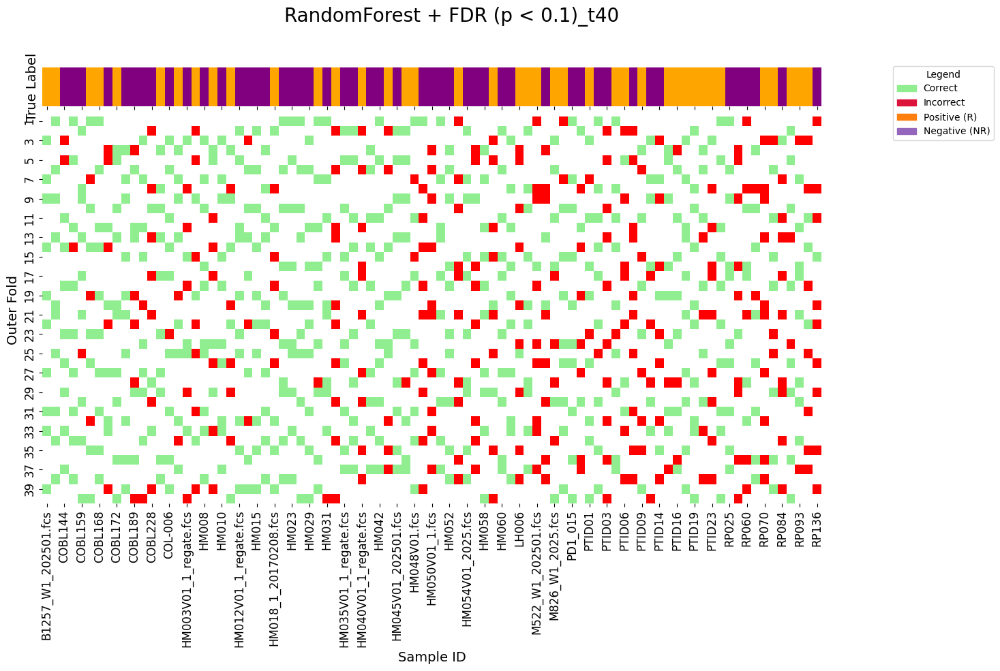

Always misclassified: 5
  HM034V01_1_regate.fcs, HM050V01_1.fcs, HM053V01_202501.fcs, PTID03, RP070
Sometimes misclassified: 56
  HM040V01_1_regate.fcs, HM049V01_2025.fcs, PTID08, PTID23, RP042, RP084, HM003V01_1_regate.fcs, HM055, HM059V01_202501.fcs, LH006, HM009V01_1_regate.fcs, M522_W1_202501.fcs, RP099, RP136, COBL169, COBL228, HM006, M530_W1_2025.fcs, PD1_024, RP060, HM014, HM018_1_20170208.fcs, PTID06, PTID14, RP068, COBL144, HM011V01_1.fcs, HM044, HM048V01.fcs, B1257_W1_202501.fcs, COBL189, HM001V01_1_regate.fcs, M828_W1_202501_1.fcs, PTID12, PTID16, PTID22, RP075, RP093, COBL155, COBL159, COBL166, COBL178, HM030V01_1_regate.fcs, HM031, HM046, M826_W1_2025.fcs, PTID01, RP091, COBL203, COL-006, HM012V01_1_regate.fcs, HM045V01_202501.fcs, PTID02, PTID04, PTID09, PTID15


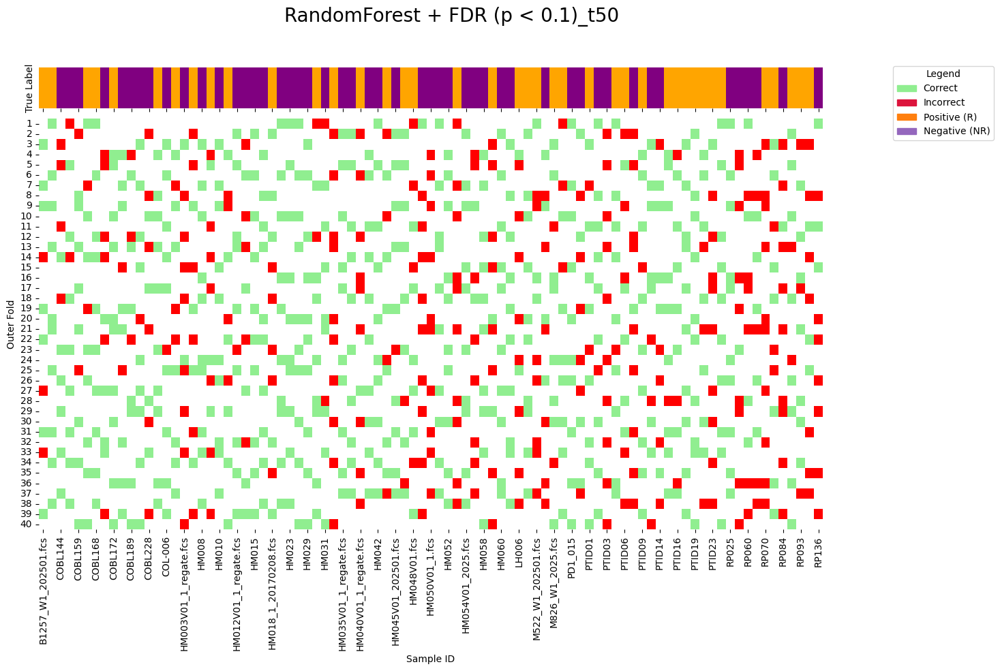

Always misclassified: 11
  COBL228, HM006, HM034V01_1_regate.fcs, HM040V01_1_regate.fcs, HM050V01_1.fcs, HM059V01_202501.fcs, LH006, PTID03, PTID08, RP070, RP093
Sometimes misclassified: 51
  COBL144, HM018_1_20170208.fcs, HM053V01_202501.fcs, RP099, RP136, PTID14, RP042, RP084, COBL189, HM009V01_1_regate.fcs, HM044, HM055, M530_W1_2025.fcs, PTID01, RP068, COBL169, HM049V01_2025.fcs, M522_W1_202501.fcs, PD1_024, PTID09, PTID12, COBL166, COBL178, COBL203, HM010, HM011V01_1.fcs, HM030V01_1_regate.fcs, HM061V01_2025.fcs, M828_W1_202501_1.fcs, PTID06, PTID22, PTID23, RP075, COBL159, HM041V01_1_regate.fcs, HM045V01_202501.fcs, HM048V01.fcs, HM051, PD1_015, PTID02, RP010, B1257_W1_202501.fcs, COBL155, COBL168, HM003V01_1_regate.fcs, HM035V01_1_regate.fcs, HM046, PTID04, PTID15, PTID17, RP091


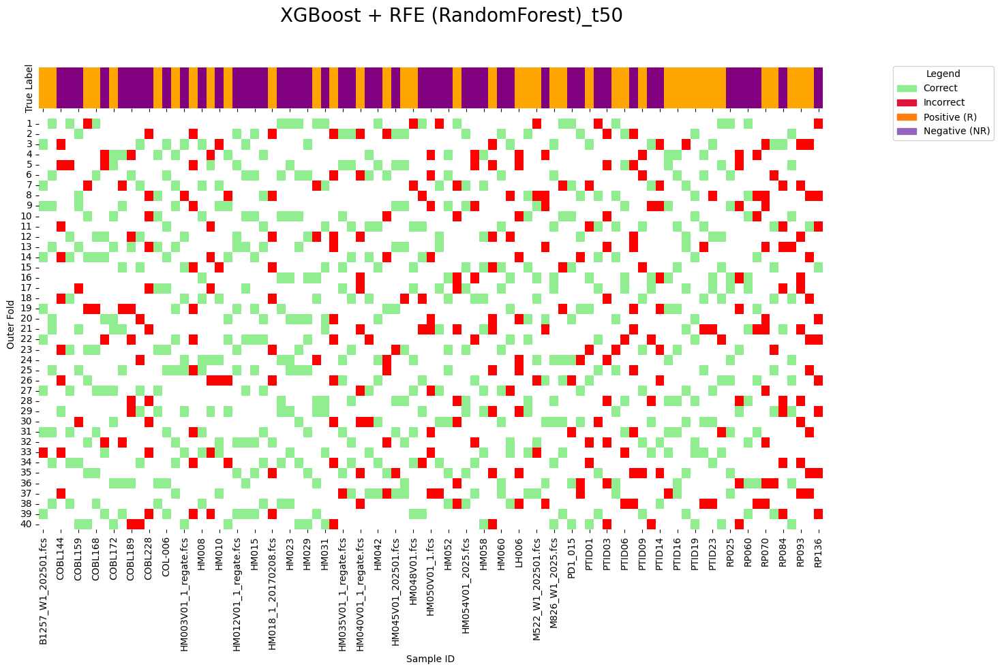

Always misclassified: 7
  COBL144, HM040V01_1_regate.fcs, HM050V01_1.fcs, HM053V01_202501.fcs, LH006, PTID08, RP070
Sometimes misclassified: 54
  COBL228, HM006, HM018_1_20170208.fcs, HM034V01_1_regate.fcs, HM059V01_202501.fcs, PTID03, PTID14, RP084, RP093, RP099, HM055, M530_W1_2025.fcs, RP136, HM044, COBL203, HM009V01_1_regate.fcs, HM049V01_2025.fcs, PTID01, RP042, COBL189, M826_W1_2025.fcs, PTID12, PTID23, RP068, COBL159, COBL166, COBL169, COBL178, HM011V01_1.fcs, HM014, M522_W1_202501.fcs, HM003V01_1_regate.fcs, HM010, HM030V01_1_regate.fcs, HM041V01_1_regate.fcs, HM045V01_202501.fcs, HM061V01_2025.fcs, PD1_024, PTID02, PTID09, PTID17, PTID22, RP075, B1257_W1_202501.fcs, COBL155, COBL168, HM023, HM035V01_1_regate.fcs, HM048V01.fcs, M828_W1_202501_1.fcs, PD1_015, PTID06, RP025, RP060


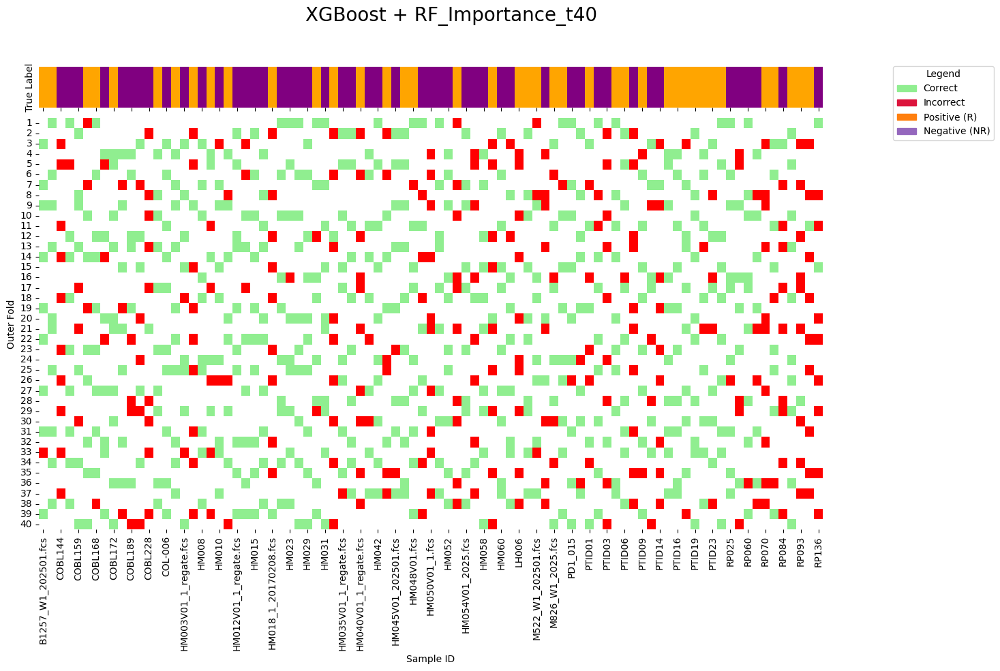

Always misclassified: 8
  COBL144, HM018_1_20170208.fcs, HM034V01_1_regate.fcs, HM050V01_1.fcs, LH006, PTID08, RP070, RP099
Sometimes misclassified: 57
  HM006, HM040V01_1_regate.fcs, HM053V01_202501.fcs, HM055, PTID03, RP042, RP084, COBL228, HM009V01_1_regate.fcs, HM059V01_202501.fcs, M530_W1_2025.fcs, PTID14, RP136, HM014, HM049V01_2025.fcs, RP093, M826_W1_2025.fcs, PTID01, PTID09, PTID12, PTID23, COBL169, COBL189, HM044, M522_W1_202501.fcs, COBL155, COBL159, COBL166, COBL168, COBL178, COBL203, PD1_024, RP068, RP075, HM003V01_1_regate.fcs, HM010, HM011V01_1.fcs, HM030V01_1_regate.fcs, HM041V01_1_regate.fcs, M828_W1_202501_1.fcs, PTID06, PTID16, PTID17, PTID22, B364_W1_2025.fcs, HM001V01_1_regate.fcs, HM023, HM031, HM035V01_1_regate.fcs, HM038V01_1_regate.fcs, HM045V01_202501.fcs, HM048V01.fcs, HM051, PD1_015, PTID04, PTID15, RP010


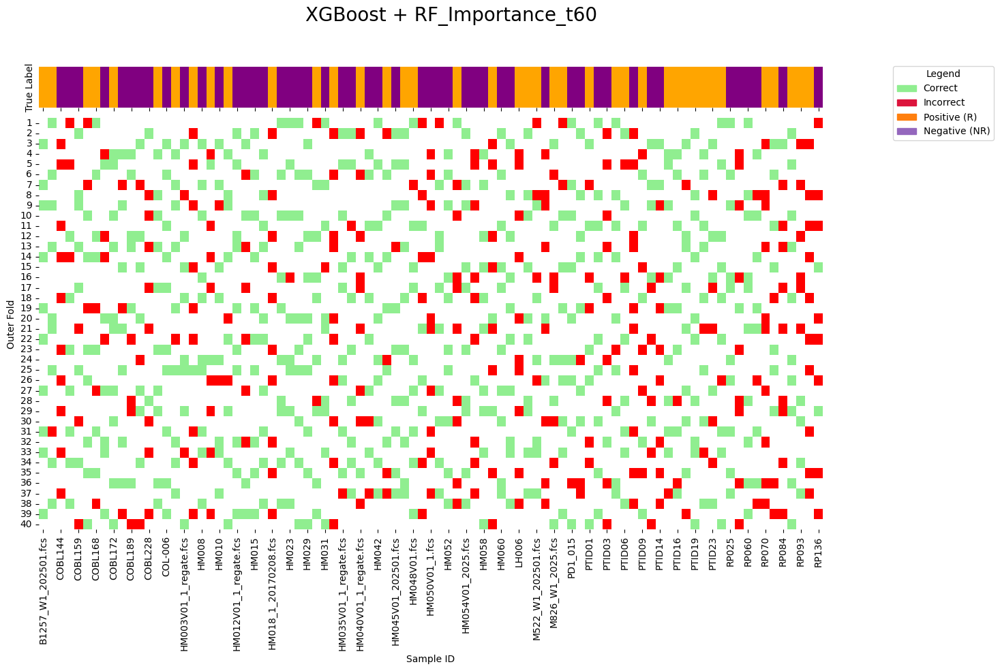

Always misclassified: 9
  HM034V01_1_regate.fcs, HM040V01_1_regate.fcs, HM050V01_1.fcs, HM053V01_202501.fcs, PTID03, PTID08, RP042, RP070, RP084
Sometimes misclassified: 50
  HM006, HM049V01_2025.fcs, HM059V01_202501.fcs, LH006, PTID23, PTID14, RP136, HM018_1_20170208.fcs, HM055, M522_W1_202501.fcs, PTID06, PTID16, RP093, RP099, COBL228, HM003V01_1_regate.fcs, HM009V01_1_regate.fcs, M530_W1_2025.fcs, COBL144, HM001V01_1_regate.fcs, PTID22, RP060, COBL169, HM044, PTID01, COBL166, HM011V01_1.fcs, HM014, HM030V01_1_regate.fcs, HM048V01.fcs, M828_W1_202501_1.fcs, PD1_024, PTID12, PTID15, RP068, COBL159, COBL168, COBL189, M826_W1_2025.fcs, PTID09, B1257_W1_202501.fcs, COBL203, COL-006, HM010, HM046, HM061V01_2025.fcs, PD1_015, PTID02, PTID04, RP091


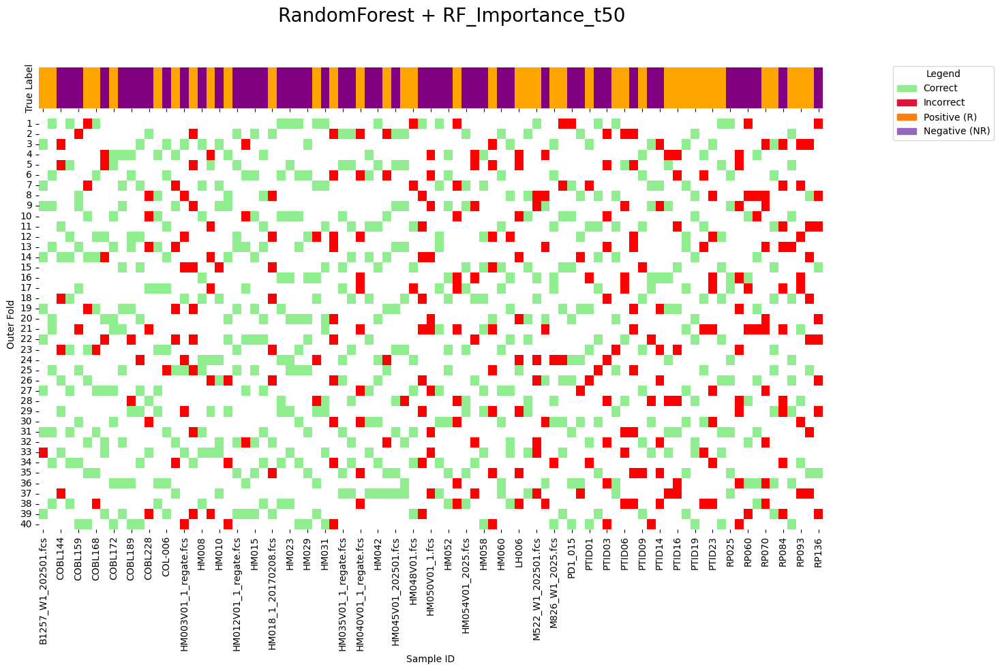

Always misclassified: 12
  COBL144, COBL228, HM006, HM034V01_1_regate.fcs, HM040V01_1_regate.fcs, HM050V01_1.fcs, HM053V01_202501.fcs, LH006, PTID03, PTID08, RP070, RP099
Sometimes misclassified: 52
  RP084, RP136, HM009V01_1_regate.fcs, HM018_1_20170208.fcs, HM059V01_202501.fcs, M530_W1_2025.fcs, HM055, PTID14, RP042, RP093, HM044, COBL169, COBL189, COBL203, HM061V01_2025.fcs, PTID01, PTID12, PTID23, RP068, RP075, COBL178, HM010, HM011V01_1.fcs, HM030V01_1_regate.fcs, HM048V01.fcs, HM049V01_2025.fcs, M522_W1_202501.fcs, M828_W1_202501_1.fcs, PD1_024, PTID09, COBL159, COBL166, HM014, HM041V01_1_regate.fcs, M826_W1_2025.fcs, PTID22, RP010, B1257_W1_202501.fcs, B364_W1_2025.fcs, COBL155, COBL168, HM001V01_1_regate.fcs, HM003V01_1_regate.fcs, HM023, HM035V01_1_regate.fcs, HM046, HM051, PTID02, PTID15, PTID17, RP060, RP091


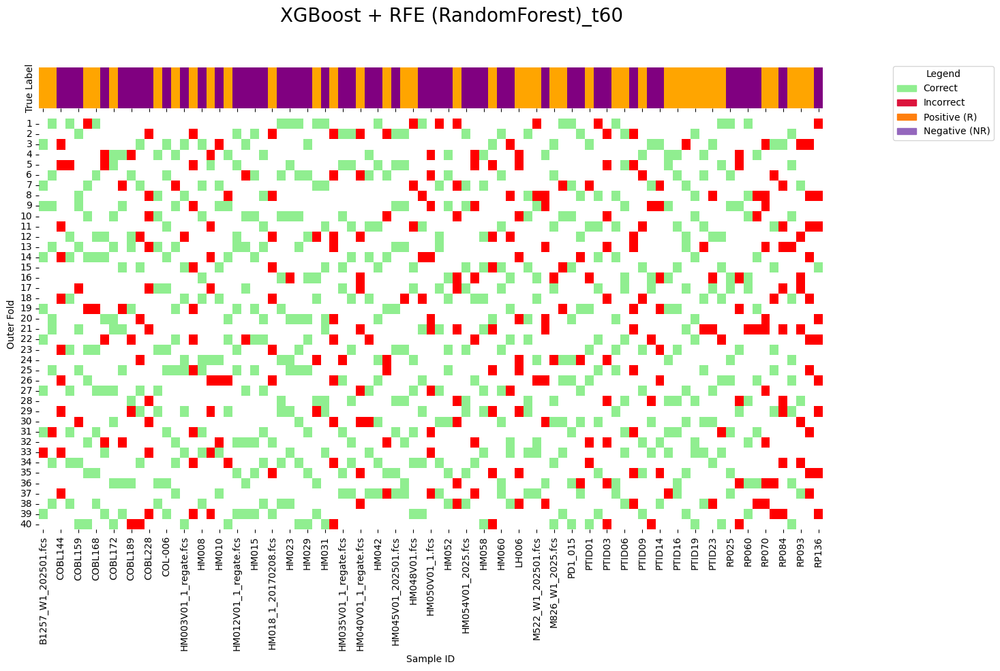

Always misclassified: 6
  HM034V01_1_regate.fcs, HM040V01_1_regate.fcs, HM050V01_1.fcs, HM053V01_202501.fcs, PTID03, RP070
Sometimes misclassified: 54
  HM006, HM049V01_2025.fcs, LH006, PTID08, RP042, RP084, HM059V01_202501.fcs, PTID23, RP060, RP136, COBL169, HM014, HM055, PD1_024, RP099, COBL228, HM009V01_1_regate.fcs, HM011V01_1.fcs, M522_W1_202501.fcs, PTID14, COBL189, HM003V01_1_regate.fcs, HM018_1_20170208.fcs, M530_W1_2025.fcs, PTID06, PTID22, PTID16, RP075, HM001V01_1_regate.fcs, HM031, HM044, HM048V01.fcs, PTID01, PTID09, PTID12, RP068, RP091, RP093, COBL159, COBL166, HM010, HM046, M828_W1_202501_1.fcs, PTID04, B1257_W1_202501.fcs, COBL144, COBL155, COBL178, COL-006, HM030V01_1_regate.fcs, HM041V01_1_regate.fcs, HM045V01_202501.fcs, M826_W1_2025.fcs, RP010


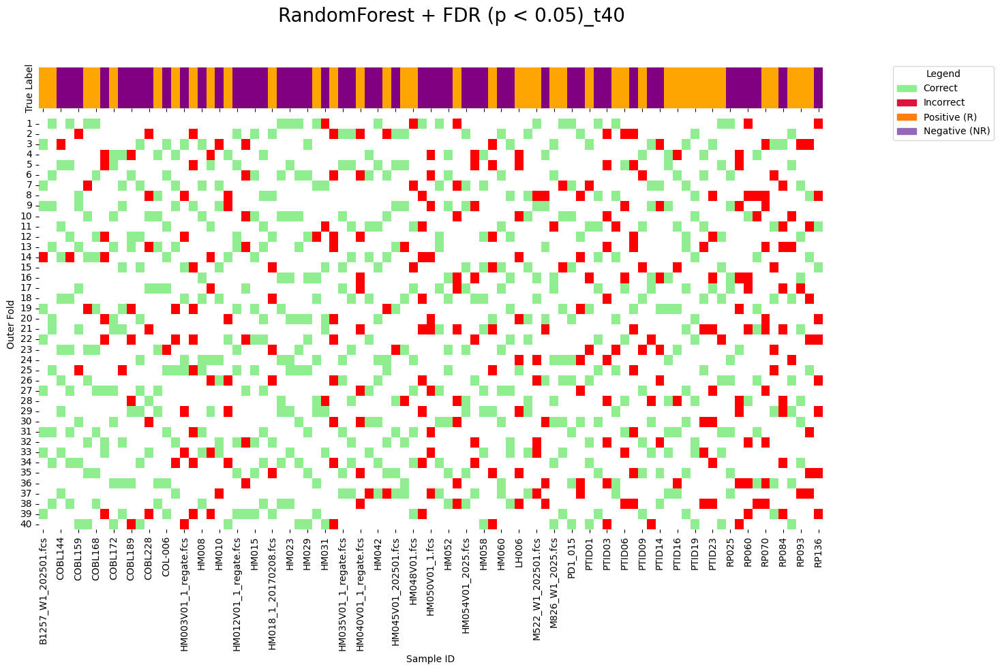

Always misclassified: 10
  COBL228, HM006, HM034V01_1_regate.fcs, HM040V01_1_regate.fcs, HM050V01_1.fcs, LH006, PTID03, PTID08, RP070, RP093
Sometimes misclassified: 52
  COBL144, HM018_1_20170208.fcs, HM053V01_202501.fcs, HM059V01_202501.fcs, RP136, RP084, RP099, COBL189, HM009V01_1_regate.fcs, HM044, M530_W1_2025.fcs, PTID14, RP042, HM055, PTID01, COBL169, COBL178, HM049V01_2025.fcs, PD1_024, PTID09, PTID12, PTID23, RP068, RP075, COBL166, COBL168, COBL203, HM011V01_1.fcs, HM048V01.fcs, HM061V01_2025.fcs, M522_W1_202501.fcs, M828_W1_202501_1.fcs, PTID06, PTID17, COBL155, HM010, HM030V01_1_regate.fcs, HM041V01_1_regate.fcs, PTID02, PTID22, B1257_W1_202501.fcs, B364_W1_2025.fcs, COBL159, HM001V01_1_regate.fcs, HM003V01_1_regate.fcs, HM014, HM045V01_202501.fcs, HM051, M826_W1_2025.fcs, PTID15, RP010, RP091


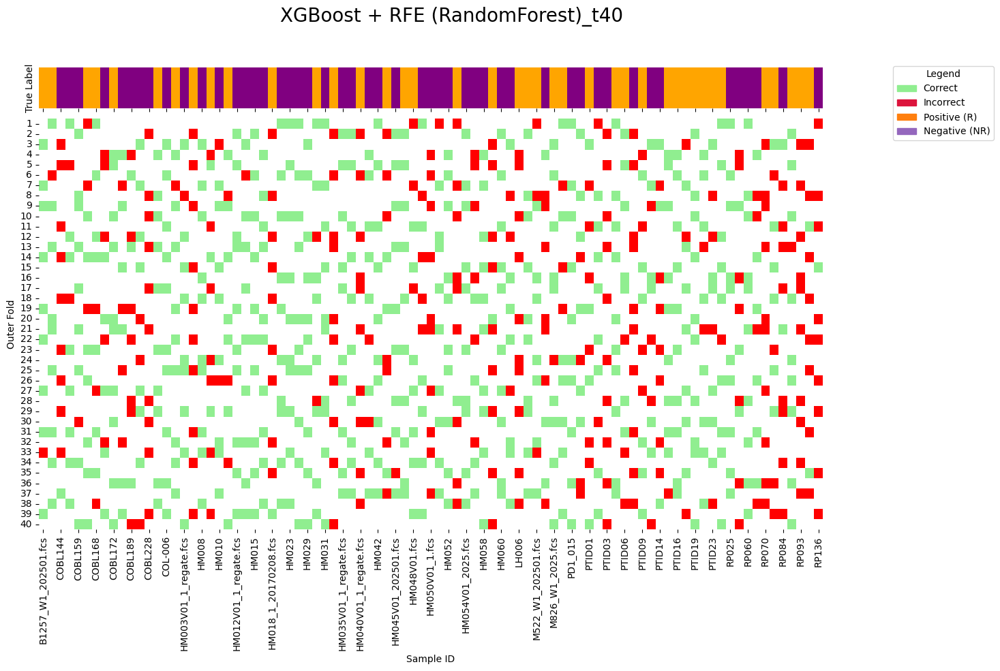

Always misclassified: 7
  HM034V01_1_regate.fcs, HM040V01_1_regate.fcs, HM050V01_1.fcs, HM059V01_202501.fcs, PTID03, RP070, RP084
Sometimes misclassified: 57
  HM006, HM049V01_2025.fcs, HM053V01_202501.fcs, PTID08, PTID23, COBL228, HM055, LH006, RP099, COBL144, COBL169, HM018_1_20170208.fcs, M826_W1_2025.fcs, RP093, PTID12, PTID14, RP042, RP136, COBL159, COBL189, M522_W1_202501.fcs, COBL155, HM009V01_1_regate.fcs, HM030V01_1_regate.fcs, HM044, PTID09, COBL166, COBL203, HM014, M530_W1_2025.fcs, M828_W1_202501_1.fcs, PTID16, PTID22, RP060, B1257_W1_202501.fcs, COBL178, HM003V01_1_regate.fcs, HM011V01_1.fcs, HM046, HM048V01.fcs, PD1_024, PTID06, PTID15, RP010, RP068, COBL168, HM001V01_1_regate.fcs, HM041V01_1_regate.fcs, HM045V01_202501.fcs, HM061V01_2025.fcs, PD1_015, PTID01, PTID02, PTID04, PTID17, RP075, RP091


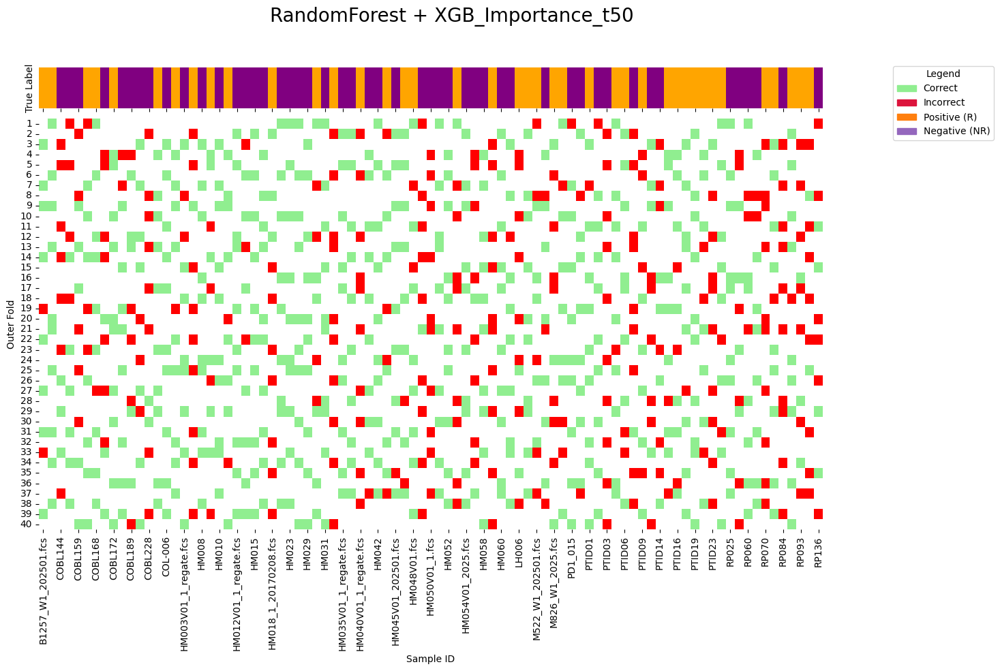


Generating Additional and Enhanced Analysis Plots...
Creating learning curve for best model: RandomForest + FDR (p < 0.1)_t40


  CV stability plot skipped: 'color_palette'



Generating Enhanced Performance Diagnostic Plots...



Assessing Statistical Significance of Performance Differences...
This heatmap shows p-values from a paired Wilcoxon test on model AUROC scores across CV folds.
Low p-values (e.g., < 0.05, dark red) suggest a statistically significant performance difference.



Generating Threshold Performance Comparison...



Generating Baseline vs Feature Selection Comparison...



BASELINE vs FEATURE SELECTION COMPARISON
Best Baseline Model:
  - XGBoost + All Features
  - AUROC: 0.7046 ± 0.0981
  - Features: 166

Best Feature Selection Model:
  - RandomForest + FDR (p < 0.1)_t40
  - AUROC: 0.7388 ± 0.1030
  - Features: 29.5

Performance Improvement:
  - AUROC difference: +0.0341
  - Relative improvement: +4.84%

Feature Selection Methods vs Baseline by Classifier:
  - XGBoost: 5/24 FS methods beat baseline

Feature Importance Analysis for Top 10 Models...

1. RandomForest + FDR (p < 0.1)_t40
   - Signature features: 11
   - Importance type: Feature Importance
   - Top 10 most important features:
      1. Bcells CD27posIgDneg_total       0.1914
      2. CD8 RO DR_CD3                    0.1217
      3. Treg memory_CD4                  0.1090
      4. CD16mono_CD3neg                  0.0926
      5. Tconv naive_total                0.0906
      6. CD16mono_myeloid                 0.0857
      7. CD4 Tconv_total                  0.0657
      8. CD3pos_total        


2. RandomForest + FDR (p < 0.1)_t50
   - Signature features: 5
   - Importance type: Feature Importance
   - Top 10 most important features:
      1. Bcells CD27posIgDneg_total       0.3231
      2. CD8 RO DR_CD3                    0.1996
      3. CD16mono_myeloid                 0.1974
      4. CD8 RO CD56_CD3                  0.1411
      5. CD4 Tconv_total                  0.1389



3. XGBoost + RFE (RandomForest)_t50
   - Signature features: 44
   - Importance type: Feature Importance
   - Top 10 most important features:
      1. Tconv memDR_Tconv                0.1280
      2. CD16+mono_total                  0.1000
      3. Bcells CD27posIgDneg_total       0.0956
      4. Tconv memCCR4_total              0.0489
      5. CD8 RO DR_CD3                    0.0440
      6. Bcells_CD3neg                    0.0415
      7. CD16mono_myeloid                 0.0406
      8. CCR5_CD8RO                       0.0382
      9. CD16mono_CD3neg                  0.0341
     10. Treg memory_CD3                  0.0335



4. XGBoost + RF_Importance_t40
   - Signature features: 69
   - Importance type: Feature Importance
   - Top 10 most important features:
      1. naive_Bcells                     0.1281
      2. CD16+mono_total                  0.0791
      3. CD8  RO Ki67_CD3                 0.0623
      4. Bcells CD27posIgDneg_total       0.0560
      5. CD4 Treg_CD4                     0.0408
      6. CD8 RO DR_CD3                    0.0373
      7. Tconv memCXCR3_Tconv             0.0352
      8. CD8 RO CCR5_total                0.0319
      9. Tconv mem_Tconv                  0.0319
     10. CD27IgD_Bcells                   0.0313



5. XGBoost + RF_Importance_t60
   - Signature features: 30
   - Importance type: Feature Importance
   - Top 10 most important features:
      1. nonTnonB_total                   0.1434
      2. CD4 Tconv mem_total              0.1122
      3. CD8 RO DR_CD3                    0.0891
      4. Bcells CD27posIgDneg_total       0.0813
      5. Tconv memDR_Tconv                0.0571
      6. CD16mono_myeloid                 0.0565
      7. CD27IgD_Bcells                   0.0496
      8. Tconv mem_CD3                    0.0396
      9. Tconv mem_Tconv                  0.0325
     10. CD14+16+mono_total               0.0299



6. RandomForest + RF_Importance_t50
   - Signature features: 45
   - Importance type: Feature Importance
   - Top 10 most important features:
      1. Bcells CD27posIgDneg_total       0.0600
      2. CD16mono_myeloid                 0.0450
      3. CD8 RO DR_CD3                    0.0444
      4. Tconv naive_total                0.0438
      5. CD4 Treg_CD4                     0.0396
      6. CD4 Tconv_total                  0.0351
      7. CD27IgD_Bcells                   0.0339
      8. Treg memory_CD4                  0.0337
      9. CD16mono_CD3neg                  0.0322
     10. Tconv memPD1_total               0.0315



7. XGBoost + RFE (RandomForest)_t60
   - Signature features: 20
   - Importance type: Feature Importance
   - Top 10 most important features:
      1. Bcells CD27posIgDneg_total       0.1681
      2. CD16mono_myeloid                 0.0964
      3. CCR5_CD8RO                       0.0853
      4. CD8 RO DR_CD3                    0.0839
      5. CD16+mono_total                  0.0814
      6. Bcells_CD3neg                    0.0631
      7. CD8 RO DR_total                  0.0606
      8. Treg memory_CD4                  0.0423
      9. Bcells memory_CD3neg             0.0406
     10. CD16mono_CD3neg                  0.0389



8. RandomForest + FDR (p < 0.05)_t40
   - Signature features: 2
   - Importance type: Feature Importance
   - Top 10 most important features:
      1. Bcells CD27posIgDneg_total       0.5499
      2. CD27IgD_Bcells                   0.4501



9. XGBoost + RFE (RandomForest)_t40
   - Signature features: 84
   - Importance type: Feature Importance
   - Top 10 most important features:
      1. CD16+mono_total                  0.0962
      2. Tconv memCCR6_CD3                0.0782
      3. Bcells CD27posIgDneg_total       0.0681
      4. CD8  RO Ki67_CD3                 0.0495
      5. CD8 RO DR_CD3                    0.0472
      6. Tconv memDR_Tconv                0.0471
      7. Bcells_CD3neg                    0.0463
      8. CD4 Treg_CD4                     0.0453
      9. memory_Bcells                    0.0416
     10. CD16mono_myeloid                 0.0393



10. RandomForest + XGB_Importance_t50
   - Signature features: 8
   - Importance type: Feature Importance
   - Top 10 most important features:
      1. Bcells CD27posIgDneg_total       0.1938
      2. CD8 RO DR_CD3                    0.1535
      3. CD27IgD_Bcells                   0.1308
      4. CD16mono_myeloid                 0.1231
      5. Tconv mem_Tconv                  0.1156
      6. naive_Bcells                     0.0965
      7. Tconv memPD1_total               0.0939
      8. Ki67_Bcells                      0.0928



Sample-level Misclassification Summary for Top 10 Models...
1. RandomForest + FDR (p < 0.1)_t40
   - Unique samples evaluated: 89
   - Always misclassified: 7
   - Sometimes misclassified: 50
   - Always misclassified samples:
     HM034V01_1_regate.fcs, HM040V01_1_regate.fcs, HM050V01_1.fcs, HM053V01_202501.fcs, PTID03, PTID08, RP070
   - Sometimes misclassified samples:
     HM049V01_2025.fcs, HM055, LH006, M522_W1_202501.fcs, PTID23, RP042, RP084, RP136, HM059V01_202501.fcs, M530_W1_2025.fcs, COBL228, HM006, PD1_024, PTID06, PTID14, RP099, HM009V01_1_regate.fcs, COBL169, COBL189, HM003V01_1_regate.fcs, HM011V01_1.fcs, HM018_1_20170208.fcs, HM044, PTID09, RP060, M826_W1_2025.fcs, PTID12, PTID22, COBL166, HM014, PTID16, RP075, COBL144, COBL203, HM001V01_1_regate.fcs, HM048V01.fcs, M828_W1_202501_1.fcs, PTID01, PTID15, RP068, RP091, RP093, COBL155, COBL159, COL-006, HM030V01_1_regate.fcs, HM031, HM046, PTID02, PTID04

2. RandomForest + FDR (p < 0.1)_t50
   - Unique samples evaluated: 

✅ Threshold analysis exported to threshold_analysis.xlsx
✅ Models/Metrics/Features exported to models_metrics_features.xlsx and models_metrics_features.csv

Deep Dive SHAP Analysis for Top 10 Models

--- Analyzing Model #1: RandomForest + FDR (p < 0.1)_t40 ---
  - Using signature with 11 features for SHAP analysis.


SHAP for RandomForest:   0%|          | 0/40 [00:00<?, ?it/s]

  - Generating aggregated SHAP Summary Plot...


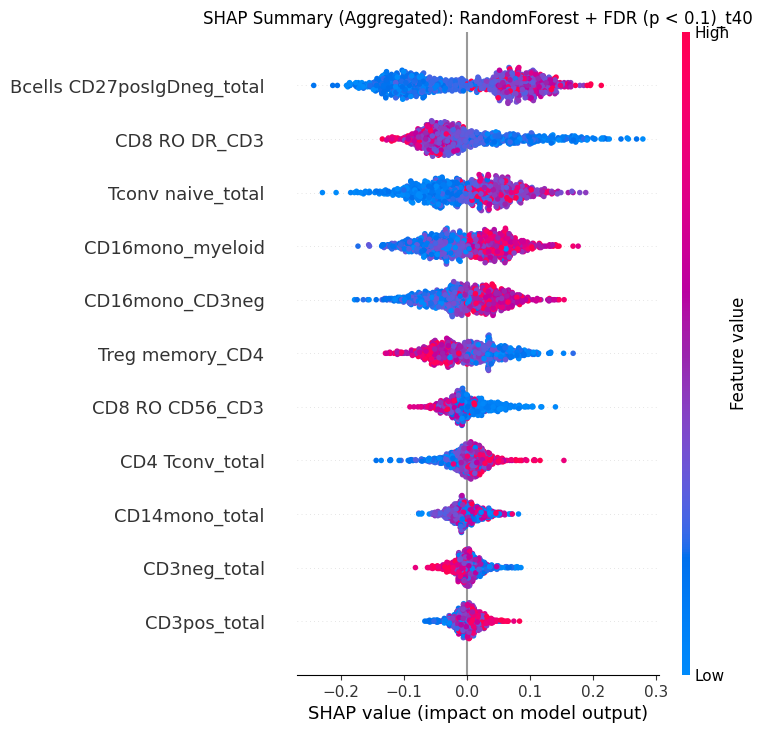


  - Generating SHAP Decision Plots for Prediction Categories...
    - Plotting for True Positives (244 samples)...


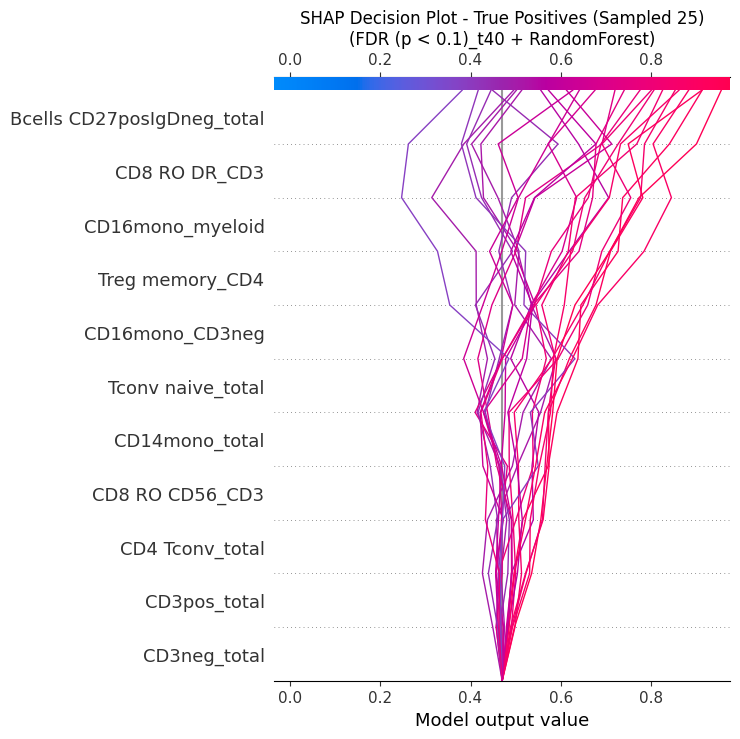

    - Plotting for True Negatives (348 samples)...


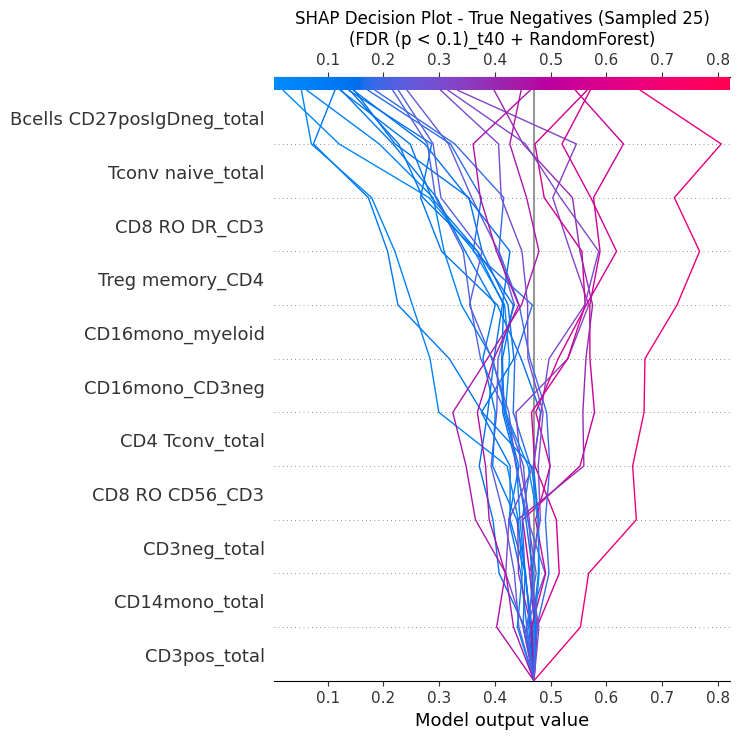

    - Plotting for False Positives (142 samples)...


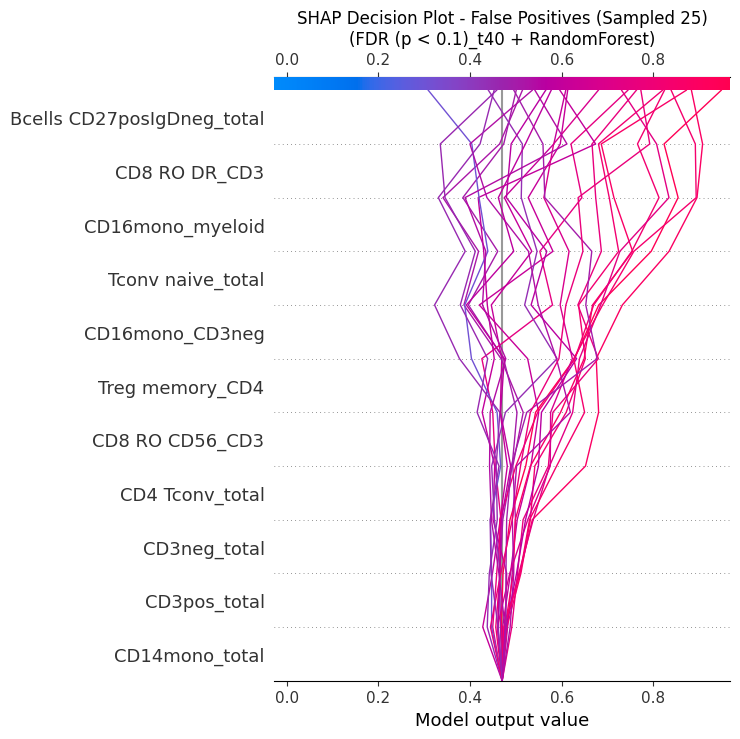

    - Plotting for False Negatives (156 samples)...


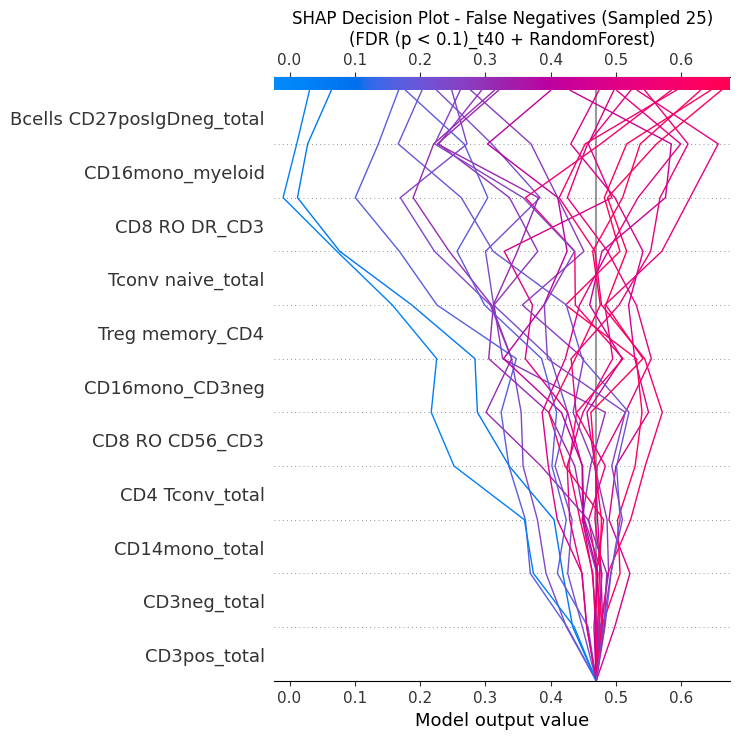


--- Analyzing Model #2: RandomForest + FDR (p < 0.1)_t50 ---
  - Using signature with 5 features for SHAP analysis.


SHAP for RandomForest:   0%|          | 0/40 [00:00<?, ?it/s]

  - Generating aggregated SHAP Summary Plot...


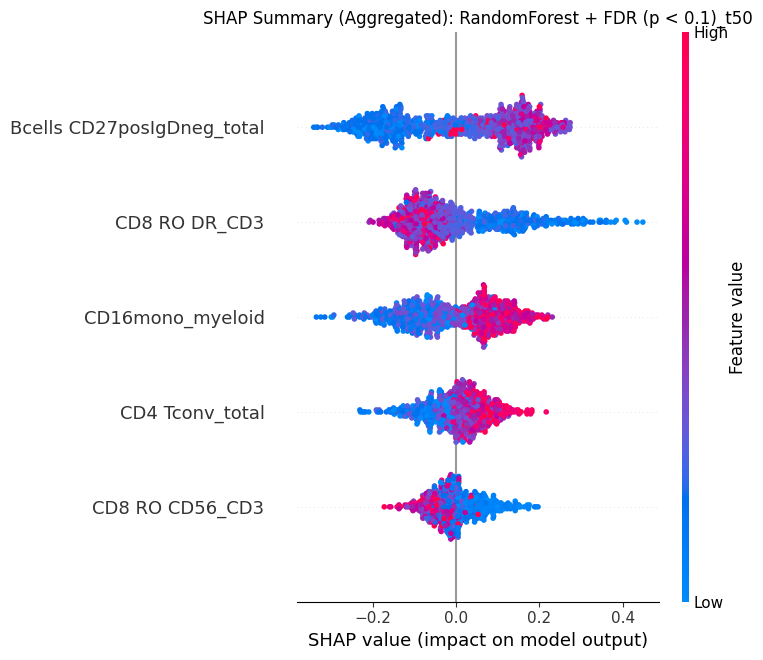


  - Generating SHAP Decision Plots for Prediction Categories...
    - Plotting for True Positives (251 samples)...


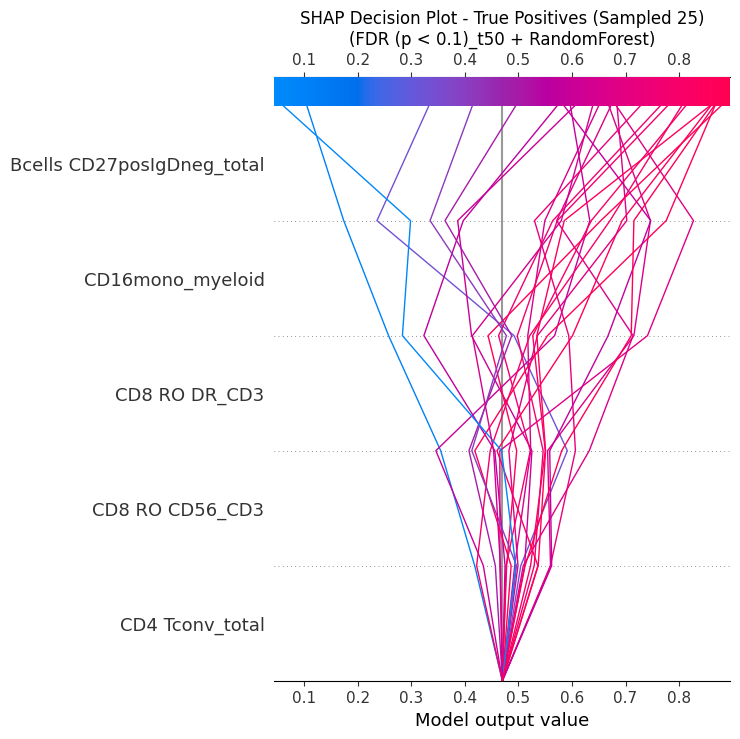

    - Plotting for True Negatives (343 samples)...


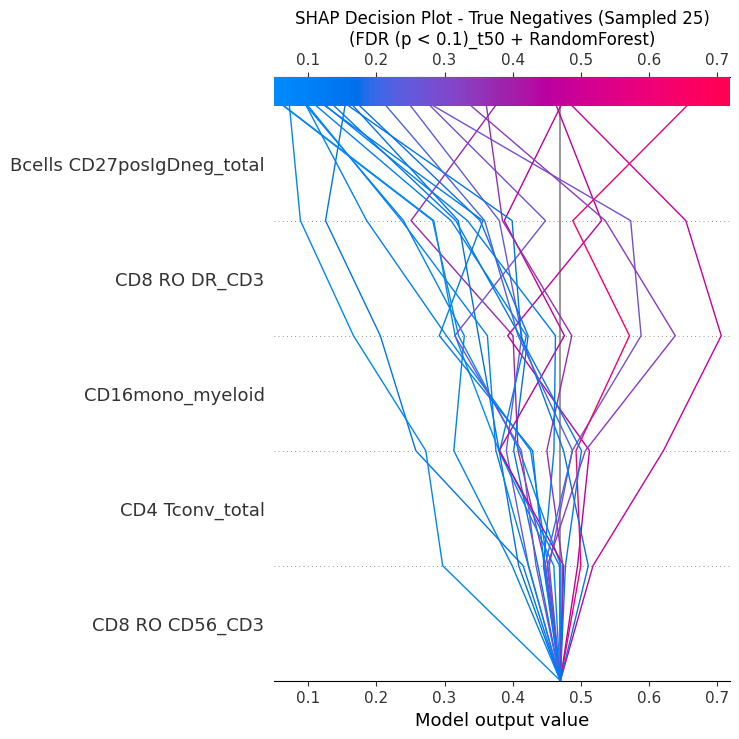

    - Plotting for False Positives (147 samples)...


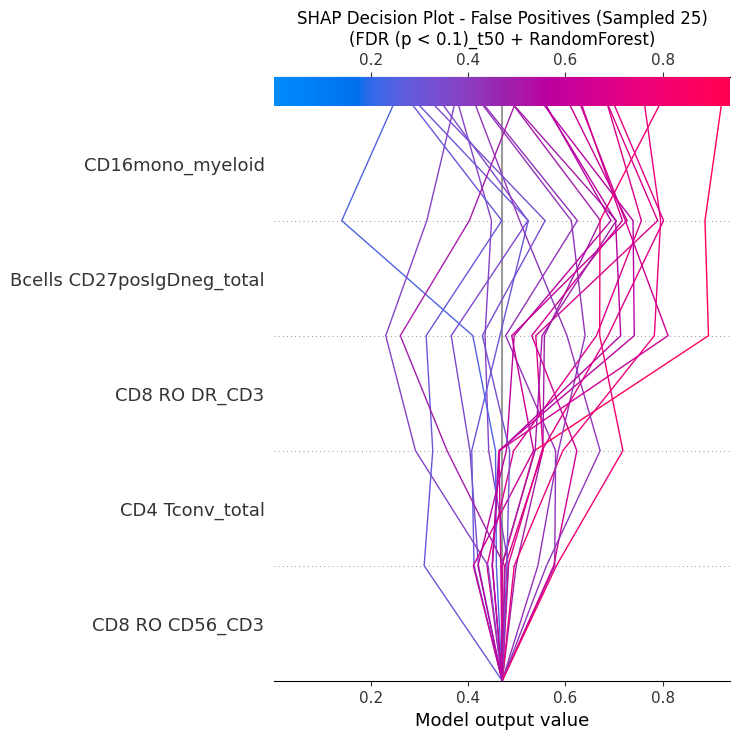

    - Plotting for False Negatives (149 samples)...


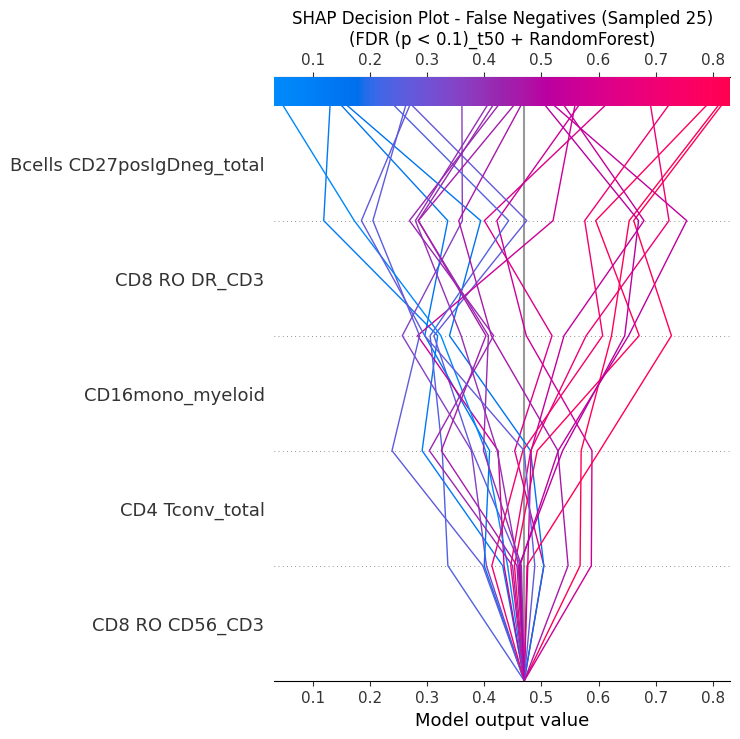


--- Analyzing Model #3: XGBoost + RFE (RandomForest)_t50 ---
  - Using signature with 44 features for SHAP analysis.


SHAP for XGBoost:   0%|          | 0/40 [00:00<?, ?it/s]

  - Generating aggregated SHAP Summary Plot...


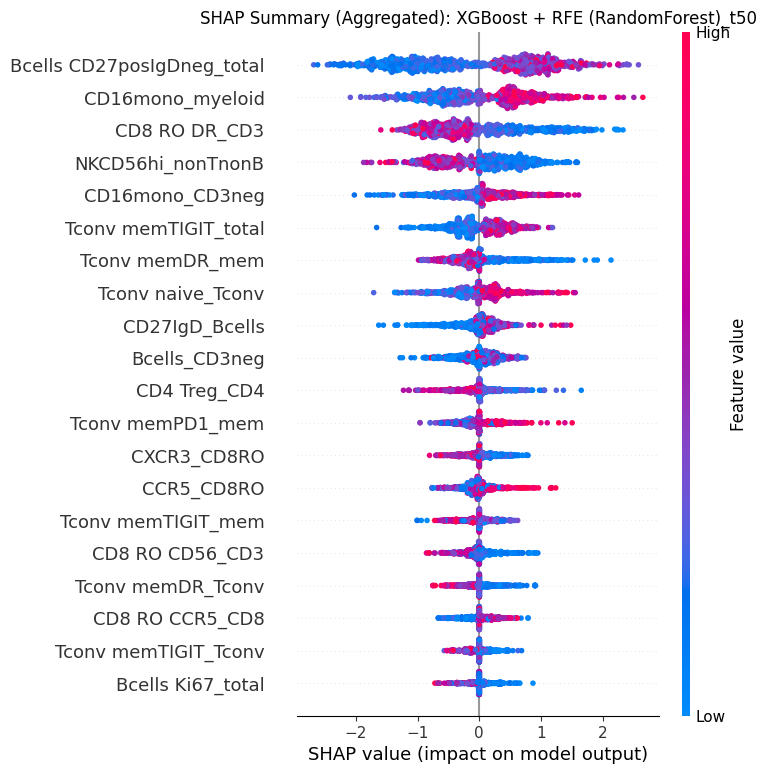


  - Generating SHAP Decision Plots for Prediction Categories...
    - Plotting for True Positives (241 samples)...


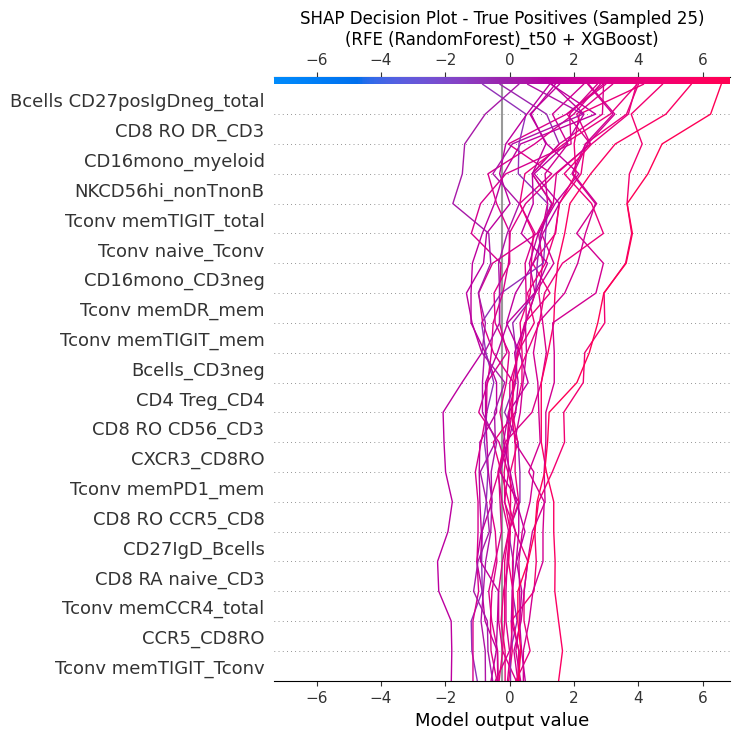

    - Plotting for True Negatives (341 samples)...


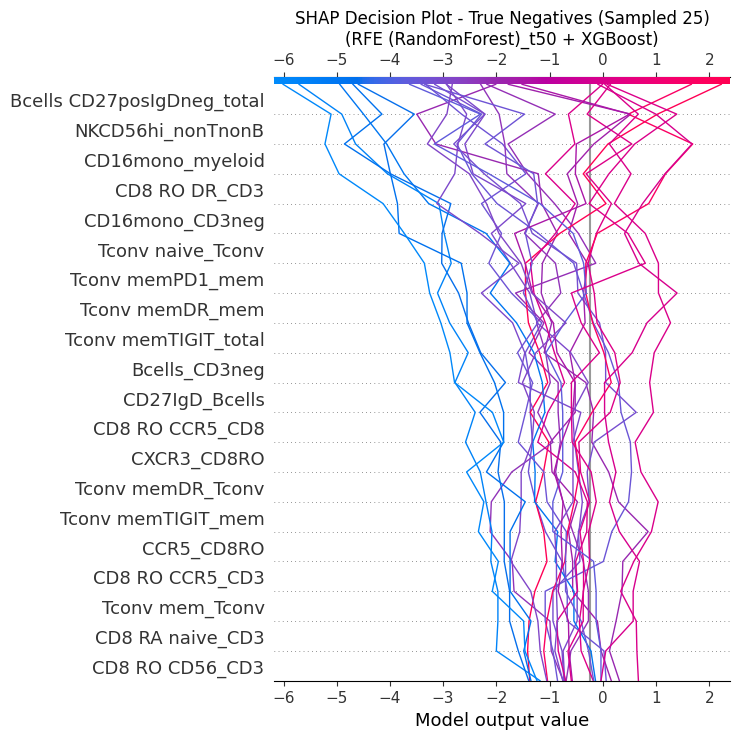

    - Plotting for False Positives (149 samples)...


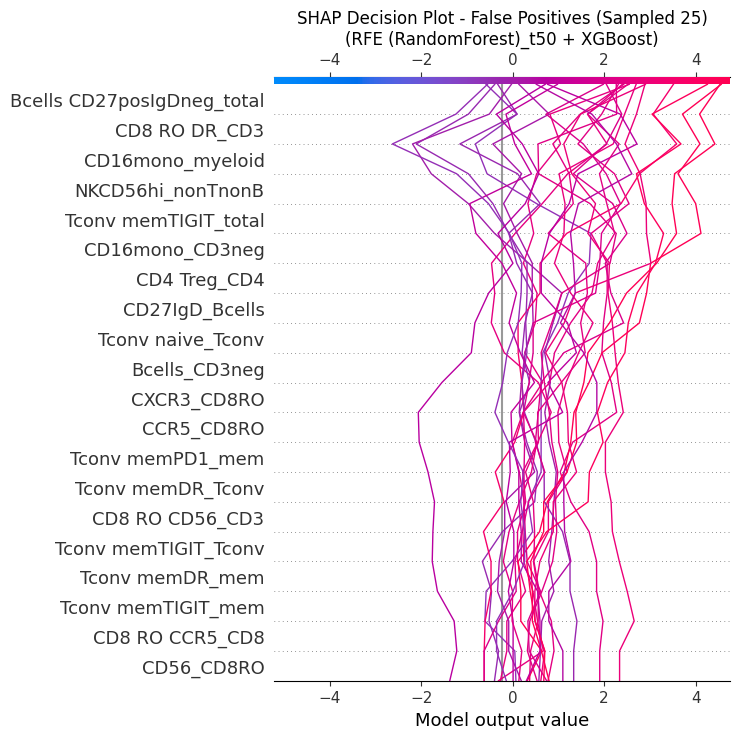

    - Plotting for False Negatives (159 samples)...


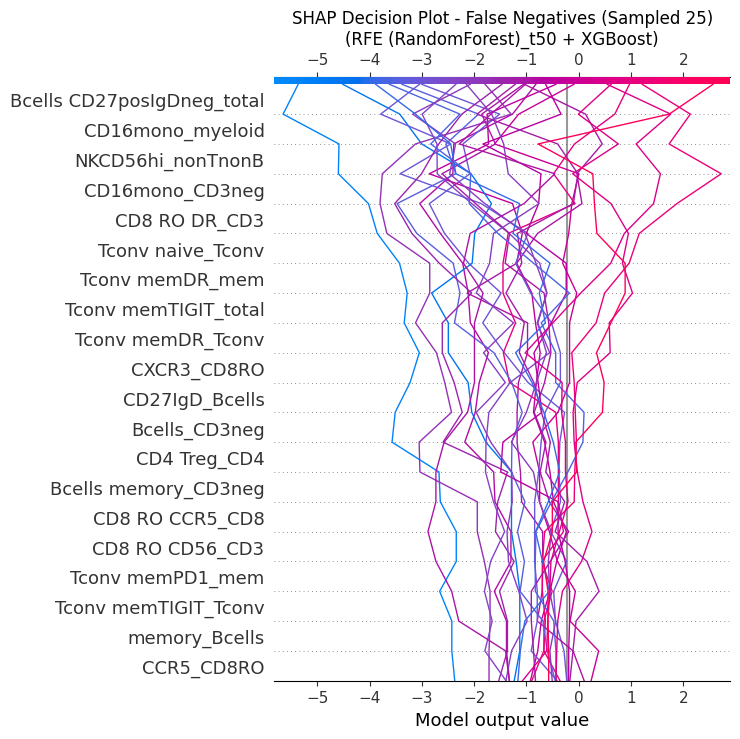


--- Analyzing Model #4: XGBoost + RF_Importance_t40 ---
  - Using signature with 69 features for SHAP analysis.


SHAP for XGBoost:   0%|          | 0/40 [00:00<?, ?it/s]

  - Generating aggregated SHAP Summary Plot...


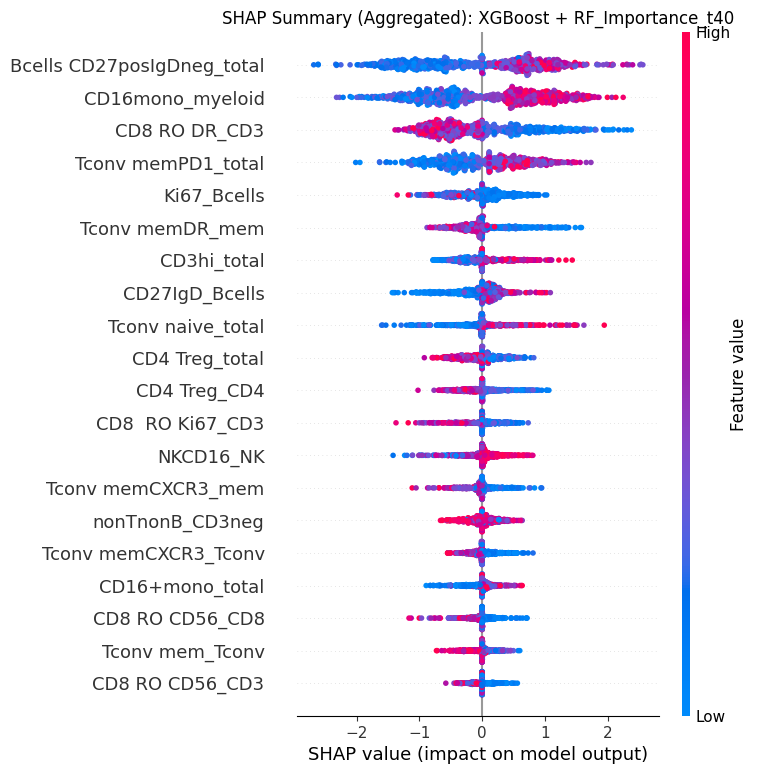


  - Generating SHAP Decision Plots for Prediction Categories...
    - Plotting for True Positives (258 samples)...


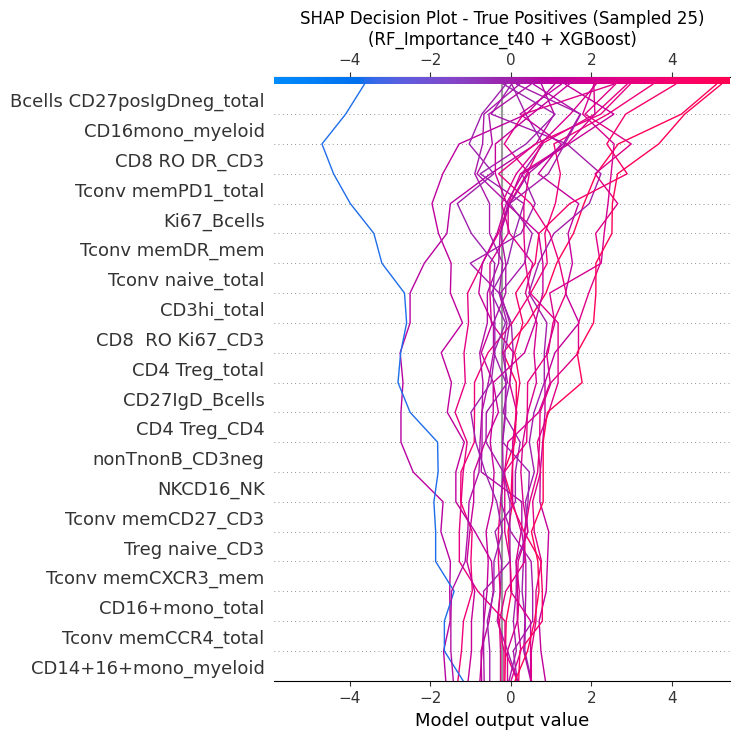

    - Plotting for True Negatives (341 samples)...


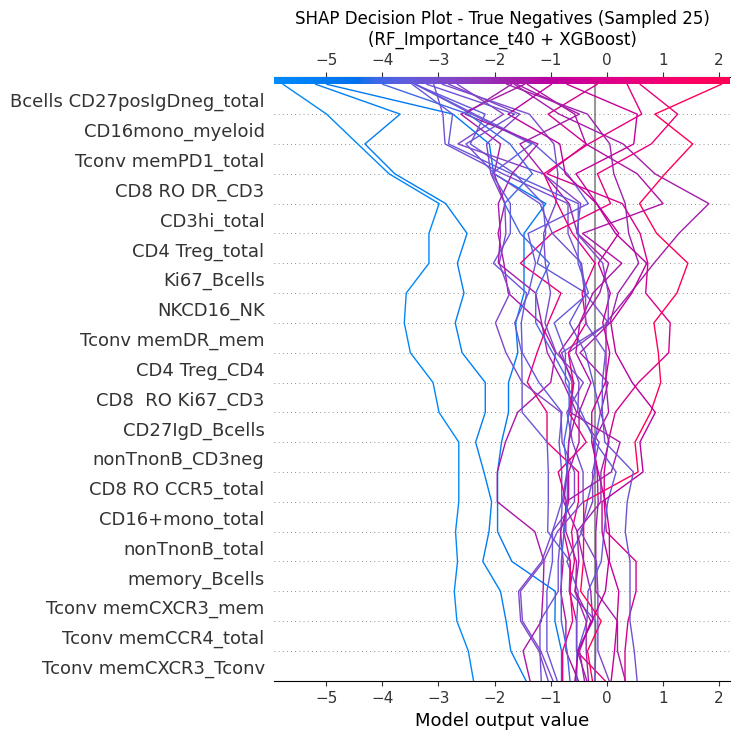

    - Plotting for False Positives (149 samples)...


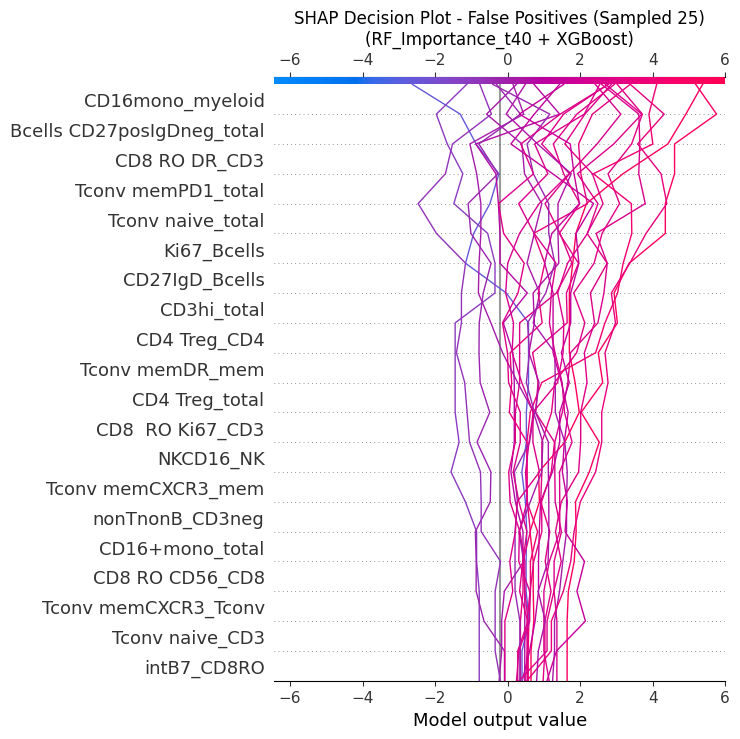

    - Plotting for False Negatives (142 samples)...


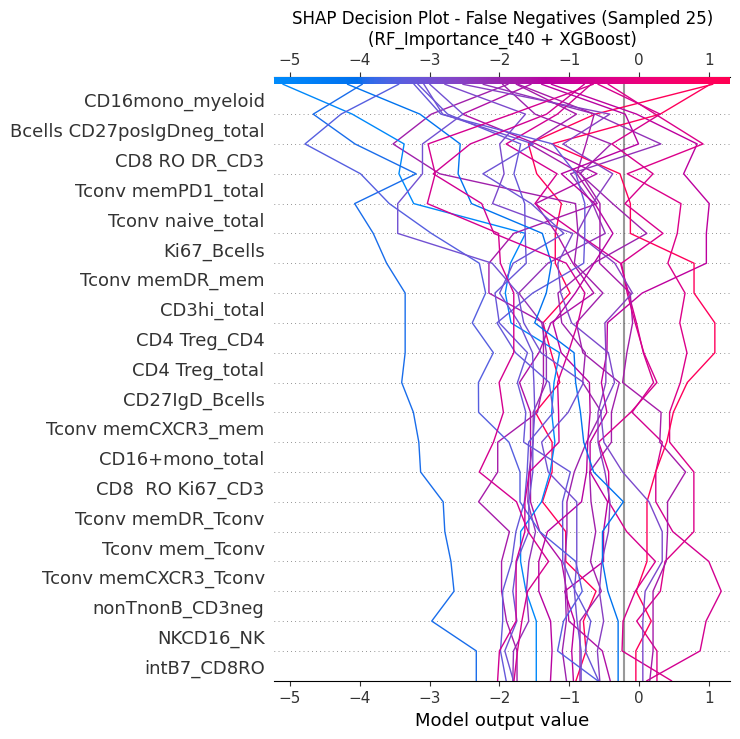


--- Analyzing Model #5: XGBoost + RF_Importance_t60 ---
  - Using signature with 30 features for SHAP analysis.


SHAP for XGBoost:   0%|          | 0/40 [00:00<?, ?it/s]

  - Generating aggregated SHAP Summary Plot...


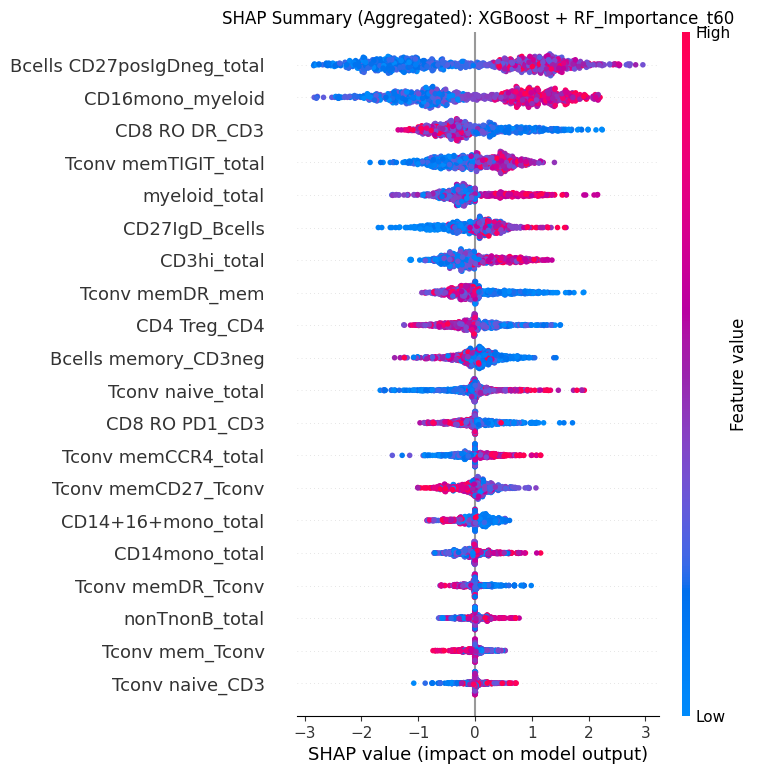


  - Generating SHAP Decision Plots for Prediction Categories...
    - Plotting for True Positives (244 samples)...


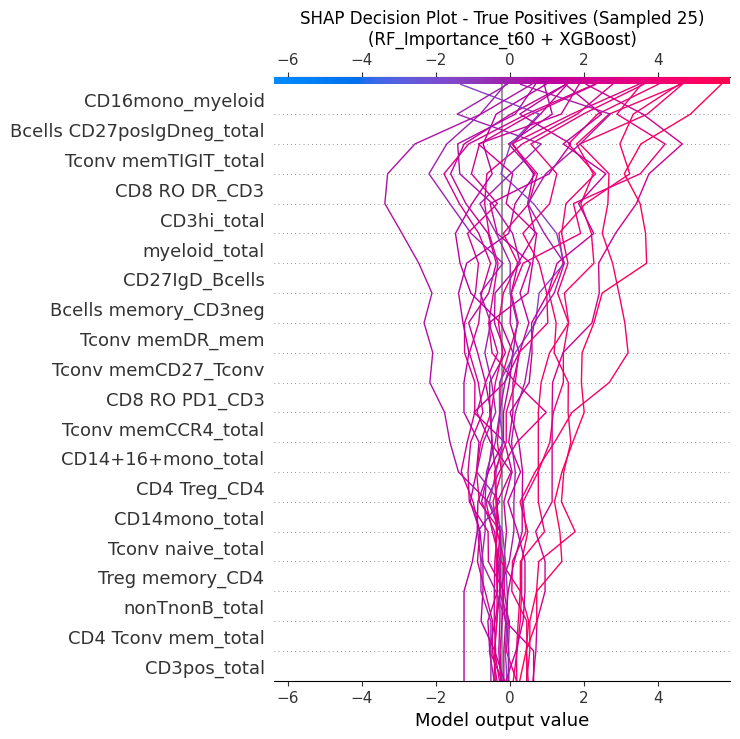

    - Plotting for True Negatives (336 samples)...


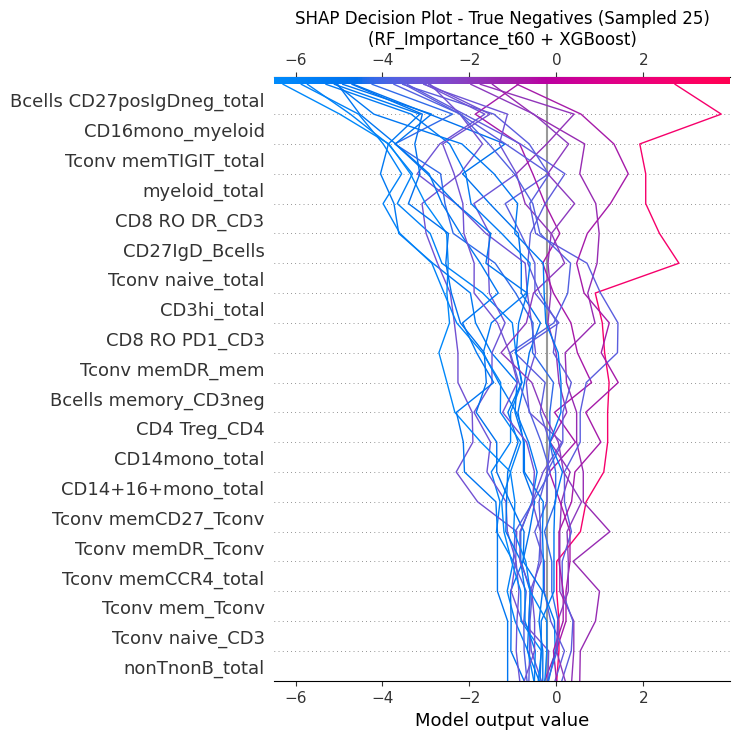

    - Plotting for False Positives (154 samples)...


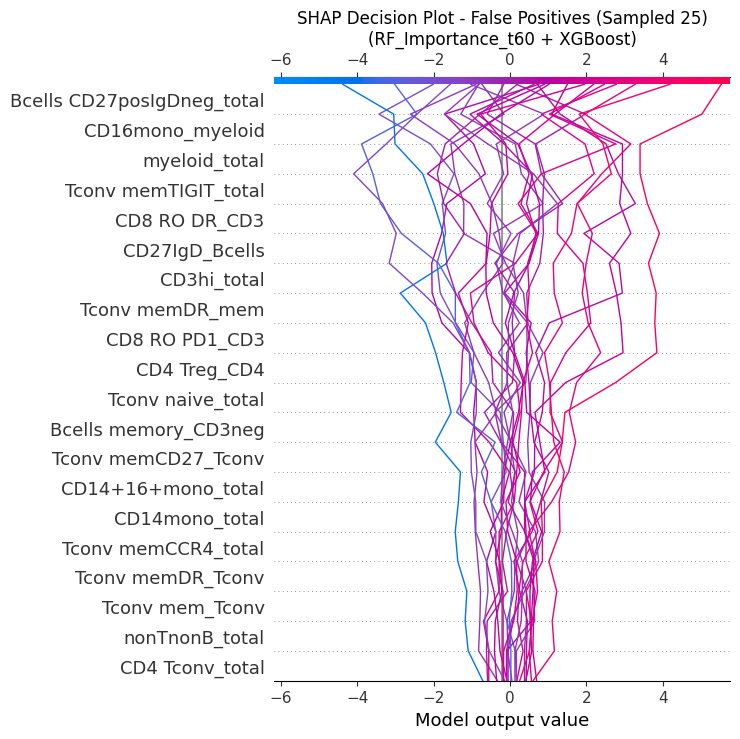

    - Plotting for False Negatives (156 samples)...


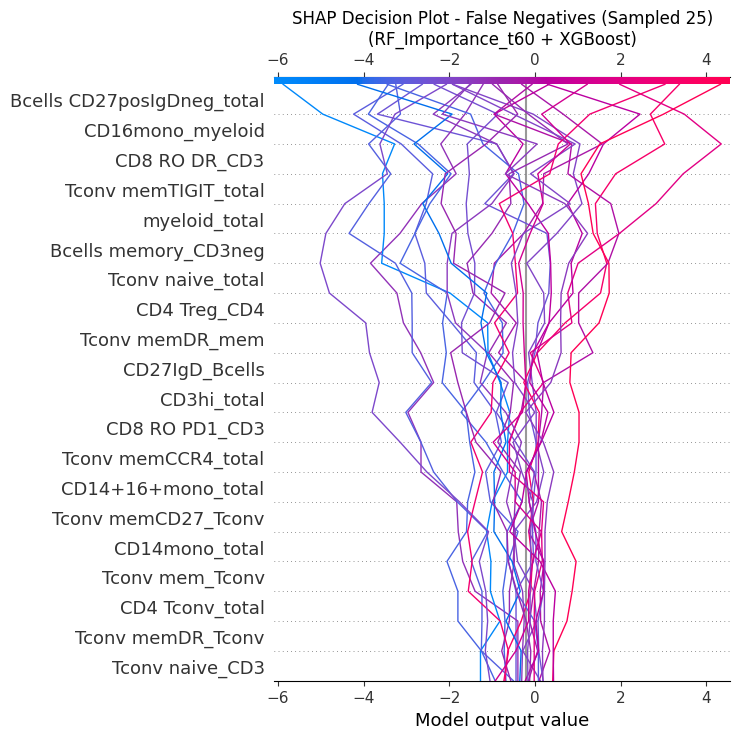


--- Analyzing Model #6: RandomForest + RF_Importance_t50 ---
  - Using signature with 45 features for SHAP analysis.


SHAP for RandomForest:   0%|          | 0/40 [00:00<?, ?it/s]

  - Generating aggregated SHAP Summary Plot...


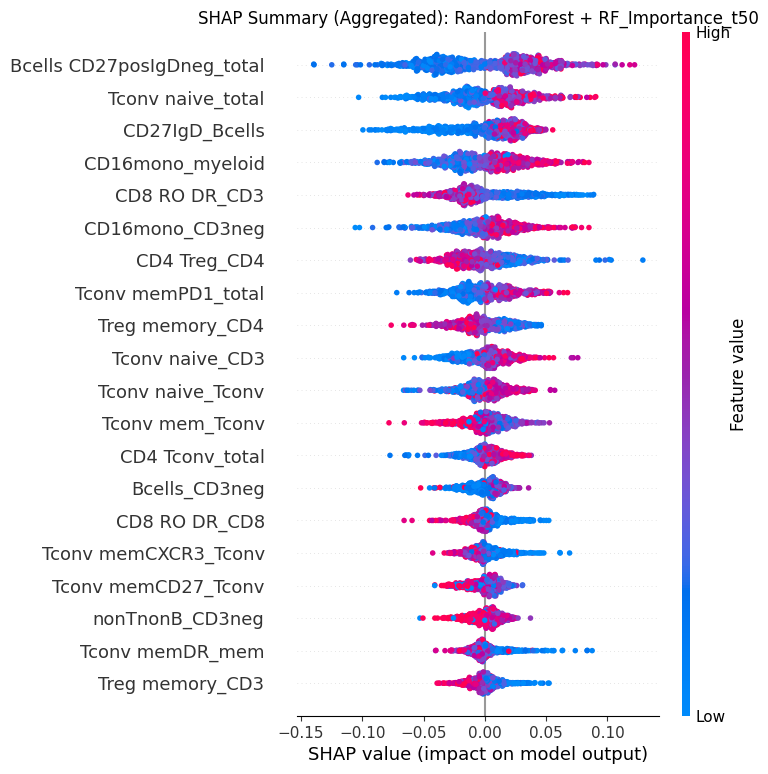


  - Generating SHAP Decision Plots for Prediction Categories...
    - Plotting for True Positives (230 samples)...


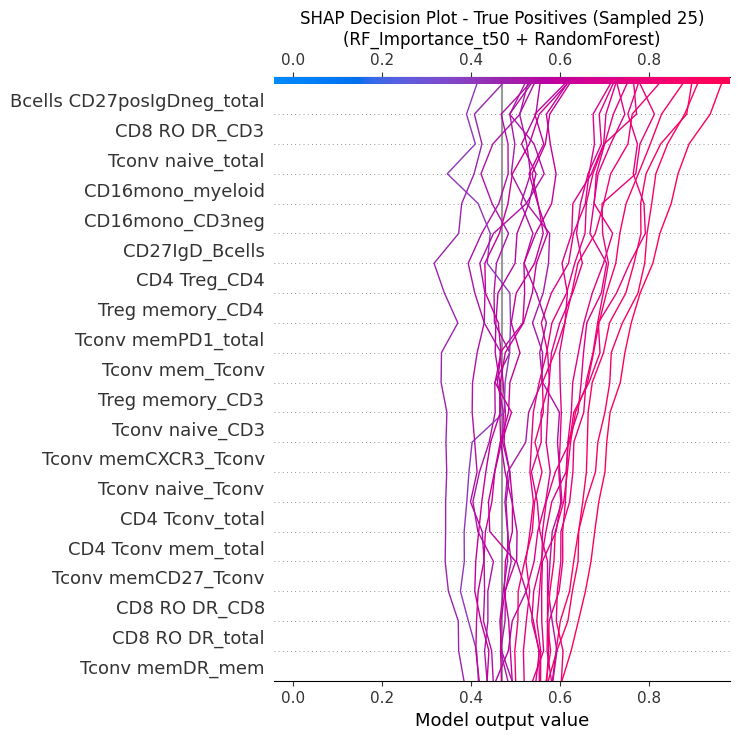

    - Plotting for True Negatives (354 samples)...


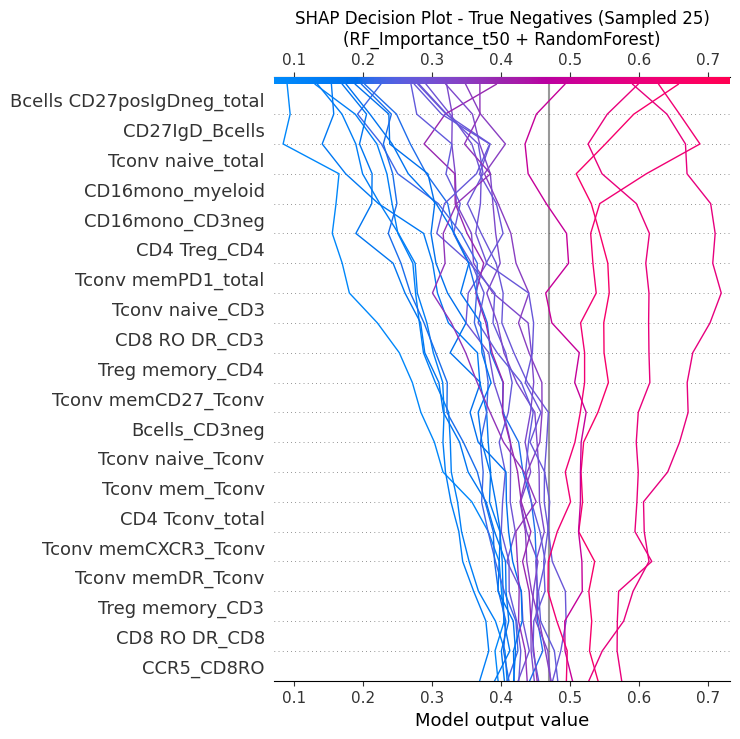

    - Plotting for False Positives (136 samples)...


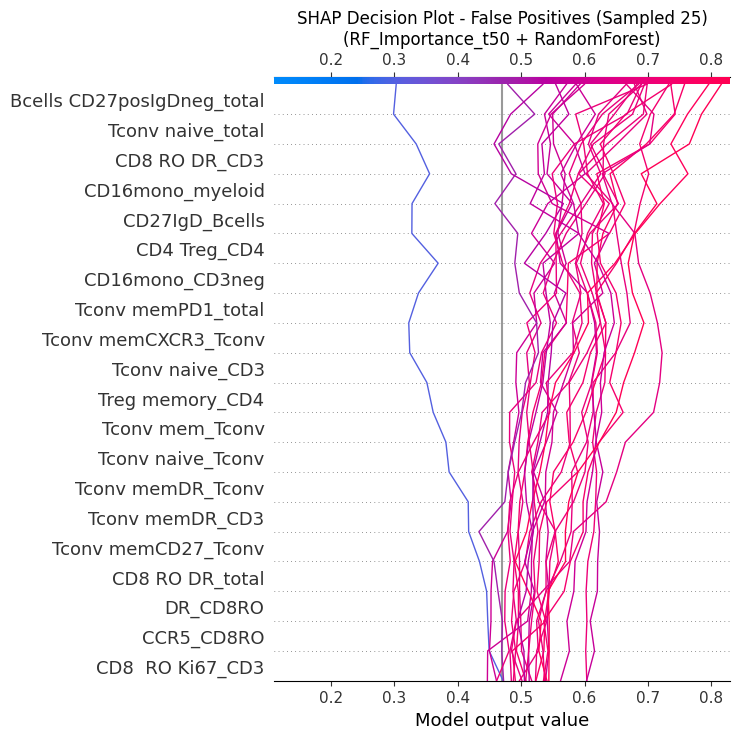

    - Plotting for False Negatives (170 samples)...


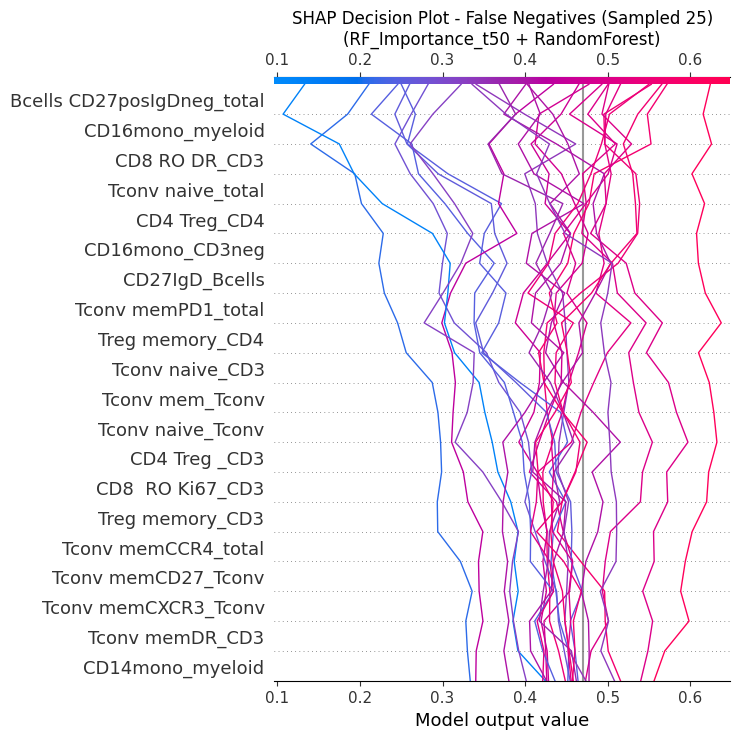


--- Analyzing Model #7: XGBoost + RFE (RandomForest)_t60 ---
  - Using signature with 20 features for SHAP analysis.


SHAP for XGBoost:   0%|          | 0/40 [00:00<?, ?it/s]

  - Generating aggregated SHAP Summary Plot...


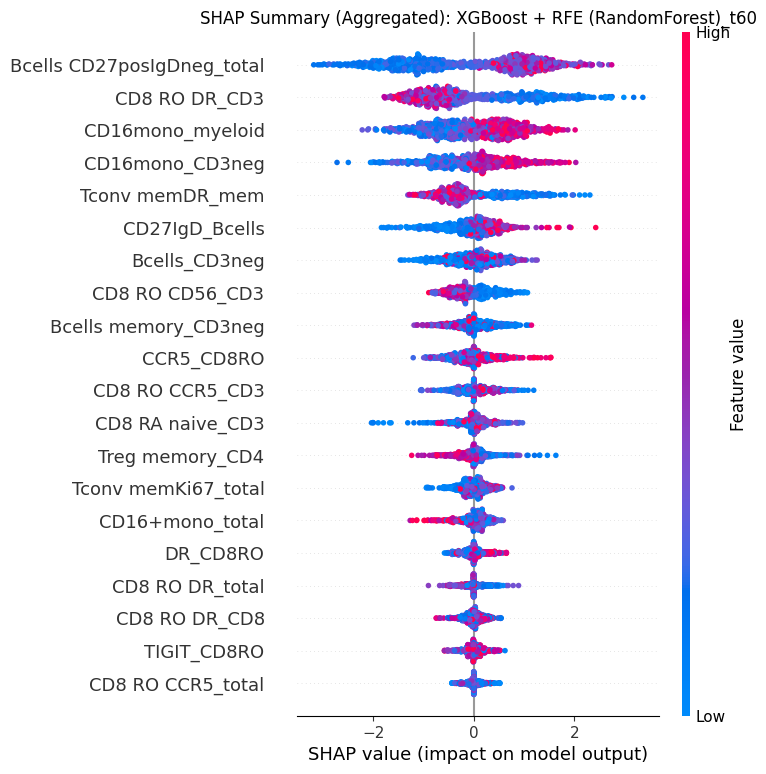


  - Generating SHAP Decision Plots for Prediction Categories...
    - Plotting for True Positives (247 samples)...


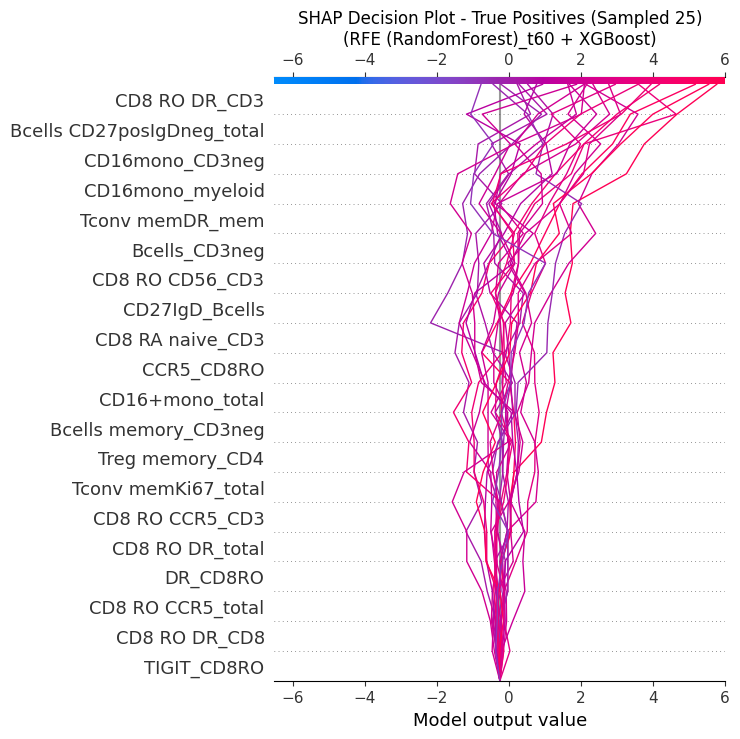

    - Plotting for True Negatives (344 samples)...


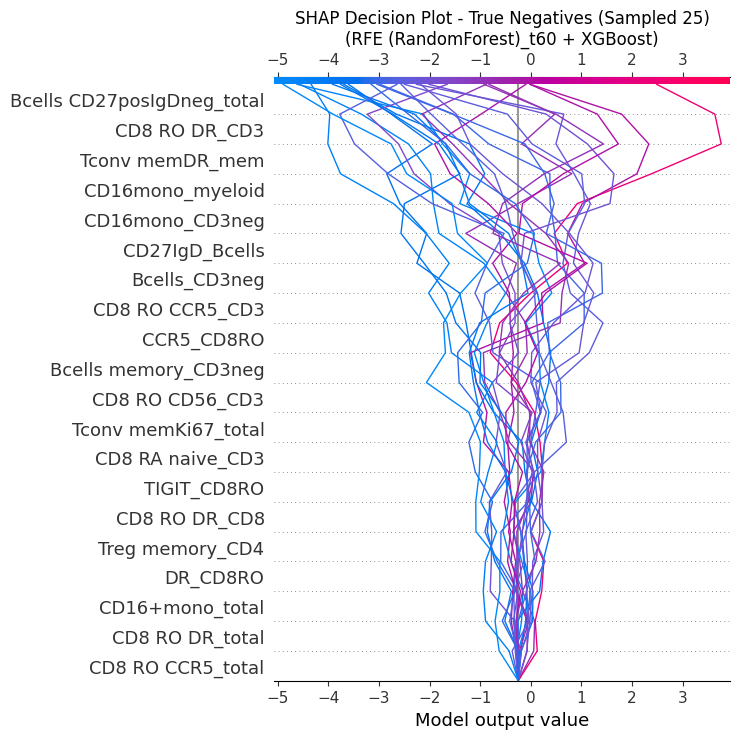

    - Plotting for False Positives (146 samples)...


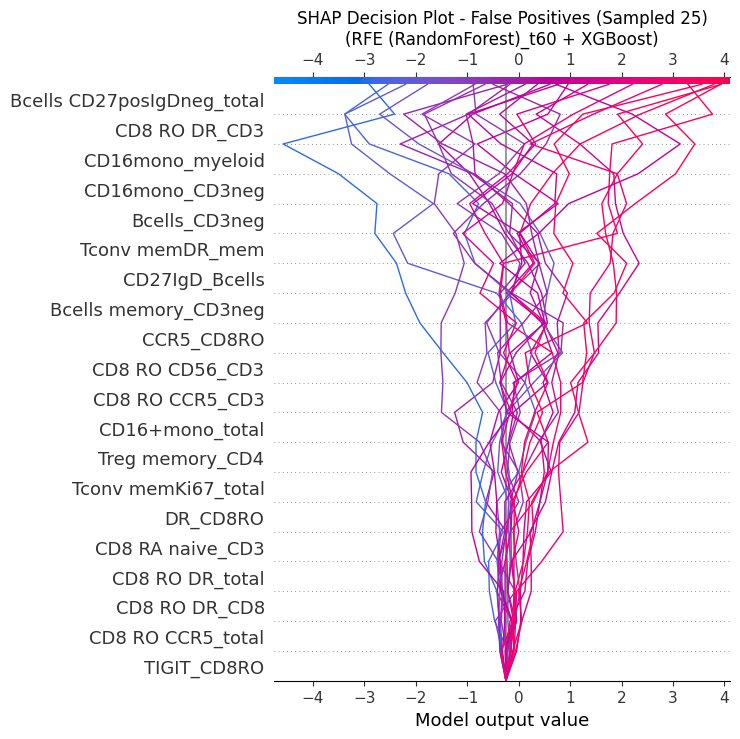

    - Plotting for False Negatives (153 samples)...


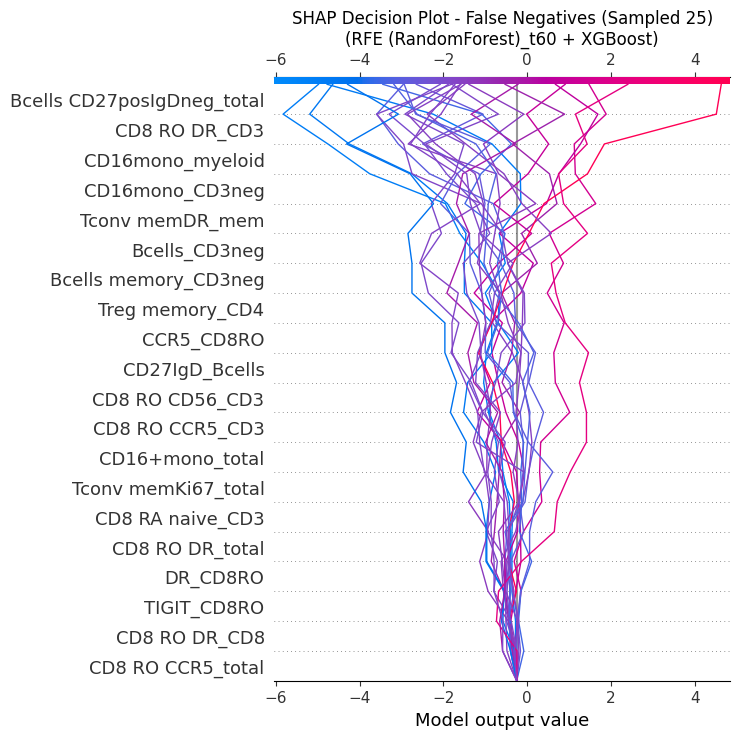


--- Analyzing Model #8: RandomForest + FDR (p < 0.05)_t40 ---
  - Using signature with 2 features for SHAP analysis.


SHAP for RandomForest:   0%|          | 0/40 [00:00<?, ?it/s]

  - Generating aggregated SHAP Summary Plot...


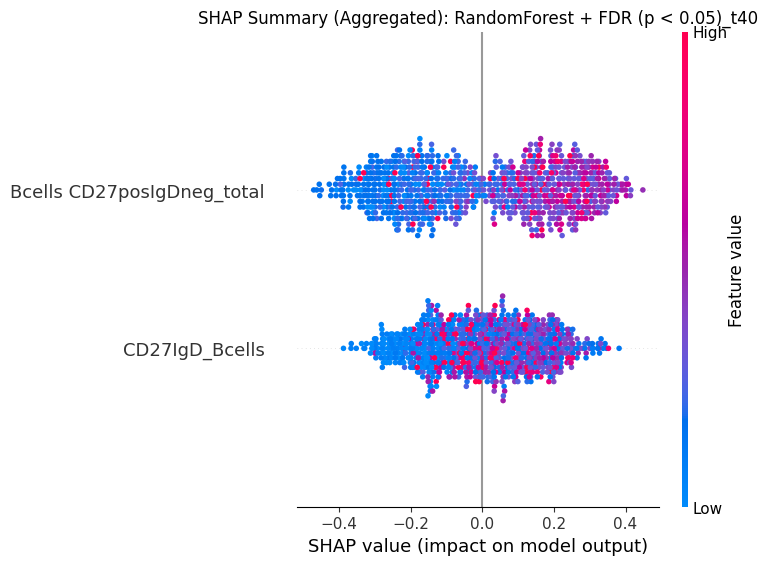


  - Generating SHAP Decision Plots for Prediction Categories...
    - Plotting for True Positives (245 samples)...


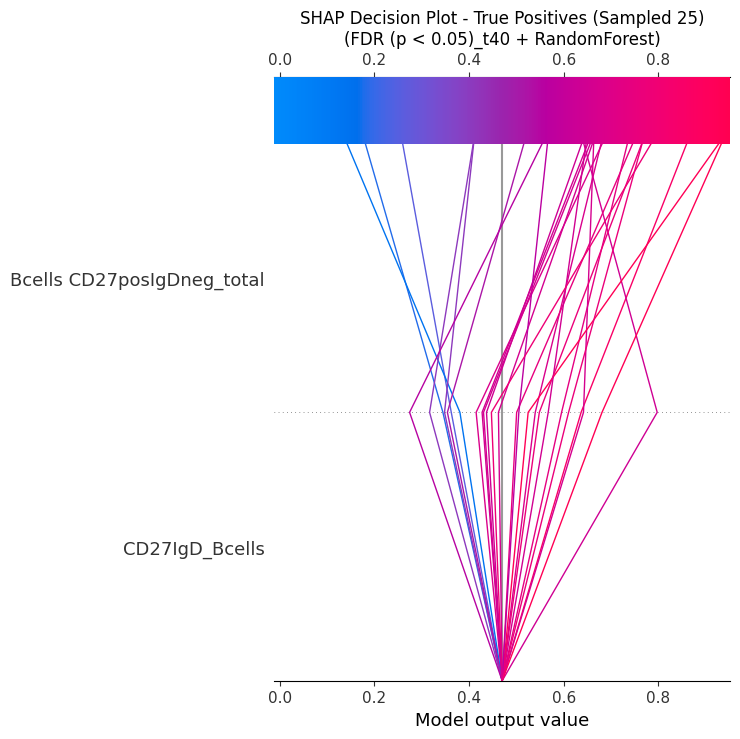

    - Plotting for True Negatives (344 samples)...


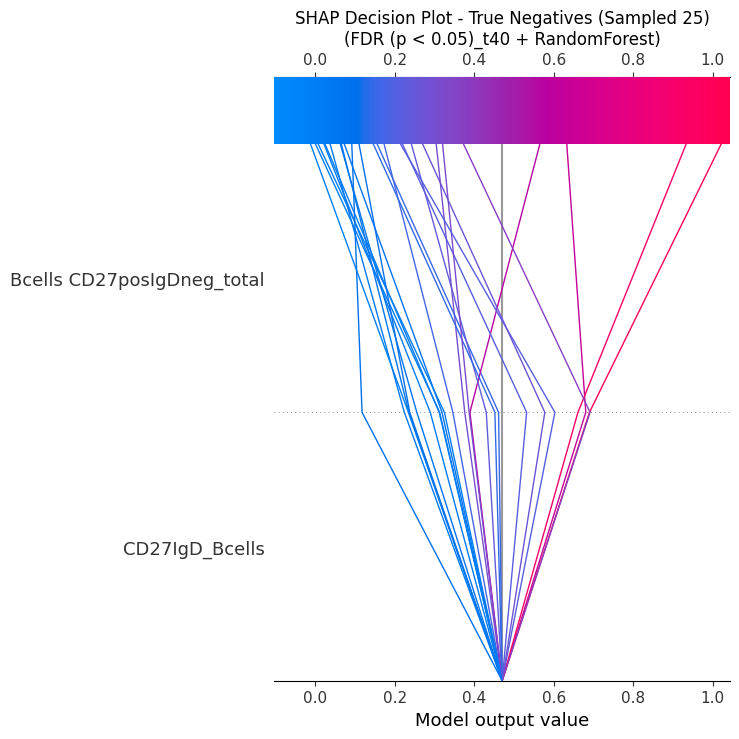

    - Plotting for False Positives (146 samples)...


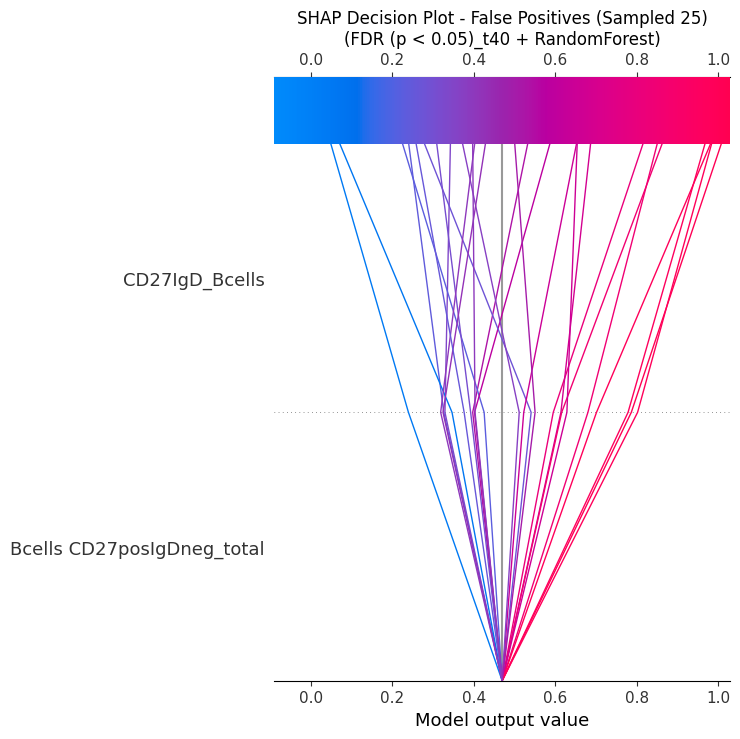

    - Plotting for False Negatives (155 samples)...


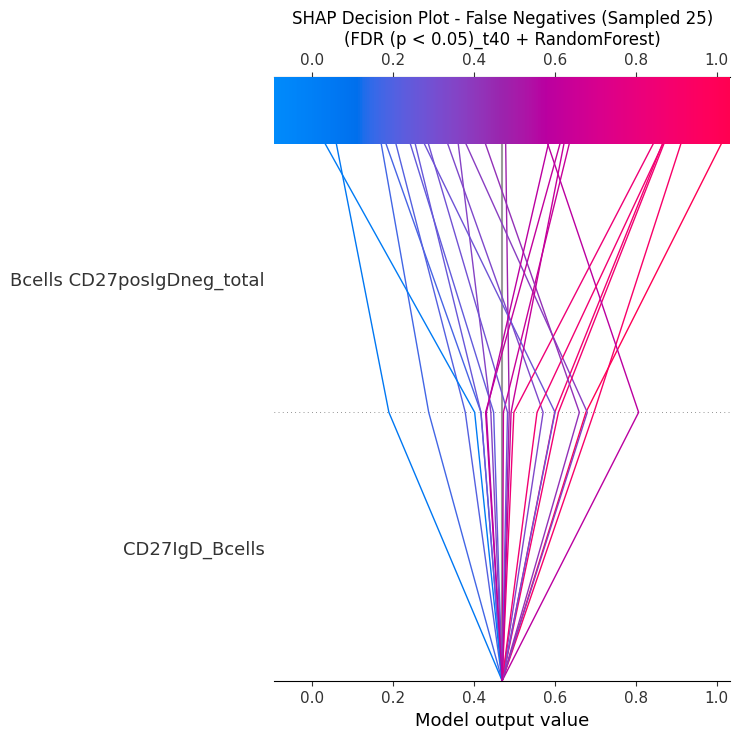


--- Analyzing Model #9: XGBoost + RFE (RandomForest)_t40 ---
  - Using signature with 84 features for SHAP analysis.


SHAP for XGBoost:   0%|          | 0/40 [00:00<?, ?it/s]

  - Generating aggregated SHAP Summary Plot...


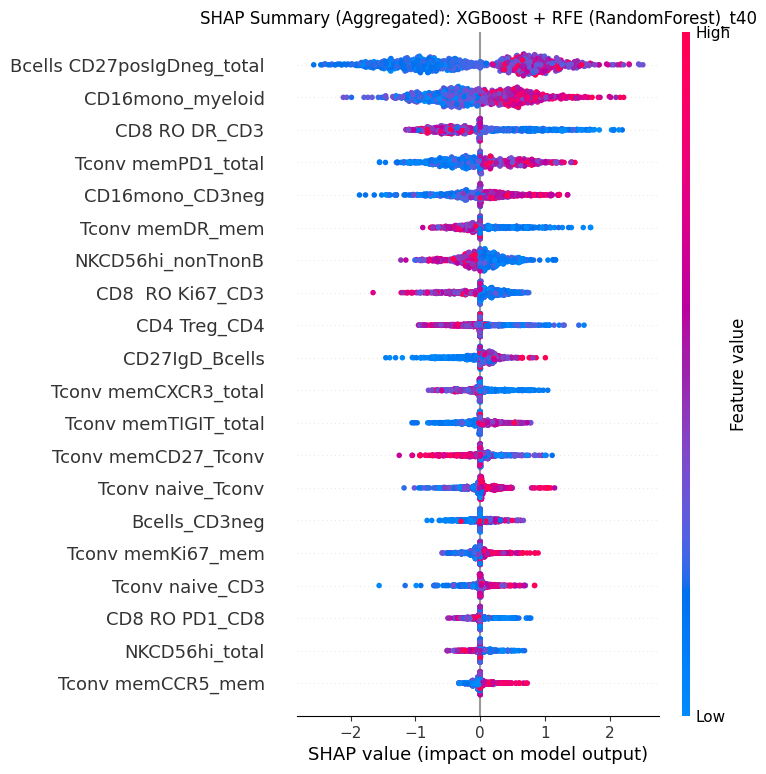


  - Generating SHAP Decision Plots for Prediction Categories...
    - Plotting for True Positives (238 samples)...


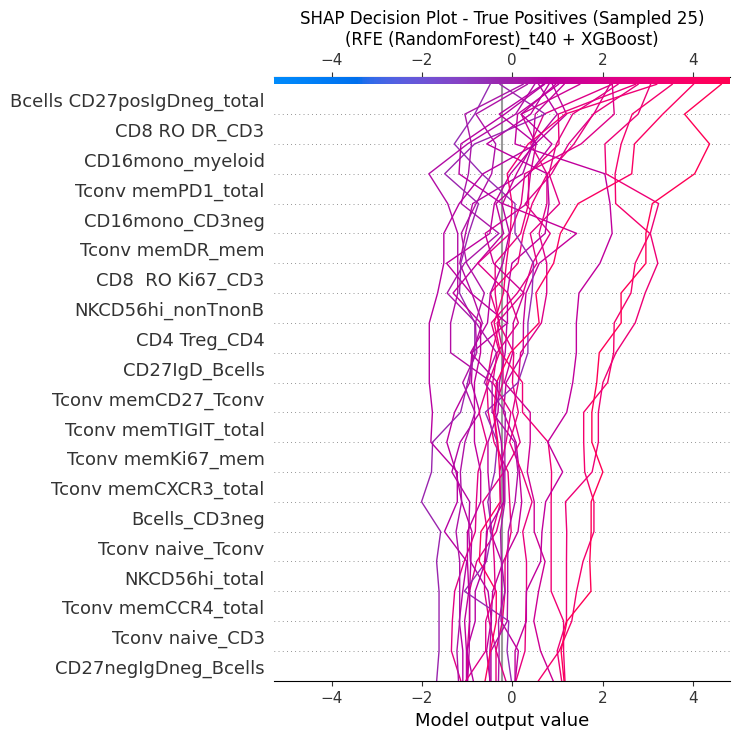

    - Plotting for True Negatives (346 samples)...


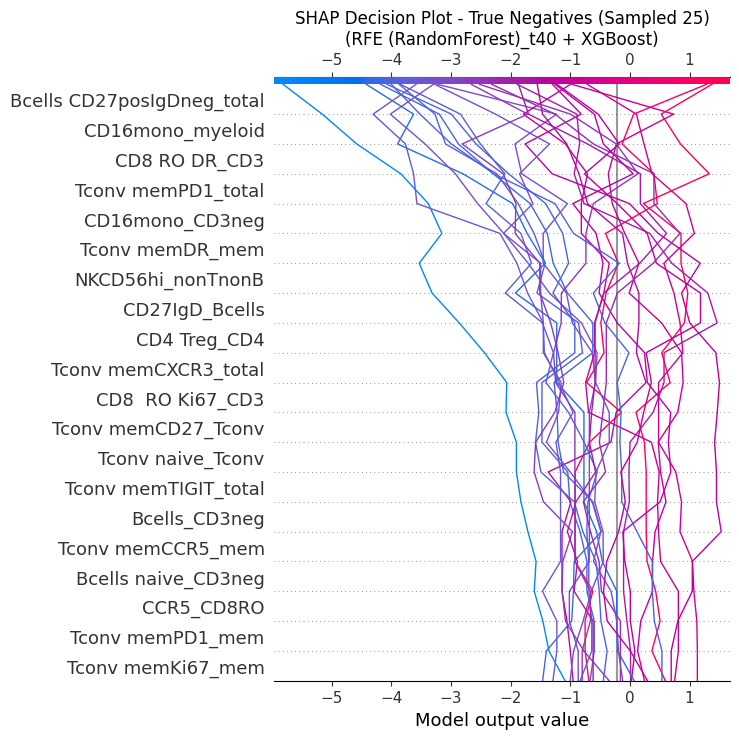

    - Plotting for False Positives (144 samples)...


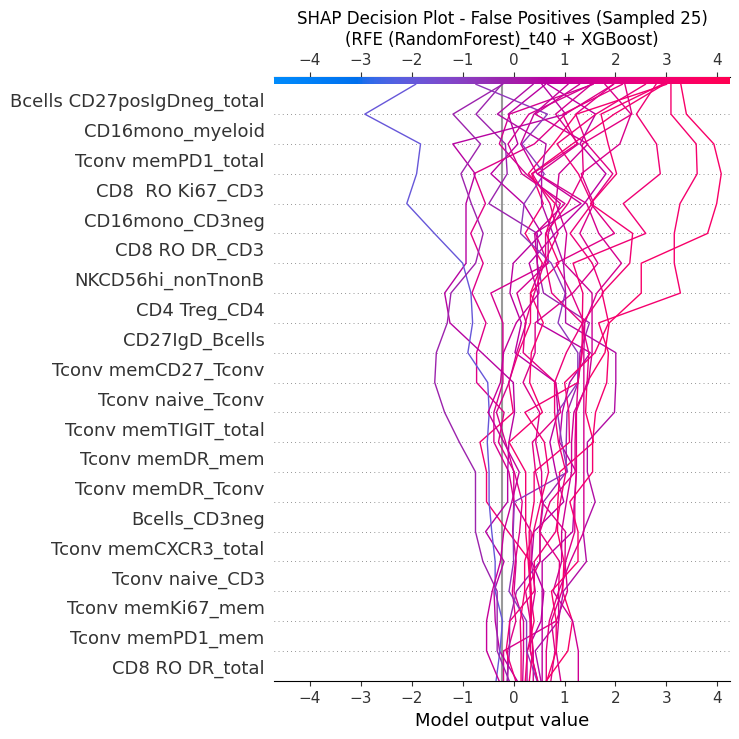

    - Plotting for False Negatives (162 samples)...


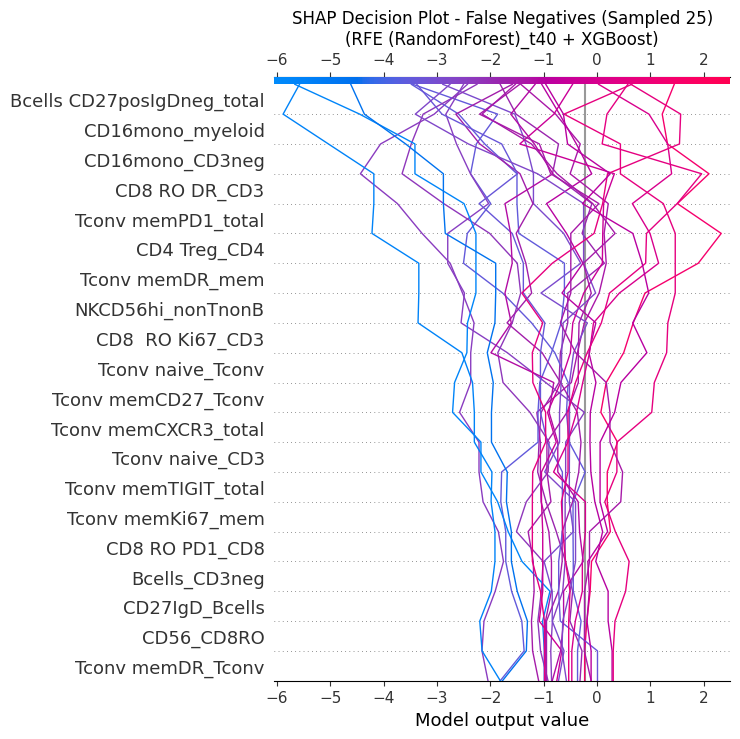


--- Analyzing Model #10: RandomForest + XGB_Importance_t50 ---
  - Using signature with 8 features for SHAP analysis.


SHAP for RandomForest:   0%|          | 0/40 [00:00<?, ?it/s]

  - Generating aggregated SHAP Summary Plot...


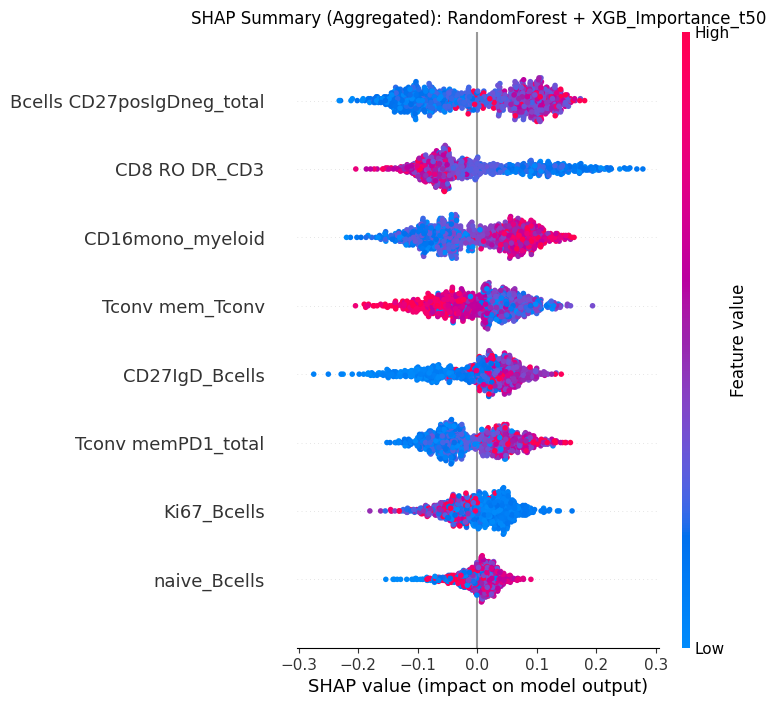


  - Generating SHAP Decision Plots for Prediction Categories...
    - Plotting for True Positives (242 samples)...


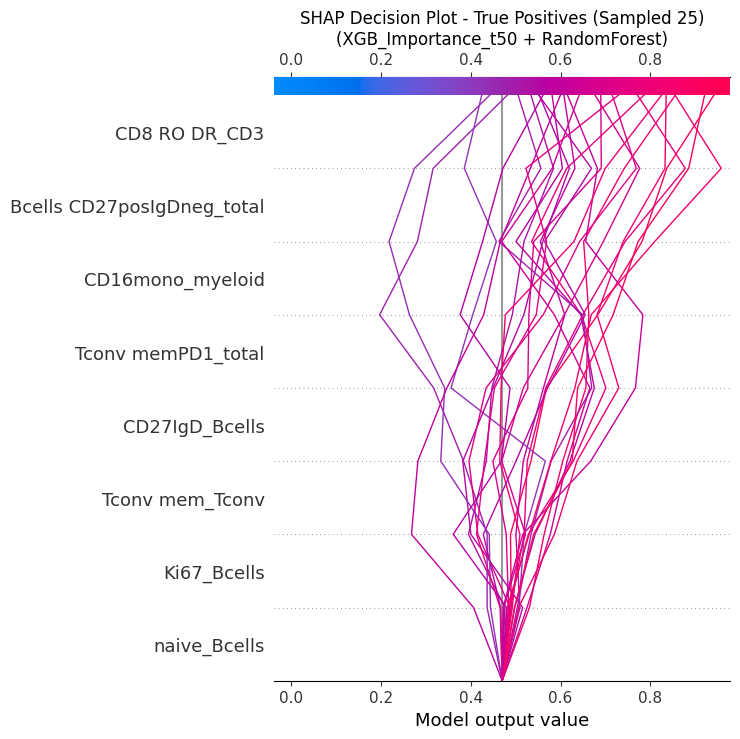

    - Plotting for True Negatives (349 samples)...


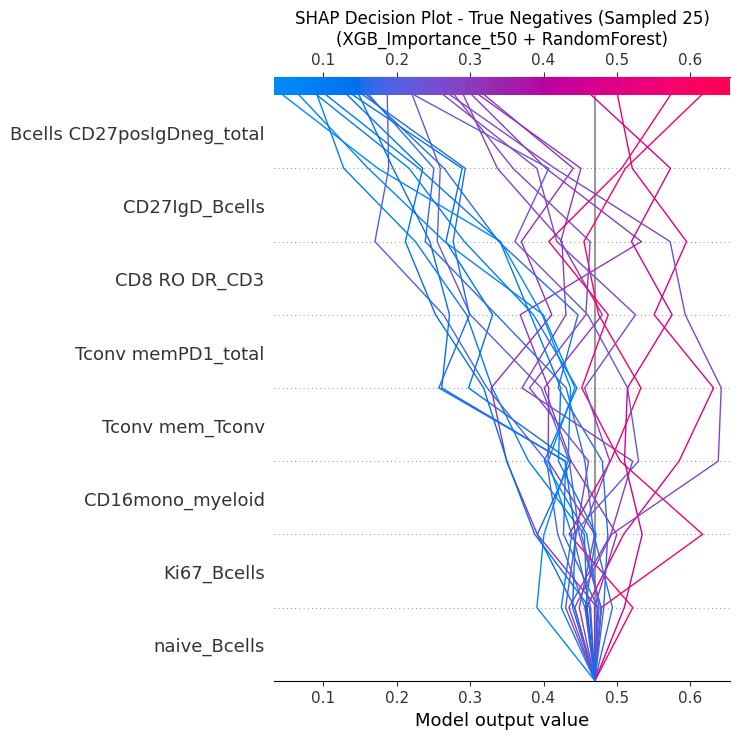

    - Plotting for False Positives (141 samples)...


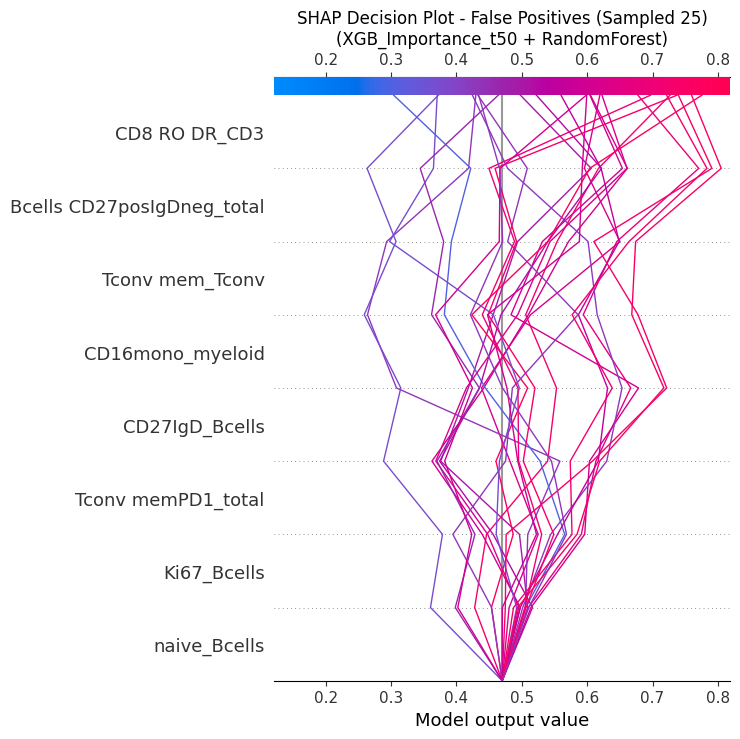

    - Plotting for False Negatives (158 samples)...


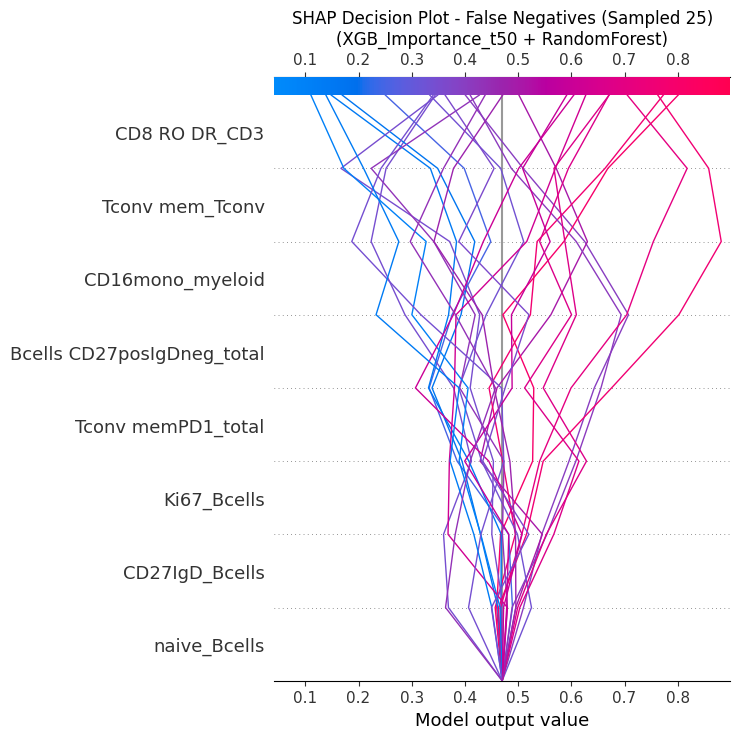

Generating Final Summary Report...
Final summary report generated in directory: run_reports/run_20251023_072849
Signature coverage report generated.

FINAL PIPELINE SUMMARY
Pipeline Statistics:
  - Total outer folds completed: 40
  - Folds with successful results: 40
  - Total model combinations evaluated: 13600
  - Unique signature methods: 68
  - Unique classifiers: 5

Best Model:
  - Signature Method: FDR (p < 0.1)_t40
  - Classifier: RandomForest
  - Mean AUROC: 0.7388 ± 0.1030
  - AUROC 95% CI: 0.706-0.772
  - Mean AUPRC: 0.6965 ± 0.0961
  - Mean Features: 29.5 ± 12.3

Signature Discovery:
  - Total signatures discovered: 4103
  - Average signatures per fold: 102.6
  - Globally stable features by threshold:
    - ≥40%: 2 features
    - ≥50%: 0 features
    - ≥60%: 0 features
    - ≥70%: 0 features
    - ≥80%: 0 features
  - Most stable feature: CD16mono_myeloid (48.2%)

Output Files Generated:
  - Main summary: run_reports/run_*/00_main_summary.md
  - Outer fold logs: run_reports/

In [11]:
# %%

# [11] Results Analysis and Visualization
# This cell generates comprehensive visualizations and analysis of the pipeline results

# Reset random seed for reproducible visualizations and analysis
# This ensures consistent sampling in functions like plot_learning_curve_for_best()
# and SHAP decision plots that use np.random.choice and other random operations
set_seed(BASE_SEED)


def calculate_signature_fold_coverage(results_df, coverage_threshold=100):
    """
    Calculate which signatures are present in the specified percentage of outer folds.

    This function implements strict fold coverage filtering to ensure only highly stable,
    reproducible signatures are included in the final analysis. By default, only signatures
    that appear in 100% of outer folds are considered stable enough for inclusion. This
    extremely stringent criterion ensures maximum reliability and eliminates any signatures
    that may be artifacts of specific fold splits.

    Args:
        results_df: DataFrame with results from nested CV containing 'signature_method'
                   and 'outer_fold' columns
        coverage_threshold: Minimum percentage of folds a signature must appear in (default 100%)

    Returns:
        tuple: (stable_signatures, coverage_stats)
            - stable_signatures: set of signature methods that meet coverage threshold
            - coverage_stats: DataFrame with detailed coverage statistics for each signature

    Example:
        >>> stable_sigs, stats = calculate_signature_fold_coverage(results_df, coverage_threshold=100)
        >>> print(f"Found {len(stable_sigs)} stable signatures")
    """
    if results_df.empty:
        print("⚠️ No results data to calculate fold coverage.")
        return set(), pd.DataFrame()

    print(
        f"\n📊 Calculating signature fold coverage (threshold: {coverage_threshold}%)..."
    )

    # Calculate coverage per signature method (across all classifiers)
    total_folds = OUTER_N_REPEATS * OUTER_N_SPLITS
    coverage_stats = []

    for sig_method in results_df["signature_method"].unique():
        sig_data = results_df[results_df["signature_method"] == sig_method]
        folds_present = sig_data["outer_fold"].nunique()
        coverage_pct = (folds_present / total_folds) * 100

        coverage_stats.append(
            {
                "signature_method": sig_method,
                "folds_present": folds_present,
                "total_folds": total_folds,
                "coverage_percentage": coverage_pct,
                "is_stable": coverage_pct >= coverage_threshold,
            }
        )

    coverage_df = pd.DataFrame(coverage_stats).sort_values(
        "coverage_percentage", ascending=False
    )

    # Get stable signatures
    stable_signatures = set(coverage_df[coverage_df["is_stable"]]["signature_method"])
    unstable_signatures = set(
        coverage_df[~coverage_df["is_stable"]]["signature_method"]
    )

    print(f"  📈 Total signatures analyzed: {len(coverage_df)}")
    print(
        f"  ✅ Stable signatures ({coverage_threshold}% folds): {len(stable_signatures)}"
    )
    print(
        f"  ❌ Unstable signatures (<{coverage_threshold}% folds): {len(unstable_signatures)}"
    )

    if unstable_signatures:
        print(f"\n  🚫 Unstable signatures (excluded from analysis):")
        for sig in sorted(unstable_signatures):
            coverage_pct = coverage_df[coverage_df["signature_method"] == sig][
                "coverage_percentage"
            ].iloc[0]
            print(f"    - {sig}: {coverage_pct:.1f}% fold coverage")

    if stable_signatures:
        print(f"\n  ✅ Stable signatures (included in analysis):")
        for sig in sorted(stable_signatures):
            coverage_pct = coverage_df[coverage_df["signature_method"] == sig][
                "coverage_percentage"
            ].iloc[0]
            print(f"    - {sig}: {coverage_pct:.1f}% fold coverage")

    return stable_signatures, coverage_df


def validate_and_clean_results(results_df):
    """
    Validate and clean results DataFrame before aggregation.

    Args:
        results_df: DataFrame containing nested CV results

    Returns:
        tuple: (cleaned_results_df, validation_report)
    """
    print("=== VALIDATING RESULTS DATA ===")

    validation_report = {
        "total_rows": len(results_df),
        "total_combinations": len(
            results_df.groupby(["signature_method", "classifier"])
        ),
        "single_fold_combinations": 0,
        "nan_issues": {},
        "problematic_combinations": [],
        "fold_distribution": {},
    }

    if results_df.empty:
        print("Warning: results_df is empty!")
        return results_df, validation_report

    # Check data structure
    print(f"DataFrame shape: {results_df.shape}")
    print(f"Columns: {list(results_df.columns)}")
    if "outer_fold" in results_df.columns:
        print(
            f"Outer fold range: {results_df['outer_fold'].min()} - {results_df['outer_fold'].max()}"
        )
        print(f"Unique outer folds: {sorted(results_df['outer_fold'].unique())}")

    # Check for single-fold combinations
    grouped = results_df.groupby(["signature_method", "classifier"])

    for (sig_method, classifier), group in grouped:
        n_folds = len(group)

        # Track fold distribution
        if n_folds not in validation_report["fold_distribution"]:
            validation_report["fold_distribution"][n_folds] = 0
        validation_report["fold_distribution"][n_folds] += 1

        if n_folds == 1:
            validation_report["single_fold_combinations"] += 1
            validation_report["problematic_combinations"].append(
                {
                    "signature_method": sig_method,
                    "classifier": classifier,
                    "issue": "single_fold",
                    "n_folds": n_folds,
                    "outer_folds": list(group["outer_fold"])
                    if "outer_fold" in group.columns
                    else [],
                }
            )
            print(
                f"Warning: Single-fold combination found: {sig_method} + {classifier} (fold: {list(group['outer_fold']) if 'outer_fold' in group.columns else 'unknown'})"
            )

        # Check for NaN values in key metrics
        key_metrics = ["roc_auc", "auprc", "f1_score", "accuracy"]
        for metric in key_metrics:
            if metric in group.columns:
                nan_count = group[metric].isna().sum()
                if nan_count > 0:
                    if metric not in validation_report["nan_issues"]:
                        validation_report["nan_issues"][metric] = 0
                    validation_report["nan_issues"][metric] += nan_count

                    if nan_count == len(group):
                        validation_report["problematic_combinations"].append(
                            {
                                "signature_method": sig_method,
                                "classifier": classifier,
                                "issue": f"all_nan_{metric}",
                                "n_folds": n_folds,
                                "outer_folds": list(group["outer_fold"])
                                if "outer_fold" in group.columns
                                else [],
                            }
                        )

    print(f"Validation complete:")
    print(f"  - Total combinations: {validation_report['total_combinations']}")
    print(
        f"  - Fold distribution: {dict(sorted(validation_report['fold_distribution'].items()))}"
    )
    print(
        f"  - Single-fold combinations: {validation_report['single_fold_combinations']}"
    )
    print(f"  - NaN issues: {validation_report['nan_issues']}")

    # Show sample data for debugging
    print(f"\nSample data (first 3 rows):")
    sample_cols = [
        "outer_fold",
        "signature_method",
        "classifier",
        "roc_auc",
        "auprc",
        "f1_score",
        "accuracy",
    ]
    available_cols = [col for col in sample_cols if col in results_df.columns]
    print(results_df[available_cols].head(3).to_string(index=False))

    # Show a sample combination with multiple folds
    if validation_report["fold_distribution"]:
        max_folds = max(
            k for k in validation_report["fold_distribution"].keys() if k > 1
        )
        if max_folds > 1:
            sample_combo = None
            for (sig_method, classifier), group in grouped:
                if len(group) == max_folds:
                    sample_combo = (sig_method, classifier, group)
                    break

            if sample_combo:
                sig_method, classifier, group = sample_combo
                print(
                    f"\nSample multi-fold combination ({max_folds} folds): {sig_method} + {classifier}"
                )
                print(group[available_cols].to_string(index=False))

    return results_df, validation_report


# Validate results before aggregation
if not results_df.empty:
    results_df, validation_report = validate_and_clean_results(results_df)

    if not results_df.empty:
        # FILTER BY FOLD COVERAGE: Only include signatures found in 100% of outer folds
        # This extremely stringent filtering step ensures maximum reliability and reproducibility:
        # 1. Signatures that miss even a single CV fold may be artifacts of data splitting
        # 2. Only signatures with 100% fold coverage are considered truly "stable"
        # 3. This eliminates any signatures that might be specific to particular fold combinations
        # 4. Ensures all reported results are based on consistently reproducible signatures
        # 5. Users are clearly informed about which signatures meet this strict criterion
        print("\n" + "=" * 80)
        print("🎯 FILTERING SIGNATURES BY FOLD COVERAGE (100% threshold)")
        print("=" * 80)
        print(
            "Only signatures that appear in 100% of outer folds will be included in final analysis."
        )
        print(
            "This extremely strict criterion ensures maximum reliability and reproducibility."
        )
        print(
            "Any signature missing from even a single fold will be excluded as potentially unstable."
        )

        stable_signatures, coverage_df = calculate_signature_fold_coverage(
            results_df, coverage_threshold=100
        )

        # Filter results_df to only include stable signatures
        original_rows = len(results_df)
        results_df = results_df[results_df["signature_method"].isin(stable_signatures)]
        filtered_rows = len(results_df)

        print(f"\n📊 Fold Coverage Filtering Results:")
        print(f"  - Original rows: {original_rows}")
        print(f"  - Filtered rows (stable signatures only): {filtered_rows}")
        print(
            f"  - Rows removed (unstable signatures): {original_rows - filtered_rows}"
        )

        if len(stable_signatures) == 0:
            print(
                "\n⚠️ WARNING: No signatures meet the extremely strict 100% fold coverage threshold!"
            )
            print(
                "   This means no signatures appeared consistently across ALL cross-validation folds."
            )
            print(
                "   Consider lowering the threshold or investigating signature discovery stability."
            )
            agg_df = pd.DataFrame()
        else:
            # AGGREGATION EXPLANATION:
            # Each row in results_df represents one outer fold result
            # We group by signature_method + classifier and aggregate across all outer folds
            # This gives us proper mean, std, and confidence intervals from multiple fold results
            print(
                "\n=== AGGREGATING RESULTS ACROSS OUTER FOLDS (STABLE SIGNATURES ONLY) ==="
            )
            print("Each row = one outer fold result")
            print("Aggregating by signature_method + classifier across all outer folds")
            print(
                f"Only analyzing {len(stable_signatures)} stable signatures that appeared in 100% of folds."
            )

        # Custom aggregation function to handle single-fold cases properly
        def safe_agg_func(group, metric_col, agg_name):
            """Safe aggregation that handles NaN values and single-fold cases."""
            values = group[metric_col].dropna()

            if len(values) == 0:
                return {f"{metric_col}_{agg_name}": np.nan}
            elif len(values) == 1:
                return {
                    f"{metric_col}_{agg_name}": values.iloc[0],
                    f"{metric_col}_std": 0.0,
                    f"{metric_col}_ci": f"{values.iloc[0]:.3f}-{values.iloc[0]:.3f}",
                    f"{metric_col}_ci_margin": 0.0,
                }
            else:
                mean_val = values.mean()
                std_val = values.std(ddof=1)
                ci_lower, ci_upper = calculate_confidence_interval(values)

                ci_margin = calculate_ci_margin_of_error(values)
                return {
                    f"{metric_col}_{agg_name}": mean_val,
                    f"{metric_col}_std": std_val,
                    f"{metric_col}_ci": f"{ci_lower:.3f}-{ci_upper:.3f}"
                    if not np.isnan(ci_lower)
                    else "N/A",
                    f"{metric_col}_ci_margin": ci_margin,
                }

        # Apply safe aggregation to each group
        agg_results = []
        for (sig_method, classifier), group in results_df.groupby(
            ["signature_method", "classifier"]
        ):
            result = {"signature_method": sig_method, "classifier": classifier}

            # Aggregate each metric safely
            for metric in [
                "roc_auc",
                "auprc",
                "f1_score",
                "accuracy",
                "precision",
                "recall",
                "specificity",
                "brier_score",
            ]:
                if metric in group.columns:
                    metric_result = safe_agg_func(group, metric, "mean")
                    result.update(metric_result)

            # Handle n_features
            if "n_features" in group.columns:
                n_features_values = group["n_features"].dropna()
                if len(n_features_values) > 0:
                    result["n_features_mean"] = n_features_values.mean()
                    result["n_features_std"] = (
                        n_features_values.std(ddof=1)
                        if len(n_features_values) > 1
                        else 0.0
                    )

            agg_results.append(result)

        agg_metrics = pd.DataFrame(agg_results)

        def aggregate_complex(group):
            data = {
                f"{c}_concat": np.concatenate(list(group[f"{c}_fold"]))
                for c in ["y_true", "y_pred", "y_proba", "cancer_types", "sample_ids"]
            }
            data["sample_results_all"] = pd.DataFrame(
                {
                    "sample_id": data["sample_ids_concat"],
                    "fold": np.repeat(
                        group["outer_fold"], group["y_true_fold"].apply(len)
                    ),
                    "correct": (data["y_true_concat"] == data["y_pred_concat"]).astype(
                        int
                    ),
                }
            ).to_dict("records")
            return pd.Series(data)

        agg_complex_df = results_df.groupby(["signature_method", "classifier"]).apply(
            aggregate_complex
        )
        agg_df = pd.merge(
            agg_metrics, agg_complex_df, on=["signature_method", "classifier"]
        ).reset_index()
        agg_df = agg_df.sort_values("roc_auc_mean", ascending=False)

        # Create stability_df for visualization functions
        # This dataframe tracks how often each feature was selected across all bootstrap runs
        overall_feature_counts_viz = defaultdict(int)
        total_signatures_generated_viz = sum(
            len(sigs) for sigs in signatures_per_fold.values()
        )
        if total_signatures_generated_viz > 0:
            # Count feature selection frequency across all folds and methods
            for fold, sigs in signatures_per_fold.items():
                for method, features in sigs.items():
                    for feature in features:
                        overall_feature_counts_viz[feature] += 1

            # Create stability dataframe with selection frequencies as percentages
            stability_df_viz = pd.DataFrame(
                [
                    {
                        "Feature": f,
                        "Selection Frequency (%)": (c / total_signatures_generated_viz)
                        * 100,
                    }
                    for f, c in overall_feature_counts_viz.items()
                ]
            ).sort_values("Selection Frequency (%)", ascending=False)
        else:
            # No signatures generated, create empty dataframe
            stability_df_viz = pd.DataFrame()

        # Detect and handle duplicate signatures
        print("\n=== DUPLICATE SIGNATURE DETECTION ===")
        agg_df = detect_and_handle_duplicate_signatures(agg_df, results_df)

        # Create correlation heatmaps for top 10 signature/model combinations
        print("\n=== CORRELATION HEATMAPS ANALYSIS ===")
        correlation_results = create_top_signatures_correlation_heatmaps(
            agg_df, results_df, X, y, top_n=10
        )

        # Create feature distribution plots for top 10 signature/model combinations
        print("\n=== FEATURE DISTRIBUTION ANALYSIS ===")
        distribution_results = create_top_signatures_feature_distributions(
            agg_df, results_df, X, y, top_n=10
        )

        # Create stability threshold feature distribution plots
        print("\n=== STABILITY THRESHOLD FEATURE DISTRIBUTIONS ===")
        if not stability_df_viz.empty:
            threshold_distribution_results = (
                create_stability_threshold_feature_distributions(
                    stability_df_viz, X, y, top_n=10
                )
            )
        else:
            print("   ⚠️ No stability data available for threshold analysis")

        # Print aggregation summary
        print("\n=== AGGREGATION SUMMARY ===")
        print(
            f"Original results_df: {len(results_df)} rows (individual outer fold results)"
        )
        print(
            f"Aggregated results: {len(agg_df)} rows (signature_method + classifier combinations)"
        )
        print("Expected: Each combination should have multiple outer fold results")

        # Validate cross-validation setup
        print("\n=== CROSS-VALIDATION VALIDATION ===")
        print(f"Expected outer folds: {OUTER_N_REPEATS * OUTER_N_SPLITS}")
        print(f"Expected bootstrap runs per fold: {BOOTSTRAP_N}")

        # Check if we have the expected number of outer folds
        unique_folds = results_df["outer_fold"].nunique()
        print(f"Actual unique outer folds found: {unique_folds}")

        if unique_folds != OUTER_N_REPEATS * OUTER_N_SPLITS:
            print(
                f"⚠️ Warning: Expected {OUTER_N_REPEATS * OUTER_N_SPLITS} folds, but found {unique_folds}"
            )

        print(
            "\n--- Top 10 Model Combinations (Mean Unbiased Performance from Nested CV) ---"
        )
        print(
            "📌 NOTE: Only signatures found in 100% of outer folds are included in this analysis."
        )
        print(
            "   This extremely strict criterion ensures only the most stable signatures are analyzed."
        )
        print(
            "   Any signature missing from even a single fold has been excluded for maximum reliability."
        )
        display_cols = [
            "signature_method",
            "classifier",
            "roc_auc_mean",
            "roc_auc_std",
            "roc_auc_ci",
            "auprc_mean",
            "auprc_std",
            "auprc_ci",
            "f1_score_mean",
            "f1_score_std",
            "f1_score_ci",
            "accuracy_mean",
            "accuracy_std",
            "accuracy_ci",
            "precision_mean",
            "precision_std",
            "precision_ci",
            "recall_mean",
            "recall_std",
            "recall_ci",
            "specificity_mean",
            "specificity_std",
            "specificity_ci",
            "n_features_mean",
            "n_features_std",
        ]
        print(
            tabulate(
                agg_df.head(10)[display_cols],
                headers="keys",
                tablefmt="grid",
                floatfmt=".4f",
            )
        )

        # Print actual signatures for top 10 models
        print("\n--- Top 10 Models: Actual Signatures ---")
        for i, (_, row) in enumerate(agg_df.head(10).iterrows(), 1):
            sig_method = row["signature_method"]
            classifier = row["classifier"]

            # Get the most frequent signature for this model combination
            combo_results = results_df[
                (results_df["signature_method"] == sig_method)
                & (results_df["classifier"] == classifier)
            ]

            if (
                not combo_results.empty
                and "signature_features" in combo_results.columns
            ):
                signature_features = combo_results["signature_features"].mode()
                if not signature_features.empty and len(signature_features.iloc[0]) > 0:
                    final_signature = signature_features.iloc[0]
                    print(f"\n{i}. {classifier} + {sig_method}")
                    print(
                        f"   Signature ({len(final_signature)} features): {', '.join(final_signature)}"
                    )
                else:
                    print(f"\n{i}. {classifier} + {sig_method}")
                    print("   Signature: No signature data available")
            else:
                print(f"\n{i}. {classifier} + {sig_method}")
                print("   Signature: No signature data available")

        # Print feature selection method signatures summary
        print("\n--- Feature Selection Method Signatures Summary ---")
        method_signature_counts = defaultdict(int)
        method_feature_counts = defaultdict(lambda: defaultdict(int))

        for fold_num, signatures in signatures_per_fold.items():
            for method, features in signatures.items():
                method_signature_counts[method] += 1
                for feature in features:
                    method_feature_counts[method][feature] += 1

        print("\nSignature Discovery Across All Folds:")
        print("Method | Signatures Found | Total Features | Avg Features/Signature")
        print("-" * 70)
        for method in sorted(method_signature_counts.keys()):
            signature_count = method_signature_counts[method]
            total_features = len(method_feature_counts[method])
            avg_features = (
                total_features / signature_count if signature_count > 0 else 0
            )
            print(
                f"{method:<25} | {signature_count:>15} | {total_features:>13} | {avg_features:>20.1f}"
            )

        # Add threshold-specific breakdown
        print("\nThreshold-Specific Signature Discovery:")
        print("-" * 50)
        for threshold in sorted(STABILITY_THRESHOLDS):
            threshold_signatures = [
                m
                for m in method_signature_counts.keys()
                if m.endswith(f"_t{threshold}")
            ]
            total_threshold_signatures = sum(
                method_signature_counts[m] for m in threshold_signatures
            )
            if total_threshold_signatures > 0:
                print(
                    f"Threshold {threshold}%: {total_threshold_signatures} signatures"
                )
                for method in sorted(threshold_signatures):
                    count = method_signature_counts[method]
                    base_method = method.rsplit("_t", 1)[0]
                    print(f"  - {base_method}: {count} signatures")
            else:
                print(f"Threshold {threshold}%: No signatures found")

        print("\nTop Features by Selection Frequency (All Methods Combined):")
        # Create stability_df for console output
        overall_feature_counts = defaultdict(int)
        total_signatures_generated = sum(
            len(sigs) for sigs in signatures_per_fold.values()
        )
        if total_signatures_generated > 0:
            for fold, sigs in signatures_per_fold.items():
                for method, features in sigs.items():
                    for feature in features:
                        overall_feature_counts[feature] += 1
            stability_df_console = pd.DataFrame(
                [
                    {
                        "Feature": f,
                        "Selection Frequency (%)": (c / total_signatures_generated)
                        * 100,
                    }
                    for f, c in overall_feature_counts.items()
                ]
            ).sort_values("Selection Frequency (%)", ascending=False)

            top_features = stability_df_console.head(15)
            print("Feature | Selection Frequency (%)")
            print("-" * 40)
            for _, row in top_features.iterrows():
                print(
                    f"{row['Feature']:<30} | {row['Selection Frequency (%)']:>15.1f}%"
                )

            # Show features by threshold
            print("\nStable Features by Threshold:")
            for threshold in sorted(STABILITY_THRESHOLDS):
                stable_features = stability_df_console[
                    stability_df_console["Selection Frequency (%)"] >= threshold
                ]["Feature"].tolist()
                print(f"  - {threshold}%: {len(stable_features)} features")
                if len(stable_features) > 0:
                    print(f"    Top 10: {', '.join(stable_features[:10])}")
        else:
            print("No stability data available.")
else:
    agg_df = pd.DataFrame()
    stability_df_console = pd.DataFrame()


def generate_signature_coverage_report(results_df):
    """Create a table and logs for signatures not present in every outer fold.

    - Computes per (signature_method, classifier) how many outer folds have results
    - Writes a coverage markdown table to REPORT_DIR/signature_coverage.md
    - Writes per-fold logs listing missing signatures to FOLD_LOG_DIR/fold_XXX_missing_signatures.md
    """
    if results_df.empty:
        return

    os.makedirs(REPORT_DIR, exist_ok=True)
    os.makedirs(FOLD_LOG_DIR, exist_ok=True)

    expected_folds = OUTER_N_SPLITS * OUTER_N_REPEATS

    # Exclude baseline from signature coverage tracking
    df_sig = results_df[
        results_df["signature_method"] != "All Features (Baseline)"
    ].copy()
    if df_sig.empty:
        return

    # Coverage per combination
    coverage = (
        df_sig.groupby(["signature_method", "classifier"])[  # one row per combo
            "outer_fold"
        ]
        .nunique()
        .reset_index(name="n_folds_present")
        .sort_values(
            ["n_folds_present", "signature_method", "classifier"],
            ascending=[True, True, True],
        )
    )

    # Write main coverage table
    coverage_md = os.path.join(REPORT_DIR, "signature_coverage.md")
    with open(coverage_md, "w") as f:
        f.write("# Signature Coverage Across Outer Folds\n\n")
        f.write(f"- Expected outer folds: {expected_folds}\n\n")
        if not coverage.empty:
            # Add missing count
            cov = coverage.copy()
            cov["missing_folds"] = expected_folds - cov["n_folds_present"]
            f.write(
                tabulate(
                    cov[
                        [
                            "signature_method",
                            "classifier",
                            "n_folds_present",
                            "missing_folds",
                        ]
                    ],
                    headers=[
                        "Signature Method",
                        "Classifier",
                        "Folds Present",
                        "Missing Folds",
                    ],
                    tablefmt="pipe",
                )
            )
            f.write("\n\n")
        else:
            f.write("No signature combinations found.\n")

        # Detailed missing folds per combo
        f.write("## Detailed Missing Folds\n\n")
        all_folds = set(range(1, expected_folds + 1))
        for _, row in coverage.iterrows():
            sig, clf = row["signature_method"], row["classifier"]
            present = set(
                df_sig[
                    (df_sig["signature_method"] == sig) & (df_sig["classifier"] == clf)
                ]["outer_fold"].tolist()
            )
            missing = sorted(all_folds - present)
            if missing:
                f.write(f"### {sig} + {clf}\n\n")
                f.write("Missing outer folds: " + ", ".join(map(str, missing)) + "\n\n")

    # Per-fold missing signatures logs
    all_combos = set(
        zip(df_sig["signature_method"].tolist(), df_sig["classifier"].tolist())
    )
    # Use unique combos over entire run
    all_combos = set(
        zip(coverage["signature_method"].tolist(), coverage["classifier"].tolist())
    )
    for fold in range(1, expected_folds + 1):
        present_combos = set(
            zip(
                df_sig[df_sig["outer_fold"] == fold]["signature_method"].tolist(),
                df_sig[df_sig["outer_fold"] == fold]["classifier"].tolist(),
            )
        )
        missing_combos = sorted(all_combos - present_combos)
        log_path = os.path.join(FOLD_LOG_DIR, f"fold_{fold:03d}_missing_signatures.md")
        with open(log_path, "w") as f:
            f.write(f"# Fold {fold} - Missing Signatures\n\n")
            f.write(
                "This list includes signature methods that did not yield a threshold-qualified signature in this fold.\n\n"
            )
            if missing_combos:
                f.write("| Signature Method | Classifier |\n")
                f.write("|------------------|------------|\n")
                for sig, clf in missing_combos:
                    f.write(f"| {sig} | {clf} |\n")
            else:
                f.write("All signatures present in this fold.\n")


def plot_auroc_heatmaps_by_threshold(agg_df):
    """
    Create AUROC heatmaps showing all signature method and classifier combinations for each stability threshold.

    Args:
        agg_df: Aggregated results DataFrame with signature_method, classifier, and roc_auc_mean columns
    """
    if agg_df.empty:
        print("⚠️ No data available for AUROC heatmaps.")
        return

    print("\n📊 Generating AUROC Heatmaps by Threshold...")

    # Get unique stability thresholds from signature method names
    stability_thresholds = set()
    for sig_method in agg_df["signature_method"].unique():
        # Extract threshold from method names like "MethodName_t50" or "MethodName_AboveMean_t60"
        if "_t" in sig_method:
            threshold_part = sig_method.split("_t")[-1]
            if threshold_part.isdigit():
                stability_thresholds.add(int(threshold_part))

    stability_thresholds = sorted(stability_thresholds)

    if not stability_thresholds:
        print("⚠️ No stability thresholds found in signature method names.")
        return

    print(f"Found stability thresholds: {stability_thresholds}")

    for threshold in stability_thresholds:
        print(f"\n🎯 Generating AUROC heatmap for {threshold}% stability threshold...")

        # Filter data for this threshold
        threshold_data = agg_df[
            agg_df["signature_method"].str.contains(f"_t{threshold}$", regex=True)
        ].copy()

        if threshold_data.empty:
            print(f"  ⚠️ No data found for {threshold}% threshold")
            continue

        # Create pivot table for heatmap: signature_method (rows) x classifier (columns)
        heatmap_pivot = threshold_data.pivot_table(
            index="signature_method",
            columns="classifier",
            values="roc_auc_mean",
            fill_value=np.nan,
        )

        if heatmap_pivot.empty:
            print(f"  ⚠️ No valid data for {threshold}% threshold")
            continue

        # Clean up method names for better display (remove threshold suffix)
        heatmap_pivot.index = [
            idx.replace(f"_t{threshold}", "") for idx in heatmap_pivot.index
        ]

        # Create heatmap
        fig = go.Figure(
            data=go.Heatmap(
                z=heatmap_pivot.values,
                x=heatmap_pivot.columns,
                y=heatmap_pivot.index,
                colorscale="Viridis",
                showscale=True,
                colorbar=dict(title="AUROC"),
                text=np.round(heatmap_pivot.values, 3),
                texttemplate="%{text}",
                textfont={"size": 10},
                hovertemplate="<b>%{y}</b><br>Classifier: %{x}<br>AUROC: %{z:.4f}<extra></extra>",
            )
        )

        # Use 50px per row for consistent row height
        grid_width = 1200
        n_rows = max(1, len(heatmap_pivot.index))
        grid_height = max(400, n_rows * 50 + 200)  # 50px per row + 200px for title/axes

        fig.update_layout(
            title=f"AUROC Performance Heatmap - {threshold}% Stability Threshold (Nested CV Mean)",
            xaxis_title="Classifier",
            yaxis_title="Feature Selection Method",
            width=grid_width,
            height=grid_height,
            xaxis=dict(tickangle=-45),
        )

        apply_journal_style(fig)
        fig.show()

        # Print summary statistics for this threshold
        print(f"  📈 {threshold}% threshold summary:")
        print(f"    - Total combinations: {len(threshold_data)}")
        print(f"    - Best performance: {threshold_data['roc_auc_mean'].max():.4f}")
        print(f"    - Mean performance: {threshold_data['roc_auc_mean'].mean():.4f}")
        print(f"    - Methods: {len(heatmap_pivot.index)}")
        print(f"    - Classifiers: {len(heatmap_pivot.columns)}")

        # Show the top 3 combinations
        print(f"  🏆 Top 3 combinations:")
        top3_data = threshold_data.nlargest(3, "roc_auc_mean")
        for i, (_, row) in enumerate(top3_data.iterrows(), 1):
            print(
                f"    {i}. {row['signature_method']} + {row['classifier']}: AUROC = {row['roc_auc_mean']:.4f}"
            )
    print("\n✅ AUROC heatmaps generated for all thresholds")


# Results Analysis and Visualization Execution
if not agg_df.empty:
    print("\n" + "=" * 80)
    print("📊 GENERATING COMPREHENSIVE VISUALIZATIONS")
    print("=" * 80)
    print("🎯 IMPORTANT: All visualizations and analysis below only include signatures")
    print(
        "   that were found in 100% of outer folds (extremely stable signatures only)."
    )
    print("   This strict criterion ensures maximum reliability and reproducibility.")
    print("   Any signature missing from even a single fold has been excluded.")
    print("=" * 80)

    # *** FIRST: Comprehensive Top 10 Metrics Analysis ***
    print("\n📊 Generating Comprehensive Top 10 Metrics Analysis...")
    try:
        plot_comprehensive_top10_analysis(agg_df, top_n=10)
    except Exception as e:
        print(f"  Comprehensive top 10 analysis skipped: {e}")

    # Generate AUROC heatmaps for all combinations per threshold
    plot_auroc_heatmaps_by_threshold(agg_df)
    plot_threshold_performance_comparison(agg_df)
    plot_performance_vs_feature_count(agg_df)
    plot_feature_count_variation_boxplot(agg_df, results_df)

    # New advanced visualizations
    print("📊 Creating performance distribution violin plots...")
    plot_performance_distribution_violin_plots(results_df, top_n=10)

    print("📊 Creating feature interaction heatmaps for top 3 models...")
    plot_feature_interaction_heatmap_top3(agg_df, results_df, X, y, top_n=5)

    print("📊 Creating feature redundancy networks for top 3 models...")
    plot_feature_redundancy_network_top3(
        agg_df, results_df, X, y, top_n=10, correlation_threshold=0.7
    )

    # Generate biomarker-specific diagnostic plots using the already created stability_df_viz
    if not stability_df_viz.empty:
        print("\nGenerating Biomarker-Specific Diagnostic Plots...")
        plot_stable_features_correlation(X, stability_df_viz)
        plot_biomarker_boxplots(X, y, stability_df_viz)
        plot_biomarker_violinplots(X, y, stability_df_viz)

    print("\n🔎 Generating Detailed Feature Selection Method Plots...")
    # Plot individual regularized regression coefficients with the same styling as combined plot
    plot_lasso_coefficients_individual(fold_data_history)
    plot_ridge_coefficients_individual(fold_data_history)
    plot_elasticnet_coefficients_individual(fold_data_history)
    _plot_aggregated_feature_importance(
        fold_data_history,
        stability_df_viz,
        "randomforest_importance",
        "Importance",
        "Random Forest Feature Importances",
        "Gini Importance",
    )
    _plot_aggregated_feature_importance(
        fold_data_history,
        stability_df_viz,
        "xgboost_importance",
        "Importance",
        "XGBoost Feature Importances",
        "Feature Importance",
    )

    # Generate RFECV and mRMR performance curves
    print("\nGenerating RFECV and mRMR Performance Curves...")
    try:
        plot_rfecv_curves(fold_data_history)
    except Exception as e:
        print(f"  RFECV curves skipped: {e}")

    try:
        plot_mrmr_curves(fold_data_history)
    except Exception as e:
        print(f"  mRMR curves skipped: {e}")

    # Generate feature selection method-specific curves
    print("\nGenerating Feature Selection Method Curves...")
    try:
        # Plot individual permutation importance plots for each classifier
        plot_all_permutation_importance_individual(fold_data_history)
    except Exception as e:
        print(f"  Individual permutation importance plots skipped: {e}")

    try:
        plot_mutual_information_curves(fold_data_history)
    except Exception as e:
        print(f"  Mutual information curves skipped: {e}")

    try:
        plot_statistical_tests_curves(fold_data_history)
    except Exception as e:
        print(f"  Statistical tests curves skipped: {e}")

    print("\nGenerating Confusion Matrices for Top 10 Models...")
    for _, row in agg_df.head(10).iterrows():
        fig = create_confusion_matrix_with_cancer_breakdown(
            row.y_true_concat,
            row.y_pred_concat,
            row.cancer_types_concat,
            row.classifier,
            row.signature_method,
        )
        if fig:
            fig.show()

    print("\nGenerating Sample-Level Prediction Heatmaps for Top 10 Models...")
    for i, (_, row) in enumerate(agg_df.head(10).iterrows()):
        title = f"{row['classifier']} + {row['signature_method']}"
        try:
            plot_sample_level_heatmap(row, title=title)
        except Exception as e:
            print(f"  Skipped {title}: {e}")

    print("\nGenerating Additional and Enhanced Analysis Plots...")
    # Learning curve for best model
    try:
        plot_learning_curve_for_best(agg_df, stability_df_viz, X, y)
    except Exception as e:
        print(f"  Learning curve skipped: {e}")

    # Performance comparison plots
    try:
        plot_signature_performance_radar(agg_df, top_n=10)
    except Exception as e:
        print(f"  Performance radar skipped: {e}")

    try:
        plot_top_n_model_performance_comparison(agg_df, top_n=10)
    except Exception as e:
        print(f"  Top-N model comparison skipped: {e}")

    try:
        plot_signature_cv_stability(agg_df, top_n=10)
    except Exception as e:
        print(f"  CV stability plot skipped: {e}")

    try:
        plot_model_comparison_statistical_heatmap(agg_df, top_n=10)
    except Exception as e:
        print(f"  Model comparison heatmap skipped: {e}")

    # *** NEW: Enhanced Performance Diagnostic Plots ***
    print("\nGenerating Enhanced Performance Diagnostic Plots...")
    for fn in [plot_roc_curves, plot_pr_curves]:
        try:
            fn(agg_df, top_n=10)
        except Exception as e:
            print(f"  {fn.__name__} skipped: {e}")

    print("\nAssessing Statistical Significance of Performance Differences...")
    print(
        "This heatmap shows p-values from a paired Wilcoxon test on model AUROC scores across CV folds."
    )
    print(
        "Low p-values (e.g., < 0.05, dark red) suggest a statistically significant performance difference."
    )
    try:
        plot_statistical_significance_heatmap(results_df, top_n=10)
    except Exception as e:
        print(f"  Statistical significance heatmap skipped: {e}")

    print("\nGenerating Threshold Performance Comparison...")
    try:
        plot_threshold_performance_comparison(agg_df)
    except Exception as e:
        print(f"  Threshold comparison skipped: {e}")

    print("\nGenerating Baseline vs Feature Selection Comparison...")
    try:
        plot_baseline_vs_feature_selection_comparison(agg_df)
    except Exception as e:
        print(f"  Baseline vs FS comparison skipped: {e}")

    # --- NEW: Sample-level Misclassification Summary for Top-10 Models ---
    print("\nFeature Importance Analysis for Top 10 Models...")

    def _get_feature_importance_for_model(model_row, X, y, results_df_local):
        """Extract feature importance for a given model combination."""
        sig_method = model_row["signature_method"]
        clf_name = model_row["classifier"]

        # Get the most common signature features for this combination
        combo_results = results_df_local[
            (results_df_local["signature_method"] == sig_method)
            & (results_df_local["classifier"] == clf_name)
        ]

        if combo_results.empty:
            return None, None

        # Get the most frequent signature across folds
        signature_features = combo_results["signature_features"].mode()
        if signature_features.empty or len(signature_features.iloc[0]) == 0:
            return None, None

        final_signature = signature_features.iloc[0]

        # Train model on full dataset to get feature importance
        try:
            # Scale the data
            scaler = StandardScaler()
            X_scaled = pd.DataFrame(
                scaler.fit_transform(X[final_signature]),
                columns=final_signature,
                index=X.index,
            )

            # Get classifier
            clf = get_classifiers(BASE_SEED)[clf_name]
            clf.fit(X_scaled, y)

            # Extract feature importance based on classifier type
            if hasattr(clf, "feature_importances_"):
                # Tree-based models (RandomForest, XGBoost)
                importance_values = clf.feature_importances_
                importance_type = "Feature Importance"
            elif hasattr(clf, "coef_"):
                # Linear models (LogisticRegression)
                importance_values = np.abs(clf.coef_[0])
                importance_type = "|Coefficient|"
            else:
                # For models without direct feature importance (SVM, NaiveBayes)
                # Use permutation importance as fallback
                perm_importance = permutation_importance(
                    clf, X_scaled, y, n_repeats=10, random_state=BASE_SEED, n_jobs=-1
                )
                importance_values = perm_importance.importances_mean
                importance_type = "Permutation Importance"

            # Create importance dataframe
            importance_df = pd.DataFrame(
                {
                    "Feature": final_signature,
                    "Importance": importance_values,
                    "Type": importance_type,
                }
            ).sort_values("Importance", ascending=False)

            return importance_df, final_signature

        except Exception as e:
            print(
                f"    Could not extract feature importance for {clf_name} + {sig_method}: {e}"
            )
            return None, None

    # Define colors for different classifiers
    classifier_colors = {
        "RandomForest": "#1f77b4",  # Blue
        "XGBoost": "#ff7f0e",  # Orange
        "LogisticRegression": "#2ca02c",  # Green
        "SVM_RBF": "#d62728",  # Red
        "NaiveBayes": "#9467bd",  # Purple
    }

    # Analyze feature importance for top 10 models
    for rank, (_, row) in enumerate(agg_df.head(10).iterrows(), start=1):
        combo_name = f"{row['classifier']} + {row['signature_method']}"
        classifier = row["classifier"]
        print(f"\n{rank}. {combo_name}")

        importance_df, signature_features = _get_feature_importance_for_model(
            row, X, y, results_df
        )

        if importance_df is not None and not importance_df.empty:
            print(f"   - Signature features: {len(signature_features)}")
            print(f"   - Importance type: {importance_df['Type'].iloc[0]}")
            print("   - Top 10 most important features:")
            for i, (_, feat_row) in enumerate(importance_df.head(10).iterrows(), 1):
                print(
                    f"     {i:2d}. {feat_row['Feature']:<30} {feat_row['Importance']:>8.4f}"
                )
            try:
                # Get color for this classifier
                color = classifier_colors.get(classifier, "#888888")  # Default gray

                plot_generic_bar(
                    x=importance_df.head(10)["Feature"].tolist(),
                    y=importance_df.head(10)["Importance"].tolist(),
                    title=f"Feature Importance (Top 10) - {combo_name}",
                    xaxis_title="Features",
                    yaxis_title=f"{importance_df['Type'].iloc[0]}",
                    height=600,
                    width=1200,
                    xaxis_tickangle=-45,
                    color=color,
                )
                plot_generic_bar(
                    x=importance_df["Feature"].tolist(),
                    y=importance_df["Importance"].tolist(),
                    title=f"Feature Importance (All) - {combo_name}",
                    xaxis_title="Features",
                    yaxis_title=f"{importance_df['Type'].iloc[0]}",
                    height=600,
                    width=1400,
                    xaxis_tickangle=-60,
                    color=color,
                )
            except Exception as e:
                print(f"   Could not create importance plots: {e}")
        else:
            print("   Could not extract feature importance")

    print("\nSample-level Misclassification Summary for Top 10 Models...")

    def _safe_rebuild_sample_results_from_results_df(
        sig_method, clf_name, results_df_local
    ):
        combo = results_df_local[
            (results_df_local["signature_method"] == sig_method)
            & (results_df_local["classifier"] == clf_name)
        ]
        if combo.empty:
            return pd.DataFrame(columns=["sample_id", "fold", "correct"])
        rows = []
        for _, r in combo.iterrows():
            sample_ids_fold = (
                np.array(r["sample_ids_fold"])
                if "sample_ids_fold" in r
                else np.array([])
            )
            y_true_fold = (
                np.array(r["y_true_fold"]) if "y_true_fold" in r else np.array([])
            )
            y_pred_fold = (
                np.array(r["y_pred_fold"]) if "y_pred_fold" in r else np.array([])
            )
            if (
                sample_ids_fold.size == 0
                or y_true_fold.size == 0
                or y_pred_fold.size == 0
            ):
                continue
            fold_num = int(r["outer_fold"]) if "outer_fold" in r else -1
            correct = (y_true_fold == y_pred_fold).astype(int)
            for sid, c in zip(sample_ids_fold, correct):
                rows.append({"sample_id": sid, "fold": fold_num, "correct": int(c)})
        df_local = pd.DataFrame(rows)
        if df_local.empty:
            return df_local
        return df_local.drop_duplicates(subset=["fold", "sample_id"], keep="last")

    def _summarize_misclassifications_for_row(row_local, results_df_local):
        sample_results_df_local = None
        if "sample_results_all" in row_local and isinstance(
            row_local["sample_results_all"], (list, tuple)
        ):
            sample_results_df_local = pd.DataFrame(row_local["sample_results_all"])
        if sample_results_df_local is None or sample_results_df_local.empty:
            sample_results_df_local = _safe_rebuild_sample_results_from_results_df(
                row_local["signature_method"], row_local["classifier"], results_df_local
            )
        if sample_results_df_local.empty or not {
            "sample_id",
            "fold",
            "correct",
        }.issubset(sample_results_df_local.columns):
            return (
                pd.DataFrame(
                    columns=[
                        "sample_id",
                        "n_predictions",
                        "n_correct",
                        "accuracy",
                        "min_correct",
                        "max_correct",
                    ]
                ),
                [],
                [],
            )
        sample_results_df_local = sample_results_df_local.drop_duplicates(
            subset=["fold", "sample_id"], keep="last"
        )
        per_sample = (
            sample_results_df_local.groupby("sample_id")["correct"]
            .agg(
                n_predictions="count",
                n_correct="sum",
                min_correct="min",
                max_correct="max",
            )
            .reset_index()
        )
        per_sample["accuracy"] = per_sample["n_correct"] / per_sample["n_predictions"]
        always_list = per_sample[per_sample["max_correct"] == 0]["sample_id"].tolist()
        sometimes_list = per_sample[
            (per_sample["min_correct"] == 0) & (per_sample["max_correct"] == 1)
        ]["sample_id"].tolist()
        return per_sample, always_list, sometimes_list

    try:
        top10_local = agg_df.head(10).copy()
        for rank, (_, row_local) in enumerate(top10_local.iterrows(), start=1):
            combo_name = f"{row_local['classifier']} + {row_local['signature_method']}"
            per_sample_df, always_list, sometimes_list = (
                _summarize_misclassifications_for_row(row_local, results_df)
            )
            print(f"{rank}. {combo_name}")
            if per_sample_df.empty:
                print("   No sample-level records available.\n")
                continue
            n_total = per_sample_df["sample_id"].nunique()
            print(f"   - Unique samples evaluated: {n_total}")
            print(f"   - Always misclassified: {len(always_list)}")
            print(f"   - Sometimes misclassified: {len(sometimes_list)}")
            if always_list:
                print("   - Always misclassified samples:")
                print("     " + ", ".join(map(str, always_list)))
            else:
                print("   - Always misclassified samples: None")
            if sometimes_list:
                tmp = per_sample_df[
                    per_sample_df["sample_id"].isin(sometimes_list)
                ].sort_values(["accuracy", "n_predictions"])
                print("   - Sometimes misclassified samples:")
                print("     " + ", ".join(map(str, tmp["sample_id"].tolist())))
            else:
                print("   - Sometimes misclassified samples: None")
            print("")
    except Exception as e:
        print(f"  Misclassification summary skipped: {e}")


def create_best_of_threshold_summary_tables(agg_df):
    """
    Create summary tables showing the best-performing model for each stability threshold.
    This addresses the question: "If I must use a X% stability threshold, what is my best possible model?"
    """
    if agg_df.empty:
        print("No data available for threshold summary tables.")
        return None, None

    # Filter out baseline and extract threshold information
    fs_results = agg_df[agg_df["signature_method"] != "All Features (Baseline)"].copy()
    if fs_results.empty:
        print("No feature selection results found for threshold analysis.")
        return None, None

    # Extract threshold and base method information
    fs_results["threshold"] = (
        fs_results["signature_method"].str.extract(r"_t(\d+)").astype(float)
    )
    fs_results["base_method"] = fs_results["signature_method"].str.replace(
        r"_t\d+", "", regex=True
    )

    # Remove rows where threshold extraction failed
    fs_results = fs_results.dropna(subset=["threshold"])

    if fs_results.empty:
        print("No valid threshold information found in signature methods.")
        return None, None

    # Create best-of-threshold summary
    threshold_summary = []
    thresholds = sorted(fs_results["threshold"].unique())

    for threshold in thresholds:
        threshold_data = fs_results[fs_results["threshold"] == threshold]
        if not threshold_data.empty:
            best_row = threshold_data.loc[threshold_data["roc_auc_mean"].idxmax()]
            threshold_summary.append(
                {
                    "Threshold (%)": int(threshold),
                    "Best Signature Method": best_row["signature_method"],
                    "Best Classifier": best_row["classifier"],
                    "Mean AUROC": f"{best_row['roc_auc_mean']:.3f}",
                    "AUROC CI": best_row.get("roc_auc_ci", "N/A"),
                    "N Features": f"{best_row['n_features_mean']:.1f}",
                    "F1 Score": f"{best_row['f1_score_mean']:.3f}",
                    "Precision": f"{best_row['precision_mean']:.3f}",
                    "Recall": f"{best_row['recall_mean']:.3f}",
                }
            )

    threshold_summary_df = pd.DataFrame(threshold_summary)

    # Create optimal threshold per base method summary
    method_optimal_thresholds = []
    base_methods = fs_results["base_method"].unique()

    for base_method in base_methods:
        method_data = fs_results[fs_results["base_method"] == base_method]
        if not method_data.empty:
            best_row = method_data.loc[method_data["roc_auc_mean"].idxmax()]
            method_optimal_thresholds.append(
                {
                    "Base Method": base_method,
                    "Optimal Threshold (%)": int(best_row["threshold"]),
                    "Best Classifier": best_row["classifier"],
                    "Peak AUROC": f"{best_row['roc_auc_mean']:.3f}",
                    "N Features": f"{best_row['n_features_mean']:.1f}",
                    "F1 Score": f"{best_row['f1_score_mean']:.3f}",
                    "Full Signature Name": best_row["signature_method"],
                }
            )

    optimal_thresholds_df = pd.DataFrame(method_optimal_thresholds)

    return threshold_summary_df, optimal_thresholds_df


def plot_enhanced_performance_vs_feature_count(agg_df):
    """
    Enhanced version of performance vs feature count plot with threshold-based color coding.
    """
    if agg_df.empty:
        print("No data available for enhanced performance vs feature count plot.")
        return

    # Filter out baseline and extract threshold information
    fs_results = agg_df[agg_df["signature_method"] != "All Features (Baseline)"].copy()
    if fs_results.empty:
        print("No feature selection results found for enhanced plot.")
        return

    # Extract threshold and base method information
    fs_results["threshold"] = (
        fs_results["signature_method"].str.extract(r"_t(\d+)").astype(float)
    )
    fs_results["base_method"] = fs_results["signature_method"].str.replace(
        r"_t\d+", "", regex=True
    )

    # Remove rows where threshold extraction failed
    fs_results = fs_results.dropna(subset=["threshold"])

    if fs_results.empty:
        print("No valid threshold information found for enhanced plot.")
        return

    # Create the enhanced scatter plot
    fig = go.Figure()

    # Define colors for different thresholds
    threshold_colors = {
        40: "#FF6B6B",  # Red
        50: "#4ECDC4",  # Teal
        60: "#45B7D1",  # Blue
        70: "#96CEB4",  # Green
        80: "#FFEAA7",  # Yellow
    }

    # Add scatter points for each threshold
    for threshold in sorted(fs_results["threshold"].unique()):
        threshold_data = fs_results[fs_results["threshold"] == threshold]
        color = threshold_colors.get(threshold, "#888888")

        fig.add_trace(
            go.Scatter(
                x=threshold_data["n_features_mean"],
                y=threshold_data["roc_auc_mean"],
                mode="markers",
                marker=dict(
                    size=8, color=color, line=dict(width=1, color="black"), opacity=0.7
                ),
                text=[
                    f"{row['signature_method']}<br>{row['classifier']}<br>AUROC: {row['roc_auc_mean']:.3f}"
                    for _, row in threshold_data.iterrows()
                ],
                hovertemplate="<b>%{text}</b><br>"
                + "Features: %{x}<br>"
                + "AUROC: %{y:.3f}<extra></extra>",
                name=f"{int(threshold)}% Threshold",
                legendgroup=f"threshold_{int(threshold)}",
            )
        )

    # Update layout
    fig.update_layout(
        title="Performance vs Feature Count by Stability Threshold",
        xaxis_title="Number of Features",
        yaxis_title="Mean AUROC",
        width=1200,
        height=800,
        showlegend=True,
        legend=dict(orientation="v", yanchor="top", y=1, xanchor="left", x=1.02),
    )

    # Apply journal style
    apply_journal_style(fig)

    fig.show()


def plot_threshold_specific_performance_heatmaps(agg_df, top_n=10):
    """
    Generate separate performance heatmaps for each stability threshold.

    Creates individual heatmaps for each stability threshold showing AUROC performance
    across different classifier and feature selection method combinations. Uses enhanced
    sizing (1400px width) for improved readability and clearer visualization of
    performance patterns across thresholds.

    Args:
        agg_df: DataFrame containing aggregated results with signature methods and performance metrics
        top_n: Number of top performing combinations to show per threshold (default: 10)

    Returns:
        None: Displays separate heatmaps for each stability threshold
    """
    if agg_df.empty:
        print("No data available for threshold-specific heatmaps.")
        return

    # Filter out baseline and extract threshold information
    fs_results = agg_df[agg_df["signature_method"] != "All Features (Baseline)"].copy()
    if fs_results.empty:
        print("No feature selection results found for threshold heatmaps.")
        return

    # Extract threshold and base method information
    fs_results["threshold"] = (
        fs_results["signature_method"].str.extract(r"_t(\d+)").astype(float)
    )
    fs_results["base_method"] = fs_results["signature_method"].str.replace(
        r"_t\d+", "", regex=True
    )

    # Remove rows where threshold extraction failed
    fs_results = fs_results.dropna(subset=["threshold"])

    if fs_results.empty:
        print("No valid threshold information found for heatmaps.")
        return

    thresholds = sorted(fs_results["threshold"].unique())

    for threshold in thresholds:
        threshold_data = fs_results[fs_results["threshold"] == threshold].copy()

        if threshold_data.empty:
            continue

        # Sort by performance and take top N
        threshold_data = threshold_data.sort_values(
            "roc_auc_mean", ascending=False
        ).head(top_n)

        # Create pivot table for heatmap
        heatmap_data = threshold_data.pivot_table(
            index="base_method",
            columns="classifier",
            values="roc_auc_mean",
            fill_value=np.nan,
        )

        # Create heatmap
        fig = go.Figure(
            data=go.Heatmap(
                z=heatmap_data.values,
                x=heatmap_data.columns,
                y=heatmap_data.index,
                colorscale="Viridis",
                hoverongaps=False,
                text=np.round(heatmap_data.values, 3),
                texttemplate="%{text}",
                textfont={"size": 10},
                colorbar=dict(title="AUROC"),
            )
        )

        # Use 50px per row for consistent row height
        grid_width = (
            1400  # Enhanced width for better readability of classifier names and values
        )
        n_rows = max(1, len(heatmap_data.index))
        grid_height = max(400, n_rows * 50 + 200)  # 50px per row + 200px for title/axes

        fig.update_layout(
            title=f"Model Performance Heatmap - {int(threshold)}% Stability Threshold",
            xaxis_title="Classifier",
            yaxis_title="Feature Selection Method",
            width=grid_width,
            height=grid_height,
            xaxis_tickangle=-45,
        )

        # Apply journal style
        apply_journal_style(fig)

        fig.show()


def create_comprehensive_threshold_analysis_report(agg_df):
    """
    Create a comprehensive report that combines all threshold analysis insights.
    This provides a complete view of threshold-based biomarker selection.
    """
    if agg_df.empty:
        print("No data available for comprehensive threshold analysis.")
        return None

    # Filter out baseline and extract threshold information
    fs_results = agg_df[agg_df["signature_method"] != "All Features (Baseline)"].copy()
    if fs_results.empty:
        print("No feature selection results found for comprehensive analysis.")
        return None

    # Extract threshold and base method information
    fs_results["threshold"] = (
        fs_results["signature_method"].str.extract(r"_t(\d+)").astype(float)
    )
    fs_results["base_method"] = fs_results["signature_method"].str.replace(
        r"_t\d+", "", regex=True
    )

    # Remove rows where threshold extraction failed
    fs_results = fs_results.dropna(subset=["threshold"])

    if fs_results.empty:
        print("No valid threshold information found for comprehensive analysis.")
        return None

    # Create comprehensive analysis
    analysis_results = {
        "threshold_performance_summary": {},
        "method_optimal_thresholds": {},
        "threshold_tradeoffs": {},
        "recommendations": [],
    }

    # 1. Performance by threshold
    thresholds = sorted(fs_results["threshold"].unique())
    for threshold in thresholds:
        threshold_data = fs_results[fs_results["threshold"] == threshold]
        if not threshold_data.empty:
            best_performance = threshold_data["roc_auc_mean"].max()
            avg_performance = threshold_data["roc_auc_mean"].mean()
            avg_features = threshold_data["n_features_mean"].mean()
            n_models = len(threshold_data)

            analysis_results["threshold_performance_summary"][int(threshold)] = {
                "best_auroc": best_performance,
                "avg_auroc": avg_performance,
                "avg_features": avg_features,
                "n_models": n_models,
            }

    # 2. Optimal threshold per method
    base_methods = fs_results["base_method"].unique()
    for base_method in base_methods:
        method_data = fs_results[fs_results["base_method"] == base_method]
        if not method_data.empty:
            best_row = method_data.loc[method_data["roc_auc_mean"].idxmax()]
            analysis_results["method_optimal_thresholds"][base_method] = {
                "optimal_threshold": int(best_row["threshold"]),
                "best_auroc": best_row["roc_auc_mean"],
                "n_features": best_row["n_features_mean"],
                "best_classifier": best_row["classifier"],
            }

    # 3. Threshold tradeoffs analysis
    for threshold in thresholds:
        threshold_data = fs_results[fs_results["threshold"] == threshold]
        if not threshold_data.empty:
            performance_range = (
                threshold_data["roc_auc_mean"].max()
                - threshold_data["roc_auc_mean"].min()
            )
            feature_range = (
                threshold_data["n_features_mean"].max()
                - threshold_data["n_features_mean"].min()
            )

            analysis_results["threshold_tradeoffs"][int(threshold)] = {
                "performance_consistency": 1
                / (1 + performance_range),  # Higher is more consistent
                "feature_count_variability": feature_range,
                "performance_vs_features_ratio": threshold_data["roc_auc_mean"].mean()
                / threshold_data["n_features_mean"].mean(),
            }

    # 4. Generate recommendations
    best_overall_threshold = max(
        analysis_results["threshold_performance_summary"].keys(),
        key=lambda t: analysis_results["threshold_performance_summary"][t][
            "best_auroc"
        ],
    )

    most_consistent_threshold = min(
        analysis_results["threshold_tradeoffs"].keys(),
        key=lambda t: analysis_results["threshold_tradeoffs"][t][
            "performance_consistency"
        ],
    )

    analysis_results["recommendations"] = [
        f"Best overall performance threshold: {best_overall_threshold}% (AUROC: {analysis_results['threshold_performance_summary'][best_overall_threshold]['best_auroc']:.3f})",
        f"Most consistent performance threshold: {most_consistent_threshold}%",
        f"Thresholds tested: {sorted(thresholds)}",
        f"Feature selection methods analyzed: {len(base_methods)}",
        f"Total model combinations evaluated: {len(fs_results)}",
    ]

    return analysis_results


def plot_top10_overall_auroc_heatmap(agg_df):
    """Plot AUROC heatmap for top 10 model+signature combinations regardless of threshold.

    Rows: signature_method, Columns: classifier, Values: roc_auc_mean
    Only the top-10 rows by AUROC are included; missing classifier cells are NaN.
    """
    if agg_df.empty:
        print("No data available for overall top-10 AUROC heatmap.")
        return

    # Sort by AUROC and select top 10 combinations
    top10 = agg_df.sort_values("roc_auc_mean", ascending=False).head(10).copy()

    if top10.empty:
        print("No top-10 data available for heatmap.")
        return

    # Create pivot: rows = signature_method, cols = classifier
    pivot = top10.pivot_table(
        index="signature_method",
        columns="classifier",
        values="roc_auc_mean",
        fill_value=np.nan,
    )

    # Build heatmap
    fig = go.Figure(
        data=go.Heatmap(
            z=pivot.values,
            x=pivot.columns,
            y=pivot.index,
            colorscale="Viridis",
            showscale=True,
            colorbar=dict(title="AUROC"),
            text=np.round(pivot.values, 3),
            texttemplate="%{text}",
            textfont={"size": 10},
            hovertemplate="<b>%{y}</b><br>Classifier: %{x}<br>AUROC: %{z:.4f}<extra></extra>",
        )
    )

    # Use 50px per row for consistent row height
    grid_width = 1200
    n_rows = max(1, len(pivot.index))
    grid_height = max(400, n_rows * 50 + 200)  # 50px per row + 200px for title/axes

    fig.update_layout(
        title="AUROC Performance Heatmap - Top 10 Overall (Nested CV Mean)",
        xaxis_title="Classifier",
        yaxis_title="Signature Method",
        width=grid_width,
        height=grid_height,
        xaxis=dict(tickangle=-45),
    )
    apply_journal_style(fig)
    fig.show()


def export_threshold_analysis_to_excel(
    threshold_summary_df, optimal_thresholds_df, filename="threshold_analysis.xlsx"
):
    """
    Export threshold analysis results to Excel format for further analysis.
    """
    if threshold_summary_df is None and optimal_thresholds_df is None:
        print("No threshold analysis data to export.")
        return

    try:
        with pd.ExcelWriter(filename, engine="openpyxl") as writer:
            if threshold_summary_df is not None:
                threshold_summary_df.to_excel(
                    writer, sheet_name="Best_of_Threshold_Summary", index=False
                )

            if optimal_thresholds_df is not None:
                optimal_thresholds_df.to_excel(
                    writer, sheet_name="Optimal_Threshold_per_Method", index=False
                )

        print(f"✅ Threshold analysis exported to {filename}")

    except Exception as e:
        print(f"❌ Error exporting threshold analysis: {e}")


# New: Export combined models, metrics, and features table
def export_models_metrics_and_features(
    agg_df, results_df, filename="models_metrics_features.xlsx"
):
    """
    Create a table listing each signature_method + classifier combination with its
    aggregated metrics and the feature list used, and export it to an Excel file.

    The feature list is taken as the most frequent (mode) signature across outer folds
    for each combination, falling back to the first non-empty list if needed.
    """
    if agg_df is None or results_df is None or agg_df.empty or results_df.empty:
        print(
            "No aggregated or detailed results available to export models/metrics/features table."
        )
        return

    try:
        # Keep key aggregated metrics (means and stds) if present
        metric_cols = [
            "n_features_mean",
            # AUROC
            "roc_auc_mean",
            "roc_auc_std",
            # AUPRC
            "auprc_mean",
            "auprc_std",
            # F1
            "f1_score_mean",
            "f1_score_std",
            # Accuracy
            "accuracy_mean",
            "accuracy_std",
            # Precision
            "precision_mean",
            "precision_std",
            # Recall
            "recall_mean",
            "recall_std",
            # Specificity
            "specificity_mean",
            "specificity_std",
        ]
        existing_metric_cols = [c for c in metric_cols if c in agg_df.columns]

        base_cols = ["signature_method", "classifier"]
        export_df = agg_df[base_cols + existing_metric_cols].copy()

        # Build feature list per (signature_method, classifier) from results_df
        features_map = {}
        for (sig_method, clf), group in results_df.groupby(
            ["signature_method", "classifier"]
        ):
            features_series = group.get("signature_features")
            features_list = []
            if features_series is not None and not features_series.empty:
                try:
                    mode_val = features_series.mode()
                    if (
                        not mode_val.empty
                        and isinstance(mode_val.iloc[0], list)
                        and len(mode_val.iloc[0]) > 0
                    ):
                        features_list = mode_val.iloc[0]
                except Exception:
                    pass

                if not features_list:
                    # Fallback: first non-empty list
                    for item in features_series:
                        if isinstance(item, list) and len(item) > 0:
                            features_list = item
                            break

            features_map[(sig_method, clf)] = features_list

        # Attach features as string for readability in Excel
        export_df["features_count"] = export_df.apply(
            lambda r: len(
                features_map.get((r["signature_method"], r["classifier"]), [])
            ),
            axis=1,
        )
        export_df["features"] = export_df.apply(
            lambda r: ", ".join(
                map(str, features_map.get((r["signature_method"], r["classifier"]), []))
            ),
            axis=1,
        )

        # Order columns
        ordered_cols = base_cols + existing_metric_cols + ["features_count", "features"]
        export_df = export_df[ordered_cols]

        # Write to Excel
        with pd.ExcelWriter(filename, engine="openpyxl") as writer:
            export_df.to_excel(
                writer, sheet_name="Models_Metrics_Features", index=False
            )

        # Also provide a CSV alongside for convenience
        csv_name = filename.rsplit(".", 1)[0] + ".csv"
        export_df.to_csv(csv_name, index=False)

        print(f"✅ Models/Metrics/Features exported to {filename} and {csv_name}")
    except Exception as e:
        print(f"❌ Error exporting models/metrics/features table: {e}")


# Generate enhanced threshold analysis
print("\n" + "=" * 80)
print("ENHANCED THRESHOLD ANALYSIS")
print("=" * 80)

# Create best-of-threshold summary tables
threshold_summary_df, optimal_thresholds_df = create_best_of_threshold_summary_tables(
    agg_df
)

if threshold_summary_df is not None:
    print("\n--- Best-of-Threshold Summary ---")
    print(
        "Answering: 'If I must use a X% stability threshold, what is my best possible model?'"
    )
    print(
        tabulate(threshold_summary_df, headers="keys", tablefmt="grid", showindex=False)
    )

if optimal_thresholds_df is not None:
    print("\n--- Optimal Threshold per Base Method ---")
    print(
        "Showing which threshold yields the best performance for each feature selection method:"
    )
    print(
        tabulate(
            optimal_thresholds_df, headers="keys", tablefmt="grid", showindex=False
        )
    )

# Create comprehensive threshold analysis report
comprehensive_report = create_comprehensive_threshold_analysis_report(agg_df)
if comprehensive_report is not None:
    print("\n--- Comprehensive Threshold Analysis Report ---")
    print("\nKey Recommendations:")
    for recommendation in comprehensive_report["recommendations"]:
        print(f"  • {recommendation}")

    print(f"\nThreshold Performance Summary:")
    for threshold, metrics in comprehensive_report[
        "threshold_performance_summary"
    ].items():
        print(
            f"  {threshold}%: Best AUROC={metrics['best_auroc']:.3f}, "
            f"Avg AUROC={metrics['avg_auroc']:.3f}, "
            f"Avg Features={metrics['avg_features']:.1f}, "
            f"N Models={metrics['n_models']}"
        )

# Create enhanced visualizations
print("\n--- Enhanced Visualizations ---")
plot_enhanced_performance_vs_feature_count(agg_df)
plot_threshold_specific_performance_heatmaps(agg_df, top_n=10)
try:
    plot_top10_overall_auroc_heatmap(agg_df)
except Exception as e:
    print(f"  Top-10 overall AUROC heatmap skipped: {e}")

# Export results
if threshold_summary_df is not None or optimal_thresholds_df is not None:
    export_threshold_analysis_to_excel(threshold_summary_df, optimal_thresholds_df)


# Also export combined models/metrics/features table
try:
    if (
        "agg_df" in locals()
        and "results_df" in locals()
        and not agg_df.empty
        and not results_df.empty
    ):
        export_models_metrics_and_features(
            agg_df,
            results_df,
            filename="models_metrics_features.xlsx",
        )
except Exception as e:
    print(f"❌ Skipped exporting models/metrics/features table: {e}")

# Deep Dive SHAP Analysis for Top 10 Models
if not agg_df.empty:
    print("\n" + "=" * 80 + "\nDeep Dive SHAP Analysis for Top 10 Models\n" + "=" * 80)
    for i, row in agg_df.head(10).iterrows():
        sig_method, clf_name = row["signature_method"], row["classifier"]
        print(f"\n--- Analyzing Model #{i + 1}: {clf_name} + {sig_method} ---")
        combo_results = results_df[
            (results_df["signature_method"] == sig_method)
            & (results_df["classifier"] == clf_name)
        ]
        if combo_results.empty:
            print(
                f"  Could not find fold-level results for {clf_name} + {sig_method}. Skipping SHAP."
            )
            continue
        # Use the most frequently occurring signature for this combination for SHAP
        final_signature = (
            combo_results["signature_features"].mode().iloc[0]
            if not combo_results["signature_features"].mode().empty
            else []
        )
        if not final_signature:
            print(f"  Empty signature for {clf_name} + {sig_method}. Skipping SHAP.")
            continue
        print(
            f"  - Using signature with {len(final_signature)} features for SHAP analysis."
        )
        shap_values_list, shap_data_list, expected_values_list = [], [], []
        cv_splitter = RepeatedStratifiedKFold(
            n_splits=OUTER_N_SPLITS, n_repeats=OUTER_N_REPEATS, random_state=BASE_SEED
        )
        for fold_idx, (train_idx, test_idx) in enumerate(
            tqdm(
                cv_splitter.split(X, y),
                total=OUTER_N_SPLITS * OUTER_N_REPEATS,
                desc=f"SHAP for {clf_name}",
                leave=False,
            )
        ):
            if fold_idx + 1 in combo_results["outer_fold"].values:
                X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
                y_train = y.iloc[train_idx]
                X_train_s, X_test_s = scale_train_test(X_train, X_test, X.columns)
                clf = get_classifiers(BASE_SEED + fold_idx)[clf_name]
                clf.fit(X_train_s[final_signature], y_train)
                try:
                    # Use appropriate explainer based on classifier type
                    if clf_name in ["RandomForest", "XGBoost"]:
                        explainer = shap.TreeExplainer(clf)
                        shap_values_raw = explainer.shap_values(
                            X_test_s[final_signature]
                        )
                    elif clf_name == "LogisticRegression":
                        explainer = shap.LinearExplainer(
                            clf, X_train_s[final_signature]
                        )
                        shap_values_raw = explainer.shap_values(
                            X_test_s[final_signature]
                        )
                    else:
                        # Use KernelExplainer for other models (SVM, NaiveBayes)
                        explainer = shap.KernelExplainer(
                            clf.predict_proba,
                            shap.sample(
                                X_train_s[final_signature], 50, random_state=BASE_SEED
                            ),
                        )
                        shap_values_raw = explainer.shap_values(
                            X_test_s[final_signature], silent=True
                        )
                    # Use the robust parser for SHAP values
                    shap_values_for_class_1 = _parse_shap_values(
                        shap_values_raw, clf_name
                    )
                    shap_values_list.append(shap_values_for_class_1)
                    shap_data_list.append(X_test_s[final_signature])

                    # Robustly handle expected_value
                    expected_value = explainer.expected_value
                    scalar_base_value = (
                        expected_value[1]
                        if isinstance(expected_value, (list, np.ndarray))
                        and len(expected_value) > 1
                        else expected_value
                    )
                    expected_values_list.append(
                        np.full(len(X_test_s), scalar_base_value)
                    )
                except Exception as e:
                    print(
                        f"\n  SHAP analysis failed for fold {fold_idx + 1}. Error: {e}"
                    )
                    pass
        if not shap_values_list:
            print("  SHAP analysis failed for all folds. Could not generate plots.")
            continue
        agg_shap_values = np.vstack(shap_values_list)
        agg_test_data = pd.concat(shap_data_list)
        agg_expected_values = np.concatenate(expected_values_list)

        print("  - Generating aggregated SHAP Summary Plot...")
        shap.summary_plot(agg_shap_values, agg_test_data, show=False)
        plt.title(f"SHAP Summary (Aggregated): {clf_name} + {sig_method}")
        plt.gcf().set_size_inches(
            7.5, 7.5
        )  # Set to 750x750 pixels (7.5x7.5 inches at 100 DPI)
        plt.show()

        # *** NEW: SHAP Decision Plots for Prediction Categories ***
        print("\n  - Generating SHAP Decision Plots for Prediction Categories...")
        y_true_concat = row["y_true_concat"]
        y_pred_concat = row["y_pred_concat"]
        scalar_base_value = agg_expected_values[0]

        prediction_categories = {
            "True Positives": (y_true_concat == 1) & (y_pred_concat == 1),
            "True Negatives": (y_true_concat == 0) & (y_pred_concat == 0),
            "False Positives": (y_true_concat == 0) & (y_pred_concat == 1),
            "False Negatives": (y_true_concat == 1) & (y_pred_concat == 0),
        }

        for name, mask in prediction_categories.items():
            num_samples = np.sum(mask)
            if num_samples > 0:
                print(f"    - Plotting for {name} ({num_samples} samples)...")
                try:
                    indices = np.where(mask)[0]
                    # Ensure we don't try to sample more than available
                    max_display = min(25, num_samples)
                    sampled_indices = np.random.choice(
                        indices, max_display, replace=False
                    )

                    shap_subset = agg_shap_values[sampled_indices]
                    data_subset = agg_test_data.iloc[sampled_indices]

                    shap.decision_plot(
                        base_value=scalar_base_value,
                        shap_values=shap_subset,
                        features=data_subset,
                        feature_names=data_subset.columns.tolist(),
                        show=False,
                    )
                    plt.title(
                        f"SHAP Decision Plot - {name} (Sampled {max_display})\n({sig_method} + {clf_name})",
                        fontsize=12,
                    )
                    plt.gcf().set_size_inches(
                        7.5, 7.5
                    )  # Set to 750x750 pixels (7.5x7.5 inches at 100 DPI)
                    plt.tight_layout()
                    plt.show()
                except Exception as e:
                    print(f"    - Could not generate Decision plot for {name}: {e}")
            else:
                print(f"    - Skipping {name} (no samples found)")


if not agg_df.empty:
    print("Generating Final Summary Report...")
    try:
        # Use the previously calculated stability_df_console for the final report
        generate_final_summary_report(
            agg_df, stability_df_console, signatures_per_fold, method_frequency_tables
        )
    except Exception as e:
        print(f"  Final report generation skipped: {e}")

    # Generate signature coverage report and per-fold missing logs
    try:
        generate_signature_coverage_report(results_df)
        print("Signature coverage report generated.")
    except Exception as e:
        print(f"  Signature coverage report skipped: {e}")


# Final pipeline summary
print("\n" + "=" * 80)
print("FINAL PIPELINE SUMMARY")
print("=" * 80)

if not results_df.empty:
    total_models_evaluated = len(results_df)
    unique_signatures = results_df["signature_method"].nunique()
    unique_classifiers = results_df["classifier"].nunique()
    total_folds_with_results = results_df["outer_fold"].nunique()
    total_outer_folds = OUTER_N_REPEATS * OUTER_N_SPLITS

    print("Pipeline Statistics:")
    print(f"  - Total outer folds completed: {total_outer_folds}")
    print(f"  - Folds with successful results: {total_folds_with_results}")
    print(f"  - Total model combinations evaluated: {total_models_evaluated}")
    print(f"  - Unique signature methods: {unique_signatures}")
    print(f"  - Unique classifiers: {unique_classifiers}")

    # Best model summary
    best_model = agg_df.iloc[0]
    print("\nBest Model:")
    print(f"  - Signature Method: {best_model['signature_method']}")
    print(f"  - Classifier: {best_model['classifier']}")
    print(
        f"  - Mean AUROC: {best_model['roc_auc_mean']:.4f} ± {best_model['roc_auc_std']:.4f}"
    )
    print(f"  - AUROC 95% CI: {best_model['roc_auc_ci']}")
    print(
        f"  - Mean AUPRC: {best_model['auprc_mean']:.4f} ± {best_model['auprc_std']:.4f}"
    )
    print(
        f"  - Mean Features: {best_model['n_features_mean']:.1f} ± {best_model['n_features_std']:.1f}"
    )

    # Signature discovery summary
    total_signatures_found = sum(len(sigs) for sigs in signatures_per_fold.values())
    print("\nSignature Discovery:")
    print(f"  - Total signatures discovered: {total_signatures_found}")
    if total_outer_folds > 0:
        print(
            f"  - Average signatures per fold: {total_signatures_found / total_outer_folds:.1f}"
        )

    if not stability_df_console.empty:
        print("  - Globally stable features by threshold:")
        for threshold in sorted(STABILITY_THRESHOLDS):
            stable_features = stability_df_console[
                stability_df_console["Selection Frequency (%)"] >= threshold
            ]
            print(f"    - ≥{threshold}%: {len(stable_features)} features")
        # Show most stable feature overall
        if len(stability_df_console) > 0:
            print(
                f"  - Most stable feature: {stability_df_console.iloc[0]['Feature']} ({stability_df_console.iloc[0]['Selection Frequency (%)']:.1f}%)"
            )

    print("\nOutput Files Generated:")
    print("  - Main summary: run_reports/run_*/00_main_summary.md")
    print("  - Outer fold logs: run_reports/fold_logs/fold_*_summary.md")
    print("  - Inner fold logs: run_reports/fold_logs/fold_*_inner/inner_*_*.md")
    print("  - Visualizations: Multiple plots generated during execution")

else:
    print("No results generated - check pipeline configuration and data quality")

print("\n" + "=" * 80)
print("Pipeline Finished")
print("=" * 80)